In [1]:
##################################################################################################################
##################################################################################################################
###############################################ngrams representation###############################################
##################################################################################################################
##################################################################################################################

In [2]:
import warnings
warnings.filterwarnings('ignore')

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt 

import gensim
import gensim.corpora as corpora
from gensim.models.coherencemodel import CoherenceModel
from sklearn.feature_extraction.text import TfidfVectorizer

import nltk
#nltk.download()
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
nltk.download('stopwords')
from nltk.stem.wordnet import WordNetLemmatizer
nltk.download('wordnet')
dictionary_words = set(nltk.corpus.words.words())

from pprint import pprint

from textblob import TextBlob, Word

import spacy
import spacy_legacy
#loading the english language small model of spacy
en = spacy.load('en_core_web_sm')
sw_spacy = en.Defaults.stop_words


import pickle
import re 
import pyLDAvis
import pyLDAvis.gensim_models

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\Wahbeh\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\Wahbeh\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


In [3]:
df = pd.read_csv ('BenefitsCombined.csv', encoding='cp1252')

In [4]:
#Remove non english tweets
nlp = spacy.load("en_core_web_sm")
STOPWORDS_DICT = {lang: set(nltk.corpus.stopwords.words(lang)) for lang in nltk.corpus.stopwords.fileids()}

def get_language(text):
    #Determines what language the comment is written in and filters only English comments.
    words = set(nltk.wordpunct_tokenize(text.lower()))
    return max(((lang, len(words & stopwords)) for lang, stopwords in STOPWORDS_DICT.items()), key = lambda x: x[1])[0]

df['language'] = df['Full Text'].map(get_language)
df = df.loc[df['language'] == 'english']
df = df.drop('language', axis=1)
df = df[df['Full Text'] != ""]

In [5]:
df

,Full Text
0,- Age: 21 - Sex: Male - Height: 5'7 - Weight: ...
1,"— as in two years of consistent drug use, abou..."
2,- I had a terribly annoying virus or infection...
3,? INDEPENDENT EXPERTS REACT TO MISLEADING HEAD...
4,I will start by saying that I am happy he rep...
...,...
31995,"Zac try something from the Far East..,, acupre..."
31996,"Zealous, sorry for your pain crises and having..."
31997,"zephyr, thanks for your reply, and for the tip..."
31998,?? weekly kratom appreciation: this week krato...


In [6]:
df= df.apply(lambda x: x.astype(str).str.lower())

In [7]:
df.head()

,Full Text
0,- age: 21 - sex: male - height: 5'7 - weight: ...
1,"— as in two years of consistent drug use, abou..."
2,- i had a terribly annoying virus or infection...
3,? independent experts react to misleading head...
4,i will start by saying that i am happy he rep...


# Pre-processing

In [8]:
docs = np.array(df['Full Text'])

In [9]:
def clean_tweets(docs):
    for i in range(len(docs)):
        #remove hashtags and mentions
        docs[i] = " ".join(filter(lambda x:x[0]!='#', docs[i].split())) #remove hashtags
        docs[i] = " ".join(filter(lambda x:x[0]!='@', docs[i].split())) #remove mentiones
        
        #Remove stop words using spacy
        words = [word for word in docs[i].split() if word.lower() not in sw_spacy]
        docs[i] = " ".join(words)
        
        #Remove stop words using nltk
        words = [word for word in docs[i].split() if word.lower() not in stopwords.words('english')]
        docs[i] = " ".join(words)
        
        #remove special chars, anything not a number or letter, anything excpet alphanumeric words
        docs[i] = re.sub(r'[^\w\s]','',docs[i]) #remove punctuation marks and special chars
        docs[i] = re.sub('[^A-Za-z0-9]+', ' ', docs[i]) #remove anything that is not a number or or letter
        docs[i] = re.sub('[\W_]', ' ', docs[i]) #Remove any thing excpet charcater and alphanumeric words
        docs[i] = re.sub(r'\w*\d\w*', '', docs[i]) #Remove any thing with numbers
        docs[i] = ' '.join(word for word in docs[i].split() if not word.isdigit())
        
        #compare words to englisg dictionary and remove nonsense words
        words = [word for word in docs[i].split() if word.lower() in dictionary_words or not word.isalpha()]
        docs[i] = " ".join(words)
        
        #remove words that consists of less than three letter
        words = [word for word in docs[i].split() if len(word)>2]
        docs[i] = " ".join(words)
                             
        #Lemmatize each tweet
        sent = TextBlob(docs[i])
        docs[i] = " ". join([w.lemmatize() for w in sent.words])
    return docs

<>:18: DeprecationWarning: invalid escape sequence \W
<>:18: DeprecationWarning: invalid escape sequence \W
C:\Users\Wahbeh\AppData\Local\Temp/ipykernel_46036/2661817374.py:18: DeprecationWarning: invalid escape sequence \W
  docs[i] = re.sub('[\W_]', ' ', docs[i]) #Remove any thing excpet charcater and alphanumeric words


In [10]:
processed_docs = clean_tweets(docs)

In [11]:
processed_docs

array(['age sex male height weight race white duration complaint location body medical spine like ago current morning pain recreational nope smoking status switched smoking ago insanely annoying gag reflex let list cause gag sneezing talking occasionally yawning thinking brushing teeth relax reflex some way doctor help this driving',
       'consistent drug use week month stop again importance knowing importance lying frequently lied getting said threw away fight got lied gift ordered ordered spending month cant spend birthday gift important well received insurance money ago accident ago promise wouldnt change smart understand worried money going change him living living room ideal clean safe environment crack sort den move money secure place easily spent month bought dollar meal nice restaurant wonderful rest went heroin disappointed and way happy money gone blown drug binge love other enough weve recently decided going live wed together thing living him wont sure good wonder damage h

# Generate bigram and trigram

In [12]:
from nltk import ngrams
ngram_list = []
for i in range(len(processed_docs)):
    doc = processed_docs[i]
    bigram = ngrams(doc.split(' '), n=2)
    #trigram = ngrams(doc.split(' '), n=3)
    ngram_docs = []
    for x in bigram:
        ngram_docs.append(' '.join(x))
    #for y in trigram:
        #ngram_docs.append(' '.join(y))
    ngram_list.append(ngram_docs)

In [13]:
ngram_list[1]

['consistent drug',
 'drug use',
 'use week',
 'week month',
 'month stop',
 'stop again',
 'again importance',
 'importance knowing',
 'knowing importance',
 'importance lying',
 'lying frequently',
 'frequently lied',
 'lied getting',
 'getting said',
 'said threw',
 'threw away',
 'away fight',
 'fight got',
 'got lied',
 'lied gift',
 'gift ordered',
 'ordered ordered',
 'ordered spending',
 'spending month',
 'month cant',
 'cant spend',
 'spend birthday',
 'birthday gift',
 'gift important',
 'important well',
 'well received',
 'received insurance',
 'insurance money',
 'money ago',
 'ago accident',
 'accident ago',
 'ago promise',
 'promise wouldnt',
 'wouldnt change',
 'change smart',
 'smart understand',
 'understand worried',
 'worried money',
 'money going',
 'going change',
 'change him',
 'him living',
 'living living',
 'living room',
 'room ideal',
 'ideal clean',
 'clean safe',
 'safe environment',
 'environment crack',
 'crack sort',
 'sort den',
 'den move',
 'move m

In [14]:
docs = ngram_list

In [15]:
from gensim.corpora import Dictionary

# Create a dictionary representation of the documents.
docs_dict = Dictionary(docs)
print('Number of unique words in initital documents:', len(docs_dict))

# #Filter out words that occur less than 10 documents, or more than 40% of the documents.
# docs_dict.filter_extremes(no_below=2, no_above=0.60)
# print('Number of unique words after removing rare and common words:', len(docs_dict))

Number of unique words in initital documents: 810308


In [16]:
for key, i in docs_dict.items():
    print(key, i)

0 age sex
1 ago current
2 ago insanely
3 annoying gag
4 body medical
5 brushing teeth
6 cause gag
7 complaint location
8 current morning
9 doctor help
10 duration complaint
11 gag reflex
12 gag sneezing
13 height weight
14 help this
15 insanely annoying
16 let list
17 like ago
18 list cause
19 location body
20 male height
21 medical spine
22 morning pain
23 nope smoking
24 occasionally yawning
25 pain recreational
26 race white
27 recreational nope
28 reflex let
29 reflex some
30 relax reflex
31 sex male
32 smoking ago
33 smoking status
34 sneezing talking
35 some way
36 spine like
37 status switched
38 switched smoking
39 talking occasionally
40 teeth relax
41 thinking brushing
42 this driving
43 way doctor
44 weight race
45 white duration
46 yawning thinking
47 accident ago
48 again importance
49 ago accident
50 ago promise
51 and way
52 away fight
53 binge love
54 birthday gift
55 blown drug
56 bought dollar
57 break living
58 cant spend
59 change him
60 change smart
61 clean safe
6

962 good pure
963 good thing
964 got apt
965 got nice
966 gotten guess
967 gram regular
968 great the
969 great time
970 greet night
971 group smoke
972 group there
973 guess life
974 guess pay
975 guess sure
976 gum feeling
977 guy came
978 guy ratio
979 half cup
980 hand complete
981 hand ready
982 hanging like
983 happy away
984 hard sociability
985 head mind
986 head separate
987 head start
988 head write
989 heart point
990 hell sidetrack
991 hell thats
992 help conversation
993 help feel
994 help try
995 helplessly depressed
996 high avoid
997 high intake
998 high intolerance
999 high spot
1000 highly exaggerated
1001 hilarious felt
1002 him smart
1003 hindsight probably
1004 hit nearly
1005 home point
1006 hot crowded
1007 hour away
1008 hour frantically
1009 idea head
1010 idea simply
1011 idiot myself
1012 ill find
1013 ill separate
1014 impression molly
1015 individual come
1016 insane stimulant
1017 insanity writing
1018 insert regret
1019 inside coat
1020 inside thats
1021 

1940 alcohol dependence
1941 ancient plant
1942 anxiety week
1943 associate professor
1944 associated dependence
1945 attest ability
1946 author marc
1947 available data
1948 available research
1949 basis psychosis
1950 battle hotly
1951 better research
1952 boil serve
1953 briefly possession
1954 bulk available
1955 but data
1956 care information
1957 carefully examine
1958 cause fatal
1959 center university
1960 chew raw
1961 clear need
1962 coauthor walsh
1963 coffee family
1964 combined data
1965 continue warn
1966 cough increase
1967 curb addiction
1968 current epidemic
1969 data indicate
1970 data legitimate
1971 data there
1972 department psychiatry
1973 dependence bulk
1974 dependence systematic
1975 detail said
1976 diarrhea cough
1977 difficult public
1978 distribution withdrawing
1979 drug alcohol
1980 effective treatment
1981 elucidate potential
1982 energy people
1983 epidemic leaving
1984 evidence led
1985 examine potential
1986 expanded leaf
1987 explore suggest
1988 fam

2920 sacred indifferent
2921 self entire
2922 simple act
2923 slow surrender
2924 slow taper
2925 surrender green
2926 taking away
2927 taper learn
2928 taper longer
2929 taper simple
2930 time end
2931 treatment post
2932 agonist pain
2933 approval opiate
2934 ban that
2935 believe million
2936 blessing approval
2937 body building
2938 building supplement
2939 close drinking
2940 coffee higher
2941 continue sold
2942 damn day
2943 day safe
2944 defend disagree
2945 designed scare
2946 disagree lot
2947 dont people
2948 drinking pot
2949 effect believe
2950 effect low
2951 fact matter
2952 getting impression
2953 going defend
2954 happen ban
2955 high like
2956 higher mood
2957 impression high
2958 like dont
2959 logic use
2960 lot body
2961 lot fact
2962 lot news
2963 low close
2964 matter agonist
2965 million people
2966 money bad
2967 mood effect
2968 need scientific
2969 news money
2970 often lot
2971 opiate designed
2972 people effect
2973 people getting
2974 people lot
2975 peopl

3961 booker sen
3962 budget rep
3963 caffeine overdose
3964 came favor
3965 care population
3966 cheese shown
3967 chemical different
3968 chemical involved
3969 claim attributable
3970 claim percent
3971 closely related
3972 coalition free
3973 coffee folk
3974 coffee plant
3975 colleague objection
3976 combined favorable
3977 community force
3978 completely death
3979 comprehensive analysis
3980 conception plant
3981 conflict analysis
3982 congressional official
3983 connected active
3984 connected ingestion
3985 consider lifesaver
3986 consultant forensic
3987 consulting author
3988 continued access
3989 contradictory incomplete
3990 control note
3991 cripple painkiller
3992 current scientific
3993 dairy cheese
3994 date connected
3995 dear colleague
3996 death academic
3997 death again
3998 depression lethal
3999 difference caffeine
4000 different overall
4001 diversion control
4002 doesnt effect
4003 drug report
4004 effect conflict
4005 effect impact
4006 effect intoxication
4007

4972 go window
4973 good high
4974 grab chance
4975 grab smash
4976 heavenly like
4977 heavy taking
4978 helper plan
4979 high time
4980 honest though
4981 kappa site
4982 kicking heavy
4983 know once
4984 let smoke
4985 like effect
4986 like maybe
4987 like picked
4988 lop way
4989 magic bother
4990 magic come
4991 maybe day
4992 maybe eating
4993 meaning grab
4994 medicinal dosage
4995 medicinal worth
4996 month rule
4997 need same
4998 nice tolerance
4999 notice relief
5000 notice withdrawal
5001 off day
5002 once month
5003 only like
5004 opiate like
5005 pain found
5006 part thing
5007 period care
5008 picked let
5009 plan stop
5010 potential addiction
5011 powerful opiate
5012 pretty powerful
5013 pretty quick
5014 primarily effect
5015 probably best
5016 provided honest
5017 psychological worst
5018 quick but
5019 receptor grab
5020 recommend day
5021 relief provided
5022 repeat experience
5023 right back
5024 right wrong
5025 rule go
5026 same day
5027 site want
5028 smash magi

5980 cant play
5981 cant shake
5982 cant write
5983 carry time
5984 coming therapy
5985 continue addiction
5986 creative year
5987 creativity back
5988 day therapist
5989 day wake
5990 elephant room
5991 family probably
5992 feel family
5993 feeling feel
5994 feeling shame
5995 foreign feeling
5996 heap green
5997 help block
5998 him him
5999 him there
6000 identical twin
6001 impulse heap
6002 initiative tell
6003 inpatient outpatient
6004 know actually
6005 know themselves
6006 late weve
6007 life continue
6008 lifeline here
6009 like them
6010 live wrong
6011 loving cant
6012 money him
6013 need advice
6014 need lifeline
6015 now whenever
6016 outpatient addiction
6017 play live
6018 probably day
6019 room need
6020 scary foreign
6021 seeing twice
6022 session cant
6023 shake feeling
6024 shame carry
6025 soon impulse
6026 spend money
6027 struggle coming
6028 taking year
6029 tell this
6030 them addict
6031 themselves like
6032 therapist seeing
6033 therapy session
6034 there big
6

7097 before look
7098 believe going
7099 big deal
7100 binge high
7101 bit ago
7102 bit felt
7103 bit hour
7104 blame getting
7105 bliss bit
7106 bought big
7107 boy treat
7108 breathe normally
7109 breathing right
7110 category jump
7111 check you
7112 chilled out
7113 chilled phone
7114 chilling couch
7115 closed lose
7116 come back
7117 completely super
7118 confused thought
7119 confusion breathing
7120 confusion high
7121 continued walk
7122 core like
7123 cost life
7124 couch trying
7125 cut off
7126 dead week
7127 deal moderation
7128 decide dumb
7129 decide high
7130 decide try
7131 decided bought
7132 deep come
7133 deep walking
7134 delirious forcing
7135 depression man
7136 depression think
7137 dizzy super
7138 dope anyway
7139 dreamy like
7140 dumb feeling
7141 eat try
7142 eating food
7143 exaggerating little
7144 eyeball spoon
7145 family blame
7146 family got
7147 fan lay
7148 fan turn
7149 fan well
7150 feel sick
7151 feeling anything
7152 feeling binge
7153 fell aslee

8374 ate significantly
8375 ate sugar
8376 attribute behavior
8377 away indefinitely
8378 away people
8379 before entire
8380 behavior really
8381 better heavily
8382 better working
8383 big effect
8384 bite ate
8385 bring country
8386 can love
8387 candy drank
8388 candy significantly
8389 candy thats
8390 candy year
8391 chase else
8392 chocolate like
8393 chocolate mode
8394 choice shall
8395 consciousness read
8396 country bring
8397 country dependent
8398 daily daily
8399 daily dosage
8400 dependent got
8401 dependent high
8402 dependent try
8403 discovered life
8404 dosage daily
8405 drug grow
8406 eat half
8407 eating candy
8408 eating sugar
8409 effect nice
8410 effect reward
8411 else normal
8412 energy stopped
8413 entire visit
8414 eternal energy
8415 experience gone
8416 explore can
8417 fast forward
8418 faster area
8419 fat fit
8420 fat smoke
8421 feel way
8422 felt horrible
8423 fever soon
8424 finally normal
8425 find alter
8426 find feel
8427 first therapeutic
8428 fit

9438 laughter discovered
9439 left trying
9440 leg remain
9441 letter post
9442 life able
9443 life cast
9444 life day
9445 life laugh
9446 life want
9447 lifetime like
9448 like slacker
9449 like subjected
9450 like yes
9451 listen want
9452 live find
9453 long going
9454 long nerve
9455 look way
9456 lost hope
9457 miserable want
9458 month tie
9459 month use
9460 myself told
9461 mystical quality
9462 natural clear
9463 negatively affected
9464 new fit
9465 news polite
9466 nice guy
9467 now able
9468 now big
9469 now getting
9470 now hearing
9471 once rid
9472 overall wellness
9473 page spoke
9474 pain general
9475 pain remember
9476 pain tolerate
9477 pain what
9478 past stuck
9479 pay rent
9480 peace enjoy
9481 people again
9482 people finding
9483 people miserable
9484 people stopped
9485 person negatively
9486 pharmaceutical co
9487 pharmacy pay
9488 pharmacy pharmacy
9489 pigeon hole
9490 place cold
9491 plan going
9492 polite fact
9493 polka dotted
9494 positively person
9495

10632 campus today
10633 cant bed
10634 cant cant
10635 cant figure
10636 cant got
10637 cant open
10638 cant pin
10639 cant this
10640 cant walk
10641 car got
10642 car since
10643 card debt
10644 carried dorm
10645 carry also
10646 carry car
10647 carry diagnosis
10648 carry much
10649 carry probably
10650 carry refer
10651 carry use
10652 carrying shoulder
10653 cash bus
10654 catch bus
10655 caught bus
10656 cause experience
10657 cell phone
10658 center said
10659 certainly cant
10660 chronic pelvic
10661 claim differently
10662 clear walk
10663 clearly whack
10664 clinging long
10665 close college
10666 clothes food
10667 coaching pain
10668 cold again
10669 college campus
10670 college dead
10671 college home
10672 college insanely
10673 college large
10674 college medially
10675 come cash
10676 community know
10677 company directly
10678 completely bedridden
10679 condition hill
10680 condition life
10681 condition stay
10682 confident wrong
10683 constantly gave
10684 contact 

11471 written note
11472 able start
11473 absolutely walking
11474 addiction yet
11475 after say
11476 again want
11477 also tell
11478 and maybe
11479 angry wasnt
11480 apathy lack
11481 attempt taper
11482 atypical depression
11483 avoid that
11484 away consider
11485 background atypical
11486 basic plan
11487 bed maybe
11488 before like
11489 better often
11490 bottom line
11491 calling sick
11492 cant depressed
11493 care myself
11494 careful intention
11495 cease usage
11496 challenge physical
11497 cheerful social
11498 clear interested
11499 collision everything
11500 consider fairly
11501 considering use
11502 continue reduce
11503 cook sleep
11504 current daily
11505 daily likely
11506 daily thank
11507 damned dealing
11508 day impact
11509 day physical
11510 dealing with
11511 decent job
11512 definitely exercise
11513 depressed eat
11514 depressed hospital
11515 depressed state
11516 depressed summer
11517 depression attempt
11518 depression cant
11519 depression experimente

12452 saving life
12453 scientifically set
12454 set fact
12455 spread incorrect
12456 staff reach
12457 stay present
12458 substitute not
12459 sure friend
12460 them euphoria
12461 them fact
12462 think impression
12463 treat you
12464 treatment information
12465 treatment work
12466 understood involved
12467 use increase
12468 withdrawal emergency
12469 work stay
12470 you pharmacological
12471 younger overdose
12472 able that
12473 abrupt strange
12474 absence help
12475 absolutely certain
12476 absolutely possible
12477 actually better
12478 actually chance
12479 actually feeling
12480 actually forced
12481 actually forgot
12482 actually forgotten
12483 actually hopeful
12484 actually possible
12485 addicted little
12486 addicted process
12487 addiction driving
12488 addiction fully
12489 addiction space
12490 advance long
12491 advocate plant
12492 again able
12493 again different
12494 again old
12495 again time
12496 ago completely
12497 ago version
12498 albeit slowly
12499 al

13448 remember try
13449 replace flavor
13450 rid nicotine
13451 right feel
13452 right life
13453 running steam
13454 rushed second
13455 sane then
13456 second went
13457 seen pain
13458 sent home
13459 severity relief
13460 shaking pain
13461 short hospital
13462 size dick
13463 skeleton try
13464 smoke weed
13465 somehow good
13466 sometimes disease
13467 sometimes people
13468 span pediatrician
13469 steam long
13470 still age
13471 stimulant help
13472 stomach lightly
13473 stomach pain
13474 stomach swollen
13475 strength back
13476 strength barely
13477 struggle depression
13478 struggling badly
13479 stuck age
13480 stuck figure
13481 stuck right
13482 sub bowel
13483 such appetite
13484 surgery blockage
13485 surgery clear
13486 swear thing
13487 swollen read
13488 taking fourth
13489 tearing down
13490 tell remember
13491 telling trying
13492 terrible body
13493 test found
13494 tested food
13495 testosterone doctor
13496 testosterone randomly
13497 that span
13498 thats phy

14421 clamp off
14422 clamp remove
14423 clamp such
14424 clear metal
14425 clear mild
14426 clever thought
14427 click hear
14428 cloak plug
14429 come before
14430 come car
14431 come clamp
14432 come felt
14433 come install
14434 comedic story
14435 comforting time
14436 completely forgot
14437 concern opening
14438 concerning terminal
14439 conclusion alright
14440 confidence detector
14441 confidence ending
14442 contact time
14443 contact trying
14444 contact wait
14445 continent asleep
14446 correctly find
14447 couple come
14448 couple there
14449 course boring
14450 course that
14451 course want
14452 cowboy mileage
14453 crazy life
14454 creativity talkative
14455 customer walk
14456 cylindrical post
14457 damn sentence
14458 data nobody
14459 data saver
14460 day came
14461 day come
14462 day hear
14463 day huge
14464 day looking
14465 day night
14466 day usually
14467 day work
14468 daylight nature
14469 deal early
14470 deal first
14471 deal rotate
14472 deception battery


15453 upwards caffeine
15454 version know
15455 very different
15456 very low
15457 wakefulness alertness
15458 waking huge
15459 weird separate
15460 widely basic
15461 wonder primary
15462 working nervous
15463 working new
15464 ability typical
15465 add cant
15466 add social
15467 admit attitude
15468 adult tried
15469 advice functional
15470 agitation panic
15471 anger lot
15472 anything need
15473 anything teach
15474 attitude disgusting
15475 autistic guy
15476 better myself
15477 cant handle
15478 cant justify
15479 cant vent
15480 come therapy
15481 complainer ill
15482 connected sum
15483 continued existence
15484 day cant
15485 disgusting cant
15486 dude need
15487 end lived
15488 entirely idea
15489 even frustration
15490 existence yes
15491 find real
15492 frustration guess
15493 functional ability
15494 gave entirely
15495 getting worse
15496 going come
15497 got way
15498 guess thats
15499 guy high
15500 handle stimulant
15501 have virgin
15502 health chronic
15503 here a

16472 response wrote
16473 result got
16474 rise new
16475 routine blood
16476 safe far
16477 scarring extremely
16478 scream tell
16479 seal approval
16480 seeing liver
16481 sense reality
16482 sensitive alcohol
16483 share line
16484 share pain
16485 shellfish diet
16486 side day
16487 sober booze
16488 sober life
16489 strength come
16490 strive live
16491 stupid basically
16492 suggest cut
16493 suggest use
16494 sure checked
16495 sure going
16496 sure liver
16497 sure thats
16498 taking phase
16499 taking routine
16500 taking sense
16501 tell stupid
16502 testosterone immune
16503 testosterone men
16504 testosterone there
16505 thats effect
16506 there chance
16507 time eventually
16508 time like
16509 told continue
16510 took anger
16511 two definitely
16512 use condone
16513 use high
16514 user came
16515 user heavy
16516 user suggest
16517 value allergic
16518 want sure
16519 way other
16520 week exogenous
16521 weird lab
16522 whom great
16523 winded response
16524 work moni

17466 good hurt
17467 got dry
17468 gram spoon
17469 happy winter
17470 help cant
17471 helping bipolar
17472 helping favorite
17473 her bitter
17474 idle with
17475 immensely helping
17476 income community
17477 index dissolve
17478 it woodsy
17479 juice plant
17480 learned new
17481 like dirt
17482 like it
17483 like minded
17484 lip ate
17485 low income
17486 luck with
17487 making tolerable
17488 many were
17489 milk her
17490 minded friend
17491 new buddy
17492 new happy
17493 new new
17494 pickup food
17495 pickup service
17496 qualify help
17497 rice milk
17498 sadly many
17499 scoop gram
17500 service trader
17501 share idle
17502 share low
17503 sort barter
17504 spoon tongue
17505 stopped give
17506 taking pickup
17507 taste got
17508 teeth immensely
17509 this getting
17510 tolerable this
17511 tongue making
17512 tongue scoop
17513 trader month
17514 truly learned
17515 warm rice
17516 were sort
17517 winter solstice
17518 with didnt
17519 with sadly
17520 woodsy flavor
175

18536 southeast contain
18537 sub version
18538 this topic
18539 tolerance bay
18540 tolerance pretty
18541 tool hard
18542 topic some
18543 version southeast
18544 ago anyway
18545 anyway best
18546 chronic wrist
18547 doctor took
18548 feeling wanting
18549 finding you
18550 help doctor
18551 help though
18552 luck finding
18553 plenty you
18554 though actually
18555 wanting addicted
18556 wrist pain
18557 you chronic
18558 able stay
18559 able taper
18560 actual plan
18561 addicted morphine
18562 bad learn
18563 bed side
18564 come fact
18565 coming come
18566 consistent lot
18567 crucial week
18568 discomfort realizing
18569 down handful
18570 downtrodden relapse
18571 easy eat
18572 eat bed
18573 fact going
18574 fully going
18575 getting instant
18576 going actual
18577 going feel
18578 going kind
18579 handful time
18580 help taper
18581 helpful information
18582 home water
18583 insight helpful
18584 instant gratification
18585 key tapering
18586 kind met
18587 learn prepare
18

19533 quit sugar
19534 remember bad
19535 science thats
19536 sugar habit
19537 sugar science
19538 thats food
19539 took quit
19540 pain significantly
19541 hook text
19542 need nonnarcotic
19543 nonnarcotic pain
19544 relief hook
19545 easier helping
19546 helping lot
19547 know try
19548 lot wean
19549 switch easier
19550 try switch
19551 vendor recommend
19552 wean vendor
19553 help dangerous
19554 try help
19555 anxiety fatigue
19556 avoid taste
19557 family relieve
19558 for pain
19559 like for
19560 magical plant
19561 pain powder
19562 powder avoid
19563 relieve variety
19564 variety like
19565 avoid oxy
19566 bad people
19567 care chronic
19568 ill informed
19569 informed plain
19570 outright lied
19571 oxy it
19572 pain perform
19573 people ill
19574 perform physical
19575 plain outright
19576 therapy worth
19577 worth avoid
19578 actually shown
19579 help lower
19580 inflammation muscle
19581 inflammation stop
19582 lower inflammation
19583 pain simply
19584 shown help
19585

20526 pain coconut
20527 sleep it
20528 supplement couple
20529 thing tried
20530 tried new
20531 tried work
20532 use ice
20533 work tried
20534 bureaucrat trying
20535 million rely
20536 rely pain
20537 uncompassionate bureaucrat
20538 hopefully thats
20539 meng hopefully
20540 red meng
20541 thats helpful
20542 think red
20543 better caffeine
20544 caffeine sorry
20545 legal require
20546 look legal
20547 prescription read
20548 read work
20549 require prescription
20550 sorry terrible
20551 terrible pain
20552 botanical test
20553 buy botanical
20554 buy gas
20555 forced treat
20556 gas buy
20557 pain tea
20558 pain thankfully
20559 paying forced
20560 responsible buy
20561 safety treating
20562 tea leaf
20563 test safety
20564 thankfully treat
20565 treating paying
20566 her legit
20567 legit need
20568 need left
20569 use her
20570 compound spine
20571 pain compound
20572 recently try
20573 spine recently
20574 suffer chronic
20575 suffer suffer
20576 use work
20577 couple long
2

21504 stop alive
21505 tapered slowly
21506 whatnot ease
21507 wont kill
21508 yeah pro
21509 you addicted
21510 depression arthritis
21511 high anxiety
21512 plant high
21513 repeal ban
21514 added find
21515 feel red
21516 find help
21517 hot salt
21518 majority people
21519 pain sleep
21520 red vein
21521 salt added
21522 too use
21523 try hot
21524 use feel
21525 vein too
21526 daily lot
21527 lot relief
21528 function recommend
21529 it useful
21530 manage wouldnt
21531 recommend vendor
21532 transition withdrawal
21533 treatment use
21534 use manage
21535 use transition
21536 useful addiction
21537 vendor soap
21538 withdrawal it
21539 wouldnt able
21540 area help
21541 depending strain
21542 great pain
21543 lift depending
21544 low quality
21545 people low
21546 quality help
21547 spread word
21548 trying spread
21549 actually related
21550 addicted day
21551 anxiety day
21552 coffee morning
21553 comparison function
21554 day suck
21555 dont cup
21556 function like
21557 good 

22512 pretty awesome
22513 result saved
22514 saved best
22515 thing considering
22516 amazing tool
22517 illegal terrible
22518 injury amazing
22519 opiate making
22520 severe spinal
22521 tool opiate
22522 ban something
22523 ban too
22524 cigarette habit
22525 got painkiller
22526 got year
22527 habit got
22528 painkiller addiction
22529 shame time
22530 something worse
22531 stuff got
22532 thanks want
22533 time ban
22534 worse stuff
22535 year cigarette
22536 better but
22537 but like
22538 covid defense
22539 doc better
22540 doubt there
22541 leg work
22542 like covid
22543 pain reduce
22544 reduce swelling
22545 right leg
22546 swelling doubt
22547 taking chronic
22548 thats wonderful
22549 there doc
22550 wonderful taking
22551 big stop
22552 clean ridiculous
22553 coming house
22554 countless clean
22555 funded big
22556 house saved
22557 plant funded
22558 ridiculous war
22559 save coming
22560 stop remove
22561 war plant
22562 amend deserve
22563 depend found
22564 deserve

23515 correct strategy
23516 public continue
23517 research public
23518 strategy addiction
23519 use research
23520 chronic live
23521 demand unbiased
23522 demonize disregard
23523 disregard understand
23524 research people
23525 unbiased research
23526 understand demand
23527 avoid pregnancy
23528 function properly
23529 need function
23530 pregnancy view
23531 properly there
23532 shame needing
23533 there shame
23534 understand wanting
23535 view need
23536 view way
23537 wanting avoid
23538 way view
23539 absolutely research
23540 anxiety uplift
23541 first absolutely
23542 mood well
23543 research going
23544 try knee
23545 addicted heroin
23546 energy suicidal
23547 heroin job
23548 job work
23549 like opiate
23550 miss point
23551 suicidal day
23552 withdrawal miss
23553 brain constipation
23554 constipation withdrawal
23555 pain brain
23556 sorry treating
23557 they lost
23558 withdrawal they
23559 add chronic
23560 anxiety add
23561 bad story
23562 bipolar anxiety
23563 effe

24506 instrumental getting
24507 physical brain
24508 provide recovery
24509 recovery went
24510 sub addiction
24511 went help
24512 working again
24513 ban came
24514 came defense
24515 going ban
24516 it substitute
24517 leaf it
24518 medication help
24519 medication wa
24520 said medication
24521 substitute opiate
24522 wa going
24523 alcoholism drug
24524 combat cure
24525 cure alcoholism
24526 diabetes opiate
24527 drug substitute
24528 effect rival
24529 general effect
24530 morphine muscle
24531 muscle relaxant
24532 opiate substitute
24533 potential treatment
24534 relaxant shown
24535 rival morphine
24536 shown potential
24537 substitute general
24538 treatment diabetes
24539 higher morphine
24540 morphine tho
24541 now specialist
24542 pain send
24543 send there
24544 specialist pain
24545 there higher
24546 good people
24547 individual power
24548 like individual
24549 management look
24550 need join
24551 people taught
24552 right effective
24553 taught need
24554 theyre go

25494 pain now
25495 prescribe worse
25496 taking old
25497 think addicted
25498 worse effect
25499 arthritis gone
25500 everyday arthritis
25501 gone dose
25502 need high
25503 pain text
25504 text help
25505 body high
25506 boost feel
25507 cap stem
25508 dopey smile
25509 eat cap
25510 face feel
25511 high mood
25512 mentally too
25513 nice body
25514 smile face
25515 stem nice
25516 that dopey
25517 that mentally
25518 too eat
25519 try that
25520 boost tried
25521 cry little
25522 little mood
25523 little tonight
25524 nice shower
25525 shower cry
25526 tonight little
25527 addiction try
25528 addiction usually
25529 come withdrawal
25530 mostly seek
25531 seek addiction
25532 withdrawal effect
25533 cant stomach
25534 definitely work
25535 greatly lessen
25536 have use
25537 horrid effect
25538 job chronic
25539 lessen withdrawal
25540 relief horrid
25541 stomach great
25542 use greatly
25543 work cant
25544 euphoria instead
25545 exactly instead
25546 instead sense
25547 instead

26462 scary hell
26463 yet helping
26464 body resistant
26465 both body
26466 dosage both
26467 key know
26468 know mild
26469 leaf milkweed
26470 milkweed used
26471 morphine noticeable
26472 noticeable leaf
26473 preparation key
26474 resistant pain
26475 tried dosage
26476 used preparation
26477 well morphine
26478 dont use
26479 greatly spec
26480 include turmeric
26481 instead use
26482 medicine greatly
26483 plant medicine
26484 really truly
26485 spec include
26486 sufferer instead
26487 there really
26488 truly work
26489 turmeric dont
26490 use now
26491 use plant
26492 afraid treat
26493 uninformed afraid
26494 definitely pray
26495 herb official
26496 official look
26497 opiate vendor
26498 pain opiate
26499 pray you
26500 quality herb
26501 sell high
26502 sorry definitely
26503 vendor sell
26504 you herb
26505 anxiety natural
26506 buzz beneficial
26507 buzz large
26508 getting buzz
26509 great anxiety
26510 large truth
26511 supplement work
26512 truth getting
26513 use b

27528 warn dependence
27529 backwards designation
27530 designation herb
27531 herb avoid
27532 huge step
27533 legal illegal
27534 relief legal
27535 step backwards
27536 fight legal
27537 legal chronic
27538 interested pain
27539 interesting too
27540 management message
27541 message interesting
27542 anxiety opiate
27543 withdrawal support
27544 as capsule
27545 capsule better
27546 different effect
27547 different take
27548 effect different
27549 herb root
27550 like as
27551 opiate drink
27552 read pain
27553 root different
27554 take read
27555 hospice chronic
27556 life drastically
27557 pain promising
27558 promising weve
27559 replacement traditional
27560 successfully hospice
27561 traditional quality
27562 weve withdrawal
27563 withdrawal replacement
27564 cut intake
27565 free tremendously
27566 intake doctor
27567 tremendously unconsciously
27568 unconsciously cut
27569 are opinion
27570 cancer pain
27571 daunting regimen
27572 day suffer
27573 lifesaver year
27574 old pr

28472 time sleep
28473 woke like
28474 yeah woke
28475 come sold
28476 sold hope
28477 rid opiate
28478 yes rid
28479 blue lotus
28480 find label
28481 green cant
28482 help rubbed
28483 label now
28484 leg stop
28485 lotus tried
28486 minimally tried
28487 now minimally
28488 rubbed leg
28489 stop muscle
28490 tried blue
28491 tried different
28492 tried oil
28493 way tried
28494 away urge
28495 completely away
28496 daily completely
28497 drink single
28498 night thread
28499 people understand
28500 thread lot
28501 human time
28502 like human
28503 out sick
28504 sick like
28505 speaking out
28506 time change
28507 active finding
28508 cure dull
28509 cystitis experience
28510 disease interstitial
28511 dull roar
28512 everyday cure
28513 experience severe
28514 finding sure
28515 interstitial cystitis
28516 roar active
28517 bad work
28518 besides big
28519 calm them
28520 develop new
28521 helping calm
28522 patient taste
28523 speaking patient
28524 them besides
28525 true speaki

29474 society addiction
29475 told neither
29476 were work
29477 work push
29478 believe use
29479 drink taste
29480 good drink
29481 good intoxicate
29482 intoxicate person
29483 intoxicating taste
29484 killer intoxicating
29485 live work
29486 person believe
29487 taste good
29488 barely seen
29489 clean lot
29490 people relief
29491 saved lot
29492 stuff saved
29493 addict resent
29494 admit tried
29495 fault addict
29496 help sorry
29497 helping navigate
29498 leaving people
29499 life thing
29500 live yes
29501 navigate new
29502 new diagnosis
29503 resent leaving
29504 sorry admit
29505 tried want
29506 work life
29507 decent pain
29508 fight worst
29509 good rest
29510 heal decent
29511 help heal
29512 like energy
29513 reliever like
29514 rest help
29515 check thanks
29516 doing please
29517 legal trying
29518 look similar
29519 love doing
29520 pain were
29521 please check
29522 pot chronic
29523 sam staff
29524 similar pot
29525 staff look
29526 trying love
29527 were fighti

30503 hard stopping
30504 longer use
30505 maybe mental
30506 now said
30507 old treatment
30508 said supporter
30509 stopping hard
30510 stopping maybe
30511 supporter longer
30512 supporter old
30513 use found
30514 anxiety worse
30515 because will
30516 depression because
30517 month help
30518 possible powder
30519 research maybe
30520 slow possible
30521 stop slow
30522 try month
30523 unfortunately depression
30524 will unfortunately
30525 worse stop
30526 agree use
30527 concentration however
30528 extra boost
30529 focus concentration
30530 however underlying
30531 pain extra
30532 suggest ween
30533 underlying mental
30534 ween agree
30535 doctor left
30536 enough ride
30537 got them
30538 left practice
30539 management work
30540 methadone chronic
30541 practice spring
30542 ride use
30543 said enough
30544 spring war
30545 systematic said
30546 them systematic
30547 certain need
30548 intrathecal pain
30549 manage intractable
30550 meditation rest
30551 myself personally
305

31502 feel ready
31503 happier suffer
31504 influence counter
31505 know honestly
31506 like influence
31507 ready start
31508 use too
31509 afraid doctor
31510 cellulitis treat
31511 hospital cellulitis
31512 look afraid
31513 medicine hospital
31514 network look
31515 pain news
31516 posted pain
31517 saw posted
31518 ban it
31519 effect spreading
31520 false trying
31521 natural synthetic
31522 session ban
31523 spreading false
31524 trying session
31525 addicted it
31526 awful reaction
31527 body awful
31528 buy counter
31529 counter it
31530 help truly
31531 heroine know
31532 it drug
31533 it heroine
31534 know buy
31535 thats scary
31536 throw body
31537 truly thats
31538 use throw
31539 alkaloid partially
31540 making possible
31541 mechanism unlike
31542 one unique
31543 partially receptor
31544 possible wife
31545 receptor the
31546 relief alkaloid
31547 the one
31548 thing making
31549 unique mechanism
31550 unlike cause
31551 wife work
31552 addiction set
31553 clinically w

32485 withdrawal able
32486 withdrawal maybe
32487 addiction around
32488 conveniently illegal
32489 illegal natural
32490 recently told
32491 told which
32492 turn addiction
32493 which conveniently
32494 calm weird
32495 differently certainly
32496 general option
32497 help calm
32498 little differently
32499 option dosage
32500 weird nerve
32501 highly support
32502 support use
32503 actually anxiety
32504 bottom sure
32505 easier pain
32506 experience able
32507 level rock
32508 pain week
32509 rock bottom
32510 sure that
32511 tolerance level
32512 again bit
32513 bit daily
32514 daily physical
32515 factor glad
32516 flare going
32517 glad cause
32518 going again
32519 pain flare
32520 relief factor
32521 wondering relief
32522 arthritis more
32523 bed ridden
32524 excellent tool
32525 more bed
32526 sciatica shoulder
32527 stenosis sciatica
32528 abruptly cut
32529 completely big
32530 doctor use
32531 living proof
32532 off living
32533 pain abruptly
32534 people worse
32535 pr

33486 extreme prescription
33487 past anxiety
33488 potential extreme
33489 prescription use
33490 use purpose
33491 addiction mental
33492 health found
33493 hour reading
33494 lost plant
33495 radio hour
33496 reading lost
33497 addicted medical
33498 amazing depression
33499 discharge tea
33500 evolve got
33501 find try
33502 got sober
33503 life evolve
33504 medical discharge
33505 starting tea
33506 tea amazing
33507 tea literally
33508 try starting
33509 hawking pain
33510 reliever ruse
33511 trying hawking
33512 high depression
33513 abuse right
33514 depression fatigue
33515 deserve repeal
33516 fatigue abuse
33517 plant leaf
33518 yes deserve
33519 access them
33520 anxiety thing
33521 boost help
33522 low access
33523 thing try
33524 try boost
33525 try low
33526 usually wart
33527 wart try
33528 anxiety definitely
33529 definitely recommend
33530 harmful it
33531 help energy
33532 it harmful
33533 muscle relaxation
33534 recommend try
33535 relaxation anxiety
33536 relief sl

34484 like yours
34485 outstanding love
34486 pain stayed
34487 read use
34488 stayed amazing
34489 stop found
34490 success like
34491 use helping
34492 yours important
34493 campaign educate
34494 clean there
34495 educate world
34496 help work
34497 join twitter
34498 noise looking
34499 there noise
34500 twitter campaign
34501 work legal
34502 world son
34503 alive today
34504 death subsequent
34505 devastating death
34506 helping alive
34507 measure helping
34508 subsequent depression
34509 today devastating
34510 medication withdrawal
34511 year decided
34512 able floor
34513 better smile
34514 floor play
34515 laugh feel
34516 like hope
34517 normally pain
34518 old normally
34519 play year
34520 smile laugh
34521 today able
34522 addicted off
34523 dollar help
34524 hooked billion
34525 off safe
34526 safe hooked
34527 safe like
34528 beautiful god
34529 bully tell
34530 dont let
34531 given plant
34532 it beautiful
34533 legal dont
34534 let bully
34535 million legal
34536 pla

35497 people report
35498 range pain
35499 report range
35500 substance helping
35501 taper alcohol
35502 ago you
35503 away hold
35504 big said
35505 dear life
35506 evil simple
35507 hold dear
35508 life shame
35509 oxy ago
35510 said oxy
35511 shame you
35512 simple that
35513 withdrawal away
35514 claim change
35515 definitely think
35516 epidemic teaming
35517 falsely claim
35518 fuel epidemic
35519 people fuel
35520 shot stop
35521 teaming falsely
35522 theyre definitely
35523 think shot
35524 abiding suffering
35525 care million
35526 face willing
35527 grief anger
35528 innocent law
35529 lady care
35530 like lady
35531 live loss
35532 loss grief
35533 safe people
35534 willing innocent
35535 abuse better
35536 addiction weve
35537 better addiction
35538 better spent
35539 definitely epidemic
35540 epidemic war
35541 health prevention
35542 imagine better
35543 improving public
35544 prevention drug
35545 research improving
35546 spent research
35547 weve definitely
35548 case 

36472 heavy addict
36473 like totally
36474 month daily
36475 normal again
36476 saw going
36477 turn month
36478 writhing pain
36479 either source
36480 enormously either
36481 extract help
36482 help enormously
36483 mention sooner
36484 relief yan
36485 sooner great
36486 sorry mention
36487 source them
36488 yan extract
36489 believe gave
36490 cancer honestly
36491 dog stage
36492 honestly believe
36493 much older
36494 older dog
36495 pain vet
36496 stage cancer
36497 vet what
36498 what cancer
36499 act daughter
36500 advocacy push
36501 consumer council
36502 consuming pain
36503 council there
36504 daughter helping
36505 district royal
36506 fed consumer
36507 helping district
36508 hope consumer
36509 live consuming
36510 push fed
36511 relief hope
36512 royal oak
36513 there advocacy
36514 accountable tackle
36515 addiction fund
36516 agree that
36517 approach support
36518 fund treatment
36519 hold accountable
36520 hybrid approach
36521 like hold
36522 need hybrid
36523 su

37476 brain lost
37477 doesnt alter
37478 lost wish
37479 wish friend
37480 damn drug
37481 disease want
37482 drug more
37483 want disease
37484 agony right
37485 forgotten helping
37486 mean forgotten
37487 pain bore
37488 reason agony
37489 right herbal
37490 science feel
37491 work chronic
37492 careful it
37493 it stuff
37494 sister definitely
37495 stuff sister
37496 mean ton
37497 talking high
37498 ton talking
37499 took know
37500 awhile hope
37501 better morphine
37502 free awhile
37503 help better
37504 morphine day
37505 out glad
37506 share want
37507 want check
37508 come taken
37509 ease help
37510 found smoke
37511 normally found
37512 smoke thing
37513 there ease
37514 couple daily
37515 daily rock
37516 pain bedridden
37517 pain bike
37518 relief spinal
37519 rock pain
37520 church treasurer
37521 pain spend
37522 treasurer chronic
37523 available gradual
37524 case think
37525 clinic available
37526 eventually wean
37527 find clinic
37528 gradual taper
37529 off trie

38490 substance street
38491 unknown strength
38492 unregulated unknown
38493 big finding
38494 finding way
38495 helping addicted
38496 incorporate medication
38497 lot saying
38498 medication purpose
38499 purpose amazing
38500 research lot
38501 saying quit
38502 way incorporate
38503 available pain
38504 cognitively feel
38505 far weed
38506 functional cognitively
38507 many unfortunately
38508 nationally soon
38509 soon many
38510 unfortunately far
38511 weed functional
38512 alleviate opiate
38513 kibosh safe
38514 medicinal try
38515 opiate trying
38516 pharmaceutical medicinal
38517 plant alleviate
38518 schedule million
38519 try kibosh
38520 campaign sound
38521 future harm
38522 illness led
38523 led campaign
38524 plant potentially
38525 potentially serve
38526 reduction addiction
38527 serve future
38528 sound research
38529 bad bad
38530 hopefully sleepy
38531 nighttime help
38532 relax pain
38533 sleepy bed
38534 taken nighttime
38535 did clean
38536 else saved
38537 lyi

39482 swear where
39483 where legal
39484 white flour
39485 big definitely
39486 definitely nerve
39487 far big
39488 try wrong
39489 wrong far
39490 far removed
39491 hole far
39492 previous rabbit
39493 yea previous
39494 everyday people
39495 out different
39496 way interested
39497 damage foggy
39498 dependency withdrawal
39499 foggy high
39500 high jump
39501 jump pain
39502 liver damage
39503 relief zero
39504 switched physical
39505 tired liver
39506 tried tired
39507 withdrawal great
39508 zero foggy
39509 disability said
39510 dying know
39511 finish myself
39512 going got
39513 got man
39514 lawyer said
39515 man stable
39516 mean disability
39517 medication lawyer
39518 said time
39519 stable dying
39520 time finish
39521 went going
39522 yes feel
39523 enhancement reducing
39524 reducing anxiety
39525 try mood
39526 addiction physiological
39527 dependence fantastic
39528 difference psychological
39529 fantastic pray
39530 forced needle
39531 needle suffering
39532 physiolo

40484 it nearly
40485 nearly potent
40486 nerve associated
40487 potent calm
40488 supplement relax
40489 avoid nonsense
40490 cut open
40491 given ice
40492 great daily
40493 hope avoid
40494 ice pack
40495 itself cut
40496 knee rebuilt
40497 nonsense itself
40498 open given
40499 pack recovery
40500 recovery great
40501 benefit fight
40502 deadly proven
40503 experience help
40504 fight personal
40505 help replace
40506 medication deadly
40507 potential benefit
40508 proven need
40509 awful experience
40510 basic need
40511 care basic
40512 depression point
40513 dread day
40514 eating dread
40515 experience fend
40516 fend severe
40517 hardly care
40518 it taken
40519 point hardly
40520 sorry went
40521 went awful
40522 addiction nope
40523 exchange free
40524 free left
40525 help stem
40526 left dose
40527 needle exchange
40528 nope shown
40529 shown positive
40530 stem addiction
40531 work needle
40532 elderly pain
40533 death relationship
40534 divorce mourning
40535 immensely to

41471 scientist know
41472 them cant
41473 them live
41474 tolerate them
41475 daughter discovered
41476 pain afford
41477 solve pain
41478 surgery solve
41479 taking them
41480 them her
41481 black hole
41482 dark week
41483 helping little
41484 hole lack
41485 hope peter
41486 like black
41487 little think
41488 making worse
41489 night helping
41490 probably making
41491 sleep from
41492 struggling hope
41493 taking night
41494 think struggling
41495 week felt
41496 worse taking
41497 affect potassium
41498 channel common
41499 common heart
41500 depression far
41501 detectable respiratory
41502 far know
41503 found explain
41504 know affect
41505 overall seen
41506 potassium channel
41507 pressure overall
41508 rate pressure
41509 seen found
41510 big effective
41511 coffee big
41512 coffee safe
41513 effective cheap
41514 related chronic
41515 yep people
41516 got need
41517 pain money
41518 amazing barely
41519 barely think
41520 experience positive
41521 experienced relief
41522

42462 dog crap
42463 eat dog
42464 excellent bad
42465 pain excellent
42466 worked deal
42467 believe trying
42468 chance hell
42469 end cant
42470 fact trying
42471 grief willing
42472 hell fact
42473 help grief
42474 think chance
42475 trying end
42476 willing pain
42477 exactly small
42478 listen rational
42479 need listen
42480 small time
42481 thats day
42482 three withdrawal
42483 addiction poverty
42484 destructive massive
42485 failure it
42486 hurt war
42487 massive failure
42488 need treatment
42489 physical suffering
42490 poverty homelessness
42491 suffering bad
42492 treatment mental
42493 treatment physical
42494 war destructive
42495 associated degenerative
42496 disease tea
42497 experience red
42498 pain associated
42499 red helpful
42500 agreed serious
42501 backed horrible
42502 horrible plant
42503 much support
42504 people backed
42505 plant sending
42506 sending trying
42507 serious cant
42508 support anti
42509 consider safe
42510 recovery sir
42511 sir illegal
4

43467 irresponsible government
43468 letter supporting
43469 middle crisis
43470 supporting irresponsible
43471 acute later
43472 addict maintain
43473 better methadone
43474 killer addict
43475 later better
43476 longer acute
43477 maintain sobriety
43478 sobriety longer
43479 thank pain
43480 access safe
43481 action informed
43482 addiction recovery
43483 chemical physicist
43484 community thanks
43485 entire community
43486 informed valid
43487 physicist thank
43488 safe treatment
43489 science access
43490 thank action
43491 thanks you
43492 you research
43493 addiction amphetamine
43494 amphetamine big
43495 help rep
43496 look protecting
43497 protecting fight
43498 black woman
43499 day god
43500 everything thats
43501 extremely unhappy
43502 god sin
43503 imagine black
43504 imagine need
43505 mood good
43506 thats you
43507 unhappy everything
43508 woman extremely
43509 you imagine
43510 colleague scientific
43511 counting you
43512 evidence counting
43513 pain sign
43514 ban

44446 sufferer dont
44447 daughter tried
44448 green provided
44449 jittery red
44450 relief jittery
44451 relief withdrawal
44452 type tried
44453 vein provided
44454 legal stop
44455 sufferer help
44456 hello highly
44457 looking use
44458 treat nerve
44459 fully sound
44460 knew recover
44461 mental stress
44462 recover fully
44463 sound weird
44464 sure try
44465 though wish
44466 weird found
44467 homeopathic tea
44468 tea hear
44469 tried homeopathic
44470 bad incredible
44471 core fixing
44472 discovered game
44473 exercise sleeping
44474 fixing targeted
44475 for weakness
44476 game for
44477 incredible discovered
44478 occasional pain
44479 pillow occasional
44480 sleeping pillow
44481 targeted exercise
44482 weakness core
44483 bean relieving
44484 coffee bean
44485 good relief
44486 plus restoration
44487 relieving report
44488 report good
44489 restoration energy
44490 tried plant
44491 evergreen plant
44492 southeast different
44493 them hope
44494 bipolar life
44495 found

45468 yeah prone
45469 youth got
45470 assuming legal
45471 find sodium
45472 needing back
45473 sodium touch
45474 state find
45475 touch time
45476 article quick
45477 conversation pivot
45478 dude hey
45479 hey pull
45480 man ton
45481 mid conversation
45482 pivot yeah
45483 pull article
45484 quick try
45485 shoulder know
45486 thats mid
45487 try dude
45488 yeah man
45489 addiction didnt
45490 daily multiple
45491 hate effect
45492 ideal cant
45493 impossible hate
45494 multiple tremendously
45495 one impossible
45496 too addiction
45497 tremendously ideal
45498 want one
45499 capsulitis legal
45500 frayed sciatica
45501 need bedridden
45502 sciatica adhesive
45503 wonderful dont
45504 avoid dangerous
45505 continued legal
45506 include continued
45507 way manage
45508 addiction factor
45509 analysis ban
45510 factor analysis
45511 helpful struggling
45512 problem uncontaminated
45513 real solution
45514 safe helpful
45515 solution problem
45516 start find
45517 year start
45518 c

46449 drug hard
46450 hard off
46451 hooked drug
46452 off there
46453 taper quit
46454 active lab
46455 effectively chronic
46456 isolated active
46457 know effectively
46458 lab know
46459 market themselves
46460 pharmaceutical isolated
46461 reason pharmaceutical
46462 synthesize market
46463 want synthesize
46464 access treatment
46465 cut finally
46466 depressed access
46467 finally watching
46468 insurance reduced
46469 left lose
46470 lose seriously
46471 reduced cut
46472 seriously depressed
46473 treatment insurance
46474 watching away
46475 anything herb
46476 banning pharmaceutical
46477 before cure
46478 people banning
46479 worse before
46480 dont away
46481 pain sir
46482 plant care
46483 saved plant
46484 sir dont
46485 check sir
46486 congress implementation
46487 day testimony
46488 implementation warning
46489 testimony like
46490 addicted broke
46491 addicted garbage
46492 broke cycle
46493 drug thing
46494 garbage time
46495 help went
46496 thing addicted
46497 went

47454 food time
47455 minimum hope
47456 soon meditation
47457 stomach effect
47458 turmeric cook
47459 week minimum
47460 different stuff
47461 stuff mind
47462 totally different
47463 weed totally
47464 work alcohol
47465 after work
47466 alive work
47467 cant feel
47468 high cant
47469 relief after
47470 saver alive
47471 tried life
47472 accident left
47473 damage tremendously
47474 hopeful positive
47475 left permanent
47476 legal severe
47477 positive come
47478 stay hopeful
47479 add depression
47480 anxiety lot
47481 better pharmaceutical
47482 brain check
47483 check common
47484 common mental
47485 going brain
47486 pharmaceutical saying
47487 red better
47488 saying struggle
47489 struggle add
47490 constantly help
47491 go way
47492 help society
47493 society stigma
47494 stigma pain
47495 were constantly
47496 tea severe
47497 doc now
47498 fear prosecution
47499 medical nothing
47500 nothing doc
47501 off find
47502 office pain
47503 prescribe fear
47504 prosecution tried

48530 surprising people
48531 pinched painful
48532 additionally difficult
48533 cause ingestion
48534 dependence footprint
48535 difficult ensure
48536 ensure dosage
48537 footprint cause
48538 horrendous withdrawal
48539 ingestion horrendous
48540 pain additionally
48541 respectfully dependence
48542 ago cried
48543 cried felt
48544 doctor eventually
48545 felt doctor
48546 highest pain
48547 hypothetical ago
48548 need badly
48549 option highest
48550 speak need
48551 stopped hypothetical
48552 tried wish
48553 wish option
48554 bought powder
48555 business writing
48556 form shopping
48557 gel supposed
48558 people business
48559 shopping gel
48560 supposed wrong
48561 writing pain
48562 clean refuse
48563 dishonor law
48564 enforcement think
48565 getting plus
48566 legal getting
48567 plus year
48568 refuse dishonor
48569 refuse test
48570 think refuse
48571 tricky stay
48572 consistently helpful
48573 pain consistently
48574 magnesium yoga
48575 nonstop magnesium
48576 sleep exp

49553 them try
49554 try stuff
49555 work anxiety
49556 away prescription
49557 it completely
49558 looking pain
49559 natural deal
49560 purchase smoke
49561 recommend purchase
49562 relief highly
49563 smoke it
49564 gave lotion
49565 direct energy
49566 energy stopping
49567 relief herb
49568 stopping pain
49569 accidental overdose
49570 august accidental
49571 death certificate
49572 help august
49573 knew addict
49574 agree brad
49575 brad clue
49576 cant poor
49577 industry legal
49578 million depend
49579 pain agree
49580 poor people
49581 unfortunately supplement
49582 heroin vaccine
49583 heroin with
49584 thing heroin
49585 time thing
49586 vaccine addicted
49587 vaccine know
49588 actually address
49589 address powder
49590 fatigue finally
49591 finally actually
49592 finally getting
49593 getting super
49594 good finally
49595 helpful fatigue
49596 powder bunch
49597 absolutely mood
49598 addiction desperately
49599 desperately trying
49600 getting money
49601 lobby getting

50535 treat degenerative
50536 turkey soon
50537 wall use
50538 writing wall
50539 agree problem
50540 medication tapered
50541 problem stomach
50542 stomach tried
50543 tapered low
50544 got oxygen
50545 owe life
50546 oxygen pain
50547 stopped owe
50548 available now
50549 now theyre
50550 pain window
50551 shut too
50552 too ease
50553 trying shut
50554 abuse want
50555 clean abuse
50556 look seen
50557 look withdrawal
50558 people look
50559 aloe vera
50560 big great
50561 combined desert
50562 desert harvest
50563 drink drug
50564 great medical
50565 harvest aloe
50566 issue combined
50567 medical issue
50568 vera else
50569 congress governor
50570 countless congress
50571 cut countless
50572 governor local
50573 hope type
50574 local newspaper
50575 newspaper going
50576 pray hope
50577 rally tomorrow
50578 tomorrow pray
50579 work havent
50580 ago run
50581 annoying terribly
50582 bus pain
50583 coping it
50584 inconvenient right
50585 it annoying
50586 manage ago
50587 pain cop

51561 reputable company
51562 sleep muscle
51563 behavioral science
51564 decade myself
51565 free will
51566 here free
51567 hurt much
51568 major here
51569 much decade
51570 myself tried
51571 science major
51572 snort sorry
51573 sorry hurt
51574 will snort
51575 anxiety downside
51576 bad talk
51577 calm anxiety
51578 cause constipation
51579 downside cause
51580 saved toothache
51581 talk calm
51582 toothache bad
51583 anti depressant
51584 depressant help
51585 actually use
51586 similar actually
51587 amplify hope
51588 bath help
51589 blanket hot
51590 heat pack
51591 help most
51592 it sold
51593 most uterus
51594 pack blanket
51595 painful amplify
51596 related painful
51597 sold severe
51598 uterus related
51599 bad ended
51600 buddy real
51601 check route
51602 definitely research
51603 ended hospital
51604 enhancer ought
51605 hospital saved
51606 life youd
51607 ought taken
51608 research check
51609 route anxiety
51610 taken twice
51611 youd definitely
51612 beginning b

52560 ill freezing
52561 ill reply
52562 injury retired
52563 juice degree
52564 ketapang hulu
52565 longer duration
52566 longer piperine
52567 midrange type
52568 need dose
52569 new ago
52570 night piperine
52571 night thanks
52572 not feel
52573 not spinal
52574 note effect
52575 path find
52576 pepper couple
52577 pepper stay
52578 pill prior
52579 piperine lemon
52580 piperine pill
52581 piperine thought
52582 piperine versus
52583 potentiation duration
52584 prior night
52585 prior taking
52586 ready sleep
52587 reduced bit
52588 reply duration
52589 retired daytime
52590 sat down
52591 say piperine
52592 sleep time
52593 strain blend
52594 strain experiment
52595 strong say
52596 subjective ill
52597 taking longer
52598 taking pepper
52599 thanks correction
52600 thanks time
52601 thought effect
52602 thought ready
52603 time experimentation
52604 time strong
52605 tried blend
52606 try note
52607 trying white
52608 type effect
52609 uplifting bit
52610 urge dose
52611 usage ac

53538 totally better
53539 unlike harder
53540 uplifting potential
53541 use interval
53542 user main
53543 want have
53544 way boy
53545 way social
53546 which severely
53547 white yerba
53548 wonderful right
53549 worked past
53550 yerba great
53551 yerba mate
53552 yerba now
53553 addiction long
53554 analogy it
53555 badly people
53556 best analogy
53557 coffee heroin
53558 daily know
53559 decision best
53560 dependence read
53561 enough invariable
53562 for start
53563 helpful decision
53564 invariable dependence
53565 know for
53566 need tell
53567 people helpful
53568 read badly
53569 start need
53570 adventure time
53571 bud watching
53572 change slightly
53573 chill out
53574 day tomorrow
53575 decided chill
53576 drug got
53577 drug listed
53578 drug thanks
53579 enjoy drug
53580 euphoric listed
53581 euphoric mood
53582 favorite drug
53583 feel floaty
53584 floaty slightly
53585 gift thoroughly
53586 lifting pain
53587 listed gift
53588 listed nightly
53589 love subtle
5359

54512 saintly blotter
54513 sell fake
54514 silly point
54515 taking accurately
54516 there saintly
54517 theyre use
54518 time silly
54519 turned down
54520 turned like
54521 use care
54522 well maybe
54523 additional adverse
54524 anorexia weight
54525 appear additional
54526 cause tremor
54527 constipation dizziness
54528 distress nausea
54529 dizziness hypotension
54530 effect constipation
54531 effect generally
54532 frequent use
54533 heavy try
54534 high cause
54535 higher effect
54536 hypertension insomnia
54537 hypotension dry
54538 include stimulant
54539 insomnia runny
54540 irritability distress
54541 leaf higher
54542 loss heavy
54543 moderate raw
54544 mouth frequent
54545 nausea hypertension
54546 nose muscle
54547 stop experience
54548 tremor anorexia
54549 withdrawal irritability
54550 active moderate
54551 active use
54552 bad slow
54553 belong removed
54554 component people
54555 drug forum
54556 even active
54557 experienced trauma
54558 experiment couple
54559 foru

55491 march appreciate
55492 recall march
55493 recently company
55494 rejection salmonella
55495 salmonella recently
55496 salmonella took
55497 skepticism rejection
55498 that stuff
55499 took antibiotic
55500 want fast
55501 who found
55502 addiction experienced
55503 addition effect
55504 chemical react
55505 close addiction
55506 come them
55507 dang sure
55508 differently two
55509 dose especially
55510 effect stopping
55511 especially hectic
55512 experience sound
55513 experienced dang
55514 flip side
55515 hectic day
55516 horrible flip
55517 intense come
55518 like mania
55519 mania itching
55520 miss dose
55521 pharmaceutical intense
55522 react differently
55523 side pain
55524 sound typical
55525 stopping day
55526 stopping horrible
55527 sure miss
55528 taking powder
55529 them understand
55530 thing close
55531 two worth
55532 typical taking
55533 understand chemical
55534 worth addition
55535 worth experience
55536 year stopping
55537 anxiety careful
55538 careful this


56488 pst pst
56489 pst withdrawal
56490 right try
56491 route know
56492 row cant
56493 sick depressed
56494 stop got
56495 sure mistake
56496 think control
56497 think generally
56498 this month
56499 told use
56500 try medicinal
56501 trying sure
56502 way told
56503 weak trying
56504 went stop
56505 advice agreed
56506 agreed actually
56507 deal drinking
56508 drinking switching
56509 have well
56510 help interfere
56511 initial help
56512 interfere recovery
56513 recovery taken
56514 taken people
56515 terrible advice
56516 there medication
56517 true terrible
56518 act brain
56519 addiction remember
56520 all certainly
56521 beginning paragraph
56522 brain lead
56523 cause text
56524 certainly extraordinary
56525 certainly subtle
56526 come stupidity
56527 consistent come
56528 constipation supposed
56529 day certainly
56530 day easier
56531 definitely effect
56532 definitely state
56533 depression experienced
56534 depression rogan
56535 depression scientist
56536 did experience

57489 time nearly
57490 time second
57491 time seeing
57492 time sent
57493 time social
57494 tirelessly busy
57495 tobacco addiction
57496 tobacco live
57497 tobacco occasionally
57498 tobacco right
57499 today abusive
57500 toiled enjoy
57501 ton access
57502 ton enjoyment
57503 ton free
57504 ton gotten
57505 top low
57506 tortured soul
57507 total food
57508 total negative
57509 total people
57510 total rent
57511 totality went
57512 tough man
57513 town happen
57514 town word
57515 trillion time
57516 true catch
57517 tuna think
57518 twice free
57519 two bit
57520 two pay
57521 underground scene
57522 understanding ghetto
57523 ungodly fruit
57524 unheard unimagined
57525 unimagined previously
57526 universe unheard
57527 update as
57528 upset proceeds
57529 urn wealthy
57530 variety men
57531 variety white
57532 vodka divorce
57533 voice phone
57534 wa good
57535 wage job
57536 want enjoy
57537 want rent
57538 wash wizard
57539 wash worth
57540 waste breath
57541 wasted time
575

58554 opium good
58555 opium heroin
58556 opium natural
58557 oxy cause
58558 relief destroy
58559 remedy wow
58560 research opium
58561 then opium
58562 wow bother
58563 again taken
58564 as ready
58565 big physical
58566 chance know
58567 correct weed
58568 could think
58569 daily correct
58570 everyday long
58571 everyday quit
58572 experience restless
58573 insane real
58574 insomnia big
58575 irritability anxiety
58576 know smoke
58577 mild chance
58578 mildly physically
58579 opinion smoking
58580 overlap irritability
58581 physically again
58582 psychologically mildly
58583 psychologically psychologically
58584 ready that
58585 real way
58586 regularly withdrawal
58587 restless mild
58588 smoke day
58589 smoke insane
58590 smoke theoretically
58591 swallow tea
58592 theoretically could
58593 think smoke
58594 time high
58595 turkey overlap
58596 way swallow
58597 weed psychologically
58598 weed regularly
58599 withdrawal daily
58600 away opiate
58601 away oxy
58602 away were
586

59552 oblivion fantasy
59553 paced action
59554 paper the
59555 perfect city
59556 perfect good
59557 perfect oblivion
59558 perk special
59559 perplexed persevere
59560 persevere glad
59561 personal opinion
59562 platformer perfect
59563 play desert
59564 play fun
59565 plethora go
59566 pretty fun
59567 pure bliss
59568 recently usually
59569 redemption game
59570 roam kingdom
59571 saga fun
59572 series game
59573 series nice
59574 series play
59575 series unique
59576 setting deep
59577 setting fable
59578 setting go
59579 setting great
59580 shooting good
59581 smash melee
59582 solely cut
59583 solely play
59584 special system
59585 story fun
59586 strategy game
59587 stuck best
59588 sunshine easily
59589 super smash
59590 super sunshine
59591 surprise final
59592 switch game
59593 system perplexed
59594 tactic fun
59595 thats list
59596 the thousand
59597 thousand year
59598 together game
59599 tropical setting
59600 undercover easy
59601 unique dream
59602 usually switch
59603

60542 age immensely
60543 alcohol got
60544 all life
60545 alright time
60546 amazing social
60547 apparently high
60548 attack definitely
60549 attack feel
60550 attention cause
60551 bad multiple
60552 bathroom faucet
60553 bed high
60554 best worst
60555 bladder infection
60556 blah blah
60557 blah broke
60558 body great
60559 bottle random
60560 bottle took
60561 boy experience
60562 broke were
60563 buzz caffeine
60564 caffeine consume
60565 came complete
60566 cant urinate
60567 caught stealing
60568 cause lot
60569 class slur
60570 comfortable content
60571 complete standstill
60572 completely different
60573 consume knowing
60574 contact school
60575 content like
60576 continued night
60577 cool eventually
60578 cope loneliness
60579 counting got
60580 course night
60581 crazy stimulation
60582 daily funny
60583 daily nig
60584 daily now
60585 damn daily
60586 day drinking
60587 day game
60588 day school
60589 day slept
60590 decent stimulation
60591 definitely panic
60592 defi

61526 looking source
61527 love multiple
61528 method produce
61529 mild winter
61530 multiple late
61531 multiple looking
61532 myself effect
61533 not warm
61534 personal use
61535 positive fantastic
61536 powder trying
61537 pretty flexible
61538 produce know
61539 produce reliably
61540 reliable source
61541 reliably myself
61542 scratch also
61543 sold green
61544 sort dull
61545 source better
61546 source method
61547 specific climate
61548 spine not
61549 strain drying
61550 strain love
61551 strain strain
61552 survive mild
61553 technique different
61554 there strain
61555 time interested
61556 trying establish
61557 vast effect
61558 warm dry
61559 warm excited
61560 winter warm
61561 worth effort
61562 addict tend
61563 and addict
61564 based honesty
61565 cant hold
61566 case cant
61567 catastrophic marriage
61568 everyone ask
61569 familial based
61570 find hard
61571 going worse
61572 hard way
61573 help seeing
61574 history relapse
61575 hold together
61576 honesty trust

62500 emotionally unpleasant
62501 exist feel
62502 falling abyss
62503 fast hill
62504 feel grounded
62505 feeling sleep
62506 felt ungrounded
62507 flu time
62508 going rest
62509 going sadness
62510 grounded felt
62511 grounded like
62512 happy substance
62513 hill treadmill
62514 home somewhat
62515 hope tomorrow
62516 ill mental
62517 it feeling
62518 kept going
62519 large today
62520 like today
62521 like wasnt
62522 losing count
62523 lot dose
62524 man lot
62525 mentally falling
62526 mess period
62527 min feel
62528 mixture store
62529 own kept
62530 period addiction
62531 period losing
62532 positive feeling
62533 powder mess
62534 quality month
62535 quit man
62536 quit which
62537 rout time
62538 sadness weight
62539 sane fast
62540 slightly positive
62541 somewhat sane
62542 store capsule
62543 substance free
62544 sure tomorrow
62545 time around
62546 time avoid
62547 today absolutely
62548 today flu
62549 tomorrow continuation
62550 tomorrow dark
62551 tonight exercise


63467 total going
63468 toxic sick
63469 train neighborhood
63470 try acid
63471 try remind
63472 twice low
63473 ugh thanks
63474 vibrating train
63475 wait bottle
63476 want this
63477 wave back
63478 wave set
63479 way dry
63480 weed think
63481 wet sand
63482 workout mind
63483 chase euphoria
63484 day adverse
63485 effect chase
63486 euphoria primarily
63487 good daily
63488 usually time
63489 allow digestible
63490 anticipate negative
63491 appear sooner
63492 building mean
63493 choose dose
63494 consider high
63495 consider normal
63496 constipation prevalent
63497 dependency type
63498 digestible effect
63499 distinguishing work
63500 dose happening
63501 dose largely
63502 dose normal
63503 eat taking
63504 effect consider
63505 effect treat
63506 experience nausea
63507 extremely large
63508 food thought
63509 frequently people
63510 happening normal
63511 high building
63512 large dose
63513 largely dependency
63514 like nausea
63515 likely thwart
63516 mean experience
6351

64565 left missing
64566 life oxy
64567 like absolute
64568 like physical
64569 little compartment
64570 little motivation
64571 logical thing
64572 long break
64573 longer cycle
64574 look little
64575 luckily decided
64576 medical later
64577 missing high
64578 missing life
64579 month month
64580 morphine bottle
64581 morphine euphoric
64582 morphine twice
64583 mother god
64584 motivation stop
64585 now left
64586 off month
64587 once luckily
64588 opinion desperately
64589 opinion longer
64590 oxy best
64591 oxy bottle
64592 oxy forced
64593 oxy once
64594 oxy pantry
64595 oxy sick
64596 oxy usage
64597 pancreatic cancer
64598 pantry holy
64599 pantry stopped
64600 period stopped
64601 physical opiate
64602 pill high
64603 point routine
64604 popular opinion
64605 pretty drug
64606 recommend establish
64607 recreational usage
64608 regular opiate
64609 regular oxy
64610 repeated year
64611 responsible recreational
64612 responsibly way
64613 retarded expensive
64614 routine dosage

65526 anxiety periodically
65527 association disc
65528 back loud
65529 backwards able
65530 bad spur
65531 bad working
65532 bar job
65533 before itch
65534 belly left
65535 bend backwards
65536 bend forward
65537 better maybe
65538 bilateral transverse
65539 body bone
65540 body disc
65541 bone marrow
65542 boxing recovery
65543 boxing time
65544 boxing working
65545 bulge superimposed
65546 bundle june
65547 calf itching
65548 can end
65549 canal markedly
65550 canal neural
65551 case steroid
65552 center impression
65553 center since
65554 central disc
65555 completely unable
65556 contradictory information
65557 conus normal
65558 copied disc
65559 cord normal
65560 cycle tightness
65561 dame night
65562 day fine
65563 day specifically
65564 decompress spine
65565 descending left
65566 desiccation disc
65567 disc bulge
65568 disc desiccation
65569 disc extrusion
65570 disc height
65571 disc herniation
65572 disc protrusion
65573 disc space
65574 disease disc
65575 disease minor
65

66498 pelvis vertebra
66499 physical job
66500 point physical
66501 point weight
66502 range motion
66503 recover sounding
66504 recovery time
66505 recreational note
66506 relief oil
66507 restaurant management
66508 return hate
66509 right ankle
66510 severe car
66511 side right
66512 smoker currently
66513 soon ill
66514 sounding like
66515 sternum sustained
66516 surgery pelvis
66517 sustained concussion
66518 team given
66519 therapy going
66520 therapy looking
66521 therapy right
66522 thigh non
66523 think crisis
66524 time physical
66525 vertebra sternum
66526 want doctor
66527 want recreational
66528 week wanting
66529 weight bearing
66530 weight left
66531 actually time
66532 air uncomfortable
66533 any waiting
66534 anyone oil
66535 anyway traffic
66536 anywhere colorado
66537 blackness emptiness
66538 boring as
66539 canada join
66540 cant any
66541 car drive
66542 close weed
66543 coast canada
66544 colorado west
66545 commune grow
66546 condition leave
66547 couple swear


67431 hate use
67432 hell recall
67433 hell temper
67434 help landing
67435 high flower
67436 instigate radical
67437 jewel sober
67438 knowing sold
67439 landing as
67440 let fate
67441 libido also
67442 like single
67443 man love
67444 minute specially
67445 miss blissful
67446 option hell
67447 overenthusiasm regulated
67448 pavement real
67449 powerful waterfall
67450 radical work
67451 real libido
67452 real remember
67453 recall eternity
67454 regret enjoying
67455 regulated yet
67456 remember soon
67457 single minute
67458 sober overenthusiasm
67459 sold accept
67460 soon enough
67461 specially knowing
67462 stuck hate
67463 tapering day
67464 temper dross
67465 wash body
67466 waterfall destiny
67467 yet miss
67468 back fine
67469 better harder
67470 daily definitely
67471 different wife
67472 fine maybe
67473 higher probably
67474 hopefully minimal
67475 low tolerance
67476 maybe night
67477 minimal different
67478 need taper
67479 night bad
67480 relief higher
67481 sleep hig

68430 soak lucky
68431 speak sleep
68432 stopping though
68433 struggling lately
68434 surge zero
68435 think anxiety
68436 this lesson
68437 though taking
68438 today given
68439 tomorrow different
68440 tomorrow need
68441 took reprieve
68442 trapped knowing
68443 warm glow
68444 water feeling
68445 week physical
68446 weekend took
68447 well exercise
68448 well took
68449 went hermit
68450 worthless day
68451 yesterday anxiety
68452 zero experience
68453 boost system
68454 bought sample
68455 category context
68456 certain eventually
68457 clean different
68458 clean occasionally
68459 close work
68460 context illegal
68461 depression said
68462 different class
68463 different mental
68464 different taken
68465 drug category
68466 drug here
68467 effect boost
68468 effect lethargic
68469 eventually invest
68470 extent anxiety
68471 feel work
68472 felt adverse
68473 felt lack
68474 first day
68475 gold mixed
68476 green gold
68477 gym like
68478 here first
68479 however think
68480 

69398 feeling painful
69399 harder reach
69400 healthy mood
69401 imagine harder
69402 inconsistent restlessness
69403 jolting sensitive
69404 life coke
69405 life healthy
69406 life noted
69407 like annoying
69408 mood uncontrollable
69409 noted deep
69410 noted feel
69411 noted noted
69412 overwhelming come
69413 painful annoying
69414 painful brain
69415 painful matter
69416 painful way
69417 physical life
69418 powerful feeling
69419 raging entire
69420 reach come
69421 restless like
69422 restlessness jolting
69423 sensitive feeling
69424 slept hate
69425 starting struggling
69426 stopped feeling
69427 struggling with
69428 uncomfortable mental
69429 uncontrollable appetite
69430 underweight anxiety
69431 usage entirely
69432 void lot
69433 way painful
69434 with stopped
69435 actually feed
69436 addicted smoking
69437 adventurous better
69438 ago addicted
69439 aspiration watching
69440 attachment thought
69441 believe marijuana
69442 beneath suck
69443 better unexplored
69444 bi

70490 visit head
70491 went yesterday
70492 wife basically
70493 yesterday kept
70494 aka pain
70495 dose sure
70496 evil help
70497 few life
70498 going withdraw
70499 got lose
70500 half real
70501 heavy survivor
70502 help high
70503 high potency
70504 horrendous think
70505 known going
70506 known known
70507 legal try
70508 life meeting
70509 literally savior
70510 lot power
70511 meeting evil
70512 mellow out
70513 oil aka
70514 out high
70515 oxy roxy
70516 pain restlessness
70517 personally lot
70518 potency oil
70519 power oil
70520 real horrendous
70521 restlessness year
70522 roxy few
70523 savior known
70524 suppose mellow
70525 sure effect
70526 survivor methadone
70527 think way
70528 withdraw suppose
70529 year heavy
70530 addict simply
70531 craving forget
70532 dose noted
70533 forget dose
70534 noted addicted
70535 simply got
70536 stop addict
70537 withdrawal craving
70538 clean sleep
70539 completely person
70540 confidence old
70541 depression self
70542 dwell wron

71673 mouth felt
71674 mouth it
71675 movement getting
71676 movement projection
71677 moving gently
71678 moving working
71679 mundane markedly
71680 music anchor
71681 natural time
71682 nausea sexless
71683 new plan
71684 new wave
71685 nice spread
71686 northeast recent
71687 now afraid
71688 now consensus
71689 objective game
71690 objectively condensed
71691 offer them
71692 old bedroom
71693 old body
71694 one bedroom
71695 one stay
71696 oneself read
71697 open getting
71698 original movement
71699 ornate glass
71700 ourself heavy
71701 out little
71702 outside game
71703 over find
71704 overlap felt
71705 overwhelming overlap
71706 padding floor
71707 pain painful
71708 painful taking
71709 panic absurd
71710 panic attention
71711 panic flash
71712 paper dim
71713 partially background
71714 pas membrane
71715 pas session
71716 past session
71717 past tincture
71718 peaceful plus
71719 peek briefly
71720 peeling head
71721 perfectly stress
71722 peripheral awareness
71723 perip

72485 hear probation
72486 hear tale
72487 heart felt
72488 helpful important
72489 helpful seen
72490 heroin back
72491 high pragmatic
72492 hit bright
72493 honest goodness
72494 hope thinking
72495 hospitalization treatment
72496 hour lecture
72497 house relationship
72498 house start
72499 hurt fear
72500 hurt silver
72501 hurt sustained
72502 hurt wont
72503 idea cause
72504 ill cork
72505 illuminating useful
72506 important tell
72507 impotent respond
72508 incompatible world
72509 incredibly eye
72510 incur new
72511 indefinitely nice
72512 indispensable really
72513 individual addict
72514 infuriatingly elementary
72515 initial hurt
72516 insanely valuable
72517 insight long
72518 instance step
72519 interest catch
72520 interpersonal strife
72521 intimate hand
72522 invariably hear
72523 itself bonded
72524 job didnt
72525 jump foray
72526 keeping dope
72527 kept person
72528 know damage
72529 know raw
72530 last let
72531 later conclusion
72532 learned watching
72533 learning

73501 normal because
73502 normal mood
73503 oil low
73504 over didnt
73505 paranoia anxiety
73506 pure capsule
73507 relationship going
73508 said again
73509 saw group
73510 screwed paranoia
73511 second dose
73512 substance whatever
73513 suck big
73514 swear negative
73515 sweet normal
73516 thats substance
73517 tried dose
73518 tried pure
73519 try edible
73520 try micro
73521 uncomfortable wait
73522 use saw
73523 wait over
73524 want mood
73525 week go
73526 werent supposed
73527 whatever know
73528 work maybe
73529 working breaking
73530 worst experience
73531 afford regular
73532 ago girl
73533 allegedly told
73534 apparent heroin
73535 away remember
73536 clinic wasnt
73537 continue happen
73538 dont mother
73539 driven live
73540 found young
73541 free young
73542 girl use
73543 going road
73544 guess ranting
73545 heroin living
73546 home nothing
73547 important stay
73548 legal continue
73549 life start
73550 like driven
73551 like much
73552 lot apparent
73553 maybe able

74544 city individual
74545 clean difficult
74546 clean grain
74547 clean inpatient
74548 clean jail
74549 clean live
74550 clean need
74551 clean promptly
74552 clean remember
74553 clean ride
74554 clean them
74555 clean twice
74556 come enter
74557 coming back
74558 common advice
74559 control mind
74560 convince before
74561 convince need
74562 cool all
74563 cool endless
74564 credit else
74565 credit recovery
74566 credit said
74567 dangerous essential
74568 day stayed
74569 dealer way
74570 deserve credit
74571 deserve equal
74572 deserve respect
74573 different now
74574 different permanent
74575 difficult highly
74576 difficult quit
74577 dime bag
74578 disagree said
74579 discourage trying
74580 discover survive
74581 discover work
74582 discovered exception
74583 discovered recovery
74584 divorce yes
74585 dust opiate
74586 easier let
74587 effort time
74588 ego dangerous
74589 ego enemy
74590 ego obviously
74591 else truly
74592 endless way
74593 enemy maybe
74594 enjoy sur

75527 life end
75528 likely aware
75529 message encouraging
75530 message likely
75531 necessary post
75532 need ban
75533 need positivity
75534 need return
75535 overall message
75536 particular gave
75537 position senate
75538 positivity great
75539 possible eliminate
75540 post overall
75541 posted particular
75542 previous emergency
75543 prohibition based
75544 received response
75545 response feel
75546 return productive
75547 reversed previous
75548 review banning
75549 senate growing
75550 senator sure
75551 seriously working
75552 service future
75553 session look
75554 situation late
75555 strong control
75556 substance unprecedented
75557 support strong
75558 sure included
75559 this touch
75560 thoroughly appropriately
75561 touch service
75562 touch this
75563 truly working
75564 unprecedented intent
75565 use emergency
75566 way advocate
75567 working possible
75568 yesterday received
75569 you again
75570 different chronic
75571 thing different
75572 accurate track
75573

76520 poorly attempt
76521 position power
76522 possible gibberish
76523 pot alcohol
76524 pot simply
76525 power driving
76526 probability question
76527 propaganda humble
76528 question extent
76529 ramble possible
76530 rambling incoherently
76531 require situation
76532 rose hip
76533 sandpaper set
76534 saw above
76535 saw minor
76536 saying car
76537 seem guess
76538 self harm
76539 set away
76540 should thats
76541 simply different
76542 situation alcohol
76543 situation theyre
76544 smart sober
76545 sober person
76546 something herbal
76547 sorry ramble
76548 suicide absurd
76549 talking as
76550 testing effect
76551 that enjoy
76552 that position
76553 thats discussion
76554 thats poorly
76555 them compare
76556 theyre illegal
76557 think unique
76558 though believe
76559 though should
76560 tool necessary
76561 true inherently
76562 unique situation
76563 unlikely going
76564 unsure though
76565 usually dull
76566 usually propaganda
76567 usually smart
76568 vague best
76569

77471 habit course
77472 here want
77473 heroin one
77474 hole lot
77475 hurting bad
77476 hydro ago
77477 idea continue
77478 idea thinking
77479 important detail
77480 incessant cant
77481 know habit
77482 level class
77483 like perfect
77484 line feeling
77485 lot upper
77486 matter take
77487 mean sound
77488 new figured
77489 night stave
77490 nose incessant
77491 nose matter
77492 nose past
77493 not thought
77494 occasional hydro
77495 one alcohol
77496 out ago
77497 oxy twice
77498 pain runny
77499 paragraph new
77500 pas graduate
77501 path persistent
77502 people here
77503 perfect person
77504 persistent thanks
77505 person which
77506 personality eventually
77507 pretentious mean
77508 previous paragraph
77509 quit worse
77510 reread like
77511 rid damn
77512 right lot
77513 sell tell
77514 selling pretentious
77515 senior undergrad
77516 slave substance
77517 small night
77518 smart senior
77519 snorting bag
77520 snorting experienced
77521 soon learned
77522 sorry previou

78461 motivation pretty
78462 need moody
78463 normal better
78464 overcome apathy
78465 powdered motivation
78466 put overcome
78467 real downside
78468 retail best
78469 stressful crazy
78470 truly and
78471 vision blurry
78472 want need
78473 way simply
78474 addict rid
78475 agonist personally
78476 dependency fuzzy
78477 equivalence far
78478 far found
78479 found feeling
78480 fuzzy warm
78481 minimum opiate
78482 opiate agonist
78483 opiate equivalence
78484 personally similar
78485 rid withdrawal
78486 similar dependency
78487 start minimum
78488 warm addict
78489 better tough
78490 bit helper
78491 complain myself
78492 gel massage
78493 heat icy
78494 helper solution
78495 homeostasis lot
78496 hot oral
78497 icy hot
78498 lessen week
78499 lot heat
78500 massage better
78501 oral topical
78502 pain lessen
78503 realign homeostasis
78504 solution need
78505 topical gel
78506 tough bit
78507 trying realign
78508 two body
78509 accident state
78510 awesome booze
78511 benefit u

79439 end left
79440 endogenous activation
79441 endogenous compensation
79442 environmental difficult
79443 epigenetic environmental
79444 evolution similar
79445 experimental desirable
79446 extremely resistant
79447 fact try
79448 factor target
79449 fail maintain
79450 fairly proven
79451 fundamental problem
79452 genetic epigenetic
79453 glial mobilization
79454 good nutritional
79455 great degree
79456 hacking unfortunately
79457 hazardous allow
79458 hint source
79459 homeostatic suppression
79460 however good
79461 humanely suggest
79462 important drug
79463 incentive critical
79464 induced probably
79465 industry evolution
79466 information biggest
79467 inhibit recovery
79468 inhibitor activator
79469 inhibitor however
79470 inhibitor useful
79471 known solution
79472 known substance
79473 least humanely
79474 left original
79475 legal preferably
79476 level slight
79477 life population
79478 life sodium
79479 little sense
79480 lived strongly
79481 loss profit
79482 magnesiu

80420 research cup
80421 side horrible
80422 slew thrown
80423 sociability interesting
80424 strain dosage
80425 subject meaning
80426 substance lethal
80427 try feel
80428 week issue
80429 wonderful focus
80430 wonderful substance
80431 discovered miracle
80432 literally suffering
80433 relief crisis
80434 thing wake
80435 this discovered
80436 wake happy
80437 account anecdotal
80438 addicted high
80439 albeit better
80440 anecdotal taken
80441 caution warranted
80442 chase high
80443 completely saying
80444 country albeit
80445 damned shame
80446 death naive
80447 effect god
80448 experience caution
80449 god damned
80450 half huh
80451 happy worked
80452 hell come
80453 high completely
80454 high hell
80455 huh nonuser
80456 learned like
80457 long patch
80458 methadone learned
80459 methadone you
80460 naive topic
80461 need methadone
80462 nonuser like
80463 opiate treatment
80464 patch perfect
80465 people chase
80466 perfect short
80467 research happy
80468 saying validity
8046

81422 but want
81423 close running
81424 currently dose
81425 degree actually
81426 deliver find
81427 dose making
81428 dose mental
81429 drinker live
81430 especially past
81431 family fragmented
81432 family tired
81433 family wife
81434 fan social
81435 financial affecting
81436 find anxiously
81437 forgive rambling
81438 forum forgive
81439 fragmented uninvolved
81440 gymnastics hard
81441 her know
81442 knew took
81443 know tyrosine
81444 lifter boy
81445 live united
81446 mental gymnastics
81447 mentally present
81448 money tired
81449 out reach
81450 passage searching
81451 past day
81452 physically truly
81453 poor financial
81454 posting forum
81455 present her
81456 reach time
81457 right passage
81458 running local
81459 searching energy
81460 shop fill
81461 social drinker
81462 tea think
81463 that tired
81464 tired money
81465 tired wife
81466 tired wondering
81467 took degree
81468 truly mentally
81469 tyrosine tea
81470 uninvolved reach
81471 united right
81472 visitin

82433 absolutely sympathize
82434 according mother
82435 advice going
82436 ago mother
82437 ago situation
82438 alcohol absolutely
82439 amazing great
82440 angry sister
82441 anyway advice
82442 believe treatment
82443 blame create
82444 book think
82445 brother mother
82446 brother opiate
82447 brother try
82448 brother wrong
82449 clean disgusting
82450 clean stint
82451 clean sure
82452 clean well
82453 course worried
82454 crazy hope
82455 create sort
82456 currently clean
82457 custody angry
82458 custody telling
82459 cut alcohol
82460 danger time
82461 depression cut
82462 disgusting unfortunately
82463 drama thats
82464 duty tell
82465 enable him
82466 fact danger
82467 family live
82468 forth while
82469 getting involved
82470 gist ideally
82471 go wrong
82472 help enable
82473 heroin roughly
82474 him amazing
82475 him duty
82476 him write
82477 hope sense
82478 hopeless mother
82479 house young
82480 however stopped
82481 ideally brother
82482 involved ago
82483 irresponsi

83386 instead huge
83387 kind looking
83388 leaving country
83389 left point
83390 lifesaver jake
83391 literally sobriety
83392 live small
83393 live truly
83394 looking absolute
83395 looking parking
83396 lot pick
83397 lot staring
83398 making paper
83399 mania basically
83400 mean this
83401 meaningful time
83402 mess posted
83403 moderation feel
83404 mountain town
83405 myself time
83406 nearly incoherent
83407 need drunk
83408 needle ground
83409 nonchalantly hanging
83410 not wrong
83411 orange needle
83412 paper stereotypical
83413 people nonchalantly
83414 pick sat
83415 point difficult
83416 post exactly
83417 posted time
83418 rambling nearly
83419 recent strung
83420 recommend making
83421 recommend wary
83422 reference post
83423 regardless think
83424 sat stupid
83425 say clean
83426 share parking
83427 sidenote doctor
83428 small mountain
83429 sobriety say
83430 sobriety stick
83431 staring orange
83432 steady apathetic
83433 stereotypical addict
83434 stick meaningfu

84384 sedentary probably
84385 sign thing
84386 sleep bat
84387 sleep ill
84388 sleep improperly
84389 sleep journal
84390 sleep paradoxically
84391 sleep worth
84392 sleeping there
84393 slightly increase
84394 sort imbalance
84395 stay warning
84396 stuff sleep
84397 taking effect
84398 tested lot
84399 testing memory
84400 them alright
84401 there delta
84402 there for
84403 there maybe
84404 think total
84405 toilet people
84406 ton stuff
84407 total scam
84408 tried sleep
84409 try cycle
84410 try making
84411 trying slightly
84412 use toilet
84413 usually sedentary
84414 warning sign
84415 worse them
84416 worse try
84417 you best
84418 you however
84419 access illegal
84420 calling schedule
84421 difficult research
84422 direct threat
84423 epilepsy cancer
84424 illegal extremely
84425 inflict violence
84426 madness medical
84427 medical calling
84428 pain reefer
84429 people epilepsy
84430 schedule direct
84431 threat inflict
84432 violence million
84433 abruptly stopping
84434

85394 high potential
85395 history end
85396 history safe
85397 importantly effective
85398 increase poison
85399 increasing poison
85400 inflammatory junk
85401 junk may
85402 lace heroin
85403 laced article
85404 laced drug
85405 laced illegal
85406 laced pain
85407 laced weed
85408 legitimate legal
85409 legitimate medication
85410 like bind
85411 like dare
85412 like spread
85413 literally drug
85414 long history
85415 magical drug
85416 massive losing
85417 may like
85418 medication too
85419 misinformation like
85420 morphine boyer
85421 necessarily sign
85422 opiate edit
85423 opiate laced
85424 opiate taking
85425 particularly rare
85426 people buy
85427 people uneducated
85428 person could
85429 phrasing deliberately
85430 pointed associated
85431 potency strength
85432 prescription eventually
85433 pure viable
85434 rare found
85435 recent research
85436 reliable evidence
85437 reliably tied
85438 removed link
85439 research far
85440 research shown
85441 responsibly sort
854

86435 window trying
86436 wisdom share
86437 worse why
86438 year constantly
86439 year girl
86440 year hit
86441 year smoking
86442 you comment
86443 yours sure
86444 addicted habit
86445 attempt cold
86446 bitch quit
86447 buzz relief
86448 day attempt
86449 day prescription
86450 going felt
86451 grateful helping
86452 habit today
86453 helping grateful
86454 hot meditation
86455 kick stuff
86456 know thick
86457 like buzz
86458 meditation night
86459 night other
86460 night tea
86461 night walking
86462 oil prescription
86463 other slept
86464 prescription magnesium
86465 quickly slight
86466 quit too
86467 rock fell
86468 slight buzz
86469 straight feeling
86470 stuff sure
86471 sure actually
86472 sure bitch
86473 tea night
86474 thick day
86475 turkey want
86476 vitamin kava
86477 walking hot
86478 addicted chronic
86479 illegal looking
86480 illness terrible
86481 immensely illegal
86482 addiction possible
86483 affecting sleep
86484 and opposite
86485 annoying day
86486 anxiet

87403 practice extra
87404 pretty scary
87405 product like
87406 recommend situation
87407 salvation couple
87408 scary time
87409 situation love
87410 skeptical recommend
87411 sleep keeping
87412 taper zero
87413 try skeptical
87414 year current
87415 yoga practice
87416 zero coming
87417 ago come
87418 ago sleep
87419 anxiety advice
87420 awesome happy
87421 cant tackle
87422 come decision
87423 decide talk
87424 decision lightly
87425 despite knowing
87426 diet need
87427 getting hope
87428 got professional
87429 hope treatment
87430 knowing depression
87431 lightly wife
87432 need great
87433 self alcohol
87434 sleep ago
87435 tackle decide
87436 therapy diet
87437 try awesome
87438 wife despite
87439 doctor clean
87440 energetic month
87441 life energetic
87442 old better
87443 wife person
87444 actually written
87445 addendum present
87446 addiction link
87447 alcohol spring
87448 all regret
87449 break caffeine
87450 break coming
87451 caffeine community
87452 community tremend

88440 shilling came
88441 shilling discover
88442 shilling effective
88443 shiny bag
88444 short going
88445 short people
88446 shown mind
88447 side data
88448 simply buy
88449 simply slap
88450 simply sold
88451 skinny raw
88452 slap shiny
88453 sliver accidental
88454 small sliver
88455 sold purposely
88456 soon small
88457 space know
88458 special name
88459 starting understand
88460 statistic analytics
88461 successful business
88462 super fun
88463 superiority bought
88464 sure empirical
88465 sway opinion
88466 taking idea
88467 talented marketing
88468 talking frequently
88469 tell fun
88470 testing blind
88471 testing revealed
88472 thats for
88473 them ethical
88474 them simply
88475 theyre hired
88476 thing blend
88477 think fair
88478 think person
88479 thwart myself
88480 time statistic
88481 too led
88482 took interest
88483 tried type
88484 truth soon
88485 trying bore
88486 turning point
88487 type variance
88488 unbiased valued
88489 undesirable seeking
88490 unethical

89422 working gate
89423 working told
89424 workplace health
89425 writing exercise
89426 writing gig
89427 writing start
89428 yeah practical
89429 year intermittent
89430 anyways need
89431 attempt finally
89432 buy day
89433 currently place
89434 day threw
89435 decided buy
89436 decided good
89437 dullness currently
89438 effect anyways
89439 enjoy order
89440 exercise invest
89441 expectation unpleasant
89442 experience negative
89443 find home
89444 found job
89445 good impulsively
89446 graduated university
89447 impulsively decided
89448 instead dullness
89449 invest enjoy
89450 job yet
89451 lot recently
89452 need root
89453 order speed
89454 post reminder
89455 process write
89456 recently graduated
89457 reminder future
89458 root instead
89459 self expectation
89460 speed recovery
89461 university found
89462 unpleasant withdrawal
89463 yet find
89464 as day
89465 best moment
89466 best try
89467 dad finally
89468 dad night
89469 day tell
89470 dealing surgery
89471 dose t

90437 cancer survivor
90438 completely feel
90439 day sound
90440 decent plan
90441 different wound
90442 fatigue starting
90443 felt year
90444 hooked completely
90445 menopausal currently
90446 now hooked
90447 old breast
90448 place menopausal
90449 plan advice
90450 plan reducing
90451 point removed
90452 reducing teaspoon
90453 regularly trying
90454 removed year
90455 soon place
90456 stability yes
90457 starting soon
90458 survivor cancer
90459 taper advice
90460 taper like
90461 tapered plan
90462 till now
90463 trying taper
90464 worked felt
90465 wound taking
90466 year point
90467 yes worked
90468 acid going
90469 addiction psychosis
90470 also tried
90471 analgesic date
90472 area order
90473 associated experienced
90474 base trouble
90475 best analgesic
90476 biologic quick
90477 bring negative
90478 classified psychosis
90479 close level
90480 concentrated pill
90481 consumption range
90482 cystic potentially
90483 daily base
90484 date day
90485 date tried
90486 day cyst

91446 urge escalate
91447 vary day
91448 well stick
91449 worked high
91450 agmatine reduce
91451 agmatine shown
91452 depression respond
91453 differently taking
91454 reduce taking
91455 respond differently
91456 taking agmatine
91457 able drastically
91458 agmatine blocking
91459 agmatine dose
91460 blocking formation
91461 but lot
91462 cant reduce
91463 continue body
91464 day able
91465 disagree cant
91466 dose drastically
91467 drastically time
91468 formation tolerance
91469 getting signal
91470 half report
91471 half stayed
91472 inhibit tolerance
91473 inhibit withdrawal
91474 longer getting
91475 lot disagree
91476 morphine dependence
91477 possible agmatine
91478 potently inhibit
91479 report person
91480 shown inhibit
91481 shown potently
91482 signal lead
91483 tolerance body
91484 tolerance but
91485 tolerance continue
91486 week taking
91487 withdrawal morphine
91488 agmatine gram
91489 agmatine health
91490 agmatine worked
91491 anti diarrheal
91492 cutting tolerance
9

92736 appetite weight
92737 depression general
92738 food awesome
92739 general laziness
92740 laziness boost
92741 like skipping
92742 medical appetite
92743 return food
92744 skipping underlying
92745 underlying medical
92746 weight feel
92747 ability control
92748 addiction stimulant
92749 approach people
92750 board sold
92751 booze tobacco
92752 central lobby
92753 choice market
92754 complete freedom
92755 control blood
92756 current here
92757 current state
92758 designed regulate
92759 diabetes schizophrenia
92760 equivalent money
92761 equivalent product
92762 exist current
92763 fatigue opiate
92764 freedom regulation
92765 head approach
92766 instead complete
92767 left scratching
92768 licensed people
92769 lobby designed
92770 market simply
92771 message touch
92772 money went
92773 opportunity people
92774 optimal window
92775 people tax
92776 plethora want
92777 prescription understand
92778 pressure diabetes
92779 product ability
92780 push miracle
92781 push right
9278

93714 mean laugh
93715 medical motivational
93716 mention coffee
93717 message it
93718 mitigate acutely
93719 mitigate ego
93720 motivational forgot
93721 necessity mean
93722 necessity scenario
93723 negative energy
93724 nightmare good
93725 not recreational
93726 notion government
93727 notion therapy
93728 one combination
93729 patronizing assume
93730 peace sorry
93731 point line
93732 point now
93733 presuming again
93734 presuming bad
93735 probably laid
93736 proper coverage
93737 psychologist want
93738 recreational capacity
93739 reflect vet
93740 reflecting inner
93741 regret decision
93742 relative too
93743 remove docile
93744 right one
93745 say thats
93746 scenario not
93747 scoff jeeringly
93748 scoff laughing
93749 scoffing notion
93750 scoffing thought
93751 see excuse
93752 seemingly hope
93753 seriously coffee
93754 simultaneously think
93755 sorry felt
93756 speaking tho
93757 split probably
93758 substance seemingly
93759 them generally
93760 therapy coffee
93761

94792 pain spawning
94793 painted glorious
94794 positive exercise
94795 positive sense
94796 quality sleep
94797 reference neuropathic
94798 resolved reference
94799 right green
94800 routine odd
94801 sense humor
94802 sludge knew
94803 spawning use
94804 starting stopping
94805 stopping taking
94806 sub painted
94807 taking wrong
94808 term quality
94809 too short
94810 totally resolved
94811 truth found
94812 uncomfortable irritable
94813 urge head
94814 water main
94815 worse are
94816 worse especially
94817 wrong time
94818 abundant alkaloid
94819 acid acid
94820 acid young
94821 active alkaloid
94822 activity assumption
94823 activity effect
94824 activity general
94825 actually substitution
94826 adrenergic antimalarial
94827 agonist analgesic
94828 agonist total
94829 alkaloid analgesic
94830 alkaloid clearly
94831 alkaloid content
94832 alkaloid leaf
94833 alkaloid need
94834 alkaloid red
94835 alkaloid sample
94836 alkaloid smooth
94837 alkaloid total
94838 alkaloid vasodila

96036 batch testing
96037 batch yeah
96038 bay euphoria
96039 content wildly
96040 different sending
96041 drop expectation
96042 especially opiate
96043 expectation great
96044 great keeping
96045 high ahead
96046 keeping bay
96047 said content
96048 sending batch
96049 testing are
96050 thats especially
96051 tool great
96052 wildly batch
96053 yeah different
96054 anyway suspect
96055 available similar
96056 banging similar
96057 bit break
96058 break taken
96059 break taking
96060 data available
96061 defeat purpose
96062 depression respiratory
96063 different entirely
96064 entirely alkaloid
96065 good sleepy
96066 kind defeat
96067 likely different
96068 lot based
96069 point tolerance
96070 prevent banging
96071 probably respiratory
96072 profile likely
96073 purpose break
96074 real uplift
96075 related different
96076 same think
96077 similar point
96078 similar related
96079 sleepy real
96080 stop bit
96081 suspect work
96082 taken comment
96083 though anyway
96084 uplift tho

97166 beautiful human
97167 beautiful person
97168 best heal
97169 better hope
97170 better ill
97171 blame myself
97172 breaking reaching
97173 bumping head
97174 cause own
97175 change hard
97176 complex way
97177 create world
97178 damage cause
97179 damage wrought
97180 enjoy too
97181 enjoying helping
97182 environment better
97183 especially damage
97184 especially metal
97185 especially regress
97186 experience trouble
97187 fantastic human
97188 form experience
97189 friend thank
97190 hard breaking
97191 head especially
97192 heal accept
97193 height negatively
97194 hello best
97195 hello you
97196 helping enjoy
97197 human already
97198 ill search
97199 incandescent personality
97200 inside out
97201 involve enjoying
97202 kindness understanding
97203 lot blame
97204 making change
97205 metal understand
97206 milestone progress
97207 mind thats
97208 mind with
97209 myself especially
97210 negatively perception
97211 now hello
97212 out tall
97213 own trying
97214 pain bumpi

97974 syndrome getting
97975 syndrome research
97976 access hence
97977 assume silly
97978 forced necessary
97979 fright prospect
97980 hence forced
97981 losing access
97982 profoundly people
97983 prospect losing
97984 relief profoundly
97985 sheer fright
97986 silly uneducated
97987 uneducated health
97988 abuse alcohol
97989 alcohol kava
97990 alcoholism sense
97991 alongside fine
97992 better abuse
97993 better honestly
97994 fine personally
97995 honestly super
97996 kava better
97997 kava route
97998 kava sort
97999 maybe switch
98000 route maybe
98001 salt alcoholism
98002 sense kava
98003 similarly think
98004 sort similarly
98005 super grain
98006 switch develop
98007 think kava
98008 bigger number
98009 fresh plus
98010 help local
98011 king time
98012 leaving unopened
98013 local opiate
98014 medium sized
98015 number leaving
98016 opiate thinking
98017 plan medium
98018 plus bigger
98019 sign plus
98020 sized sign
98021 stay fresh
98022 unopened king
98023 anything way
980

98964 ready kick
98965 salad flu
98966 schedule tapered
98967 seeing go
98968 set taper
98969 sleep stuff
98970 sleep took
98971 stuff incredible
98972 subbing completely
98973 taking any
98974 tapered half
98975 thing sleep
98976 today taking
98977 work appetite
98978 absorb fish
98979 absorbed body
98980 acid based
98981 acid like
98982 advice green
98983 advice there
98984 agonist away
98985 alive dark
98986 alright rack
98987 alright rage
98988 amphetamine filled
98989 amphetamine zombie
98990 anyways food
98991 article checked
98992 as pop
98993 awake healthy
98994 aware going
98995 away most
98996 back feel
98997 balance eaten
98998 based drink
98999 beautiful degenerate
99000 being anyways
99001 believe test
99002 big sheen
99003 binge want
99004 bliss hour
99005 blood heartbeat
99006 blood skin
99007 blood stimulant
99008 blood wide
99009 body causing
99010 body energy
99011 body fleeting
99012 body greatly
99013 body healthy
99014 body itching
99015 body properly
99016 body so

99967 prevent user
99968 priority right
99969 program not
99970 program reasonable
99971 promise addiction
99972 promise apply
99973 promise hell
99974 promise seen
99975 promise train
99976 proper all
99977 provide phone
99978 providing stuff
99979 quality buy
99980 raw cash
99981 ready join
99982 reasonable apart
99983 reasonable established
99984 recognize human
99985 relatively physically
99986 result countless
99987 result seriously
99988 rock want
99989 seen result
99990 self isolate
99991 seriously physical
99992 shipped help
99993 simply capable
99994 simply talk
99995 single visit
99996 slowly life
99997 small box
99998 snort inject
99999 sober clearly
100000 sobriety forget
100001 sort source
100002 source void
100003 stage provide
100004 start giving
100005 stay program
100006 steal basically
100007 sterile clean
100008 stuck old
100009 stuff use
100010 suff cant
100011 surgery improper
100012 syrinx stuck
100013 talk topic
100014 talking multistage
100015 tell providing
100

101033 first red
101034 found goal
101035 goal opposed
101036 going went
101037 great value
101038 greatly vendor
101039 hear looking
101040 hearing everyone
101041 help pointing
101042 increasing doubt
101043 intensity opportune
101044 killer available
101045 later pretty
101046 looking stockpile
101047 love venture
101048 medical withdrawal
101049 merry want
101050 mind severely
101051 morning time
101052 note tried
101053 opiate dependence
101054 opportune time
101055 opposed right
101056 order kilo
101057 ordered quality
101058 pain intensity
101059 pointing right
101060 prescription broken
101061 pretty dead
101062 providing greatly
101063 quality fell
101064 red fantastic
101065 regardless continued
101066 scare ordered
101067 second order
101068 settled pain
101069 seven ago
101070 severe regardless
101071 severely dependent
101072 side announcement
101073 stockpile worth
101074 successful educated
101075 super first
101076 talk look
101077 time begin
101078 time expansive
10107

102107 brain too
102108 busy intimate
102109 came taxing
102110 care properly
102111 cause neurogenesis
102112 child introverted
102113 combined toll
102114 come force
102115 completely erase
102116 completely normal
102117 continue frequently
102118 cost local
102119 damp definitely
102120 dependence like
102121 dependence psychologically
102122 development god
102123 diet actual
102124 drug dependence
102125 easy slip
102126 effect general
102127 energy lasting
102128 erase peripheral
102129 essential getting
102130 exercise busy
102131 exercise supplementation
102132 faster it
102133 force got
102134 frequently easy
102135 general lack
102136 general low
102137 getting feeling
102138 getting past
102139 god feel
102140 got actual
102141 grew child
102142 growth personality
102143 hard mental
102144 health indeed
102145 horrible psychological
102146 identity eventually
102147 important life
102148 include diet
102149 indeed well
102150 initially come
102151 initially continue
102152 

103091 restrict access
103092 rock hard
103093 seeing loss
103094 seen person
103095 socket left
103096 sorry fight
103097 state chronic
103098 step back
103099 street illegally
103100 suck compassion
103101 suffer pharmaceutical
103102 system know
103103 system prescribe
103104 system restrict
103105 the system
103106 them think
103107 tough out
103108 use street
103109 want world
103110 world burn
103111 yourselves answer
103112 addiction main
103113 are nasty
103114 bad self
103115 certainly progress
103116 closer tomorrow
103117 coffee got
103118 come nasty
103119 corner not
103120 day closer
103121 day turn
103122 decline like
103123 dependent that
103124 dirty long
103125 dog need
103126 drink honeymoon
103127 efficacy plus
103128 eventually losing
103129 got school
103130 green sludgy
103131 happiness come
103132 honeymoon period
103133 lasting tried
103134 like dog
103135 losing efficacy
103136 magnesium meditation
103137 meditation coffee
103138 nasty green
103139 need walking

104084 starting explore
104085 starting life
104086 stay control
104087 stay stay
104088 stay straight
104089 stick much
104090 stop relapse
104091 stopped moving
104092 straight even
104093 straight narrow
104094 stretch daily
104095 struggling cant
104096 struggling stick
104097 struggling worth
104098 stuck routine
104099 stuck vicious
104100 success little
104101 suddenly extended
104102 summon motivation
104103 sure past
104104 sustainable way
104105 switch person
104106 symptom problem
104107 tell grateful
104108 temptation cant
104109 term found
104110 thats decided
104111 the addiction
104112 think gravitate
104113 think touch
104114 thinking motivation
104115 time building
104116 time card
104117 time engaging
104118 together working
104119 tomorrow great
104120 tonight midnight
104121 tool stay
104122 touch intuitively
104123 touch love
104124 track maybe
104125 track sooner
104126 trick patient
104127 trouble away
104128 trouble fact
104129 true happiness
104130 truly happy


105161 invincible plenty
105162 june took
105163 keeping going
105164 kept multiple
105165 knew tried
105166 know brain
105167 later came
105168 legal sure
105169 literally brain
105170 little cure
105171 love want
105172 more right
105173 nice hour
105174 out everybody
105175 past summer
105176 point fully
105177 point knew
105178 point quit
105179 problem shut
105180 purge self
105181 quit june
105182 reliable supply
105183 remember summer
105184 research point
105185 return reason
105186 right cycle
105187 saw immediately
105188 scary literally
105189 self doubt
105190 shut hamster
105191 sick three
105192 since whats
105193 stomach hurt
105194 stop scary
105195 summer feeling
105196 supply problem
105197 sure use
105198 tea want
105199 thanks posting
105200 think whats
105201 thought yeah
105202 three kept
105203 too worse
105204 took breaking
105205 took stop
105206 touched reliable
105207 tried touched
105208 university saw
105209 want drink
105210 whats different
105211 whats ke

106155 pee week
106156 probation pee
106157 royal bent
106158 treating red
106159 wondering good
106160 yellow wondering
106161 all looking
106162 anyway suggestion
106163 buy horrible
106164 deal one
106165 dosage normal
106166 else anyway
106167 experience suggest
106168 getting lower
106169 good potent
106170 gram feel
106171 helpful god
106172 hope key
106173 huge tolerance
106174 hurting sick
106175 intake maybe
106176 key getting
106177 large tolerance
106178 like gram
106179 like purchase
106180 long shot
106181 looking place
106182 love euphoria
106183 lower intake
106184 morning paired
106185 night soma
106186 normal hurting
106187 number priority
106188 one like
106189 order today
106190 ounce whats
106191 pain premium
106192 pain would
106193 paired soma
106194 people lower
106195 potent people
106196 premium white
106197 priority thank
106198 purchase help
106199 read ridiculously
106200 ridiculously good
106201 shot read
106202 sick recommend
106203 soma hope
106204 soma n

107163 worsening numbness
107164 wound suicidal
107165 year coming
107166 year raise
107167 acute fent
107168 advance convoluted
107169 also obviously
107170 amazing body
107171 amazing hot
107172 amazing situation
107173 amazing sure
107174 apart daily
107175 aside hot
107176 away physical
107177 away pop
107178 bath going
107179 bath maybe
107180 bath physical
107181 big drop
107182 brain plus
107183 brain rest
107184 cause going
107185 center close
107186 choose weekend
107187 cold covered
107188 completely once
107189 convoluted nature
107190 covered living
107191 crawling skin
107192 crazy leave
107193 cried couple
107194 depression crawling
107195 didnt yet
107196 dont plan
107197 door addiction
107198 drop quality
107199 enter gym
107200 especially youve
107201 everyone mentally
107202 fent taking
107203 going apart
107204 going sauna
107205 gone completely
107206 good wake
107207 gym amazing
107208 gym half
107209 gym natural
107210 gym worse
107211 half cause
107212 happening 

108244 unregulated market
108245 wake thats
108246 bitch but
108247 blanket sweet
108248 calmer time
108249 energy calmer
108250 happen time
108251 like warm
108252 live though
108253 relief bitch
108254 sweet relief
108255 thats happen
108256 though dont
108257 unfortunately live
108258 way higher
108259 actual skill
108260 bipolar hell
108261 conscious socially
108262 day out
108263 deal day
108264 death yes
108265 develop practice
108266 dull hard
108267 function totally
108268 great like
108269 greatly actual
108270 hard function
108271 like poster
108272 lost greatly
108273 meditation moment
108274 moment not
108275 need occasionally
108276 not getting
108277 occasionally love
108278 poster stated
108279 practice great
108280 prescribe bipolar
108281 roughly work
108282 self conscious
108283 short deal
108284 skill develop
108285 socially withdrawn
108286 stated meditation
108287 synergy mental
108288 totally self
108289 totally wish
108290 wish didnt
108291 withdrawn dull
108292 

109259 resulting switching
109260 reward read
109261 saw took
109262 school counteract
109263 searching name
109264 seeing sober
109265 selling came
109266 selling lot
109267 sight real
109268 since august
109269 sober high
109270 something working
109271 support behavior
109272 switching forth
109273 synesthesia time
109274 taking bong
109275 think ego
109276 thinking wronged
109277 though fun
109278 time rest
109279 time resulting
109280 time saw
109281 tired state
109282 tomorrow reward
109283 took world
109284 tried bought
109285 trip think
109286 trip though
109287 tripping ordered
109288 trying plunge
109289 type experience
109290 unenjoyable depression
109291 vendor yesterday
109292 want wrote
109293 water got
109294 weed deep
109295 weed doesnt
109296 weed little
109297 weed took
109298 week ate
109299 weekend random
109300 went like
109301 within feel
109302 working trip
109303 world led
109304 writhing floor
109305 wronged week
109306 wrote couple
109307 disservice likely
109

110251 wind little
110252 woozy normal
110253 work holy
110254 yesterday tip
110255 actual severe
110256 anti psychotic
110257 limited use
110258 match power
110259 point actual
110260 pretty limited
110261 psychotic pain
110262 use match
110263 were pretty
110264 chase till
110265 conclusion getting
110266 constant determined
110267 control thanks
110268 determined uniform
110269 getting low
110270 grade great
110271 irregular constant
110272 must pain
110273 relief chase
110274 right source
110275 rule spectrum
110276 scale rule
110277 source must
110278 spectrum came
110279 till find
110280 uniform scale
110281 another great
110282 better another
110283 consumer incorrect
110284 drinking making
110285 easily rough
110286 found easily
110287 given consumer
110288 great treatment
110289 incorrect drinking
110290 information given
110291 making potent
110292 nod stuff
110293 regulation information
110294 rough nod
110295 stuff addiction
110296 treatment drug
110297 addict enthusiast
11

111281 were you
111282 worth depression
111283 yeah advice
111284 yeah suffering
111285 you jump
111286 you page
111287 about try
111288 account again
111289 account interest
111290 account mail
111291 addicted felt
111292 again turning
111293 ago foolishly
111294 aka news
111295 amazing unique
111296 anxious fearful
111297 anyways express
111298 apt thievery
111299 as particular
111300 aware ban
111301 awkward shameful
111302 ban eventually
111303 ban idea
111304 ban rolled
111305 ban scare
111306 been witness
111307 before getting
111308 biting constantly
111309 borrow credit
111310 carry everywhere
111311 cashier told
111312 cause conflict
111313 cause hair
111314 certainly go
111315 certainly trying
111316 college coming
111317 coming dropping
111318 coming stuff
111319 complicity stuff
111320 confirm myself
111321 confiscate wa
111322 conflict been
111323 constantly aka
111324 credit account
111325 daily incredibly
111326 discomfort wondering
111327 drain hard
111328 drama reclaim

112272 self ended
112273 self therapy
112274 situation got
112275 slowly meditation
112276 strongly recommend
112277 sugar decided
112278 sugar horrible
112279 sugar sugar
112280 term different
112281 there around
112282 thought major
112283 throw cup
112284 tiny faith
112285 ton baggage
112286 tried pretty
112287 addict thought
112288 again guess
112289 allow day
112290 bad game
112291 barely feel
112292 definitely allow
112293 devil clean
112294 different definitely
112295 everyone instance
112296 feel sudden
112297 guess probably
112298 instance barely
112299 know touch
112300 mind different
112301 now worse
112302 off mind
112303 plan place
112304 pull off
112305 say different
112306 sudden day
112307 thought happen
112308 time devil
112309 touch stuff
112310 turned addict
112311 work pull
112312 especially green
112313 giving look
112314 good moderate
112315 look especially
112316 relief similar
112317 said definitely
112318 similar useful
112319 useful you
112320 worth giving
112

113294 about set
113295 ago about
113296 away piss
113297 away there
113298 careful wish
113299 close said
113300 could point
113301 couple maybe
113302 decade stay
113303 experienced worse
113304 feeling holding
113305 fire criminal
113306 fought decade
113307 got together
113308 grip met
113309 hair obviously
113310 holding come
113311 issue mind
113312 likely got
113313 listen close
113314 lit could
113315 long month
113316 looking day
113317 mind homeless
113318 mind surgery
113319 notwithstanding spent
113320 obviously couple
113321 occasional long
113322 out looking
113323 people issue
113324 pharmacy school
113325 piss test
113326 point grip
113327 record notwithstanding
113328 run told
113329 said same
113330 same doesnt
113331 same know
113332 school likely
113333 set fire
113334 spent lit
113335 stick occasional
113336 still you
113337 stop way
113338 test hair
113339 this experienced
113340 together strung
113341 told same
113342 trying basically
113343 trying careful
113344

114271 virtually high
114272 want out
114273 wanting stop
114274 wasting hard
114275 whatever access
114276 whats advice
114277 with opiate
114278 work beginning
114279 work busy
114280 yeah sorry
114281 year tipped
114282 about good
114283 about story
114284 add hill
114285 address need
114286 adequately suffering
114287 adult led
114288 afford rest
114289 afraid change
114290 afraid going
114291 aka create
114292 and where
114293 are afraid
114294 area them
114295 arrive clinic
114296 article better
114297 article political
114298 article treatment
114299 available compare
114300 available shot
114301 bad twist
114302 bag heart
114303 better prepare
114304 blah agree
114305 blah themselves
114306 buy plain
114307 care educated
114308 carry large
114309 change many
114310 civil battle
114311 clinic fan
114312 close article
114313 come buy
114314 compare trivial
114315 compassion need
114316 crackdown hopefully
114317 create pressure
114318 cry about
114319 day and
114320 day residue
1

115302 people play
115303 practitioner maintenance
115304 quit completely
115305 read try
115306 sport living
115307 therapy able
115308 treatment maintenance
115309 viable maintenance
115310 ask sedation
115311 ask short
115312 benzo use
115313 concerned benzo
115314 doctor talk
115315 know viable
115316 sedation effect
115317 sleep ask
115318 sleep concerned
115319 talk short
115320 term help
115321 time manner
115322 use rapidly
115323 use sleep
115324 viable short
115325 abiding addicted
115326 addicted spend
115327 agenda continue
115328 ask saw
115329 available public
115330 bad closed
115331 begin good
115332 bunch depending
115333 closed smith
115334 compare truth
115335 concerned lining
115336 concerned safety
115337 consumption want
115338 continue epidemic
115339 continue establishment
115340 create false
115341 dependence posted
115342 dependence treatment
115343 depending agenda
115344 establishment fact
115345 fact evidence
115346 false pretend
115347 far poly
115348 fix 

116282 tiny thing
116283 tolerance grew
116284 uncomfortable insomnia
116285 week irritable
116286 worse tolerance
116287 wouldnt necessary
116288 able measure
116289 accurately scale
116290 accurately you
116291 alternatively maybe
116292 aspect anxiety
116293 bad either
116294 bigger like
116295 blood push
116296 brain forget
116297 cant alternatively
116298 cheap taper
116299 choice said
116300 correctly got
116301 dealing anxiety
116302 depression took
116303 did long
116304 difference working
116305 different however
116306 drop change
116307 drop hold
116308 easiest method
116309 easily quit
116310 eat right
116311 either likely
116312 exercise faster
116313 exercise literally
116314 exponentially harder
116315 faster truly
116316 feel hold
116317 feel that
116318 fine short
116319 first importantly
116320 forget own
116321 forgiveness window
116322 foul totally
116323 glance thought
116324 got one
116325 hack not
116326 happen honestly
116327 hard wouldnt
116328 harm foul
116329

117282 especially everybody
117283 everybody super
117284 everyday easy
117285 extremely bipolar
117286 frequency hand
117287 friendly nice
117288 gram long
117289 hand peak
117290 harsh come
117291 healthy whats
117292 help harsh
117293 leaving wanting
117294 little work
117295 mood extremely
117296 nice time
117297 peak addiction
117298 process cut
117299 question frequency
117300 somewhat mood
117301 summer aid
117302 super friendly
117303 taking frequency
117304 wanting right
117305 whats healthy
117306 whats help
117307 withdrawn work
117308 work everyday
117309 abscess got
117310 abscess idea
117311 agony took
117312 anyway transatlantic
117313 basically sawed
117314 day dentist
117315 day see
117316 dent plus
117317 dentist basically
117318 dentist people
117319 desperately worst
117320 dose weed
117321 flight life
117322 gave anyway
117323 got small
117324 hit opposite
117325 idea agony
117326 life maximum
117327 maximum safe
117328 need gave
117329 opposite tooth
117330 people

118294 both great
118295 dont dwell
118296 dwell guilt
118297 fixing now
118298 glad both
118299 great post
118300 guilt like
118301 job man
118302 like numb
118303 line are
118304 man right
118305 new better
118306 numb them
118307 recovery year
118308 right line
118309 seen sure
118310 that biggest
118311 think seen
118312 version getting
118313 work fixing
118314 awesome good
118315 badge come
118316 come often
118317 good writer
118318 often addiction
118319 recovery habit
118320 withdrawal own
118321 writer badge
118322 all trip
118323 awesome response
118324 bad trip
118325 cancel residual
118326 card know
118327 conventionally speaking
118328 didnt turn
118329 effect didnt
118330 enhanced trip
118331 feeling hit
118332 getting stuff
118333 havent this
118334 high weed
118335 hit weed
118336 ill safe
118337 illegally pretty
118338 know thanks
118339 know trip
118340 mean didnt
118341 mean post
118342 morning also
118343 over conventionally
118344 post know
118345 probably cancel


119287 realize harder
119288 reason figure
119289 recently tell
119290 recommend seek
119291 relatively recently
119292 short look
119293 spiral depression
119294 stemming long
119295 tell personal
119296 term trust
119297 them higher
119298 time totally
119299 totally doable
119300 trust turned
119301 unblock want
119302 understand fry
119303 want hard
119304 weed crutch
119305 worked everybody
119306 you age
119307 afford hopefully
119308 bed enjoying
119309 better probably
119310 better summer
119311 bipolar person
119312 booze cough
119313 came could
119314 cause constantly
119315 cause imagine
119316 constantly lean
119317 constantly throwing
119318 control bed
119319 could nowadays
119320 did partially
119321 drinking booze
119322 enjoying summer
119323 heavily weed
119324 hell helping
119325 helping impulse
119326 hopefully cause
119327 idea improve
119328 imagine stuck
119329 improve summer
119330 impulse control
119331 lean heavily
119332 lucky able
119333 lucky better
119334 

120287 particularly realistic
120288 peak effect
120289 perfectly reasonable
120290 physical effect
120291 physically relaxed
120292 place sex
120293 placebo feeling
120294 plan investigating
120295 plausible woke
120296 pleasant sure
120297 pleasant usual
120298 point euphoria
120299 potent class
120300 potent peak
120301 previous experience
120302 previously experimented
120303 primarily experience
120304 primarily treat
120305 primary effect
120306 probably unrelated
120307 rain fall
120308 ranging common
120309 ranging however
120310 rate mild
120311 real plausible
120312 realism making
120313 realistic felt
120314 reasonable improving
120315 recall content
120316 recently market
120317 reduction dosage
120318 regular time
120319 related structure
120320 relaxation drowsiness
120321 relaxation heart
120322 relaxation music
120323 relaxed effect
120324 relaxed unforced
120325 reminiscent drunk
120326 report harm
120327 report oral
120328 roommate ago
120329 rush got
120330 second te

121341 rotated like
121342 row difference
121343 same thought
121344 strain year
121345 strength ambition
121346 sub ordered
121347 sub year
121348 system cant
121349 thought took
121350 took strain
121351 work share
121352 working magic
121353 absolutely unreasonable
121354 actually not
121355 added low
121356 age year
121357 as bedridden
121358 background traumatic
121359 bad constipation
121360 bad drink
121361 bed from
121362 bedridden unable
121363 benzo still
121364 better continued
121365 better tired
121366 bladder pelvic
121367 blind absolutely
121368 blow brain
121369 brain out
121370 came violently
121371 cant crawl
121372 cause severe
121373 chain reaction
121374 come kava
121375 constant tightness
121376 constipation cause
121377 constipation chain
121378 constipation definitely
121379 control going
121380 crawl bed
121381 cure man
121382 definitely did
121383 did not
121384 down went
121385 drink kava
121386 dysfunction post
121387 easily painful
121388 end stuck
121389 e

122322 try short
122323 turned onwards
122324 unpleasant truly
122325 utter garbage
122326 version high
122327 vicinity which
122328 vomiting saved
122329 wa came
122330 wake extremely
122331 wake hospital
122332 wall heroin
122333 ward day
122334 ward fact
122335 ward horrible
122336 watch people
122337 watch television
122338 way new
122339 which most
122340 window god
122341 wondering alive
122342 worked pleasurably
122343 younger anxiety
122344 been experience
122345 experience literature
122346 fact lessen
122347 literature fact
122348 opiate too
122349 relaxer been
122350 opiate experience
122351 relaxer opiate
122352 bad flair
122353 deal wishing
122354 fellow easier
122355 flair today
122356 happening fellow
122357 harder deal
122358 harder harder
122359 sadly happening
122360 wishing order
122361 addiction misinformation
122362 advice injure
122363 assist taper
122364 bad advice
122365 injure help
122366 misinformation kill
122367 process self
122368 professional need
122369 r

123302 clean kill
123303 clean living
123304 constantly accused
123305 cousin said
123306 criminal cousin
123307 currently pretty
123308 currently thanks
123309 definitely self
123310 demand bank
123311 did guess
123312 dont problem
123313 dope worry
123314 dresser told
123315 drink more
123316 drink sometimes
123317 dumb help
123318 edit month
123319 educated drug
123320 end sick
123321 family alcohol
123322 family choice
123323 feel educated
123324 fighting stressful
123325 first recently
123326 found bath
123327 found dresser
123328 found end
123329 guess ago
123330 half pound
123331 hard withdrawing
123332 hearing refuse
123333 herb aside
123334 heroin lived
123335 high bunch
123336 high well
123337 high when
123338 home hour
123339 home slightly
123340 hookup lot
123341 hour late
123342 house high
123343 instead struggling
123344 late work
123345 left found
123346 left left
123347 lifesaver currently
123348 like biggest
123349 little phase
123350 live family
123351 lived accused
1

124271 differently people
124272 disagree sense
124273 early withdrawal
124274 edit help
124275 help early
124276 herb tell
124277 heroin some
124278 idea pain
124279 kind disagree
124280 lead sense
124281 major different
124282 people background
124283 people react
124284 probably react
124285 problem anyway
124286 react believe
124287 report major
124288 report which
124289 saying good
124290 self need
124291 sell trying
124292 sense depend
124293 sense withdrawing
124294 some kind
124295 stranger withdrawal
124296 strongly advise
124297 substance feel
124298 system lethargy
124299 thinking heroin
124300 trying thinking
124301 well edit
124302 which bigger
124303 withdrawal report
124304 withdrawal sense
124305 withdrawal system
124306 withdrawing bad
124307 worse lead
124308 careful useful
124309 drug level
124310 extremely sort
124311 fairly safe
124312 level head
124313 safe extremely
124314 useful fairly
124315 very careful
124316 adult probably
124317 and theyre
124318 appointme

125268 experiment probably
125269 fact health
125270 fan ethically
125271 fear come
125272 fixing physical
125273 flavored aid
125274 god helmet
125275 group head
125276 handled witch
125277 hate fear
125278 head trailer
125279 health whilst
125280 helmet shoot
125281 heroin way
125282 hit fan
125283 hunting remain
125284 insane head
125285 let news
125286 like racism
125287 lot withdrawal
125288 news control
125289 normal people
125290 obsolete actually
125291 once god
125292 out desperate
125293 overblown heroin
125294 people counter
125295 people handled
125296 probably overblown
125297 propaganda flavored
125298 propaganda weed
125299 racism hate
125300 real once
125301 response associate
125302 schedule solve
125303 shoot electrical
125304 small experiment
125305 solely fact
125306 solve health
125307 stop eventually
125308 taboo normal
125309 teeth falling
125310 too akin
125311 trailer trash
125312 trash teeth
125313 way educated
125314 weed schedule
125315 whilst fixing
125316 

126366 juice apple
126367 juice bloody
126368 juice buy
126369 life heavily
126370 loaded sugar
126371 longer totally
126372 lot sweet
126373 making orange
126374 needle getting
126375 one prob
126376 open going
126377 period tiny
126378 prob going
126379 sit continually
126380 size house
126381 small eating
126382 small one
126383 store loaded
126384 sugar eat
126385 sugar needle
126386 sugary juice
126387 sugary swallow
126388 swallow end
126389 swallow twice
126390 sweet tooth
126391 they small
126392 this hour
126393 throat small
126394 tiny annoying
126395 tooth totally
126396 totally life
126397 use sugary
126398 wash gag
126399 water crave
126400 water drink
126401 wish stop
126402 afternoon usually
126403 attitude depression
126404 bed restful
126405 bedtime bed
126406 early afternoon
126407 good bedtime
126408 like positive
126409 mainly anxiety
126410 minimum dose
126411 morning early
126412 reason mainly
126413 restful night
126414 schedule bad
126415 thats minimum
126416 us

127347 positive environment
127348 reading importantly
127349 ready little
127350 recall zero
127351 remember relief
127352 serve come
127353 special organic
127354 taking laying
127355 tapered maybe
127356 tea getting
127357 thank platform
127358 ton day
127359 use miserable
127360 wa remember
127361 waiting mailman
127362 want kick
127363 warmth lightness
127364 wash feeling
127365 wasted carrying
127366 weekend hopefully
127367 window waiting
127368 withdrawal high
127369 zero fondness
127370 attack hit
127371 blame love
127372 hit moment
127373 lately week
127374 light nice
127375 like massive
127376 love light
127377 main taking
127378 needing lately
127379 nice evening
127380 regularly needing
127381 taking whats
127382 usually regularly
127383 whats blame
127384 white dose
127385 withdrawal major
127386 afternoon somewhat
127387 ago dependency
127388 bay ago
127389 business cant
127390 cant neglect
127391 concern normal
127392 daily the
127393 day primary
127394 day trouble
1273

128313 them example
128314 thing codeine
128315 threshold produced
128316 time irreversible
128317 true point
128318 trying strongly
128319 typically week
128320 usage long
128321 usage mean
128322 usage with
128323 use negligible
128324 use typically
128325 vary known
128326 week usage
128327 went ordeal
128328 with personally
128329 afraid seeing
128330 alright later
128331 approximately figured
128332 around feeling
128333 bat hit
128334 bit highest
128335 close month
128336 coming next
128337 day alright
128338 day diarrhea
128339 day fever
128340 diarrhea day
128341 dose afraid
128342 evening around
128343 extra right
128344 fever bit
128345 figured probably
128346 got close
128347 havent since
128348 highest got
128349 hit stomach
128350 instead measuring
128351 laid good
128352 later evening
128353 like reality
128354 luckily time
128355 measuring red
128356 morning extra
128357 much curious
128358 nauseous knew
128359 next vomiting
128360 normal experience
128361 probably comin

129285 regularly focus
129286 rely point
129287 return watching
129288 routine time
129289 run bottle
129290 send spiral
129291 sense listen
129292 set send
129293 sheer wish
129294 shrink daily
129295 simple believe
129296 simple breathing
129297 simple weight
129298 sober failing
129299 sober week
129300 sobriety part
129301 spiral day
129302 state afterglow
129303 stoic text
129304 stoicism great
129305 stress finally
129306 stuff particularly
129307 stuff set
129308 tao ching
129309 tend look
129310 text book
129311 think combined
129312 those meditation
129313 thought drinking
129314 tricyclic older
129315 trip itself
129316 trip meditation
129317 trip opposed
129318 tripping pretty
129319 unlike inhibit
129320 walking meditation
129321 watching breath
129322 way approach
129323 week attenuate
129324 week failing
129325 wish brother
129326 work necessarily
129327 able drunk
129328 addict behavior
129329 addict place
129330 addict trust
129331 alcohol buy
129332 alcohol miss
129333

130263 try non
130264 try route
130265 worked depression
130266 age issue
130267 cause low
130268 depression reduce
130269 drug mean
130270 high direct
130271 issue taking
130272 mean high
130273 mention unknown
130274 testosterone also
130275 unknown drug
130276 before help
130277 effect kava
130278 taste effect
130279 affected swollen
130280 again taking
130281 continue month
130282 hard urinate
130283 hell sorry
130284 nasty different
130285 probably continue
130286 prostate hard
130287 sometimes stopped
130288 stream strong
130289 strong hell
130290 swollen prostate
130291 taking stream
130292 taper weird
130293 urinate sometimes
130294 way affected
130295 weird nasty
130296 yawning getting
130297 best usually
130298 blend best
130299 bright blend
130300 enhancement mix
130301 good bright
130302 all likewise
130303 attitude here
130304 choice tea
130305 coffee case
130306 coffee yerba
130307 different powerful
130308 doable daily
130309 drink choice
130310 enjoying positive
130311 

131250 single quarter
131251 solution habit
131252 want fallen
131253 want lifetime
131254 advice found
131255 art video
131256 avoid good
131257 busy walking
131258 coke sweetness
131259 dose stifle
131260 hydrated suck
131261 mind working
131262 running yoga
131263 stifle hunger
131264 suck water
131265 sweetness stay
131266 thing stay
131267 video mind
131268 walking running
131269 water diet
131270 working avoid
131271 yoga art
131272 abnormal far
131273 actually happier
131274 amazing relief
131275 average person
131276 away hope
131277 basically methadone
131278 bingo thats
131279 change word
131280 comfort normal
131281 day functional
131282 educated cant
131283 else imagine
131284 exactly hear
131285 exactly supposed
131286 from best
131287 functional alert
131288 great lift
131289 happier control
131290 hear lift
131291 hear word
131292 hope change
131293 hope understand
131294 methadone thankfully
131295 mood thank
131296 normal thats
131297 pain reality
131298 people educate

132227 ideally want
132228 journal everything
132229 know relate
132230 level taking
132231 light love
132232 like seizure
132233 line resort
132234 literally everything
132235 lot wish
132236 maintain dose
132237 manner another
132238 maybe completely
132239 mention illegal
132240 methadone system
132241 milliequivalent level
132242 mind preoccupied
132243 mindfulness dont
132244 morphine milliequivalent
132245 negative utility
132246 out procure
132247 oxy taper
132248 painkiller withdrawal
132249 preoccupied anxious
132250 process month
132251 procure begin
132252 proper water
132253 proper withdrawal
132254 relate manner
132255 release hope
132256 release release
132257 resort taken
132258 restart taper
132259 right ideally
132260 seizure severe
132261 sleep cant
132262 slowly assuming
132263 smoke sure
132264 stop drink
132265 straight dont
132266 strange weve
132267 sure taking
132268 system right
132269 taken methadone
132270 taking codeine
132271 talk case
132272 talk dont
1322

133290 reality you
133291 relieving anxiety
133292 reply completely
133293 road throwing
133294 see way
133295 seen man
133296 seriously these
133297 shortly alive
133298 similar reality
133299 soon went
133300 stopped did
133301 suicide know
133302 suitable live
133303 take edge
133304 taking edge
133305 talk you
133306 term brain
133307 themselves theyre
133308 there extensively
133309 there reply
133310 these important
133311 theyre talk
133312 theyre unscheduled
133313 thoroughly read
133314 thought dead
133315 throwaway despite
133316 throwaway figured
133317 throwaway themselves
133318 torture need
133319 torturous instead
133320 town body
133321 trying escape
133322 unbearable help
133323 unscheduled take
133324 urge read
133325 use leave
133326 waste existence
133327 went town
133328 why not
133329 worked throwaway
133330 worse urge
133331 yet point
133332 you few
133333 you relieving
133334 you see
133335 yourself coming
133336 yourself waste
133337 yourself yourself
133338 gr

134270 physical taken
134271 replace either
134272 strange withdrawal
134273 syndrome near
134274 taking personal
134275 trouble stop
134276 abuse ended
134277 addict lot
134278 ended more
134279 lot seen
134280 more safe
134281 people stick
134282 safe cup
134283 seen abuse
134284 soda addict
134285 stick soda
134286 cross lot
134287 diarrhea right
134288 generally cross
134289 impression post
134290 opiate generally
134291 post diarrhea
134292 post weak
134293 right impression
134294 access pharmaceutical
134295 block people
134296 doctor weird
134297 history access
134298 legal losing
134299 mild painkiller
134300 oxy something
134301 pharmaceutical know
134302 pharmaceutical mean
134303 something doctor
134304 something harder
134305 way block
134306 weird pharmaceutical
134307 added support
134308 anyways team
134309 away slowly
134310 cry mainly
134311 daily cry
134312 day now
134313 done spectrum
134314 exact day
134315 fact holding
134316 felt weak
134317 figure exact
134318 fl

135251 substance lawful
135252 subtle chemistry
135253 success said
135254 sunset case
135255 supply control
135256 synthetic act
135257 synthetic come
135258 synthetic schedule
135259 syrup wishing
135260 temporarily schedule
135261 temporary basis
135262 temporary duration
135263 the awful
135264 this bill
135265 this giant
135266 ton power
135267 traffic bill
135268 try supply
135269 uncontrolled synthetic
135270 unilaterally outlaw
135271 unilaterally write
135272 university added
135273 unregulated chemical
135274 unsuccessfully year
135275 version bill
135276 war current
135277 war new
135278 way set
135279 week known
135280 what any
135281 wise however
135282 wishing avoid
135283 worried language
135284 write federal
135285 wrote bill
135286 year epidemic
135287 bearable but
135288 break avoid
135289 but switched
135290 coming should
135291 coming together
135292 correct definitely
135293 dependence sooner
135294 different starting
135295 directly harder
135296 easy break
135297

136269 woman prescription
136270 alcohol substance
136271 anyways addict
136272 bag ease
136273 buy now
136274 came methadone
136275 cant wean
136276 check decided
136277 daily stopped
136278 decided little
136279 discomfort later
136280 got check
136281 initially worst
136282 job sober
136283 later bag
136284 methadone initially
136285 methadone pleasant
136286 methadone roughly
136287 nothing strong
136288 pleasant day
136289 roofing job
136290 roughly tolerance
136291 sober thanks
136292 stopped morning
136293 strong day
136294 substance wake
136295 tolerance methadone
136296 took today
136297 wake nothing
136298 week progress
136299 work roofing
136300 worst anyways
136301 absurd self
136302 believe lupus
136303 came comment
136304 card pen
136305 charity type
136306 comment believe
136307 cost absurd
136308 coverage normally
136309 effect wish
136310 lupus spondylitis
136311 normally pay
136312 pay charity
136313 pen nasty
136314 self coverage
136315 spondylitis some
136316 try wo

137268 unbearable couple
137269 yea unbearable
137270 act own
137271 avoid relapsing
137272 babe lonely
137273 bag deal
137274 bat right
137275 before thats
137276 begun seriously
137277 better easier
137278 bout here
137279 bunch phone
137280 calm environment
137281 cant headwork
137282 chance stare
137283 clean stress
137284 constantly mean
137285 constantly out
137286 create want
137287 deal easier
137288 decide clear
137289 decide want
137290 depending else
137291 done chance
137292 drag them
137293 drama drama
137294 drama friend
137295 drama sexual
137296 dude healthy
137297 dump you
137298 easier facing
137299 easier ignore
137300 echo head
137301 else stay
137302 emotional punching
137303 environment free
137304 facing personal
137305 family emotional
137306 free drama
137307 friend right
137308 handle you
137309 head cant
137310 head over
137311 head straight
137312 headwork constantly
137313 here maybe
137314 hysteria drama
137315 ignore better
137316 ignore cant
137317 isola

138257 people ingest
138258 pepsin produced
138259 phosphoprotein commonly
138260 produce body
138261 produced central
138262 produced stomach
138263 protein casein
138264 protein spinach
138265 reasonable answer
138266 similar found
138267 something interested
138268 spinach leaf
138269 stomach main
138270 system pituitary
138271 think find
138272 though similar
138273 value effect
138274 antagonist kill
138275 body react
138276 box skullcap
138277 calm nervous
138278 careful harmful
138279 case eye
138280 claw antagonist
138281 combining magnesium
138282 else start
138283 exactly body
138284 example combining
138285 eye trying
138286 harmful example
138287 high mix
138288 kava known
138289 kill nerve
138290 lead syndrome
138291 lower know
138292 lower work
138293 magnesium lead
138294 medication low
138295 mix else
138296 mixed known
138297 pain mixed
138298 pain valerian
138299 react kava
138300 react start
138301 root skullcap
138302 root suggest
138303 skullcap magnesium
138304 sk

139207 evidence vitamin
139208 excretion vitamin
139209 feedback dependent
139210 ginseng shown
139211 gland activity
139212 gland optimal
139213 help ameliorate
139214 here play
139215 hormone present
139216 hyperactivity adrenal
139217 increasing energy
139218 insomnia support
139219 instance urinary
139220 known ginseng
139221 laboratory research
139222 manage chronically
139223 manganese zinc
139224 mood reducing
139225 nutrition vitamin
139226 nutritional rich
139227 optimal adrenal
139228 pantothenic acid
139229 play critical
139230 potassium manganese
139231 present structurally
139232 production beneficial
139233 production think
139234 proper axis
139235 proper nutrition
139236 reduce corticosterone
139237 research support
139238 rich tradition
139239 role optimal
139240 sheet alternative
139241 shown pantothenic
139242 similar array
139243 stress addition
139244 stress evidence
139245 stress instance
139246 structurally similar
139247 supplementation supporting
139248 support

140224 sigma receptor
140225 sigma site
140226 site nerve
140227 successful unique
140228 syndrome significant
140229 synthesis development
140230 synthesis pharmacological
140231 trained medicinal
140232 translational drug
140233 trial addition
140234 underway phase
140235 unique selective
140236 variety generate
140237 better tram
140238 cessation important
140239 chair underlying
140240 choose leaf
140241 come dependency
140242 come form
140243 completely regularly
140244 couple herniated
140245 day sit
140246 eventually switched
140247 happen well
140248 herniated working
140249 immediate cessation
140250 medication one
140251 office chair
140252 one two
140253 pain primarily
140254 primarily couple
140255 problem worked
140256 sit office
140257 titrate like
140258 tram great
140259 two choose
140260 underlying problem
140261 understand happen
140262 well titrate
140263 withdrawal immediate
140264 working eventually
140265 actually dead
140266 age course
140267 alcoholism time
1402

141238 dose shot
141239 elimination anxiety
141240 else basically
141241 exertion pain
141242 figured math
141243 going topic
141244 good weight
141245 help performance
141246 higher cause
141247 hour window
141248 humorously autopsy
141249 ingestion fail
141250 level allotment
141251 level test
141252 lift anything
141253 likely performance
141254 malaise good
141255 marked exertion
141256 math believe
141257 minimum performance
141258 need consume
141259 other post
141260 paper case
141261 performance higher
141262 performance level
141263 performance seen
141264 performance think
141265 post humorously
141266 read but
141267 routinely pain
141268 seen caffeine
141269 shot caffeine
141270 test dead
141271 test help
141272 test mean
141273 test performance
141274 tested anxiety
141275 tested use
141276 think category
141277 think marked
141278 topic think
141279 total elimination
141280 totally unaware
141281 unaware other
141282 urine hour
141283 urine reach
141284 use routinely
1412

142221 week steady
142222 well later
142223 with week
142224 attest suck
142225 away freedom
142226 bed hour
142227 brain past
142228 combat drop
142229 coming heavy
142230 create happy
142231 currently combat
142232 day learned
142233 dependency vulnerable
142234 designed create
142235 dick come
142236 drop that
142237 fantastic pick
142238 freedom live
142239 genuine fantastic
142240 habit right
142241 happiness you
142242 itself maybe
142243 learned deal
142244 let mind
142245 longevity day
142246 maybe nasty
142247 mind itself
142248 nasty temporary
142249 now attest
142250 pick decent
142251 realignment brain
142252 spontaneous genuine
142253 state away
142254 stop year
142255 substitute happiness
142256 temporary realignment
142257 time wallow
142258 vulnerable state
142259 wallow bed
142260 way spontaneous
142261 withdrawal longevity
142262 year let
142263 you designed
142264 activity sake
142265 agree insanely
142266 benign reality
142267 buy habit
142268 coming gram
142269 esp

143304 suspect like
143305 urge something
143306 use next
143307 usually later
143308 weed lazy
143309 week find
143310 control time
143311 daily love
143312 dont urge
143313 eviction friend
143314 facing eviction
143315 feel fact
143316 great now
143317 like superman
143318 love horrible
143319 needle clean
143320 now owe
143321 owe sobriety
143322 pay getting
143323 pill feel
143324 rent facing
143325 shut taken
143326 sobriety wonderful
143327 spiraled control
143328 stop spiraled
143329 superman stop
143330 taking rent
143331 told needle
143332 way rent
143333 withdrawal pay
143334 addict alcoholic
143335 alcoholic myself
143336 going over
143337 man going
143338 miraculous thing
143339 myself miraculous
143340 over talk
143341 plant man
143342 talk recovery
143343 actual getting
143344 addicted die
143345 awful cant
143346 bit remember
143347 considering withdrawal
143348 daily say
143349 die type
143350 help prop
143351 heroin considering
143352 heroin went
143353 history saw
143

144303 shell myself
144304 social introvert
144305 void exercise
144306 year exactly
144307 yoga meditation
144308 booster remember
144309 bulk dont
144310 came month
144311 consider continue
144312 dont consider
144313 dose habit
144314 easy buy
144315 found excess
144316 hellish month
144317 making day
144318 month stroke
144319 more easy
144320 multiple month
144321 remember hellish
144322 run came
144323 run ended
144324 stroke brain
144325 think buy
144326 think mood
144327 went multiple
144328 gave week
144329 pain surprising
144330 relief bless
144331 step gave
144332 surprising relief
144333 action helping
144334 action inaction
144335 action necessarily
144336 action positive
144337 advice ignore
144338 baby definitely
144339 brain system
144340 change piece
144341 completely brain
144342 definitely invest
144343 depending right
144344 easier yourself
144345 exciting life
144346 grand scheme
144347 helping yourself
144348 highly substance
144349 ignore serve
144350 inaction mo

145291 rant completely
145292 repeat definition
145293 respect clean
145294 ridiculous social
145295 second method
145296 serious wish
145297 sometimes day
145298 sooner difference
145299 stoned day
145300 stop opinion
145301 sure date
145302 themselves awhile
145303 then marijuana
145304 there participate
145305 theyre insane
145306 thing respect
145307 thing touching
145308 time visibly
145309 touching serious
145310 treatment thing
145311 understand usage
145312 unfortunately drag
145313 update sorry
145314 upset able
145315 usage different
145316 visibly upset
145317 wa easter
145318 you benzo
145319 actually wanting
145320 ago nicely
145321 aspect beginning
145322 bad smoke
145323 basically went
145324 bed ready
145325 beginning prepared
145326 best gone
145327 big garden
145328 bud ordered
145329 careful weak
145330 check wish
145331 clean go
145332 come bud
145333 comfort there
145334 easier previous
145335 ensure meal
145336 excited day
145337 fiance time
145338 food got
145339

146278 quit early
146279 reminder mainly
146280 running understanding
146281 serious it
146282 shock gut
146283 similar wa
146284 soft stool
146285 spot horrible
146286 stool diet
146287 tapered gram
146288 thanks love
146289 time concern
146290 understanding withdrawal
146291 user peak
146292 wa thanks
146293 withdrawal understand
146294 wondering shock
146295 better fighting
146296 cant mood
146297 continue clean
146298 continue maybe
146299 enhance anything
146300 fighting craving
146301 instead friend
146302 know opinion
146303 maintenance yes
146304 maybe pick
146305 methadone instead
146306 mood enhance
146307 opinion lot
146308 pick methadone
146309 trying good
146310 little moody
146311 lower mood
146312 mood wont
146313 moody help
146314 wont normal
146315 contrary lot
146316 abuse counselor
146317 alcoholic recently
146318 bone fully
146319 broken long
146320 collar bone
146321 conjugate information
146322 contrary title
146323 counselor talking
146324 dad start
146325 dilige

147267 saying just
147268 sober thats
147269 stupid forget
147270 them stupid
147271 theyre weird
147272 thinking direct
147273 time upper
147274 tried delete
147275 trip basically
147276 unhappy choice
147277 upper allow
147278 weird power
147279 well happy
147280 wrote came
147281 you mind
147282 you pity
147283 adrenal health
147284 fatigue known
147285 lot mental
147286 not adrenal
147287 causing abdominal
147288 definitely related
147289 different usually
147290 doc soon
147291 doubt heavy
147292 heavy causing
147293 hope doc
147294 pain present
147295 present took
147296 scary different
147297 system hope
147298 system scary
147299 took system
147300 usually long
147301 again eventually
147302 alter stop
147303 brain essentially
147304 couple fully
147305 essentially like
147306 exercise time
147307 fact alter
147308 good taper
147309 instead tapering
147310 intense exercise
147311 lack loss
147312 produce feel
147313 recover intense
147314 research good
147315 stopping instead
1

148231 limit consumption
148232 linked anxiety
148233 list have
148234 list order
148235 lowering anxiety
148236 magnesium random
148237 male try
148238 mitigate add
148239 moment consider
148240 mood recently
148241 nature mind
148242 need plan
148243 new distracted
148244 normality originally
148245 not understanding
148246 now caffeine
148247 now male
148248 now title
148249 numerous numerous
148250 obviously unfortunately
148251 optimism productive
148252 order create
148253 originally country
148254 pardon long
148255 people anxious
148256 piece advice
148257 point ask
148258 primarily social
148259 procrastination nature
148260 productive happy
148261 professionally truth
148262 progress help
148263 prone depressive
148264 pronounced point
148265 proved truly
148266 psychiatrist summer
148267 random green
148268 read skip
148269 recently prone
148270 recognize legitimate
148271 regular discovered
148272 rest week
148273 sense list
148274 severe procrastination
148275 shouldnt tou

149266 tapering current
149267 typically energy
149268 typically tapering
149269 way fast
149270 white cause
149271 white choice
149272 afternoon love
149273 alternative sleep
149274 asleep naturally
149275 bedtime consume
149276 clean habit
149277 conducive sleep
149278 consume strong
149279 corner orange
149280 dangerous brain
149281 easily worth
149282 elusive important
149283 exercise gym
149284 far worried
149285 feel fall
149286 fine hey
149287 gym gone
149288 habit smoking
149289 heal restful
149290 hellish taper
149291 important physical
149292 it sub
149293 jump teeny
149294 just exercise
149295 knock night
149296 leave system
149297 long it
149298 more short
149299 morning feel
149300 naturally afternoon
149301 orange strip
149302 piling alternative
149303 power knock
149304 short sub
149305 sleep dangerous
149306 sleep elusive
149307 sleep fine
149308 sleep power
149309 sleep suffer
149310 sleep usually
149311 smoking more
149312 soon know
149313 state sub
149314 strain cond

150253 juice mixer
150254 jump powder
150255 killing potential
150256 leaf realization
150257 light cramping
150258 little generous
150259 mean drink
150260 measure crushed
150261 mixer use
150262 money spending
150263 nasty powder
150264 noble way
150265 potential bacteria
150266 powder everyone
150267 powder it
150268 powder mean
150269 powdered sit
150270 powdery apparently
150271 prepare consume
150272 probably measure
150273 realization actually
150274 reason tapering
150275 recently jump
150276 reduction alleviation
150277 sandy powdery
150278 satisfying way
150279 scale use
150280 self anyways
150281 sensory aversion
150282 sit stomach
150283 smell sick
150284 spending juice
150285 stomach bad
150286 stomach boiling
150287 stomach taste
150288 taste boil
150289 taste gag
150290 taste powdered
150291 taste superior
150292 tea absolutely
150293 tea try
150294 tea well
150295 tea wonder
150296 try distinguished
150297 twice crushed
150298 twice twice
150299 use sensory
150300 user 

151289 good methadone
151290 good smoking
151291 habit spending
151292 hard buy
151293 hope cone
151294 joint working
151295 kilogram like
151296 legitimately good
151297 like block
151298 miracle habit
151299 motivation finish
151300 music right
151301 pay hard
151302 pop broke
151303 pretty worst
151304 respect want
151305 retarded money
151306 right blazing
151307 right enjoying
151308 similar respect
151309 smoking joint
151310 soon man
151311 spending retarded
151312 street day
151313 stuck day
151314 studio track
151315 track hit
151316 wall motivation
151317 working studio
151318 worst opiate
151319 again stuck
151320 depression unpleasant
151321 dose manage
151322 easier need
151323 guess thing
151324 hard low
151325 increase short
151326 job hate
151327 manage guess
151328 manage increase
151329 quality day
151330 think weak
151331 unpleasant body
151332 alcohol try
151333 alright day
151334 amazingly pink
151335 back think
151336 barely ready
151337 basically alcohol
151338 c

152327 experienced tried
152328 eye late
152329 find seizing
152330 food heavy
152331 forum tried
152332 found forum
152333 frightening happening
152334 happen doe
152335 happen took
152336 happening late
152337 health before
152338 injury worse
152339 kind probably
152340 later wake
152341 le wound
152342 malnutrition mention
152343 maybe certain
152344 maybe injury
152345 memory waking
152346 mention anybody
152347 midnight stayed
152348 mine period
152349 mixed malnutrition
152350 moment come
152351 multiple skinny
152352 night themselves
152353 now course
152354 once night
152355 people biologically
152356 period couple
152357 probably mixed
152358 probably way
152359 prone long
152360 protecting addiction
152361 prove now
152362 relate going
152363 saw seizure
152364 scary totally
152365 seizing waking
152366 seizure convinced
152367 skinny eating
152368 sleep assume
152369 stayed later
152370 talk couple
152371 tell cause
152372 term heavy
152373 that health
152374 thats frighten

153333 obvious lesson
153334 old tree
153335 once willing
153336 opiate understand
153337 opponent exactly
153338 plant aint
153339 plant spirit
153340 queasy got
153341 randomly come
153342 rational responsible
153343 reality rough
153344 reasonable person
153345 relief messing
153346 repeat learn
153347 responsible brain
153348 restless wrong
153349 ride old
153350 rough sandpaper
153351 ruthlessly complete
153352 sandpaper winter
153353 see day
153354 simple concept
153355 situation unlikely
153356 smart old
153357 soft time
153358 somebody randomly
153359 spirit idea
153360 start forgetting
153361 starting rational
153362 submission utter
153363 taper been
153364 ten short
153365 that once
153366 that slowly
153367 that wise
153368 thing merciless
153369 thinking regular
153370 time compassion
153371 tone see
153372 totally little
153373 tree bad
153374 underestimate opponent
153375 understand dynamic
153376 understand plant
153377 unlikely here
153378 unreasonable repeat
153379 ut

154295 together slap
154296 took equal
154297 took roughly
154298 transformation worked
154299 update feeling
154300 use harmful
154301 value food
154302 value nutrition
154303 value odds
154304 walk clear
154305 way mentally
154306 well everyday
154307 worked lost
154308 zinc well
154309 above however
154310 anxiety stated
154311 apply problem
154312 area brand
154313 balanced like
154314 base line
154315 behavior emotion
154316 better deal
154317 better disappearing
154318 better learning
154319 better old
154320 briefly shot
154321 completely new
154322 completely past
154323 cover fear
154324 current status
154325 day drive
154326 deal trigger
154327 deal underlying
154328 disappearing gone
154329 dont all
154330 drive motivation
154331 emotion today
154332 end energy
154333 even cant
154334 experience end
154335 fair statement
154336 fear somewhat
154337 feel balanced
154338 feel new
154339 feeling base
154340 feeling inadequacy
154341 felt happier
154342 field getting
154343 flas

155269 eat insomnia
155270 effect constant
155271 even went
155272 feeling groggy
155273 groggy know
155274 gym sweat
155275 hard sense
155276 herbal today
155277 increasing drinking
155278 insomnia thought
155279 lost able
155280 making gym
155281 nausea almost
155282 over sense
155283 realizing past
155284 reason feeling
155285 rest herbal
155286 sense desperate
155287 sense want
155288 sleep making
155289 sleeping feeling
155290 slept sleeping
155291 spending more
155292 start deal
155293 store yesterday
155294 sweat bit
155295 technically better
155296 today hopefully
155297 turkey didnt
155298 went depressing
155299 yesterday lost
155300 back sub
155301 consider sub
155302 considering sub
155303 effect tapered
155304 grade dont
155305 hydro wicked
155306 kick day
155307 previous taper
155308 rate short
155309 read hydro
155310 sub habit
155311 taper dont
155312 taper effect
155313 tapered traditional
155314 time harder
155315 tolerance previous
155316 traditional time
155317 wicke

156249 before yea
156250 better sinus
156251 bit pronounced
156252 bother went
156253 breath nose
156254 cant breath
156255 coke past
156256 congestion wake
156257 day melody
156258 doc talk
156259 faint sound
156260 far unpleasant
156261 feel yet
156262 field grass
156263 getting tiny
156264 gone baby
156265 gone irritate
156266 grass sunny
156267 guy methadone
156268 happy imagine
156269 hardly hear
156270 hear faint
156271 hear mood
156272 imagine melody
156273 imagine song
156274 imagine standing
156275 interesting least
156276 irritate far
156277 kind meeting
156278 least half
156279 meeting doc
156280 melody getting
156281 melody hear
156282 melody long
156283 melody stand
156284 mood happy
156285 nose start
156286 open field
156287 past sure
156288 people girl
156289 process maybe
156290 pronounced hardly
156291 quiet suddenly
156292 song melody
156293 sound melody
156294 stand day
156295 standing vast
156296 suddenly far
156297 sunny day
156298 super quiet
156299 talk wa
156300

157187 big wine
157188 bit starting
157189 bloated puffy
157190 body image
157191 break turned
157192 community next
157193 damage well
157194 dating social
157195 day bloated
157196 day turned
157197 day unemployed
157198 drank time
157199 drink driving
157200 drinking found
157201 driving shower
157202 evening norm
157203 faced break
157204 feel optimistic
157205 feeling gross
157206 focus write
157207 found helping
157208 got energy
157209 gross day
157210 guess sort
157211 hour work
157212 image starting
157213 insane power
157214 kind tearing
157215 knocking entire
157216 later bed
157217 like operating
157218 loss poor
157219 lunch hour
157220 moderation insane
157221 music original
157222 next thing
157223 norm weight
157224 normal old
157225 operating potential
157226 optimistic dating
157227 original plan
157228 piled remember
157229 plan return
157230 plus finally
157231 point knocking
157232 poor body
157233 puffy faced
157234 return moderation
157235 shower day
157236 sobri

158165 vengeance lazy
158166 vivid experienced
158167 vivid time
158168 vivid usual
158169 want happen
158170 weight anxiety
158171 with far
158172 woke anxious
158173 work bed
158174 work half
158175 worrying happen
158176 abuse cant
158177 actually alone
158178 acute fatigue
158179 acute want
158180 aint understanding
158181 all dad
158182 alone getting
158183 amazing all
158184 anybody trapped
158185 apartment mainly
158186 appetite returned
158187 as particularly
158188 aside healthy
158189 body telling
158190 boost not
158191 boredom watching
158192 brain cant
158193 but screw
158194 cycle heavy
158195 dad aint
158196 dad good
158197 day promise
158198 dog care
158199 dog morning
158200 eating exercise
158201 energy dog
158202 exercise got
158203 exercise use
158204 extract man
158205 fatigue whip
158206 find not
158207 focus night
158208 formula recently
158209 going public
158210 good dog
158211 gym heavy
158212 heavy abuse
158213 heavy resistance
158214 house house
158215 ill h

159139 optimistic cause
159140 optimistic excited
159141 period acute
159142 private thats
159143 quit cause
159144 setup hard
159145 short anger
159146 tell go
159147 tell maybe
159148 thats there
159149 there everybody
159150 there period
159151 took majority
159152 want optimistic
159153 willing war
159154 wise fine
159155 wont dose
159156 wont idea
159157 bad did
159158 community rule
159159 despite pain
159160 did lost
159161 fighting off
159162 fighting this
159163 finally fighting
159164 habit awake
159165 hate let
159166 high despite
159167 incredible woman
159168 late fix
159169 let bad
159170 lost incredible
159171 off realize
159172 probably late
159173 reading fighting
159174 rule reading
159175 super thankful
159176 this ear
159177 too super
159178 woman finally
159179 away felt
159180 awhile felt
159181 back tried
159182 bed suddenly
159183 calm euphoric
159184 common mood
159185 condition took
159186 continued write
159187 convinced phase
159188 creeping later
159189 dar

160094 live good
160095 longer supposed
160096 luck good
160097 madman mile
160098 magnesium beer
160099 major battle
160100 medicine cause
160101 mild tapered
160102 mile swimming
160103 moderate heavy
160104 momentum going
160105 money productive
160106 never right
160107 new trying
160108 order favorite
160109 pizza commemorate
160110 productive went
160111 purpose starting
160112 rambling enjoying
160113 ramping pill
160114 rationalize solution
160115 reason all
160116 recreational way
160117 refuse rationalize
160118 rid glad
160119 sick recreational
160120 sincerely relapsing
160121 sit lot
160122 sleep week
160123 small drug
160124 sober refuse
160125 solution intend
160126 song edit
160127 spend order
160128 starting figure
160129 struggle work
160130 stuff yesterday
160131 stupid way
160132 stupidly like
160133 style stupid
160134 substance fight
160135 sun listening
160136 supplement thought
160137 supposed illusory
160138 sweating exercise
160139 swimming sit
160140 tapered 

161098 like yesterday
161099 little dose
161100 little exactly
161101 long writing
161102 look had
161103 lot cleaning
161104 luckily aside
161105 medium like
161106 midnight small
161107 much relieve
161108 night adrenaline
161109 night cycling
161110 nightmarish biggest
161111 nose bit
161112 obtrusive real
161113 occasional prickly
161114 paper year
161115 pillow consuming
161116 pretty benefit
161117 pretty cold
161118 prickly hot
161119 ran length
161120 regardless got
161121 relieve leg
161122 relieve tension
161123 report feeling
161124 somewhat sore
161125 sore much
161126 still bad
161127 strange way
161128 struggle went
161129 tense comfortable
161130 tense somewhat
161131 tension bought
161132 tension fall
161133 tension plan
161134 then feel
161135 today pretty
161136 today wrapped
161137 true kick
161138 wake multiple
161139 wasnt midnight
161140 well cycling
161141 writing pretty
161142 ability change
161143 able recognize
161144 accept behavior
161145 acceptance ability


162056 use advisory
162057 use botanical
162058 use commissioner
162059 way office
162060 week provide
162061 weekly update
162062 work protect
162063 working ensure
162064 act partial
162065 act receptor
162066 backing nationwide
162067 clean herb
162068 clinic fun
162069 come directly
162070 comparison methadone
162071 dear senator
162072 dependence methadone
162073 directly indirectly
162074 discontinue methadone
162075 fear lose
162076 fun discontinue
162077 headache act
162078 healthy recovery
162079 heart read
162080 herb special
162081 high ill
162082 ill nauseous
162083 illicit act
162084 illicit clean
162085 illicit included
162086 included longer
162087 indirectly pharmaceutical
162088 longer herb
162089 lose legal
162090 mechanism person
162091 methadone heart
162092 methadone illicit
162093 methadone money
162094 money backing
162095 nationwide come
162096 nauseous headache
162097 order high
162098 partial comparison
162099 person order
162100 pharmaceutical fear
162101 rec

163034 suddenly cut
163035 supply suddenly
163036 system effectively
163037 system highly
163038 system homeostasis
163039 token pain
163040 true receptor
163041 trying shed
163042 variable badly
163043 withdrawal agonist
163044 withdrawal descending
163045 withdrawal heavy
163046 withdrawing receptor
163047 worse receptor
163048 definitely doctor
163049 doctor willing
163050 dose handle
163051 failure realizing
163052 help hurting
163053 hurting more
163054 know prescription
163055 more twice
163056 much little
163057 realizing taking
163058 time failure
163059 twice much
163060 already positive
163061 better saying
163062 better swim
163063 burned morning
163064 burning like
163065 calling better
163066 calling street
163067 consumption type
163068 course it
163069 definitely saying
163070 depression already
163071 drank coffee
163072 drinking instead
163073 forward it
163074 general calling
163075 high rambling
163076 inherently lead
163077 instead burning
163078 it inherently
16307

164022 originally group
164023 people starter
164024 root recommend
164025 think benefit
164026 afterwards live
164027 area sciatica
164028 depending are
164029 feel afterwards
164030 herb ground
164031 ingest opiate
164032 leaf ingest
164033 live pacific
164034 looking herb
164035 pacific area
164036 actual weed
164037 age try
164038 anxiety sniper
164039 anxiety target
164040 ashamed need
164041 chill relax
164042 class deep
164043 deep hole
164044 depending age
164045 effective fighting
164046 expensive route
164047 fighting anxiety
164048 find maybe
164049 find trust
164050 getting illegal
164051 helping chill
164052 high spectrum
164053 hole work
164054 honest use
164055 industry high
164056 knock anxiety
164057 legal route
164058 level that
164059 like precision
164060 medicate thats
164061 medicate use
164062 milder talking
164063 non treating
164064 people self
164065 precision effective
164066 probably safe
164067 problem society
164068 quality industry
164069 relax people
164

164984 care whats
164985 career background
164986 carefree like
164987 caution got
164988 certainly willingness
164989 cessation experience
164990 come nighttime
164991 deeply come
164992 despite yeah
164993 effect minutia
164994 effect positively
164995 endure unpleasantness
164996 energy career
164997 existentially anxious
164998 experience painful
164999 feeling generally
165000 fully abstain
165001 got personality
165002 hairpin rage
165003 insofar advise
165004 intend work
165005 job performance
165006 like predisposed
165007 little pattern
165008 liver personally
165009 living necessarily
165010 logic being
165011 lovely blanket
165012 matter suspect
165013 mind weird
165014 minutia balance
165015 necessarily want
165016 nighttime bent
165017 obviously account
165018 painful adrenal
165019 pattern living
165020 performance adore
165021 period rest
165022 personality sub
165023 personally existentially
165024 point wallet
165025 positively reinforce
165026 predisposed hairpin
1650

166012 agmatine day
166013 agmatine taken
166014 agmatine that
166015 and think
166016 dose agmatine
166017 good agmatine
166018 inhibit liver
166019 issue time
166020 juice waiting
166021 like grapefruit
166022 liver day
166023 need half
166024 not issue
166025 relief and
166026 think duration
166027 tolerance while
166028 waiting inhibit
166029 week cutting
166030 while think
166031 ended easy
166032 hell pain
166033 help remember
166034 hit withdrawal
166035 insomnia hell
166036 later vomiting
166037 offering possible
166038 remember took
166039 same offering
166040 saying took
166041 took experience
166042 took realize
166043 vomiting insomnia
166044 complain intensity
166045 day world
166046 dependency cold
166047 doctor ween
166048 dose month
166049 easy nearly
166050 example switch
166051 extensive taper
166052 gave plus
166053 hurt tapered
166054 idea quit
166055 intensity withdrawal
166056 nearly rough
166057 plus wrote
166058 program came
166059 quit doctor
166060 require lon

166950 systolic function
166951 terminal elimination
166952 tested addition
166953 tested combination
166954 testosterone game
166955 thats mild
166956 thats performance
166957 them interesting
166958 therapeutic leaf
166959 thickening ventricular
166960 too manufacturer
166961 training day
166962 training epic
166963 training period
166964 training zero
166965 treatment cellular
166966 treatment combination
166967 tried one
166968 trying creatine
166969 two effect
166970 university administration
166971 unless nice
166972 upping like
166973 urea blood
166974 use pharmacological
166975 usually perorally
166976 utilization production
166977 vehicle water
166978 ventricular development
166979 volleyball functional
166980 volume training
166981 water combination
166982 water retention
166983 water run
166984 whey shake
166985 widely getting
166986 work dramatic
166987 work included
166988 work rate
166989 work sport
166990 work upping
166991 working capacity
166992 working king
166993 wor

167836 deep restorative
167837 deeply use
167838 difficult higher
167839 distracted wait
167840 dosage way
167841 dropping way
167842 effect undeniable
167843 electric energy
167844 energy mind
167845 energy pen
167846 energy yoga
167847 enjoy solo
167848 equal love
167849 establish good
167850 euphoric overload
167851 everything freedom
167852 examination anyway
167853 examining shadow
167854 exhausting day
167855 exposed repressed
167856 fasting completely
167857 feel overload
167858 feel silence
167859 fell subtle
167860 fill lower
167861 focus point
167862 food fruit
167863 food try
167864 for effect
167865 freedom nothingness
167866 frequent social
167867 fruit avoid
167868 fun intelligent
167869 fun useful
167870 general trip
167871 good acid
167872 good regime
167873 grateful think
167874 greasy food
167875 happy check
167876 happy quicksilver
167877 harmless moderation
167878 heavy greasy
167879 higher inner
167880 important start
167881 inner monologue
167882 intelligent enjoy

168780 keeping here
168781 knowledge angry
168782 lie knowledge
168783 long path
168784 medication really
168785 passionate keeping
168786 push community
168787 read abruptly
168788 research lie
168789 rude passionate
168790 sorry came
168791 suicidal want
168792 taking person
168793 think critically
168794 wont long
168795 yet prove
168796 buzz well
168797 catch subtle
168798 cheap dose
168799 dose legal
168800 heavy catch
168801 legal completely
168802 life sustainable
168803 miracle cheap
168804 mood super
168805 pleasant buzz
168806 safe mood
168807 subtle pleasant
168808 super heavy
168809 sustainable long
168810 well negative
168811 according different
168812 alter body
168813 body destroy
168814 body safe
168815 but harmful
168816 common dangerous
168817 dangerous forbidden
168818 destroy body
168819 difference illegal
168820 different illegal
168821 drug difference
168822 extremely harmful
168823 forbid new
168824 forbidden safe
168825 forbidden sold
168826 harmful cause
168827

169738 brain work
169739 day normally
169740 different anyway
169741 experience awake
169742 felt lot
169743 fog willing
169744 functional normally
169745 helpful little
169746 instead believe
169747 jitter work
169748 know together
169749 nap day
169750 nap mood
169751 need nap
169752 normally drink
169753 normally need
169754 out affect
169755 prescribe like
169756 strong time
169757 time wrote
169758 together similar
169759 went out
169760 which read
169761 wrote dose
169762 anybody use
169763 appreciation interested
169764 chord pull
169765 common phenomenon
169766 emotionless notice
169767 interested know
169768 kind emotionless
169769 lack music
169770 music appreciation
169771 music kind
169772 music outweigh
169773 notice lack
169774 outweigh cant
169775 pull starting
169776 song strike
169777 starting music
169778 strike chord
169779 ash daily
169780 boost lastly
169781 daily thinking
169782 daily waking
169783 dose positive
169784 lastly occasion
169785 occasion high
169786 o

170694 spark joint
170695 sweat small
170696 team trained
170697 thats live
170698 till cant
170699 wake improve
170700 wishless tomorrow
170701 work lay
170702 yohimbe hand
170703 actually liking
170704 afraid help
170705 also actually
170706 connection help
170707 doesnt step
170708 door outpatient
170709 gain connection
170710 help overpower
170711 helping recovery
170712 liking smart
170713 lot this
170714 madness know
170715 more therapy
170716 much inpatient
170717 outpatient helpful
170718 outpatient time
170719 overpower addiction
170720 peace madness
170721 recovery maybe
170722 shut door
170723 smart also
170724 smart more
170725 step smart
170726 support lot
170727 time helping
170728 time shut
170729 dont person
170730 exploring life
170731 it very
170732 line right
170733 management happy
170734 saw addict
170735 tell worked
170736 thin line
170737 very thin
170738 you exploring
170739 addiction stuff
170740 alarmed yet
170741 ask done
170742 clear goal
170743 confuse depe

171639 cost better
171640 dose measure
171641 drop ride
171642 drunk cost
171643 exercise regardless
171644 fairly chronic
171645 feel combined
171646 figure usual
171647 flirt simply
171648 going tapering
171649 help agmatine
171650 hit drunk
171651 important all
171652 incredibly worth
171653 justify use
171654 little brain
171655 matter lot
171656 measure consistent
171657 post worse
171658 read tutorial
171659 ready embrace
171660 realize little
171661 realize wa
171662 regardless awful
171663 ride bit
171664 rough incredibly
171665 simply worth
171666 stop look
171667 suggest starting
171668 sure matter
171669 there read
171670 there suggest
171671 tutorial tapering
171672 use weakness
171673 weakness clear
171674 worse there
171675 worth fairly
171676 chimney got
171677 find furious
171678 found shut
171679 like chimney
171680 pushing smoke
171681 shut cant
171682 smoke like
171683 strong pushing
171684 theyre strong
171685 topical found
171686 worse too
171687 definitely unexpec

172604 ease maybe
172605 effect overwhelming
172606 enjoy plant
172607 enjoyable much
172608 experience enjoy
172609 experience relaxed
172610 forgetful anything
172611 guano crazy
172612 important experience
172613 intense relaxation
172614 irresponsible got
172615 maybe warmness
172616 much irresponsible
172617 ranting some
172618 relaxation comfortable
172619 some anyways
172620 time important
172621 vein intense
172622 walk watch
172623 want nice
172624 warmness mind
172625 warmth once
172626 watch enjoyable
172627 currently process
172628 despite majority
172629 drug weary
172630 majority say
172631 mental despite
172632 nice drug
172633 process withdrawing
172634 say currently
172635 smart nice
172636 withdrawing smart
172637 addicted thing
172638 experience will
172639 for kicking
172640 absolutely grab
172641 big list
172642 buck scale
172643 comparable taking
172644 depending expect
172645 drug possibly
172646 expect getting
172647 grab buck
172648 list positive
172649 much ab

173605 kick sleep
173606 knee military
173607 magnesium add
173608 military potassium
173609 pain slipped
173610 potassium work
173611 slipped blown
173612 worthless good
173613 away eating
173614 drop feel
173615 eating enough
173616 prior alcohol
173617 wasting away
173618 pain talking
173619 suicide send
173620 talking suicide
173621 age caffeine
173622 bit horrible
173623 bit long
173624 boost stimulant
173625 caffeine noticeable
173626 done alcohol
173627 drink bit
173628 drug rating
173629 easy drink
173630 easy mind
173631 euphoric great
173632 euphoric orgasmic
173633 great laugh
173634 guess nice
173635 high mescaline
173636 horrific euphoric
173637 intense nice
173638 job done
173639 laugh mindful
173640 love meditate
173641 low euphoric
173642 meditate bit
173643 mescaline best
173644 mind wavy
173645 mindful fun
173646 mood cant
173647 nice beer
173648 opinion easy
173649 orgasmic visually
173650 place mood
173651 pleasing decent
173652 rating age
173653 stimulant sleep
173

174560 tennis after
174561 affliction have
174562 depression prefer
174563 dude seriously
174564 vein affliction
174565 addict away
174566 addict dope
174567 assume cant
174568 assume habit
174569 assuring use
174570 avalanche edge
174571 avoid all
174572 away catastrophe
174573 away jail
174574 away peeved
174575 away transforming
174576 back hard
174577 bad number
174578 before theyre
174579 beginning able
174580 best eventually
174581 best forget
174582 bottle heroin
174583 cant pretend
174584 car dog
174585 card ran
174586 catastrophe too
174587 cell time
174588 center know
174589 change die
174590 continue path
174591 cop notice
174592 cosmic you
174593 count fact
174594 daily shooter
174595 decade vast
174596 destroy good
174597 die basically
174598 disabled center
174599 doe simple
174600 dog sniff
174601 dope hold
174602 dope user
174603 drain opiate
174604 dude stop
174605 earth superman
174606 easy yourself
174607 edge deep
174608 emergency stockpile
174609 employed good
1746

175520 spoke you
175521 substance abuser
175522 supervisor board
175523 sustainable meaningful
175524 taken responsibility
175525 taking landmark
175526 tangible amazing
175527 term write
175528 that firstly
175529 that term
175530 therapist able
175531 therapist expert
175532 therapy best
175533 therapy shop
175534 therapy that
175535 these wife
175536 think exhibit
175537 touch that
175538 towards tangible
175539 track therapy
175540 unprofessional secondly
175541 use focal
175542 usually past
175543 want mess
175544 way forward
175545 way spoke
175546 way unprofessional
175547 which cool
175548 wife able
175549 wife singularly
175550 willingness deal
175551 willingness responsibility
175552 work create
175553 work towards
175554 work wife
175555 worker therapist
175556 write rational
175557 you left
175558 absolute control
175559 drug medical
175560 dude kind
175561 dude life
175562 easy absolute
175563 everyday reading
175564 everything there
175565 genuinely want
175566 happy man


176491 evidence showing
176492 experience age
176493 figured ill
176494 find therapy
176495 follow advice
176496 force medication
176497 fortunately rare
176498 found therapy
176499 friend dad
176500 getting therapist
176501 going force
176502 helpful dialectical
176503 helpful recommend
176504 helping because
176505 ill drink
176506 ill roll
176507 impulsively mind
176508 know medication
176509 lot psychiatric
176510 lot scientific
176511 medication causing
176512 medication helping
176513 medication sure
176514 mind dying
176515 necessary order
176516 occasion enjoy
176517 order begin
176518 order person
176519 people therapy
176520 perfectly effect
176521 person better
176522 person going
176523 psychiatric advice
176524 psychiatric cause
176525 rare sure
176526 reach climax
176527 regularly check
176528 respond unique
176529 roll awhile
176530 safely taper
176531 safely try
176532 said safely
176533 serious medication
176534 session helpful
176535 severe way
176536 sex soon
176537 

177698 case perfectly
177699 challenge listen
177700 challenge obviously
177701 chance once
177702 chin face
177703 city day
177704 clean belt
177705 clean intelligent
177706 clean punish
177707 coke crystal
177708 coming seasonal
177709 coming writing
177710 complete day
177711 complete disaster
177712 contemplate situation
177713 couple getting
177714 course did
177715 covered dirt
177716 cry happy
177717 crystal ambulance
177718 cut monkey
177719 cutting down
177720 dabbling got
177721 date worry
177722 day angel
177723 day disgusted
177724 day gift
177725 day gross
177726 day public
177727 day restless
177728 day sun
177729 deal half
177730 deal hellish
177731 decent helping
177732 decision going
177733 demon better
177734 dependent snorting
177735 depressive reason
177736 despair felt
177737 deteriorate hallucinate
177738 did city
177739 did tried
177740 different barely
177741 different outlook
177742 dirt got
177743 disaster watching
177744 disgusted though
177745 distracted thi

178671 come addict
178672 come walking
178673 coming sob
178674 community coming
178675 community hell
178676 cut disability
178677 disability buy
178678 disability recently
178679 disrespect friend
178680 everything bad
178681 figure said
178682 floor supposed
178683 friend allegedly
178684 friend bother
178685 friend weed
178686 got asleep
178687 got thrown
178688 guy allegedly
178689 guy hear
178690 guy job
178691 hell story
178692 house sleeping
178693 job disability
178694 joke wreak
178695 know throw
178696 know thrown
178697 laying room
178698 leaf laying
178699 location find
178700 maybe entire
178701 mooch community
178702 motive throwing
178703 need mooch
178704 old opiate
178705 open sight
178706 posted realm
178707 read posted
178708 realm friend
178709 room floor
178710 room leaf
178711 said addict
178712 sense said
178713 sight friend
178714 sleeping away
178715 story come
178716 story community
178717 story joke
178718 story sense
178719 supposed disrespect
178720 them f

179399 spoke regional
179400 stage strange
179401 start doubt
179402 start place
179403 start sense
179404 stealing gun
179405 sticker different
179406 stop also
179407 story apply
179408 strange occur
179409 strange problem
179410 strong chin
179411 stupid accept
179412 such friend
179413 suicidal account
179414 surveillance try
179415 surveillance van
179416 switch turned
179417 taken hypnotically
179418 talk try
179419 talking someone
179420 target acute
179421 targeted surveillance
179422 tell hope
179423 tender spoke
179424 term short
179425 term vehicle
179426 thats experienced
179427 the evidence
179428 think intend
179429 thinking coming
179430 thrive trying
179431 time acting
179432 tragic event
179433 trapped hopeless
179434 tried pas
179435 truly confide
179436 truly known
179437 trust stupid
179438 try distract
179439 try hero
179440 try play
179441 trying crazy
179442 trying dark
179443 turned feel
179444 turned self
179445 unable unwilling
179446 universe simple
179447 un

180256 hold you
180257 honest want
180258 hooked thought
180259 ill while
180260 issue eventually
180261 justify daily
180262 justifying daily
180263 later addiction
180264 leaving space
180265 level anxiety
180266 liking feeling
180267 maintain daily
180268 medicate anxiety
180269 medicate issue
180270 medicate mental
180271 mental think
180272 mind person
180273 much negative
180274 negative think
180275 person completely
180276 point prefer
180277 poster here
180278 prefer day
180279 problem start
180280 quit issue
180281 response sub
180282 responsibly absolutely
180283 road sneak
180284 secret think
180285 sneak but
180286 sneak you
180287 soon better
180288 space day
180289 start couple
180290 start underestimate
180291 start you
180292 suddenly justifying
180293 that hooked
180294 thats sneak
180295 think anybody
180296 think couple
180297 thinking wouldnt
180298 thought hooked
180299 time underestimate
180300 unbearable try
180301 uncomfortable period
180302 underestimate hold


181395 eventful taking
181396 everyday public
181397 expect stay
181398 expensive empathize
181399 extremely ignorant
181400 family poor
181401 figure point
181402 function lucky
181403 gay taboo
181404 genocide going
181405 getting tolerant
181406 going sent
181407 guy walking
181408 hard expensive
181409 heal them
181410 hear allow
181411 hell everyday
181412 help cancer
181413 hide addiction
181414 higher street
181415 home school
181416 hooked guy
181417 huge cash
181418 human sent
181419 hypocrisy people
181420 ignorant coffee
181421 imagine prescribe
181422 impossible brain
181423 industry like
181424 interact low
181425 key drug
181426 learned self
181427 legal right
181428 life industry
181429 like category
181430 like realistic
181431 list right
181432 literal genocide
181433 low key
181434 lucky mild
181435 maintenance available
181436 maintenance stay
181437 making hard
181438 manageable mental
181439 medication eventful
181440 methadone similar
181441 middle support
181442 

182255 away goon
182256 broken workplace
182257 cant away
182258 complex need
182259 continuous pain
182260 deep pain
182261 eventually common
182262 eventually suffer
182263 everyone live
182264 father law
182265 feed state
182266 forever break
182267 friend operation
182268 friendly like
182269 goon raid
182270 government house
182271 government year
182272 hell saw
182273 house family
182274 human story
182275 immoral drug
182276 intelligence immoral
182277 know profit
182278 lack intelligence
182279 later vertebra
182280 law suffer
182281 like sooner
182282 live forever
182283 operation went
182284 pain perpetual
182285 perpetual hell
182286 police selfish
182287 profit lack
182288 pump continuous
182289 raid deep
182290 running selfish
182291 saw father
182292 sclerosis pump
182293 selfish complex
182294 selfish police
182295 state let
182296 stop everyone
182297 story need
182298 street marijuana
182299 suffer continuous
182300 suggesting friendly
182301 talking heroin
182302 thi

183143 salt away
183144 set free
183145 sixteen day
183146 sleep rid
183147 stash told
183148 stress know
183149 stroke brought
183150 sub truly
183151 temporary nuisance
183152 territory find
183153 thick right
183154 thought permanently
183155 through found
183156 told rid
183157 totally limiting
183158 truly awesome
183159 virtual community
183160 weariness body
183161 worth totally
183162 accept substance
183163 addicted opiate
183164 are need
183165 away worse
183166 certainly truth
183167 control taper
183168 crutch opiate
183169 dose kind
183170 easier finally
183171 guidance right
183172 hear certainly
183173 hope went
183174 jump much
183175 man kill
183176 much easier
183177 much post
183178 myself taper
183179 need ready
183180 now year
183181 opiate man
183182 post tell
183183 ready accept
183184 require cold
183185 short heroin
183186 smart ask
183187 sobriety illegal
183188 spread week
183189 taper require
183190 tell are
183191 term much
183192 trouble got
183193 truth a

184122 period evidence
184123 probably telling
184124 reduction period
184125 right single
184126 single best
184127 sober people
184128 aint close
184129 blame learn
184130 blame somehow
184131 certain degree
184132 clarity guarantee
184133 close worst
184134 degree hell
184135 dependence habitual
184136 easily find
184137 feel wronged
184138 find potential
184139 guarantee drastically
184140 habitual sorry
184141 hellish clarity
184142 learn people
184143 need themselves
184144 refuse simple
184145 regularly refuse
184146 search easily
184147 somehow start
184148 sorry blame
184149 substance regularly
184150 themselves certain
184151 theyre worded
184152 thing aint
184153 worded there
184154 wronged feel
184155 copy pasting
184156 dangerous unintelligent
184157 example star
184158 got instantly
184159 include looking
184160 instantly addicted
184161 pasting plus
184162 plus poisoning
184163 poisoning work
184164 star review
184165 withdrawal copy
184166 although legitimately
184167 b

185065 dependence raised
185066 expose addiction
185067 false marketing
185068 marketing supply
185069 raised false
185070 saying expose
185071 dip today
185072 duck pain
185073 fack duck
185074 going dip
185075 starting withdrawal
185076 addicted soon
185077 condition stapled
185078 matter addicted
185079 soon withdrawal
185080 stapled opiate
185081 withdrawal condition
185082 acid tryptophan
185083 add methyl
185084 anyone form
185085 available sure
185086 ban release
185087 based derived
185088 botanical cultivate
185089 came decline
185090 case here
185091 company crude
185092 company pill
185093 create property
185094 crude oil
185095 cultivate force
185096 decade use
185097 decline use
185098 depressant million
185099 depression wholesale
185100 derived plant
185101 douche like
185102 drug came
185103 entire industry
185104 example create
185105 excuse decade
185106 fact patient
185107 figure access
185108 filled douche
185109 for entire
185110 force market
185111 form import
185

186033 increase court
186034 like concentrated
186035 massive use
186036 past combined
186037 popular abusable
186038 powerful like
186039 prison flood
186040 private prison
186041 public private
186042 risk massive
186043 rolling filled
186044 theyre new
186045 treatment government
186046 working public
186047 amputate leg
186048 brought psychiatric
186049 consult ray
186050 feel anyway
186051 femur hip
186052 hell till
186053 hip blowing
186054 honestly went
186055 leg brought
186056 much course
186057 need amputate
186058 psychiatric consult
186059 ray said
186060 rebuilt femur
186061 spine rebuilt
186062 surgery literally
186063 understand cervical
186064 you honestly
186065 accountable support
186066 between convincing
186067 brief glimpse
186068 clean nonsense
186069 convincing use
186070 day between
186071 day skipping
186072 else well
186073 everyone ill
186074 everyone posting
186075 explaining saga
186076 glimpse story
186077 incredibly day
186078 intensive school
186079 just

186963 zero way
186964 able answer
186965 from help
186966 greatly vary
186967 pain sedation
186968 people reaction
186969 reaction greatly
186970 sample able
186971 sedation though
186972 vary people
186973 anxiety chemical
186974 business end
186975 buy reputable
186976 cure chemical
186977 dosage buy
186978 dosage minimize
186979 dosage plan
186980 effect find
186981 end wind
186982 energy dosage
186983 enhance them
186984 good responsibly
186985 homework know
186986 imbalance effect
186987 imbalance try
186988 minimize effect
186989 need dosage
186990 other thing
186991 people mind
186992 responsibly scale
186993 right low
186994 scale smart
186995 smart weigh
186996 spot trying
186997 stress everyone
186998 taking enhance
186999 them treat
187000 try stress
187001 vendor homework
187002 weigh agmatine
187003 wind spot
187004 work billion
187005 work other
187006 acupuncture good
187007 affected area
187008 area acupuncture
187009 everyone weed
187010 good access
187011 relief yoga

187916 wound system
187917 wrote need
187918 bacon sure
187919 clearly want
187920 coming old
187921 completely coming
187922 day steel
187923 depressed steel
187924 fatigue clearly
187925 fatty pork
187926 feel fatigue
187927 feel old
187928 food fatty
187929 food wear
187930 happy depressed
187931 huge food
187932 masturbate want
187933 old happy
187934 old yesterday
187935 pork bacon
187936 steel feel
187937 steel felt
187938 sure food
187939 total today
187940 want masturbate
187941 act self
187942 advice yoga
187943 balancing start
187944 clean plant
187945 come practice
187946 doc offer
187947 feel precious
187948 flexible good
187949 free channel
187950 general weakness
187951 good balancing
187952 handsome hell
187953 hell second
187954 journey own
187955 loathing low
187956 love yoga
187957 mat rest
187958 mind flexible
187959 own rolling
187960 practice journey
187961 precious clear
187962 related manage
187963 rest time
187964 second opiate
187965 time act
187966 want wow
18

188936 severalfold price
188937 sick hydrophobic
188938 sketchy sold
188939 smoke saying
188940 somewhat like
188941 source probably
188942 straight the
188943 strain control
188944 the honestly
188945 white basically
188946 accomplishment life
188947 addict worth
188948 addiction quick
188949 admit abuse
188950 alcohol replace
188951 are got
188952 attention there
188953 aware thats
188954 awesome however
188955 brain want
188956 care lazy
188957 care slack
188958 caught addiction
188959 center people
188960 clean god
188961 clean thing
188962 doing matter
188963 far saying
188964 first know
188965 focus first
188966 furthermore far
188967 god work
188968 harsh change
188969 harsh taught
188970 heroin going
188971 however read
188972 kill well
188973 know harsh
188974 lazy want
188975 long longer
188976 normal brain
188977 now admit
188978 off care
188979 old are
188980 pas worse
188981 people doing
188982 quick self
188983 read addict
188984 replace heroin
188985 rope understand
1889

189887 catching old
189888 chain amino
189889 chicken broccoli
189890 chronological order
189891 coaching tend
189892 crept find
189893 cross mind
189894 daily prior
189895 date chronological
189896 day loaded
189897 day research
189898 day waste
189899 decide appetite
189900 definitely weigh
189901 depression hand
189902 differently definitely
189903 ditch well
189904 drinking holding
189905 early linger
189906 energy nitrous
189907 energy zero
189908 everyone thread
189909 excited muscle
189910 experience week
189911 fast great
189912 fatigue boredom
189913 fatigue fatigue
189914 fatigue largely
189915 fatigue lot
189916 fit idea
189917 flowing again
189918 fraction day
189919 free note
189920 fun quickly
189921 gain taking
189922 getting talk
189923 going blow
189924 going set
189925 gone previous
189926 gone wake
189927 good thought
189928 got athletics
189929 great catching
189930 great normal
189931 growing somewhat
189932 growth free
189933 guy growing
189934 gym watching
189935

190868 mood interested
190869 mountain bike
190870 mountain enjoy
190871 mountain hanging
190872 move stick
190873 nose reality
190874 now situation
190875 numb invoke
190876 old needle
190877 order bad
190878 original day
190879 out sex
190880 overall lethargy
190881 path finding
190882 place absolutely
190883 place reason
190884 plan knock
190885 progressively greater
190886 reading forum
190887 reason finally
190888 regularly eat
190889 regularly year
190890 right weird
190891 run start
190892 running well
190893 since plan
190894 situation below
190895 sleep uncharacteristic
190896 sometimes sleep
190897 soon return
190898 step day
190899 step duration
190900 stop trash
190901 strenuous mile
190902 taking hit
190903 thanks reason
190904 thats worried
190905 there felt
190906 thing fully
190907 thinking skipping
190908 thought causing
190909 trash body
190910 tune body
190911 type tune
190912 uncharacteristic mood
190913 watching football
190914 well immensely
190915 wife healthy
19

191813 service stellar
191814 shall red
191815 shall seen
191816 share review
191817 shipped day
191818 shipping lightning
191819 short conversation
191820 significantly king
191821 slept decided
191822 slightly funny
191823 slow red
191824 some wrote
191825 spill cat
191826 stay can
191827 stellar hopefully
191828 story kitchen
191829 strain analgesic
191830 strain chair
191831 strain own
191832 strain regular
191833 strain which
191834 stuff tip
191835 taken truly
191836 talk conversation
191837 talk matter
191838 this well
191839 thought able
191840 thought dose
191841 thread trouble
191842 time told
191843 tip destroy
191844 tolerable which
191845 tried king
191846 trouble reading
191847 trying well
191848 turning only
191849 unsure come
191850 wa talk
191851 walk cane
191852 well doctor
191853 well king
191854 which finally
191855 which ill
191856 wish strain
191857 wording some
191858 wrong foot
191859 wrote way
191860 biomechanical work
191861 boost therapeutical
191862 conceive

192771 drinking self
192772 drive store
192773 encourage motivate
192774 ever drank
192775 everyday thank
192776 familiar people
192777 fell habitual
192778 free copy
192779 friend grew
192780 garbage constant
192781 gave repay
192782 genuinely optimistic
192783 go course
192784 good garbage
192785 grateful genuinely
192786 grew cynical
192787 habitual liar
192788 hate become
192789 have month
192790 hell honestly
192791 here terrible
192792 hey cant
192793 hey creative
192794 honest live
192795 honest moral
192796 horrible incredibly
192797 incredibly grateful
192798 incredibly life
192799 it know
192800 know read
192801 know shot
192802 knowing person
192803 leave alcohol
192804 liar told
192805 like conscious
192806 lining this
192807 live hey
192808 love sure
192809 lurker sure
192810 medication longer
192811 mess life
192812 met love
192813 mind free
192814 misery knowing
192815 moral taken
192816 motivate everyday
192817 myself real
192818 naked mind
192819 nausea sleeplessness
1

193690 immune benefit
193691 infection withdrawal
193692 it particularly
193693 kind exist
193694 know barely
193695 know immune
193696 lie kind
193697 listless depressed
193698 maybe healthy
193699 maybe wrong
193700 mentally elevated
193701 month completely
193702 morning bit
193703 mucous felt
193704 night uncontrollable
193705 nose bad
193706 pick wrong
193707 plan try
193708 possibly sinus
193709 posted yesterday
193710 postnasal drip
193711 pot felt
193712 provide historically
193713 regardless honestly
193714 rely totally
193715 rid sinus
193716 secularly year
193717 sick immediately
193718 sick taking
193719 sinus going
193720 sinus spring
193721 sinus start
193722 son support
193723 spring appeal
193724 start mentally
193725 state thats
193726 support rely
193727 supposed immune
193728 taking original
193729 taper battled
193730 taper june
193731 taper posted
193732 taper regardless
193733 thank yesterday
193734 thats unusual
193735 took evening
193736 took pot
193737 totally 

194631 here hear
194632 illegal take
194633 involved help
194634 know action
194635 life wasting
194636 live canada
194637 luckily succeed
194638 making totally
194639 miracle taken
194640 miracle there
194641 multitude medical
194642 nasty told
194643 particular sent
194644 particularly nasty
194645 program excited
194646 reliable site
194647 research could
194648 sent crazy
194649 site ordered
194650 substance list
194651 succeed hospital
194652 take let
194653 taking particularly
194654 them particular
194655 this luckily
194656 told opposite
194657 told substance
194658 tricking taking
194659 tried disguise
194660 tried tricking
194661 watched program
194662 acid body
194663 acid directly
194664 addict behaviour
194665 adverse stimulant
194666 advice sad
194667 again doctor
194668 alcohol mental
194669 alcohol sound
194670 allergy effect
194671 also analogue
194672 also want
194673 amazing phone
194674 amplify single
194675 analogue codeine
194676 another marijuana
194677 anxiety h

195574 door woman
195575 down notice
195576 dream dream
195577 dream house
195578 driveway weird
195579 ear searching
195580 emerald serpentine
195581 empty nowhere
195582 end passing
195583 erect statue
195584 father ask
195585 father calmly
195586 father find
195587 father pack
195588 father room
195589 father too
195590 find hotel
195591 find house
195592 follow them
195593 girl seat
195594 gone car
195595 ground kind
195596 ground wound
195597 help move
195598 home find
195599 hotel father
195600 hotel stay
195601 house empty
195602 house exactly
195603 house follow
195604 house temple
195605 house worker
195606 ignore time
195607 later arrive
195608 leaving crucial
195609 like wail
195610 longer awake
195611 longer whisper
195612 mess statue
195613 move there
195614 myself confused
195615 noted saw
195616 notice driveway
195617 notice snuck
195618 notice there
195619 nowhere thin
195620 open try
195621 outside cool
195622 outside house
195623 outside tell
195624 pack stuff
195625 

196536 loan mean
196537 look rod
196538 manual stick
196539 maybe already
196540 need trained
196541 official future
196542 pas right
196543 reach threshold
196544 realizing actual
196545 risk certain
196546 rod error
196547 rod right
196548 sacrifice manual
196549 sell short
196550 shift dont
196551 short weve
196552 siping kingdom
196553 sobriety weird
196554 space thing
196555 stick shift
196556 stuff realizing
196557 teaching risk
196558 thanks street
196559 therapeutic reach
196560 thing choice
196561 threshold slow
196562 tor trainee
196563 trained tor
196564 trainee got
196565 true grandiose
196566 type community
196567 use teaching
196568 usually there
196569 whats usually
196570 withdrawal therapeutic
196571 wrote sure
196572 yield hold
196573 all mean
196574 arm went
196575 block course
196576 euphoria sub
196577 hell giving
196578 kind broke
196579 knew wouldnt
196580 realize wouldnt
196581 shot knew
196582 sub block
196583 thats knew
196584 went hurting
196585 wouldnt feel


197506 it damage
197507 it level
197508 it more
197509 level lower
197510 lower opiate
197511 myself crave
197512 natural arent
197513 need past
197514 now body
197515 rent it
197516 spending rent
197517 taking possible
197518 trigger natural
197519 use either
197520 wont spending
197521 anticholinergic stomach
197522 general taking
197523 kava sleep
197524 know kava
197525 sleep gave
197526 stomach anxiety
197527 think anticholinergic
197528 actually find
197529 anxiety however
197530 best tincture
197531 combining anyways
197532 cut benzo
197533 good pushing
197534 however sure
197535 isolate find
197536 leaf cut
197537 not subtle
197538 pushing forward
197539 relief combining
197540 subtle relief
197541 sure leaf
197542 tincture isolate
197543 able freely
197544 able please
197545 bone nose
197546 female body
197547 government reading
197548 hell government
197549 nose tattoo
197550 old female
197551 relief level
197552 returned bit
197553 tattoo relief
197554 that course
197555 thi

198478 increasing significant
198479 instance highly
198480 instance shown
198481 inter synergy
198482 killer depression
198483 lab found
198484 lab fully
198485 lab natural
198486 let elaborate
198487 like extremely
198488 like pharmacology
198489 like recreational
198490 mean alkaloid
198491 medical potent
198492 medicine found
198493 mixed pill
198494 moderately significantly
198495 morphine antagonist
198496 morphine considered
198497 multiple cervical
198498 multiple moderately
198499 natural sort
198500 naturally opiate
198501 nature lab
198502 nature synthetically
198503 newly frankly
198504 non effect
198505 now antagonist
198506 objectively evil
198507 objectively tolerance
198508 opiate antagonist
198509 opiate natural
198510 opiate reverse
198511 opposite increasing
198512 opposite naturally
198513 organically plant
198514 overdose see
198515 paradoxical inter
198516 pharmacology with
198517 pill opiate
198518 potent fully
198519 potent tranquilizer
198520 powerful tranquili

199483 like glycine
199484 love gym
199485 maybe smaller
199486 mood kept
199487 most exercise
199488 new group
199489 nice spent
199490 night decided
199491 night stop
199492 our dog
199493 panic while
199494 particularly anxious
199495 pathetic stomach
199496 people awkward
199497 person this
199498 plan good
199499 presentation watching
199500 process although
199501 process switching
199502 prop good
199503 public speaking
199504 ready trip
199505 recent event
199506 recently supposed
199507 smart great
199508 soon anyways
199509 speaking meeting
199510 spent hour
199511 state new
199512 still horrible
199513 suffer mental
199514 supposed work
199515 switching work
199516 terrible mood
199517 there sex
199518 think happier
199519 think smart
199520 thinking awful
199521 thinking worried
199522 this town
199523 time effort
199524 told feel
199525 town dog
199526 trip couple
199527 trip still
199528 trip told
199529 two know
199530 typically time
199531 use process
199532 waking dece

200438 gave bag
200439 healthy natural
200440 himself healthy
200441 industry longer
200442 morning spent
200443 natural self
200444 provide finally
200445 saver spent
200446 self working
200447 spent quit
200448 treatment family
200449 trouble felon
200450 working point
200451 apartment cant
200452 around far
200453 card sure
200454 combination turned
200455 completely around
200456 criminal end
200457 criminal weed
200458 cry cant
200459 cry night
200460 day illegal
200461 doctor felt
200462 enjoy breaking
200463 feeling finally
200464 felt enjoy
200465 finally leave
200466 finally longer
200467 finally wake
200468 illegal choice
200469 illegal life
200470 illegally life
200471 know over
200472 knowing tomorrow
200473 law want
200474 leave apartment
200475 life meaningless
200476 life sliding
200477 longer cry
200478 longer writhe
200479 meaningless pain
200480 over weed
200481 sleep finally
200482 sliding hell
200483 sure doctor
200484 they combination
200485 thinking life
200486 to

201348 sun burn
201349 sure added
201350 surgery complicate
201351 taking today
201352 thin sun
201353 today drastically
201354 tone face
201355 travel surgery
201356 weight numb
201357 withdrawing cant
201358 written long
201359 yellow skin
201360 above prone
201361 afternoon normal
201362 ago massive
201363 alcoholic pain
201364 ambulance recollection
201365 answer looking
201366 anyway seizure
201367 arm worst
201368 buy lack
201369 caffeine stacker
201370 confusion caffeine
201371 crossed ill
201372 dawn anyway
201373 day crossed
201374 fine normal
201375 for major
201376 function took
201377 going power
201378 herbal now
201379 history listed
201380 hope worst
201381 keen withdrawal
201382 know ambulance
201383 lack normalcy
201384 listed above
201385 massive seizure
201386 more couple
201387 nonprescribed one
201388 normal early
201389 normal progression
201390 normalcy pledge
201391 now experience
201392 now substituted
201393 nursing school
201394 one confusion
201395 pledge go

202291 cold possible
202292 connected work
202293 continue sobriety
202294 day attribute
202295 day impending
202296 day relapsing
202297 definitely turning
202298 doom mix
202299 everyday wim
202300 finally drug
202301 focus today
202302 foolish got
202303 generally positive
202304 habit ounce
202305 hard surprisingly
202306 hit pretty
202307 impending feeling
202308 life big
202309 long continue
202310 method night
202311 mix anhedonia
202312 motivation work
202313 possible socially
202314 previous today
202315 quit finally
202316 recovery everyday
202317 relapsing ago
202318 socially connected
202319 stick think
202320 surprisingly easier
202321 taper attempt
202322 tapered stem
202323 turning day
202324 vein withdrawal
202325 want excited
202326 withdrawal foolish
202327 woke actually
202328 work additionally
202329 access medication
202330 aggressive time
202331 albeit red
202332 appointment psychiatrist
202333 auditory tough
202334 balance least
202335 bay usually
202336 bay well

203239 conversation anything
203240 delta getting
203241 delta responsible
203242 doe also
203243 done high
203244 effect filled
203245 effect main
203246 energy doe
203247 fight also
203248 filled delta
203249 filling both
203250 handle negative
203251 harmful addiction
203252 help cancel
203253 helping choose
203254 high specific
203255 kick harmful
203256 kicking well
203257 known harmful
203258 nice conversation
203259 nice use
203260 not mental
203261 said wise
203262 specific willing
203263 stick there
203264 straight filling
203265 substance kick
203266 though blocked
203267 throw cant
203268 willing answer
203269 wise replace
203270 withdrawing delta
203271 agonist awful
203272 also work
203273 antagonist best
203274 anywhere people
203275 attention drug
203276 available cheaply
203277 available somewhere
203278 available this
203279 awful long
203280 awful relieve
203281 balance effective
203282 believe recreational
203283 beta ratio
203284 better greater
203285 better necessa

204207 physical boost
204208 taking originally
204209 throwaway stop
204210 year there
204211 again suggest
204212 clean gross
204213 damn jaw
204214 dry socket
204215 food under
204216 gross dont
204217 healing food
204218 impacted got
204219 jaw teeth
204220 life tho
204221 open again
204222 recover impacted
204223 smoking thats
204224 socket terrible
204225 straight worst
204226 teeth hurt
204227 teeth took
204228 terrible smoking
204229 tho eat
204230 under cut
204231 want healing
204232 again dissatisfied
204233 aide stim
204234 anybody harder
204235 asleep time
204236 bad badly
204237 badly gig
204238 ban went
204239 break dependence
204240 break willing
204241 career bad
204242 day itching
204243 depression killer
204244 dissatisfied world
204245 either tying
204246 gig affect
204247 great yes
204248 gross little
204249 help luck
204250 inappropriate time
204251 incentive depression
204252 itching break
204253 killer honestly
204254 life either
204255 life incentive
204256 littl

205167 though saying
205168 type opiate
205169 ago similarly
205170 bit dizzy
205171 case entire
205172 cause nod
205173 citation true
205174 classification controversial
205175 controversial couple
205176 distress which
205177 drown pool
205178 entire point
205179 failing piss
205180 health easier
205181 insanely better
205182 job social
205183 legal turn
205184 like peddling
205185 major health
205186 mentally spiritually
205187 narrative look
205188 nod drown
205189 nod work
205190 not classified
205191 opiate classification
205192 overdose citation
205193 pain fired
205194 peddling substance
205195 perfect insanely
205196 point kill
205197 pool vomit
205198 push narrative
205199 relief live
205200 respect yes
205201 respiratory distress
205202 ruin like
205203 said acting
205204 said perfect
205205 semantics massive
205206 similarly said
205207 social failing
205208 spiritually are
205209 substance case
205210 test yeah
205211 true saying
205212 vomit legal
205213 which kill
205214

206135 simultaneously addicted
206136 stretch ago
206137 teen currently
206138 therapeutic briefly
206139 therapeutically greatly
206140 variety therapeutically
206141 year stretch
206142 arrive looking
206143 attack getting
206144 believe hard
206145 care elevated
206146 coming landing
206147 elevated blood
206148 everyone reality
206149 experience everyone
206150 experience mild
206151 generally people
206152 helpful hour
206153 included week
206154 landing bad
206155 news somewhat
206156 next lot
206157 overall premise
206158 people arrive
206159 premise hard
206160 pressure panic
206161 psychological know
206162 quit urgent
206163 reality terrible
206164 self group
206165 somewhat self
206166 system next
206167 taper helpful
206168 taper myself
206169 terrible experience
206170 week agree
206171 worst psychological
206172 alcohol myself
206173 as money
206174 bully club
206175 chance position
206176 club inspired
206177 dog large
206178 generally helping
206179 great happily
206180

207063 doubt consume
207064 early finally
207065 engagement ring
207066 enjoy memorial
207067 fall already
207068 far accomplish
207069 finally buy
207070 find success
207071 food lost
207072 footed help
207073 forth recreational
207074 forward thought
207075 fully again
207076 game sooner
207077 getting thing
207078 got know
207079 got month
207080 happiness came
207081 hate actually
207082 here second
207083 hesitant all
207084 history lost
207085 honest life
207086 ill fall
207087 impossible doctor
207088 kite going
207089 let doubt
207090 life solidly
207091 lost patience
207092 lost wonderful
207093 maintenance best
207094 maintenance deal
207095 miserable sober
207096 myself absolutely
207097 now pinch
207098 patience deal
207099 paying debt
207100 physical stopped
207101 pinch cant
207102 plan new
207103 pussy footed
207104 recreational opiate
207105 relief normal
207106 ring ago
207107 ring want
207108 second home
207109 second spending
207110 seeker despite
207111 seeking hesi

208005 helping think
208006 hope settle
208007 kappa usually
208008 kept dose
208009 large period
208010 lower phenylalanine
208011 new deal
208012 partial antagonism
208013 phenylalanine tyrosine
208014 reason effect
208015 settle new
208016 sure either
208017 think indicate
208018 tyrosine feeling
208019 worked assumed
208020 free benzo
208021 glad free
208022 it nasty
208023 ability deploy
208024 abusable substance
208025 acknowledged novelist
208026 addiction abusable
208027 adolescent critically
208028 afford brain
208029 age useful
208030 ago august
208031 air conditioner
208032 apartment air
208033 august year
208034 back age
208035 bath suggest
208036 brain back
208037 brain mush
208038 brought mid
208039 capsule possession
208040 certain political
208041 color semblance
208042 condition hate
208043 conditioner low
208044 couch room
208045 critically acknowledged
208046 deploy precision
208047 designer commercially
208048 detest fair
208049 doddering want
208050 draw hot
208051

208994 death fact
208995 dissociative like
208996 early guy
208997 easing fear
208998 exit early
208999 extraordinary success
209000 forced exit
209001 friend hope
209002 great beyond
209003 guy love
209004 nearly reading
209005 negative recently
209006 oxy considered
209007 particularly emotional
209008 powerful dissociative
209009 real death
209010 thats oxy
209011 there powerful
209012 this particularly
209013 trip easing
209014 trying powerful
209015 administration either
209016 against hope
209017 aka feel
209018 aka rid
209019 aware that
209020 biggest possibly
209021 concerned getting
209022 concerted shadow
209023 correct donated
209024 counter news
209025 disheartening fight
209026 donated aka
209027 drug hung
209028 either jeff
209029 evil uneducated
209030 expand prison
209031 factual grammatically
209032 fight opiate
209033 going require
209034 grammatically correct
209035 harry people
209036 hell vague
209037 highest order
209038 hope aware
209039 hopeless tone
209040 hung

209947 got probably
209948 got whatever
209949 head alcoholic
209950 hit way
209951 ice beer
209952 leaf got
209953 leaf short
209954 likely norm
209955 look wonder
209956 lost desire
209957 meso like
209958 money regularly
209959 more ice
209960 much lot
209961 nasty high
209962 norm leaf
209963 quit saved
209964 regularly came
209965 right else
209966 said likely
209967 saved meso
209968 saver drinking
209969 short can
209970 sick matter
209971 suppose hit
209972 taste alcohol
209973 tell gave
209974 time more
209975 want pill
209976 whatever get
209977 wonder beer
209978 yes quit
209979 you pill
209980 depression face
209981 face mask
209982 mask tea
209983 anxiety hopefully
209984 anxiety intensity
209985 anxiety reaction
209986 both gram
209987 but came
209988 buzz took
209989 came kava
209990 case rebound
209991 chemistry experiment
209992 cocktail feel
209993 cocktail night
209994 compounding anxiety
209995 day picked
209996 energy probably
209997 energy sell
209998 extract usua

210915 them recommend
210916 tolerance awful
210917 alcohol anything
210918 anything inevitable
210919 chance reading
210920 constantly messing
210921 couple rare
210922 effectiveness treating
210923 experience picked
210924 father little
210925 have experience
210926 hit unorthodox
210927 inevitable sick
210928 kick thinking
210929 leading day
210930 lot travel
210931 messing wit
210932 picked chance
210933 piper suffer
210934 positive effectiveness
210935 rare father
210936 sick myself
210937 stressful job
210938 suffer lead
210939 taper leading
210940 thanks experience
210941 time stressful
210942 toolbox have
210943 travel right
210944 unorthodox toolbox
210945 wit need
210946 accepted become
210947 accomplished point
210948 achieve personal
210949 affected use
210950 again patchy
210951 around final
210952 as met
210953 assertiveness achieve
210954 automatically clean
210955 awesome physical
210956 awful hyper
210957 based schedule
210958 become day
210959 believe body
210960 best

211913 crave dope
211914 decent family
211915 degree it
211916 dependent lot
211917 destroy overthink
211918 dont seriously
211919 dope fact
211920 dope poking
211921 dope probably
211922 doubt remain
211923 ended hanging
211924 energetic wish
211925 entire summer
211926 everything confidence
211927 fact functional
211928 family decent
211929 far school
211930 fix kept
211931 fix steal
211932 following law
211933 form maintenance
211934 functional dope
211935 fund money
211936 get living
211937 getting busted
211938 got pussy
211939 gotten needle
211940 hacker want
211941 hanging try
211942 happy energetic
211943 hep stole
211944 honestly bitch
211945 honestly come
211946 impossible get
211947 inevitable inevitable
211948 inevitable longer
211949 intelligent destroy
211950 it cisco
211951 jail probably
211952 job handle
211953 job second
211954 latest time
211955 law reach
211956 life looking
211957 life poverty
211958 life pro
211959 live assume
211960 living maybe
211961 locally trus

212892 tight time
212893 took curious
212894 use inhaler
212895 you edit
212896 able lie
212897 actually lie
212898 and honestly
212899 biggest also
212900 born privilege
212901 clearly long
212902 counselor think
212903 definitely recognize
212904 degree and
212905 drink gin
212906 earn definitely
212907 evidence clearly
212908 gin wine
212909 help hide
212910 hide evidence
212911 history alcohol
212912 home meeting
212913 homework addiction
212914 honestly born
212915 lie still
212916 lie writhing
212917 meeting scary
212918 night homework
212919 privilege earn
212920 recognize scary
212921 regular drink
212922 scary scary
212923 scary there
212924 still feel
212925 stuff difference
212926 twitch unlike
212927 unlike day
212928 wanting twitch
212929 wine cup
212930 writhing felt
212931 add feel
212932 admit felt
212933 afternoon gone
212934 arm feeling
212935 burning gradually
212936 butt time
212937 buy obviously
212938 buy people
212939 buy thank
212940 calf turn
212941 cane walk
2

213801 isotonic ideally
213802 magnesium pick
213803 major comedown
213804 more ideally
213805 not plain
213806 pick ala
213807 pick magnesium
213808 plain ala
213809 reduction major
213810 research here
213811 taking pick
213812 tea cautionary
213813 test stay
213814 video taking
213815 video test
213816 why research
213817 ability look
213818 access thing
213819 actually posting
213820 actually sick
213821 addicted flood
213822 alcohol laziness
213823 alcoholic interest
213824 ale motion
213825 ask juice
213826 away actual
213827 banging dope
213828 beautiful plant
213829 become ability
213830 believe extremely
213831 better pay
213832 blame persuasion
213833 blaming single
213834 board blaming
213835 career professional
213836 case certainly
213837 chew glass
213838 close people
213839 come alcoholic
213840 cut pharmaceutical
213841 daily experienced
213842 decision ask
213843 depressed addicted
213844 destroy sorry
213845 development education
213846 disaster found
213847 dope cons

214737 making benefit
214738 now insomnia
214739 opiate tingle
214740 pretty sweet
214741 reliever stuff
214742 slight feel
214743 stimulant slight
214744 strain variety
214745 stuff relatively
214746 sweet gig
214747 test either
214748 tingle higher
214749 tolerance chronic
214750 too tolerance
214751 trip drug
214752 variety doesnt
214753 bag strain
214754 bunch good
214755 bunch variety
214756 buy big
214757 can respect
214758 canopy theyre
214759 check canopy
214760 come hope
214761 degenerative work
214762 each thing
214763 good price
214764 grab each
214765 great luck
214766 green well
214767 hook bunch
214768 low can
214769 luck green
214770 price chronic
214771 probably hook
214772 sample different
214773 start grab
214774 strain find
214775 vendor start
214776 well check
214777 buzz hour
214778 ceiling going
214779 cheap dirt
214780 dirt making
214781 getting small
214782 grab it
214783 hard sub
214784 hour taper
214785 it taper
214786 kind ceiling
214787 long busy
214788 off 

215681 withdrawal noticeable
215682 withdrawal stopping
215683 work stopping
215684 world country
215685 also insomnia
215686 course high
215687 cry stomach
215688 desperate ill
215689 dose seven
215690 foreign dont
215691 insomnia cry
215692 rant desperate
215693 severe habit
215694 stomach course
215695 stuff thank
215696 weird wife
215697 wife foreign
215698 worst also
215699 awful need
215700 continued good
215701 day wasnt
215702 feel jump
215703 felt lucky
215704 foggy funk
215705 funk felt
215706 jump jump
215707 low helper
215708 lucky use
215709 sleep wasnt
215710 use underlying
215711 wasnt awful
215712 wasnt bit
215713 absolutely key
215714 addict treatment
215715 away just
215716 connection going
215717 connection huge
215718 great ted
215719 hopeless alcoholic
215720 just weed
215721 kept completely
215722 lot worked
215723 recovery worked
215724 sober away
215725 ted thats
215726 thing absolutely
215727 weed connection
215728 well connection
215729 went everyday
215730 wo

216645 text ask
216646 thats coming
216647 this scare
216648 urging mind
216649 vendor concern
216650 way shortly
216651 worrywart decided
216652 worsen this
216653 year experience
216654 accomplished house
216655 addict apprehensive
216656 addicted yet
216657 again tired
216658 ago fiance
216659 alcohol realize
216660 alcohol turned
216661 alcoholic male
216662 alcoholic time
216663 apprehensive skeptical
216664 ashamed weak
216665 attention powder
216666 believe hope
216667 blah excite
216668 booze forever
216669 clean booze
216670 clutter family
216671 day flow
216672 delighted provide
216673 early forty
216674 excite vigor
216675 family important
216676 fiance who
216677 flow quickly
216678 forty alcoholic
216679 grew psychologically
216680 hope overcome
216681 hope victory
216682 house piled
216683 important attention
216684 insidious substance
216685 intake ranged
216686 level somewhat
216687 like used
216688 male sober
216689 obsession overcome
216690 off early
216691 overcome p

217677 violation drug
217678 violation ultimately
217679 want situation
217680 whomever find
217681 work letter
217682 worse settled
217683 addict program
217684 alcohol could
217685 alcohol family
217686 allow alcohol
217687 another people
217688 anyone better
217689 ask start
217690 bank day
217691 beat pain
217692 begging money
217693 believe through
217694 breaking hurting
217695 buzz tall
217696 car lost
217697 correctly kill
217698 could help
217699 dangerous methadone
217700 dead story
217701 drunk day
217702 dumb stupid
217703 enough cut
217704 everyday table
217705 family lost
217706 finally vodka
217707 found lost
217708 government allow
217709 hard opinion
217710 havent urge
217711 heartburn daily
217712 hour job
217713 life wife
217714 listen methadone
217715 looking them
217716 lost hour
217717 methadone come
217718 money consider
217719 need dead
217720 needle sent
217721 pain program
217722 paying breaking
217723 people addition
217724 people heartburn
217725 person save

218638 continue downward
218639 craving went
218640 depressed neurochemistry
218641 disappointment shame
218642 dispensary instantly
218643 doe though
218644 driving dispensary
218645 enjoying mental
218646 feel moral
218647 filled disappointment
218648 financially havent
218649 game laying
218650 got min
218651 havent stopped
218652 instantly filled
218653 it thanks
218654 lately smoking
218655 mild use
218656 min game
218657 moral start
218658 neurochemistry continue
218659 new attempt
218660 now wont
218661 physically uppity
218662 postpone got
218663 relief tension
218664 resistance feel
218665 right new
218666 saved financially
218667 second resistance
218668 shame woke
218669 slowly second
218670 smoking led
218671 sober month
218672 spiral whats
218673 staring enjoying
218674 start driving
218675 stoner doe
218676 stop depressed
218677 stopped mild
218678 straight ask
218679 tension chest
218680 thats slowly
218681 there balloon
218682 today craving
218683 uppity feel
218684 wal

219646 case reason
219647 collection super
219648 come immediately
219649 compare contrast
219650 contrast update
219651 cycle test
219652 daily driver
219653 day opposed
219654 day wonderful
219655 doing week
219656 dose coffee
219657 driver personally
219658 effect beloved
219659 effect compare
219660 enough thinking
219661 enough vendor
219662 everyday again
219663 excited research
219664 exploration effect
219665 feeling potentially
219666 form said
219667 friend carry
219668 friend soon
219669 friend supposed
219670 grass right
219671 ground away
219672 hospital case
219673 immediately case
219674 intake stick
219675 job cold
219676 know around
219677 lot absolutely
219678 maybe usual
219679 mention literally
219680 minus day
219681 near hospital
219682 nice retarded
219683 old volumetric
219684 opposed like
219685 orally volumetric
219686 outside near
219687 personally mention
219688 plan soon
219689 potentially replace
219690 precaution want
219691 probably orally
219692 project

220595 between settle
220596 coming post
220597 currently rotating
220598 day curious
220599 day target
220600 frequently amount
220601 hear willing
220602 like replace
220603 microdose between
220604 microdose rest
220605 replace routine
220606 rotating well
220607 routine rest
220608 settle dose
220609 target day
220610 thing provide
220611 tried wondering
220612 week currently
220613 willing share
220614 wondering frequently
220615 advance today
220616 all consider
220617 all funny
220618 all talk
220619 and despite
220620 and soon
220621 anger fake
220622 anxiety occasional
220623 apathetic positive
220624 apparent real
220625 appreciative person
220626 automaton despite
220627 avoid wearing
220628 aware grateful
220629 aware respond
220630 barely emotional
220631 bed unhealthy
220632 believe wife
220633 big driven
220634 big ordeal
220635 bit apologize
220636 boring personality
220637 bring real
220638 bring response
220639 chapter grand
220640 chore simple
220641 clearer headed
2

221543 year risk
221544 your well
221545 best comparison
221546 caffeine stimulant
221547 cold thats
221548 comparison way
221549 definitely found
221550 extremely physical
221551 found pretty
221552 hardly extremely
221553 mentally par
221554 mild overall
221555 nose maybe
221556 overall best
221557 par weed
221558 slightly runny
221559 withdrawal mentally
221560 able job
221561 access disposal
221562 addiction curable
221563 also gateway
221564 besides needle
221565 bit controversial
221566 bud heroin
221567 coke also
221568 completely unheard
221569 controversial validity
221570 create like
221571 curable mental
221572 cycle able
221573 dangerous unhealthy
221574 day besides
221575 decade thats
221576 disposal medical
221577 finding harmful
221578 grew regular
221579 hard themselves
221580 harder problem
221581 harmful making
221582 helping harder
221583 illness instead
221584 instead moral
221585 job repeat
221586 kava dangerous
221587 legal punishment
221588 lot rare
221589 lot re

222489 sub spine
222490 addition considered
222491 classic depending
222492 component want
222493 consciously opposed
222494 consciousness far
222495 considered tackle
222496 deeply worked
222497 depending bad
222498 go unfortunately
222499 help addition
222500 huge physiological
222501 instead classic
222502 memory ready
222503 opposed warped
222504 physiological component
222505 psychological component
222506 ready sense
222507 sense deeply
222508 somewhat consciously
222509 state consciousness
222510 tackle psychological
222511 unfortunately there
222512 warped state
222513 worked somewhat
222514 alcoholism found
222515 attempt avoid
222516 avoid felt
222517 bad attempt
222518 bulk got
222519 company found
222520 concerning though
222521 considered there
222522 consumption pack
222523 convenient huge
222524 decide drink
222525 drink overdose
222526 extremely convenient
222527 got link
222528 joke tried
222529 like bulk
222530 like shilling
222531 like slipping
222532 link sub
222533

223475 office drove
223476 office somewhere
223477 office woke
223478 oil synthetic
223479 old easy
223480 old lady
223481 older desperate
223482 onion sauce
223483 open phone
223484 operator shame
223485 orange jet
223486 orange paint
223487 orange truck
223488 ordered out
223489 ornament didnt
223490 over specifically
223491 paint job
223492 paint metal
223493 paint turquoise
223494 pant suite
223495 paper baggy
223496 paranoid himself
223497 parent told
223498 passing again
223499 passing message
223500 paying took
223501 payment powerful
223502 peace quiet
223503 people assumed
223504 people legally
223505 perfect usually
223506 perfect vivid
223507 permanently license
223508 person corner
223509 personal felt
223510 phone desk
223511 phone ran
223512 phone shot
223513 pick fight
223514 pink face
223515 pink purple
223516 pitiful attempt
223517 place breakfast
223518 place door
223519 place empty
223520 place fixed
223521 place luxurious
223522 place sun
223523 place thought
223524

224441 month order
224442 nothing little
224443 order clean
224444 oxy subtle
224445 pill barely
224446 pill maybe
224447 stay taking
224448 strong that
224449 think maintenance
224450 thought course
224451 too nothing
224452 turkey before
224453 accident bos
224454 bos alcohol
224455 coffee year
224456 else moderation
224457 finding routine
224458 sure severe
224459 cure grumpy
224460 grumpy mood
224461 therapy cure
224462 cheap available
224463 read cheap
224464 attempt life
224465 available take
224466 avoid failing
224467 avoid importantly
224468 awhile judicious
224469 came roaring
224470 case dark
224471 centering plan
224472 consuming guess
224473 counselor psychiatrist
224474 daily practice
224475 darkness it
224476 daughter ago
224477 dont available
224478 ended valued
224479 failing support
224480 forward eye
224481 giving new
224482 gone depressed
224483 guessing youve
224484 her however
224485 here guessing
224486 hurting myself
224487 husband psychiatrist
224488 ideology s

225374 ligament anyway
225375 mean bad
225376 neck torn
225377 possibly honestly
225378 relief sudden
225379 severe hardly
225380 sudden flare
225381 torn ligament
225382 yesterday disc
225383 yesterday touch
225384 addict different
225385 addiction based
225386 alcohol sure
225387 based defect
225388 body difficult
225389 cheating partner
225390 chemistry magic
225391 crack shoot
225392 crux problem
225393 day parachute
225394 defect use
225395 dependency addict
225396 different vital
225397 difficult overdose
225398 dope drink
225399 exist removed
225400 fantastic system
225401 fill this
225402 force choice
225403 gambling cheating
225404 half liter
225405 life million
225406 like gambling
225407 likely chemistry
225408 manifest way
225409 medicine long
225410 not active
225411 parachute smoke
225412 partner addiction
225413 physically alcohol
225414 problem exist
225415 removed manifest
225416 safe hard
225417 safely together
225418 smoke crack
225419 smoke spice
225420 sound likely

226315 ill the
226316 know wary
226317 like hey
226318 little sub
226319 long build
226320 lot whirling
226321 maybe continue
226322 maybe short
226323 milder rate
226324 off said
226325 option comforting
226326 option getting
226327 option taper
226328 option torn
226329 rate waiting
226330 reaching professional
226331 regardless cant
226332 said carefully
226333 scatter got
226334 side extreme
226335 skeptical horror
226336 skeptical wouldnt
226337 sorry scatter
226338 sub anti
226339 taper helper
226340 tapering anti
226341 term wouldnt
226342 the hold
226343 together option
226344 torn maybe
226345 truth middle
226346 understand milder
226347 very hesitant
226348 want regardless
226349 wary honestly
226350 whirling head
226351 wonder understand
226352 wondering side
226353 wouldnt long
226354 wouldnt maybe
226355 wouldnt skeptical
226356 bother posting
226357 connection this
226358 craving mental
226359 didnt main
226360 didnt pay
226361 fix cheap
226362 general happy
226363 god th

227269 brain strange
227270 completely solid
227271 constantly listening
227272 euphoria past
227273 feel music
227274 feeling weird
227275 forgot felt
227276 giving legit
227277 gone yesterday
227278 got tingling
227279 head unexpected
227280 hell music
227281 induced euphoria
227282 legit euphoria
227283 like sum
227284 literally completely
227285 love younger
227286 miserable sudden
227287 mood spiral
227288 music giving
227289 music induced
227290 music sing
227291 music specifically
227292 music withdrawal
227293 nostalgic music
227294 numb work
227295 organ forgot
227296 pop rock
227297 post god
227298 rock like
227299 school pop
227300 sing euphoric
227301 sing miserable
227302 solid constantly
227303 specifically nostalgic
227304 spiral music
227305 station old
227306 strange organ
227307 sudden withdrawal
227308 sum sing
227309 survival kit
227310 therapeutic completely
227311 tingling euphoric
227312 unexpected withdrawal
227313 weird amazing
227314 yesterday station
227315 y

228224 short gave
228225 sitting daily
228226 skeleton lost
228227 staggering consuming
228228 stupid decided
228229 suppose rant
228230 taking determined
228231 tell weight
228232 them forum
228233 thing lope
228234 this mail
228235 tired right
228236 trucking felt
228237 turkey rough
228238 virtually muscle
228239 walking skeleton
228240 weight naturally
228241 year intake
228242 according going
228243 achy extremely
228244 actually mentally
228245 addicted journey
228246 addiction swing
228247 adore strange
228248 affect alleviate
228249 ago supporting
228250 alleviate combination
228251 alone continued
228252 appealing drop
228253 asleep course
228254 attempt tomorrow
228255 attention music
228256 away relationship
228257 awhile dating
228258 beat gram
228259 best ignore
228260 better leaf
228261 binge something
228262 bit combination
228263 bit dull
228264 body temporary
228265 boy felt
228266 carried research
228267 cause come
228268 city instead
228269 city seek
228270 combinati

229195 save dont
229196 syringe way
229197 take eat
229198 waiting day
229199 wasting tolerance
229200 week waiting
229201 white plan
229202 abdomen intermittent
229203 abdomen muscular
229204 ability bladder
229205 active old
229206 all story
229207 apparent nighttime
229208 apparently sort
229209 august typical
229210 away consistent
229211 bladder apparently
229212 bladder bladder
229213 bladder hopefully
229214 bladder semi
229215 bladder treat
229216 bladder trouble
229217 bladder wall
229218 blockage doctor
229219 check left
229220 come session
229221 consistent discomfort
229222 consultation consultation
229223 consultation diagnosis
229224 consultation internal
229225 cool sensation
229226 dealing primarily
229227 diagnosis new
229228 discomfort urethra
229229 doctor smooth
229230 edging fair
229231 edging leading
229232 effective exterior
229233 ejaculate row
229234 ejaculation worse
229235 especially lay
229236 essential information
229237 extensive experience
229238 exterior

230165 night lay
230166 night luck
230167 non tried
230168 non try
230169 obviously solution
230170 perfect obviously
230171 point let
230172 practically imaginable
230173 pretty ask
230174 pretty herb
230175 probably forgot
230176 reach little
230177 reason strain
230178 rely remainder
230179 remainder supply
230180 restlessness help
230181 singing loud
230182 sleep lemon
230183 slept perfect
230184 slightly interested
230185 steady high
230186 stuff anyway
230187 supply sleep
230188 taken hot
230189 tea listed
230190 tea sleepy
230191 this hump
230192 time lay
230193 tried practically
230194 try missing
230195 use reach
230196 wort wild
230197 all wondering
230198 booster long
230199 currently kilo
230200 different with
230201 gas rotational
230202 heavy machinery
230203 information currently
230204 kilo total
230205 long heavy
230206 machinery anyway
230207 oil gas
230208 rotational schedule
230209 schedule thinking
230210 share working
230211 shift welcome
230212 total different
23

231118 able simple
231119 bed considered
231120 bed making
231121 brain properly
231122 cleaning feel
231123 considered taper
231124 done relapse
231125 dont motivation
231126 edit lot
231127 energy honestly
231128 fighting dont
231129 hard type
231130 helpless right
231131 honestly finding
231132 job luckily
231133 knew brain
231134 like cleaning
231135 making meal
231136 meal like
231137 motivate day
231138 motivation dont
231139 motivation fighting
231140 much thank
231141 properly motivate
231142 quit knew
231143 relapse quit
231144 simple task
231145 spent entire
231146 task dont
231147 task like
231148 turkey done
231149 turn maybe
231150 type unhappy
231151 actual good
231152 actually finish
231153 addict medication
231154 ask extract
231155 clinic spend
231156 cost insurance
231157 cover pain
231158 depending quality
231159 easily question
231160 effective depending
231161 extract absolutely
231162 extract buy
231163 extract taking
231164 finish reach
231165 getting actual
2311

232073 finally read
232074 fixing itself
232075 fixing kind
232076 for voice
232077 frog making
232078 going hear
232079 going make
232080 good wind
232081 got con
232082 gotten previous
232083 granular it
232084 gymnastics brain
232085 hand use
232086 handshake well
232087 happen sitting
232088 happiness great
232089 hello welcome
232090 here accountability
232091 here advertising
232092 here bookmark
232093 here likely
232094 honest sub
232095 hope thought
232096 hopeless situation
232097 hour early
232098 huge debt
232099 humble addiction
232100 important tapering
232101 initial ramp
232102 intake recalibrate
232103 itself aside
232104 job fixing
232105 kept net
232106 kindness ourselves
232107 knock daily
232108 knowledge mean
232109 knowledge still
232110 le leaving
232111 leaving spread
232112 left wobble
232113 like dosage
232114 likely complex
232115 likely correct
232116 likely sound
232117 list dose
232118 little positivity
232119 log honest
232120 long bigger
232121 long han

233017 relaxed able
233018 relaxed majority
233019 relaxed point
233020 relaxed relaxation
233021 relief wife
233022 review great
233023 said ratio
233024 sampler today
233025 shaky eat
233026 shipping fast
233027 shipping shipping
233028 shoulder tear
233029 size great
233030 skilled nursing
233031 sleep opinion
233032 stealth fully
233033 stomach strain
233034 strain sampler
233035 super fair
233036 taken dinner
233037 talkative time
233038 tear labrum
233039 themselves combat
233040 time calm
233041 time strain
233042 tired relaxed
233043 tried boy
233044 tried themselves
233045 trying going
233046 upbeat talkative
233047 vendor herbal
233048 vendor review
233049 wife bed
233050 wife help
233051 wife took
233052 work department
233053 about anxiety
233054 anxiety psychosis
233055 crazy took
233056 did insane
233057 everyone glad
233058 found page
233059 go learn
233060 insane panic
233061 muscle list
233062 nowhere written
233063 page thought
233064 panic nowhere
233065 psychosis sl

233956 bipolar bipolar
233957 bipolar change
233958 bipolar got
233959 caffeine shot
233960 change fairly
233961 college solid
233962 compare severe
233963 confidence come
233964 crazy definitely
233965 creativity slowly
233966 criterion bipolar
233967 cyclothymia about
233968 definitely alone
233969 depression compare
233970 dissipated gradually
233971 drolly zombie
233972 edge setup
233973 end appointment
233974 everyone long
233975 excited bit
233976 exciting thing
233977 explain cyclothymia
233978 fairly drug
233979 fairly quickly
233980 feeling dissipated
233981 felt attractive
233982 first knew
233983 focus creativity
233984 fog generally
233985 forward appointment
233986 generally harder
233987 give horror
233988 gradually sink
233989 guy drolly
233990 handed script
233991 happen span
233992 happy felt
233993 harder happen
233994 help recent
233995 horror struggle
233996 ill apprehensive
233997 job married
233998 knew little
233999 life alright
234000 line normal
234001 living f

234884 helpful worst
234885 here men
234886 humor got
234887 imagine busy
234888 impossible glad
234889 impossible immensely
234890 impossible promise
234891 indulge snap
234892 inevitably came
234893 interesting around
234894 investment life
234895 know shortly
234896 libido came
234897 life fed
234898 little gas
234899 lived brink
234900 lived crap
234901 look tiny
234902 looking hardly
234903 making healthy
234904 meditate day
234905 men able
234906 mental bit
234907 mind libido
234908 miserable weird
234909 money functional
234910 most step
234911 myself frequently
234912 myself reading
234913 new forget
234914 nice indulge
234915 normal hair
234916 nothing lived
234917 off standing
234918 permanent psychosis
234919 person bit
234920 point delaying
234921 post hopefully
234922 promise not
234923 psychosis people
234924 quickly moderation
234925 quit promise
234926 remember small
234927 room especially
234928 shell confidence
234929 shortly afterward
234930 skin dry
234931 sludge th

235811 exception available
235812 excited anything
235813 feel certain
235814 fever pharmacy
235815 filled especially
235816 find assist
235817 forget emotional
235818 forget order
235819 found brain
235820 going straight
235821 got hold
235822 gotten easier
235823 had cant
235824 half low
235825 happier else
235826 help shut
235827 her point
235828 hold feel
235829 identical taking
235830 longing love
235831 look phone
235832 love back
235833 loving her
235834 magnesium twice
235835 medication local
235836 moment day
235837 more withdrawal
235838 most smoke
235839 music background
235840 music euphoric
235841 necessary feeling
235842 need powerful
235843 night euphoric
235844 night ideally
235845 night reorder
235846 noise feel
235847 now gotten
235848 now prior
235849 only life
235850 opening suppressed
235851 oral sodium
235852 order week
235853 out half
235854 out woke
235855 pharmacy asleep
235856 pharmacy magnesium
235857 pharmacy worry
235858 phone waiting
235859 powerful eve
23

236762 good portion
236763 gotten fired
236764 gradually tolerance
236765 guidance else
236766 half apparent
236767 hand seek
236768 hanging friend
236769 happen dilemma
236770 have value
236771 help complicated
236772 help knew
236773 help nonusing
236774 helpful tapered
236775 herself completely
236776 highly dependency
236777 him agreed
236778 him told
236779 him useless
236780 his mother
236781 his said
236782 hit long
236783 house little
236784 house percent
236785 human frightening
236786 human talk
236787 idea approach
236788 impossible decent
236789 income pay
236790 induce pretty
236791 inform this
236792 information little
236793 informed taken
236794 initially him
236795 insensitive expressed
236796 insomnia effect
236797 insomnia further
236798 insomnia good
236799 insomnia life
236800 intoxicated decided
236801 involved shady
236802 issue hand
236803 issue unaware
236804 joke brush
236805 just told
236806 knew this
236807 know benzo
236808 know even
236809 know highly
2368

237731 possible spend
237732 post case
237733 protein annoying
237734 puff day
237735 quickly wake
237736 red particularly
237737 regular wedge
237738 route expensive
237739 routine bad
237740 routine lay
237741 rubber stretchy
237742 sans comfy
237743 save good
237744 send nice
237745 sept advantage
237746 seriously well
237747 short pain
237748 shoulder hard
237749 side huge
237750 sitting bed
237751 slowly know
237752 small handful
237753 snack overeat
237754 spend stationary
237755 spent them
237756 stable doctor
237757 stationary bike
237758 stretchy use
237759 strong body
237760 stuff find
237761 sun easily
237762 sunlight rubber
237763 talk difference
237764 telling appreciate
237765 tend cover
237766 tense possible
237767 therapy afford
237768 thing routine
237769 through hurt
237770 time deficient
237771 took lose
237772 try flinch
237773 try routine
237774 understand nerve
237775 use lean
237776 vaporizer like
237777 walk work
237778 warmly cold
237779 watch comfort
237780 wa

238697 chronic muscle
238698 comedown sure
238699 cure social
238700 effect wondering
238701 experience muscle
238702 experience tension
238703 forehead left
238704 great thank
238705 hello miracle
238706 hydrated taking
238707 impression little
238708 investigating impression
238709 left temple
238710 light vision
238711 massage rid
238712 neck pinching
238713 nerve side
238714 note protracted
238715 nullify note
238716 one painful
238717 painful massage
238718 protracted withdrawal
238719 rebound investigating
238720 reset nearly
238721 reversing assume
238722 rid effect
238723 sensitivity light
238724 side head
238725 sure hydrated
238726 temple right
238727 tension comedown
238728 tension experience
238729 tension forehead
238730 tension sensitivity
238731 trying nullify
238732 vision tension
238733 withdrawal beneficial
238734 wondering reversing
238735 actually duration
238736 all mind
238737 anyway didnt
238738 arent tool
238739 asleep till
238740 away gradually
238741 baby feel

239658 weird euphoria
239659 who live
239660 with discovered
239661 act throwing
239662 advice experienced
239663 advice nice
239664 advice remember
239665 advisable importantly
239666 again stupid
239667 agonist supposed
239668 aid high
239669 antiemetic sleep
239670 anxiety antiemetic
239671 assume bad
239672 assume help
239673 away sheer
239674 bad welcome
239675 bunch laying
239676 can tho
239677 clean able
239678 cling knowledge
239679 coming half
239680 completely following
239681 completely rid
239682 deal damage
239683 death seeking
239684 definitely clean
239685 diarrhea people
239686 different yea
239687 discomfort extremely
239688 dose here
239689 dose painless
239690 factual advice
239691 following spread
239692 frame ill
239693 frame occur
239694 furthermore ill
239695 goal painlessly
239696 goal right
239697 going convinced
239698 going properly
239699 hello finally
239700 help factual
239701 helpful well
239702 here suffering
239703 hope experienced
239704 ill cling
2397

240638 sober trying
240639 socialization bearable
240640 sort turn
240641 specifically wax
240642 spiraled month
240643 stop partly
240644 story likely
240645 stretch imagination
240646 struggle day
240647 stuck wasting
240648 telling know
240649 tend awkward
240650 that crippling
240651 thats generous
240652 think irreparable
240653 thinking rude
240654 this hopelessly
240655 throw too
240656 today toy
240657 toy drive
240658 traditionally life
240659 tried posting
240660 try belittle
240661 try listen
240662 trying interact
240663 turn going
240664 uncomfortable obviously
240665 uncomfortable weird
240666 uncontrollably addicted
240667 understand find
240668 unmotivated like
240669 urinate will
240670 valuable know
240671 version gotten
240672 wax issue
240673 way considering
240674 weed away
240675 weed carry
240676 weird grew
240677 will happen
240678 work college
240679 world happy
240680 worry money
240681 worst wake
240682 worst year
240683 written giving
240684 wrong change
240

241588 consider neurological
241589 desperation wanting
241590 disease live
241591 doctor sleep
241592 everywhere chronic
241593 far anyways
241594 fatigue body
241595 fatigue nit
241596 fatigue though
241597 fatigue weird
241598 feel tied
241599 head everywhere
241600 hyper mobility
241601 hypersomnia narcolepsy
241602 idiopathic hypersomnia
241603 indoors interested
241604 interested request
241605 interfere thinking
241606 like virus
241607 list generally
241608 live syndrome
241609 lot arm
241610 medication regular
241611 mobility type
241612 narcolepsy type
241613 neurologist check
241614 neurologist said
241615 nit addicted
241616 optimal request
241617 primarily shoulder
241618 record year
241619 related virus
241620 request doctor
241621 request medication
241622 said anyways
241623 shoulder lot
241624 sleep interfere
241625 syndrome hyper
241626 syndrome idiopathic
241627 taking record
241628 then primarily
241629 though optimal
241630 tied indoors
241631 told consider
241632 

242629 proper sleep
242630 provided substance
242631 psych however
242632 psych operate
242633 question maybe
242634 reasonable approach
242635 rebellion like
242636 recommend simply
242637 replicated readily
242638 restricted abuse
242639 said any
242640 shot then
242641 should antagonist
242642 simply legal
242643 situation brother
242644 sleep hygiene
242645 sole chemical
242646 sort way
242647 stimulate pleasure
242648 stimulation fact
242649 stimulation stimulate
242650 synapse brain
242651 synthetic known
242652 synthetic mood
242653 synthetic unable
242654 taking excessive
242655 then effective
242656 there deficiency
242657 theyre able
242658 thing shot
242659 time brother
242660 tree it
242661 true stimulation
242662 turn theyre
242663 unlikely practice
242664 unrealistic true
242665 uptake synapse
242666 warm euphoria
242667 water damage
242668 where sole
242669 aware tell
242670 blood lean
242671 comfort felt
242672 correctly self
242673 declined plan
242674 diagnosis inform

243453 avoid police
243454 away illegal
243455 basis insurance
243456 chemical seeing
243457 darn legal
243458 doctor for
243459 doctor insurance
243460 easy hell
243461 effective euphoric
243462 flag now
243463 for super
243464 get need
243465 hassle get
243466 hello pain
243467 ideal got
243468 insurance intervention
243469 insurance went
243470 intervention prefer
243471 legit hassle
243472 like ideal
243473 like those
243474 looking stuff
243475 low hear
243476 management patient
243477 now legit
243478 patient certain
243479 police like
243480 practitioner think
243481 stuff safe
243482 super illegal
243483 those looking
243484 ago constant
243485 ago dandy
243486 base skull
243487 best conclusion
243488 cold headache
243489 come muscular
243490 completely want
243491 conclusion come
243492 constant daily
243493 couple develop
243494 cut smoking
243495 daily ignite
243496 daily sadly
243497 dandy starting
243498 day headache
243499 develop related
243500 figure all
243501 fun feel

244240 force bike
244241 form begin
244242 forum rid
244243 found appealing
244244 found enlightening
244245 found his
244246 found positive
244247 freely admit
244248 frequent high
244249 function it
244250 gearing method
244251 generalized feeling
244252 getting usual
244253 going dangerous
244254 gone wanting
244255 got fall
244256 healthy cost
244257 healthy outlet
244258 hello spent
244259 help led
244260 here section
244261 high amazing
244262 his day
244263 hopeful time
244264 horrible gearing
244265 huge stress
244266 idea coincidence
244267 immune strength
244268 increasingly poor
244269 incredible good
244270 inside screaming
244271 interest normally
244272 intestinal problem
244273 it close
244274 it cycling
244275 it positive
244276 kind intestinal
244277 know sinus
244278 large supply
244279 led increasingly
244280 left know
244281 like cycling
244282 like recent
244283 linked that
244284 lot start
244285 malaise coming
244286 malaise taking
244287 measured out
244288 meth

245187 this active
245188 this leaning
245189 this recently
245190 this soon
245191 though experience
245192 thread now
245193 three different
245194 time black
245195 tolerance frequent
245196 ton grass
245197 too recently
245198 tried yesterday
245199 unable accomplished
245200 understand unable
245201 usage negative
245202 usage quit
245203 used possession
245204 useful prone
245205 useful small
245206 view thread
245207 vote account
245208 wife horrible
245209 with active
245210 worried combination
245211 writing share
245212 yesterday help
245213 yesterday useful
245214 ache cant
245215 addiction single
245216 anxiety rip
245217 apart stop
245218 away morphine
245219 awful know
245220 basically gotten
245221 comfort rarely
245222 depression variable
245223 done watched
245224 effect sub
245225 entirely problem
245226 euphoria itself
245227 feel everyday
245228 feeling comfort
245229 fill feeling
245230 floor rot
245231 get time
245232 half clean
245233 handily ruin
245234 hello lu

246134 read alternate
246135 reason looking
246136 taking main
246137 that dosage
246138 there appreciate
246139 actually living
246140 adult daughter
246141 again artist
246142 artist spent
246143 believe sure
246144 breakthrough man
246145 buzz chase
246146 chase away
246147 chase buzz
246148 couple eventually
246149 daughter came
246150 day adult
246151 dead got
246152 depending faith
246153 ended mid
246154 enter month
246155 find repost
246156 friend posted
246157 god continue
246158 good walking
246159 hear situation
246160 heavy couple
246161 home try
246162 horrible lived
246163 legal said
246164 live pray
246165 live time
246166 lived depending
246167 longer story
246168 man fall
246169 mid strength
246170 month research
246171 painting getting
246172 painting painting
246173 posted think
246174 pray ask
246175 prayer ill
246176 ready enter
246177 respect ill
246178 said legal
246179 situation heavy
246180 spent painting
246181 strength breakthrough
246182 walking dead
246183 

246868 hospital confused
246869 justify abuse
246870 karma sobriety
246871 non medication
246872 please real
246873 professional guy
246874 refusing gas
246875 saying acceptable
246876 sell miracle
246877 sell professional
246878 shop gas
246879 sobriety addict
246880 sobriety dont
246881 something please
246882 station drug
246883 station non
246884 station thats
246885 taking gas
246886 therapist something
246887 thinking justify
246888 though refusing
246889 turning hospital
246890 understand turning
246891 worse fed
246892 accessible sister
246893 accident cause
246894 addiction anybody
246895 addiction cabinet
246896 addiction clearly
246897 age week
246898 alcoholic numerous
246899 anxiety everyday
246900 anxiety numerous
246901 anybody myself
246902 away carry
246903 away father
246904 baby far
246905 bad mouth
246906 blame addiction
246907 blame lack
246908 cabinet strong
246909 cabinet told
246910 car nasty
246911 cause alcohol
246912 clean drank
246913 clearly research
246914

247800 hate stuff
247801 help rough
247802 horrific depression
247803 impossible stop
247804 more luck
247805 neck help
247806 patch making
247807 relieve working
247808 spreading neck
247809 stop but
247810 taking relieve
247811 withdrawing impossible
247812 working took
247813 absurd time
247814 absurdly long
247815 abuse land
247816 account disappointment
247817 acting suppose
247818 activity order
247819 affected efficacy
247820 again mention
247821 again super
247822 ago dont
247823 ahead preface
247824 amount yesterday
247825 amphetamine usage
247826 anyway lack
247827 apparatus formally
247828 article page
247829 ass vitals
247830 aware heartbeat
247831 bed town
247832 before it
247833 below experience
247834 bit increase
247835 bit pleasant
247836 cardiovascular effect
247837 clarity go
247838 click those
247839 cold arm
247840 come steeply
247841 commit activity
247842 comparable familiar
247843 consciously seeking
247844 consumption ended
247845 contentedly hour
247846 contin

248877 center got
248878 clothing regular
248879 come cart
248880 complete moronic
248881 construction end
248882 coping muscle
248883 cover leave
248884 cross giving
248885 crucial use
248886 dollar pocket
248887 drive tool
248888 electronics high
248889 end clothing
248890 example aye
248891 figure live
248892 fixed gate
248893 flood affected
248894 food grocery
248895 for salesman
248896 found hole
248897 fresh figure
248898 garden center
248899 gate shoe
248900 gate trash
248901 giving affected
248902 god coping
248903 got cash
248904 guy oxy
248905 high set
248906 hole time
248907 hood sell
248908 hour crucial
248909 ideal actually
248910 labor construction
248911 leave cart
248912 leave way
248913 longer way
248914 lope maybe
248915 middleman basically
248916 money center
248917 moronic ull
248918 normal longer
248919 old fresh
248920 open power
248921 outside come
248922 oxy good
248923 pawnshop cash
248924 pocket bag
248925 power tool
248926 price cash
248927 price not
248928 r

249600 synergy totally
249601 tab tested
249602 tab time
249603 tab took
249604 taken phase
249605 taking trip
249606 tested tried
249607 that acid
249608 thereof way
249609 though save
249610 thread and
249611 thread combination
249612 took min
249613 totally system
249614 totally unexpected
249615 trip boy
249616 trip come
249617 trip dose
249618 trip hand
249619 trip jitter
249620 trip single
249621 trip totally
249622 unenjoyable body
249623 unexpected reading
249624 very intense
249625 way prominent
249626 wear big
249627 which before
249628 wonderful body
249629 wore second
249630 act adrenergic
249631 action contradict
249632 action studied
249633 add want
249634 adrenergic receptor
249635 adrenergic search
249636 adverse goal
249637 antagonist search
249638 bet research
249639 bit research
249640 blocked medication
249641 blocking brain
249642 brain downstream
249643 combining receptor
249644 come release
249645 contradict mechanism
249646 effect possibly
249647 effect release


250514 save poor
250515 script week
250516 ship straight
250517 short lost
250518 short totally
250519 shy telling
250520 something let
250521 speed relapse
250522 spent deeply
250523 spent preceding
250524 starting cycle
250525 stop local
250526 straight end
250527 struggle perspective
250528 suicidal family
250529 suicide aftermath
250530 sunken strung
250531 temptation best
250532 thinning something
250533 thoroughly previous
250534 time insufferable
250535 time thoroughly
250536 told sunken
250537 tomorrow isolated
250538 tone wife
250539 ugly end
250540 use fell
250541 wayside health
250542 wreck suicidal
250543 acute different
250544 add temptation
250545 alone recommend
250546 baggage people
250547 biggest lie
250548 body skipping
250549 brag doesnt
250550 crap tried
250551 definitely body
250552 die here
250553 differently ounce
250554 doesnt sick
250555 ease got
250556 easily people
250557 end acute
250558 faced life
250559 fear ease
250560 firstly mean
250561 getting end
2505

251668 appreciate going
251669 beautiful experienced
251670 better afterwards
251671 bring anywhere
251672 come thought
251673 didnt title
251674 dose bring
251675 doubt favorite
251676 eating habit
251677 edge thinking
251678 encourage jump
251679 encourage thinking
251680 free merry
251681 gone however
251682 good return
251683 good sneeze
251684 great happen
251685 habit thread
251686 hard appreciate
251687 helpful renege
251688 hope edge
251689 however week
251690 intense beautiful
251691 jump encourage
251692 know appetite
251693 like oddly
251694 lot it
251695 merry edit
251696 mess didnt
251697 oddly sneezing
251698 patient great
251699 people appetite
251700 post encourage
251701 renege this
251702 return patient
251703 right well
251704 small people
251705 sneeze there
251706 sneezing good
251707 sure didnt
251708 surrounded family
251709 taste again
251710 taste taste
251711 taste wasnt
251712 text sure
251713 thinking helpful
251714 thinking making
251715 thought hope
251716

252351 positive basically
252352 posted thought
252353 posture better
252354 posture terrible
252355 probably chained
252356 program muscle
252357 puberty second
252358 ran quit
252359 reading answer
252360 real encourage
252361 reason thank
252362 rebuild myself
252363 rejoin productive
252364 remember daily
252365 resin pretty
252366 road justification
252367 rounded stuff
252368 running hobby
252369 say ago
252370 scare way
252371 settled great
252372 severely entirely
252373 sign life
252374 sleep angel
252375 sleep light
252376 slouching time
252377 smooth like
252378 snow settled
252379 sober stupid
252380 society maybe
252381 society struggle
252382 solution high
252383 standing getting
252384 stop snow
252385 strength building
252386 struggle anxious
252387 stuff now
252388 stuff posture
252389 sub thanks
252390 support got
252391 testosterone definitely
252392 thank wealth
252393 them therapy
252394 this testosterone
252395 thought sign
252396 time rebuild
252397 time scare
25

253270 said somewhat
253271 saved course
253272 see history
253273 shooting energy
253274 shot smoking
253275 smoking cig
253276 sober heart
253277 somewhat extreme
253278 strong minute
253279 taper normal
253280 telling fine
253281 thing taper
253282 think extreme
253283 use sorry
253284 walk real
253285 wasted telling
253286 worried plus
253287 able reap
253288 add broken
253289 aint road
253290 assumed eventually
253291 bee past
253292 beginning youd
253293 benefit decided
253294 benefit soon
253295 body right
253296 break absolute
253297 broccoli probably
253298 bummed it
253299 butt forever
253300 close considered
253301 considered increasing
253302 contentment you
253303 continue long
253304 curcumin broccoli
253305 daily wonderful
253306 day nonsense
253307 decided assumed
253308 definitely depressed
253309 definitely month
253310 difference obviously
253311 doctor fatigue
253312 dont enjoy
253313 dont sodium
253314 effect mane
253315 effect poop
253316 euphoria morning
253317 e

254201 dose main
254202 easily sorry
254203 everyday suggest
254204 fair people
254205 family herself
254206 fatal lot
254207 figured now
254208 hard reality
254209 her actually
254210 herself thats
254211 learning this
254212 love dude
254213 man ruin
254214 now add
254215 people change
254216 prepared need
254217 quit family
254218 quit rid
254219 reading confident
254220 ready try
254221 reality heroin
254222 recovery prepared
254223 relapse easily
254224 risk fatal
254225 safe smoking
254226 shell able
254227 smoking risk
254228 sorry learning
254229 thats shell
254230 think everyday
254231 this fair
254232 try recovery
254233 while tried
254234 ability create
254235 adversity hope
254236 busy mindfulness
254237 candy change
254238 change person
254239 choosing tough
254240 day tap
254241 elevate natural
254242 enough anxiety
254243 faith faith
254244 find adversity
254245 find faith
254246 guarantee amazing
254247 happiness guarantee
254248 hope ability
254249 learn pain
254250 le

255153 humanity want
255154 incredible supernatural
255155 informed lived
255156 interested let
255157 intestinal mean
255158 intestine condition
255159 issue eating
255160 issue sorry
255161 journey biggest
255162 known paper
255163 large role
255164 large variety
255165 leaky gut
255166 like tyrosine
255167 likely upper
255168 limit health
255169 live pushing
255170 lived alongside
255171 lobbyist government
255172 long gut
255173 low intestinal
255174 manageable feel
255175 mean far
255176 medicine community
255177 medicine taboo
255178 memory generally
255179 mentally told
255180 moment water
255181 motility digestive
255182 motivation propensity
255183 nearly acquired
255184 nearly long
255185 new extremely
255186 not scientifically
255187 number bowel
255188 obviously after
255189 oil cleanse
255190 organically grown
255191 over informed
255192 paper social
255193 parasitic conventional
255194 peak health
255195 people mentally
255196 pine sap
255197 play large
255198 play synthe

256063 surgery little
256064 taken gave
256065 thanks here
256066 the cancer
256067 too singing
256068 wa ordered
256069 warm lemon
256070 weighed red
256071 wouldnt found
256072 wow wrong
256073 yeah overwhelming
256074 yesterday weighed
256075 big user
256076 drank stopped
256077 drinking looking
256078 free since
256079 going knee
256080 handle drinking
256081 honestly handle
256082 killer free
256083 knee ended
256084 looking want
256085 nearly throwing
256086 powder cant
256087 since looking
256088 supplier good
256089 throwing drank
256090 user going
256091 want instead
256092 burn main
256093 curious statistic
256094 everyone curious
256095 optional use
256096 start burn
256097 statistic sub
256098 sub old
256099 with anxiety
256100 work optional
256101 absolutely head
256102 all expect
256103 already ordered
256104 ask expect
256105 bali currently
256106 bali euphoria
256107 bit falling
256108 bought familiar
256109 bring absolute
256110 currently bought
256111 despair hopeless

256845 doing hit
256846 dom fairly
256847 drink poppy
256848 drive house
256849 driving mind
256850 drop landed
256851 easily remember
256852 east hill
256853 eat after
256854 eat sandwich
256855 edge anything
256856 effect instead
256857 elephant walking
256858 enlightened remember
256859 enough experience
256860 ether everything
256861 ether universe
256862 ether use
256863 everyone amazing
256864 everything coming
256865 everything connected
256866 expanded like
256867 expanding juicy
256868 expectation puke
256869 expectation use
256870 experience blissful
256871 experience touch
256872 extremely remarkable
256873 fabric reality
256874 facing sun
256875 fairly glowing
256876 fairly visual
256877 fall fast
256878 fall often
256879 fast asleep
256880 fast reversed
256881 feel same
256882 feeling taste
256883 felt fabric
256884 fight known
256885 filter construct
256886 filter create
256887 filter ether
256888 filter use
256889 fit tied
256890 flow connected
256891 flow going
256892 f

257836 faster tapering
257837 finance guy
257838 god working
257839 going recipe
257840 group page
257841 guard like
257842 happy honest
257843 have this
257844 hot irritability
257845 house happy
257846 important embrace
257847 important view
257848 impossibility house
257849 impossible alone
257850 insomnia hot
257851 involuntary usually
257852 irritability pretty
257853 it contest
257854 it easily
257855 it monumental
257856 journey again
257857 lean like
257858 learned life
257859 life revolve
257860 like joint
257861 literally impossibility
257862 lived back
257863 look spent
257864 mild couple
257865 military lean
257866 monumental life
257867 monumental waste
257868 nearly panic
257869 needing fall
257870 new seeking
257871 nice thank
257872 out cross
257873 overcome thanks
257874 page understand
257875 painful realize
257876 people chime
257877 person personality
257878 physical subside
257879 possible access
257880 pretty unknown
257881 problem trade
257882 quit long
257883 re

258875 involvement nonexistent
258876 job nail
258877 job prior
258878 joe research
258879 know fight
258880 later call
258881 level great
258882 life withdrawn
258883 like heroine
258884 little bump
258885 longer filled
258886 look myself
258887 making natural
258888 maybe given
258889 mean yea
258890 middle look
258891 million place
258892 mope touched
258893 motivation gone
258894 murder suicide
258895 music gone
258896 myself become
258897 myself hit
258898 new energy
258899 nonexistent working
258900 old girl
258901 pediatric traumatic
258902 place brought
258903 place real
258904 plant end
258905 post finally
258906 post joe
258907 prior dealing
258908 rampant taken
258909 realization why
258910 realize stop
258911 remedy think
258912 scale wondering
258913 short frequent
258914 sign day
258915 sit around
258916 sleeping motivation
258917 smoked problem
258918 square depressed
258919 struggle ahead
258920 stupid woman
258921 suck come
258922 suck thanks
258923 suicide father
2589

259791 pretty equally
259792 quit nasty
259793 ran couple
259794 ready amazing
259795 saying picture
259796 schedule realistically
259797 shivering cold
259798 start schedule
259799 strain beneficial
259800 taper start
259801 thats level
259802 timed week
259803 who absolutely
259804 wondering taper
259805 yeah getting
259806 above dose
259807 access week
259808 amount feel
259809 and lower
259810 apologize dumb
259811 avoid precipitated
259812 avoid tomorrow
259813 block going
259814 can third
259815 coke second
259816 consistent daily
259817 dose above
259818 dumb quick
259819 end apologize
259820 expect want
259821 feeling expect
259822 find induction
259823 find usage
259824 first dose
259825 focus couple
259826 fourth precipitated
259827 free habit
259828 gut tomorrow
259829 habit genuinely
259830 half soaked
259831 half them
259832 horror read
259833 induction use
259834 like stretch
259835 longer will
259836 lower year
259837 maintain habit
259838 minimum thanks
259839 money mai

260607 day rotate
260608 day travel
260609 decided ask
260610 decided let
260611 decision lower
260612 disorder total
260613 dispenser weekend
260614 dont weekend
260615 dosage wont
260616 drama thought
260617 energy them
260618 especially wasnt
260619 ever manageable
260620 ever tried
260621 father nice
260622 feeling powerful
260623 finish weekend
260624 gad borderline
260625 getting idea
260626 good government
260627 government job
260628 hard binge
260629 hey normally
260630 hopeless pill
260631 however trying
260632 information figured
260633 issue ask
260634 it decision
260635 it lack
260636 it worsen
260637 lack narcolepsy
260638 like dispenser
260639 like drama
260640 little emotional
260641 lived thing
260642 loop live
260643 management prescription
260644 maybe lived
260645 mess together
260646 narcolepsy well
260647 nice house
260648 normally read
260649 pattern refill
260650 pharmacy prescription
260651 physical tiredness
260652 pill thanks
260653 plan relate
260654 powerfu

261624 nice heavy
261625 nice melt
261626 nicotine codeine
261627 nicotine hey
261628 nicotine pretty
261629 night smoking
261630 nitrous one
261631 nod going
261632 normally bit
261633 oblivion feel
261634 off read
261635 old open
261636 once felt
261637 once smoked
261638 one tried
261639 open experience
261640 opinion shine
261641 organize fun
261642 pas instant
261643 perception acid
261644 pick doesnt
261645 pillow bathroom
261646 prefer billion
261647 pretty opinion
261648 pretty useful
261649 pretty weed
261650 productive low
261651 rank organize
261652 rank rank
261653 ray decided
261654 real did
261655 reality tier
261656 reason opinion
261657 recreation all
261658 redeemable worse
261659 regardless drug
261660 regardless vomit
261661 remain pretty
261662 remember watching
261663 road intense
261664 room bring
261665 scary spider
261666 school however
261667 seeing experience
261668 seriously alcohol
261669 seriously care
261670 seriously fun
261671 seriously recreational
2616

262624 hold script
262625 inpatient soon
262626 large sick
262627 longer hold
262628 look got
262629 outpatient inpatient
262630 personality look
262631 reduced appetite
262632 script early
262633 sleep acute
262634 soon sorry
262635 spawn day
262636 super reduced
262637 sweating chest
262638 took spawn
262639 value considering
262640 yawning sweating
262641 eat happen
262642 eat shouldnt
262643 happen eat
262644 hey frequent
262645 mood state
262646 reach sub
262647 sensitive eat
262648 shouldnt lot
262649 state helping
262650 sub you
262651 advance case
262652 anxiety beneficial
262653 anxiety diagnosis
262654 basically couple
262655 beneficial conjunction
262656 better succumb
262657 break start
262658 case break
262659 currently sober
262660 depression sense
262661 diagnosis disorder
262662 different mood
262663 disorder pretty
262664 fact place
262665 forward fix
262666 getting dont
262667 hey post
262668 idea anxiety
262669 information advance
262670 looking overwhelming
262671 m

263404 homebound ton
263405 humor like
263406 humor sarcastic
263407 kind harsh
263408 know excellent
263409 knowledge possibly
263410 look personality
263411 meet practice
263412 message appreciate
263413 message know
263414 message sorry
263415 met going
263416 microphone good
263417 month gathering
263418 need meet
263419 new word
263420 open that
263421 out send
263422 perfect everything
263423 perfect perfect
263424 perfectionist like
263425 person prefer
263426 personality balance
263427 phone way
263428 possible thats
263429 possibly honest
263430 practice perfectionist
263431 prefer access
263432 prefer gaming
263433 pro lot
263434 pro need
263435 pro regular
263436 proofing acoustic
263437 public domain
263438 quality cost
263439 regular phone
263440 royalty free
263441 sarcastic knowledge
263442 select people
263443 send private
263444 shure great
263445 single game
263446 sound proofing
263447 sound sound
263448 supplement know
263449 thanks rich
263450 that extra
263451 tha

264338 drank problem
264339 drastically tapering
264340 even doctor
264341 eventually separating
264342 excuse then
264343 expect intense
264344 experienced coming
264345 fed working
264346 filled long
264347 forgetting help
264348 forum general
264349 found poppy
264350 general guideline
264351 great similar
264352 great then
264353 guide forum
264354 guideline sorry
264355 had support
264356 happy anything
264357 harmless alternative
264358 here outside
264359 hey great
264360 hour cycle
264361 intense ago
264362 intensity going
264363 job dont
264364 job poppy
264365 jump guide
264366 jump reasonably
264367 keeping loop
264368 knew with
264369 later major
264370 le ago
264371 life mid
264372 like intensity
264373 like psychotic
264374 limit set
264375 living dont
264376 living told
264377 longer thought
264378 loop want
264379 mind living
264380 money sober
264381 moving stopped
264382 order currently
264383 outside maybe
264384 pain final
264385 percentage wise
264386 power right
2

265373 actually completely
265374 base thank
265375 beginning thankful
265376 building community
265377 certain hard
265378 choice past
265379 cold night
265380 community hit
265381 completely accidentally
265382 couple reach
265383 decided change
265384 emotion generally
265385 energy gave
265386 energy hair
265387 fear fun
265388 feel boost
265389 found found
265390 fun social
265391 gave fast
265392 general night
265393 irritable energy
265394 lack emotion
265395 life officially
265396 longer anyway
265397 mark beginning
265398 normal increase
265399 officially clean
265400 past friend
265401 place actually
265402 post mark
265403 ran found
265404 reach knew
265405 realize irritable
265406 said touch
265407 scary fear
265408 social certain
265409 stuff lie
265410 thank building
265411 thankful place
265412 though extreme
265413 touch base
265414 unhealthy reset
265415 worst though
265416 wrestling addiction
265417 ago successfully
265418 also looking
265419 ask there
265420 busy unc

266058 stop currently
266059 sub pretty
266060 swapping addiction
266061 taper free
266062 worry swapping
266063 worse pst
266064 access extremely
266065 accident experienced
266066 application fee
266067 appointment application
266068 broke vertebra
266069 card extra
266070 cash pay
266071 currently physically
266072 depression car
266073 doctor appointment
266074 experienced broke
266075 extremely close
266076 eye mail
266077 fee access
266078 mail difficult
266079 pay doctor
266080 since treat
266081 sure card
266082 vertebra dealt
266083 addict centered
266084 addiction official
266085 also whats
266086 baked nice
266087 best harm
266088 body you
266089 centered clinic
266090 clinic stuff
266091 considering addiction
266092 especially relapsing
266093 fent test
266094 future medical
266095 happy best
266096 have have
266097 have test
266098 hey future
266099 invent school
266100 kit maybe
266101 kit not
266102 lit specialty
266103 medical strongly
266104 needle fent
266105 nice fut

267094 june acquired
267095 june end
267096 keeping mind
267097 kept adrenaline
267098 key stick
267099 kick notch
267100 kicking fine
267101 kind attention
267102 knew causing
267103 knew mistake
267104 knowing strong
267105 land set
267106 late daily
267107 late sure
267108 later half
267109 law prescribe
267110 leading post
267111 left body
267112 left panicked
267113 leftover bali
267114 light drinking
267115 little courageous
267116 long pretty
267117 lost usually
267118 match anxiety
267119 maybe hypoglycemic
267120 maybe scant
267121 mean body
267122 mean lost
267123 mess now
267124 mid doctor
267125 mid june
267126 mildly first
267127 mind effect
267128 mind ill
267129 mind spawn
267130 mistake alcohol
267131 mixed mid
267132 morning ago
267133 morning typical
267134 motel finished
267135 motivation felt
267136 moving fly
267137 nature ruminating
267138 nearest town
267139 needing certain
267140 new needing
267141 new sleep
267142 nice decide
267143 night addicted
267144 night 

268057 dizzy close
268058 felt dizzy
268059 felt rebound
268060 insight experience
268061 little couple
268062 night dizzy
268063 normally think
268064 right took
268065 shaky heart
268066 sleeping felt
268067 sometimes worried
268068 that eating
268069 took spread
268070 wait again
268071 week normally
268072 wouldnt matter
268073 anything received
268074 anyways bought
268075 basically test
268076 bought week
268077 card time
268078 complete order
268079 extremely friendly
268080 favorite got
268081 finished today
268082 friendly help
268083 order sent
268084 people card
268085 received order
268086 recently large
268087 sent out
268088 time purchase
268089 addiction supportive
268090 addition shattering
268091 again many
268092 all choice
268093 and crossing
268094 avoid read
268095 beat psychological
268096 being choice
268097 busted rapid
268098 but painful
268099 cartilage pretty
268100 case left
268101 chance addition
268102 choice theyre
268103 clean kneecap
268104 clean real
2

268986 much hell
268987 much thing
268988 myself nervous
268989 necessary function
268990 nervous drink
268991 night lowering
268992 night regular
268993 nightmare gotten
268994 now wake
268995 offer blacking
268996 opt kind
268997 paste sub
268998 perform everyday
268999 personal quickly
269000 play daily
269001 point emergency
269002 point flowing
269003 potent past
269004 praying infection
269005 prevent infection
269006 price difficult
269007 probably dumb
269008 prostrate issue
269009 prostrate like
269010 public event
269011 quickly source
269012 regret later
269013 relieve myself
269014 right point
269015 say known
269016 seizing new
269017 shower bit
269018 solace evening
269019 soon nervous
269020 source solace
269021 stage fright
269022 stand shower
269023 stupid swear
269024 sub ground
269025 sub stupid
269026 suddenly big
269027 taking praying
269028 telling were
269029 temptation paying
269030 thanksgiving gotten
269031 think prostrate
269032 torment know
269033 tough cant

269923 sticking lack
269924 temporary statement
269925 today relationship
269926 today starting
269927 woke side
269928 afraid quit
269929 anything hand
269930 doctor methadone
269931 friend withdrawal
269932 here afraid
269933 life horror
269934 mental know
269935 previously taking
269936 then reading
269937 true friend
269938 ability productive
269939 anxiety lifting
269940 anxious social
269941 anyways hand
269942 better this
269943 enjoying particularly
269944 familiar anxious
269945 going interview
269946 great sociable
269947 hard throwing
269948 lifting anyways
269949 new social
269950 particularly great
269951 process sense
269952 productive wondering
269953 sense worried
269954 sociable time
269955 social effect
269956 social pretty
269957 space think
269958 stress point
269959 taken think
269960 tend social
269961 think tend
269962 this white
269963 throwing ability
269964 white enjoying
269965 white familiar
269966 wondering taken
269967 worried took
269968 adolescent medici

270885 extensive relapse
270886 fade ugh
270887 fading pivotal
270888 fun laughter
270889 giddy pink
270890 good enjoyable
270891 grey rough
270892 guard remind
270893 happen fading
270894 happening life
270895 hard extremely
270896 heresy food
270897 hey hey
270898 hey playa
270899 high break
270900 high nostalgia
270901 hollow which
270902 hypomanic depression
270903 joy pleasure
270904 juice life
270905 lack sadness
270906 laughter hollow
270907 level connected
270908 life black
270909 life fade
270910 life shift
270911 like ours
270912 maintenance again
270913 making calm
270914 matter dangerous
270915 matter fun
270916 message phone
270917 mind guard
270918 misery destruction
270919 motion find
270920 music matter
270921 myself think
270922 nostalgia sickness
270923 nothing biggest
270924 ours high
270925 pivotal happening
270926 place ended
270927 playa figured
270928 pleasure pretty
270929 problematic maintenance
270930 pure thought
270931 real true
270932 realize lack
270933 re

271852 moody weed
271853 plenty ask
271854 prefer hot
271855 stomach ginger
271856 strengthen mental
271857 super moody
271858 tea plenty
271859 try prefer
271860 turkey strengthen
271861 work nausea
271862 basically way
271863 cause sedation
271864 sedation work
271865 addiction nasty
271866 basically exception
271867 bowl that
271868 daily night
271869 exception smoking
271870 generally smoke
271871 good gotten
271872 gotten together
271873 interfere life
271874 life really
271875 nasty thing
271876 night interfere
271877 really people
271878 resulting experience
271879 smoke now
271880 smoking resulting
271881 song bowl
271882 thankfully unless
271883 thing thankfully
271884 together addiction
271885 unless count
271886 yeah generally
271887 anxiety heartless
271888 bitch good
271889 calculate exact
271890 come situation
271891 dealt situation
271892 down opiate
271893 exact use
271894 exact volume
271895 explicit help
271896 good light
271897 heartless bitch
271898 help calculate
2

272939 and problem
272940 anxiety reducer
272941 attack hour
272942 benzo technically
272943 cool thing
272944 daily never
272945 depression amazing
272946 evening panic
272947 hardly leaving
272948 hear panic
272949 lifesaver went
272950 medication label
272951 multiple panic
272952 nearly though
272953 never nearly
272954 panic sound
272955 prescribe stupidly
272956 prescription lifesaver
272957 psych prescribe
272958 psych though
272959 reducer morning
272960 sound terrifying
272961 stupidly told
272962 technically nerve
272963 terrifying daily
272964 though and
272965 though ended
272966 though psych
272967 told manage
272968 drug stick
272969 hear gone
272970 life person
272971 reading reply
272972 through personally
272973 weed reading
272974 another wait
272975 avoid worst
272976 begin start
272977 best dad
272978 come dose
272979 cool helping
272980 dad way
272981 dad worry
272982 dose expect
272983 fine keyboard
272984 forward helpful
272985 generally kick
272986 gram wait
272

273927 trust bunch
273928 variety daily
273929 week gone
273930 wisdom check
273931 wise counsel
273932 withdrawal originally
273933 worry dependency
273934 year rotate
273935 yes trust
273936 active either
273937 afraid test
273938 again raising
273939 and boom
273940 anything month
273941 anyways bummed
273942 apparently issue
273943 assessment today
273944 before dont
273945 bet supper
273946 boom number
273947 bounce time
273948 bout already
273949 break thinking
273950 bummed extremely
273951 came basically
273952 daily instead
273953 depressed again
273954 disappointed went
273955 dont suicidal
273956 either test
273957 ever trying
273958 extremely disappointed
273959 getting structure
273960 glass return
273961 hey red
273962 home prefer
273963 ill quickly
273964 issue thats
273965 libido nothing
273966 like libido
273967 low important
273968 magically mind
273969 mind opiate
273970 month wa
273971 nothing pretty
273972 now fortunately
273973 number magically
273974 outpatient a

274937 seizure word
274938 serious happen
274939 shirt covered
274940 sleepwalking daze
274941 smart quit
274942 somebody smart
274943 somebody witness
274944 something coming
274945 soon you
274946 special circumstance
274947 stay course
274948 stay scientifically
274949 stomach think
274950 suddenly ended
274951 susceptible issue
274952 that world
274953 there happen
274954 there witness
274955 thing worst
274956 think blessed
274957 think fallen
274958 think reading
274959 thinking final
274960 thought entire
274961 trust experience
274962 two wake
274963 unexplained injury
274964 user risk
274965 very soon
274966 wake different
274967 way talking
274968 what way
274969 which wasnt
274970 withdrawal hurdle
274971 witness anxiety
274972 witness maybe
274973 woke kind
274974 woke saw
274975 world gone
274976 worse easily
274977 worst kept
274978 yes did
274979 you seizure
274980 white cant
274981 alcohol worse
274982 also interested
274983 bank lot
274984 breaking bank
274985 deal soc

275901 shingle got
275902 story thats
275903 there sick
275904 acid diarrhea
275905 after horrid
275906 ago shortly
275907 alert alive
275908 alive saved
275909 bile acid
275910 bile stomach
275911 bit area
275912 block ago
275913 cushy job
275914 daughter head
275915 despite forcing
275916 doc saw
275917 eat daughter
275918 exhausted slowly
275919 felt alert
275920 felt hungry
275921 function powder
275922 gave worse
275923 glass shop
275924 gut lost
275925 head thought
275926 horrid bile
275927 hungry felt
275928 insurance bit
275929 learned bile
275930 live exhausted
275931 lose cushy
275932 meant trying
275933 pain worried
275934 poisoning forever
275935 powder gave
275936 shop glass
275937 shop whoa
275938 similar gut
275939 slowly losing
275940 stomach learned
275941 stomach worse
275942 thing function
275943 water walk
275944 weight despite
275945 whoa pain
275946 worse cut
275947 all battle
275948 also right
275949 bad phase
275950 battle physically
275951 battle taught
275952 

276871 recently set
276872 run sick
276873 sadness whats
276874 saying peace
276875 seeing table
276876 set yep
276877 shard negate
276878 shoot late
276879 shouldnt dont
276880 sicilian partially
276881 sick now
276882 sober body
276883 sort probationary
276884 sparing text
276885 speed false
276886 straight whirlwind
276887 stress old
276888 sweet day
276889 table time
276890 teen tho
276891 tell random
276892 term basically
276893 text there
276894 theory got
276895 think mildly
276896 thinking fact
276897 tho aint
276898 tho hope
276899 throw lonely
276900 time mother
276901 tired frustration
276902 told morn
276903 type getting
276904 unaware like
276905 useless as
276906 usual life
276907 villain nope
276908 want speed
276909 wasnt till
276910 whirlwind negativity
276911 work actual
276912 world small
276913 worthy thing
276914 yep need
276915 yet getting
276916 crazy early
276917 early night
276918 helping kava
276919 hey sitting
276920 kava godsend
276921 long fatigue
276922 lo

277827 understood feeling
277828 unfortunately case
277829 upset ended
277830 use excluding
277831 validate stop
277832 validation her
277833 voluntarily registered
277834 waiting talk
277835 wake couple
277836 want bare
277837 want harder
277838 wanting distance
277839 warmer therapist
277840 way broke
277841 week phase
277842 went listening
277843 were knew
277844 wheel bac
277845 while talking
277846 with book
277847 with getting
277848 withdrawing chosen
277849 witness broken
277850 woman man
277851 wonderful think
277852 work myself
277853 worse learned
277854 writer infamous
277855 younger warmer
277856 blend look
277857 blend vendor
277858 consider cost
277859 cost effectiveness
277860 direction injury
277861 effectiveness local
277862 ended white
277863 forming obviously
277864 hear variety
277865 ill ordered
277866 injury nerve
277867 injury past
277868 interested looking
277869 kali mix
277870 know blend
277871 like measured
277872 local medical
277873 look proper
277874 look

278896 alternative heroin
278897 altogether taking
278898 awesome versatile
278899 bad harder
278900 balance experimentation
278901 balance individually
278902 basically mud
278903 basis start
278904 beginning decent
278905 benefit find
278906 benefit perfect
278907 benign harmless
278908 best still
278909 between lasting
278910 brown red
278911 catch eventually
278912 ceiling high
278913 certain ceiling
278914 chaser choice
278915 cheap method
278916 choice juice
278917 color matter
278918 color purple
278919 consistency basically
278920 constipation like
278921 decent altogether
278922 dehydration lethargy
278923 depend eaten
278924 dependable standard
278925 dependent harder
278926 describe mix
278927 develop severity
278928 diet tea
278929 discover soft
278930 done seductive
278931 dose glass
278932 dose potentiate
278933 dose temptation
278934 down week
278935 drink mixture
278936 drug experimentation
278937 dysfunction constipation
278938 dysphoric sick
278939 easy sick
278940 ea

279851 son outside
279852 tolerance assumed
279853 trying gram
279854 vein life
279855 vendor try
279856 wow anxiety
279857 accept application
279858 act enlightened
279859 additional motivation
279860 afternoon gym
279861 ago breaking
279862 aimless want
279863 air training
279864 also bouldering
279865 also escape
279866 also motivation
279867 also volunteer
279868 amazed mindfulness
279869 amazed simple
279870 ambulance incoming
279871 anxiety interview
279872 anxiety overthink
279873 anxiety sweaty
279874 anyway tendency
279875 application day
279876 application like
279877 archetypical yoga
279878 arise trying
279879 attitude daily
279880 bearable trying
279881 bed say
279882 before raise
279883 begin begin
279884 begin now
279885 best accept
279886 bigger say
279887 bike work
279888 bit aimless
279889 bit confused
279890 bit place
279891 bliss state
279892 book like
279893 bouldering interesting
279894 breath mindfulness
279895 certainly had
279896 charm day
279897 come love
2798

280821 cancer depending
280822 cancer write
280823 course waste
280824 dad judge
280825 dad speedy
280826 depending seriousness
280827 discussion herbal
280828 doctor tunnel
280829 drastic thankfully
280830 easily cause
280831 especially cancer
280832 example know
280833 extract ask
280834 fit cancer
280835 from suffering
280836 happy oxy
280837 hard situation
280838 herb useful
280839 his current
280840 his pain
280841 judge situation
280842 judge switching
280843 low making
280844 making proper
280845 medicine judge
280846 medicine problem
280847 oxy his
280848 prepared discussion
280849 problem especially
280850 proper fit
280851 pure extract
280852 rational going
280853 recovery tell
280854 remain trust
280855 science cancer
280856 seriousness course
280857 situation afar
280858 situation remain
280859 soon prepared
280860 sorry situation
280861 strong place
280862 switching soon
280863 tell assume
280864 thankfully switching
280865 tooth example
280866 trigger happy
280867 trust s

281769 two getting
281770 week generally
281771 addiction question
281772 coming seemingly
281773 constant knowing
281774 function sense
281775 gotten function
281776 justify little
281777 knowing addicted
281778 low job
281779 question justify
281780 seemingly life
281781 sense life
281782 tried coming
281783 again urge
281784 all younger
281785 anyways knowing
281786 apparently stomach
281787 art enjoy
281788 beneficial thing
281789 bleed live
281790 caffeine supposed
281791 can again
281792 classification hooked
281793 course genuinely
281794 curb mania
281795 dependency not
281796 discomfort untouched
281797 dramatically better
281798 emotion able
281799 exhausted constantly
281800 extra out
281801 filled love
281802 filled pot
281803 follow gut
281804 general marijuana
281805 genuinely trying
281806 god molecule
281807 gut best
281808 head motivation
281809 health dramatically
281810 help genuinely
281811 hooked psychologically
281812 hospital longer
281813 important feeling
28181

282736 motivation definitely
282737 multiple chemical
282738 night with
282739 plenty plain
282740 probably complicated
282741 probably insomnia
282742 quick exhausted
282743 quit college
282744 relationship improve
282745 second right
282746 sept time
282747 sleep avail
282748 slept much
282749 spurred fell
282750 stay watch
282751 strong amphetamine
282752 thought ideal
282753 today right
282754 told life
282755 trying valerian
282756 watch awesome
282757 withdrawal dorm
282758 worse heavy
282759 york thought
282760 able tackle
282761 accurately steadily
282762 activity taken
282763 addict ended
282764 addiction horror
282765 alkaloid consistent
282766 anxiety ended
282767 avoid starting
282768 behave similarly
282769 better plant
282770 brain key
282771 cant accurately
282772 cause receptor
282773 cause totally
282774 clean stayed
282775 consistent plant
282776 crazy quit
282777 critical painless
282778 difference high
282779 doctor trouble
282780 doesnt worth
282781 dose incredibly

283764 effect nasal
283765 effect outweigh
283766 either naturally
283767 electrolyte following
283768 ended want
283769 energy else
283770 especially birthday
283771 especially helpful
283772 fact experience
283773 far unbelievably
283774 fear content
283775 feel gone
283776 feel relatively
283777 feeling far
283778 feeling prepare
283779 feeling rear
283780 felt related
283781 fit yesterday
283782 flush holy
283783 fog worst
283784 following way
283785 for flush
283786 good timing
283787 great beginning
283788 guess lot
283789 head fear
283790 heavy run
283791 helpful mild
283792 hit yet
283793 holiday work
283794 honest nevertheless
283795 hopeful given
283796 job although
283797 job process
283798 keen clubber
283799 know acute
283800 know aware
283801 knowing taper
283802 line keen
283803 literally taking
283804 long toilet
283805 low somewhat
283806 manageable thought
283807 manageable work
283808 mass sneezing
283809 maybe aside
283810 measure peak
283811 medicine similar
283812

284716 daily speaking
284717 depression significantly
284718 doctor finally
284719 dont exist
284720 dose wont
284721 downer guy
284722 dropping going
284723 end usage
284724 event feel
284725 everyday school
284726 fell cycle
284727 filled found
284728 finally sense
284729 focus need
284730 form everyday
284731 got college
284732 graduated filled
284733 guy long
284734 habit however
284735 hand event
284736 hard world
284737 herb fell
284738 hopefully use
284739 host with
284740 hump hopefully
284741 instead starting
284742 like nonstimulant
284743 little option
284744 marijuana only
284745 medication hard
284746 molly twice
284747 motivation again
284748 moving another
284749 myself nap
284750 nap feel
284751 nonstimulant option
284752 nonstimulant stimulant
284753 officially opiate
284754 only handful
284755 option hand
284756 option rant
284757 option some
284758 overall person
284759 plus host
284760 regain social
284761 rely going
284762 school actually
284763 school mild
284764 

285694 far arrow
285695 far bitter
285696 figure already
285697 free manageable
285698 generally far
285699 gram completely
285700 higher seen
285701 jump super
285702 lately buy
285703 like measure
285704 local chain
285705 mainly boost
285706 measure small
285707 paying powder
285708 plastic scoop
285709 pointing upward
285710 post wrong
285711 powder lately
285712 probably relative
285713 random work
285714 relative appreciate
285715 relief suffer
285716 scoop bottle
285717 scoop half
285718 seen carry
285719 sleepy little
285720 sorry burned
285721 start jump
285722 suffer clinical
285723 super broke
285724 tasting typical
285725 tried brand
285726 two free
285727 typical use
285728 unpleasant tasting
285729 upward think
285730 white super
285731 wrong brand
285732 wrong let
285733 added total
285734 admit disappointed
285735 after admit
285736 bear eating
285737 came feeling
285738 case threw
285739 cause ran
285740 come peak
285741 dinner bear
285742 disappointed want
285743 eati

286682 round got
286683 said acid
286684 saw voice
286685 screwed also
286686 shortly round
286687 size competent
286688 still gone
286689 stopped responsive
286690 supplement sure
286691 therapy stopped
286692 throat problem
286693 told drink
286694 tonsil infection
286695 understand far
286696 usual possible
286697 usual screwed
286698 usual still
286699 usually gain
286700 voice doctor
286701 want condense
286702 weight eventually
286703 weight lower
286704 weight went
286705 weird following
286706 went usually
286707 whats cant
286708 work law
286709 working came
286710 workout frequently
286711 clear guess
286712 easier travel
286713 exactly law
286714 found clear
286715 freak seriously
286716 general support
286717 got capsule
286718 illegal need
286719 initial opiate
286720 learned illegal
286721 led initial
286722 legal general
286723 long point
286724 looking exactly
286725 machine sick
286726 mental which
286727 need summer
286728 prepare long
286729 seriously going
286730 su

287638 plan instead
287639 please post
287640 point edit
287641 post suicide
287642 prescribe did
287643 pretty confined
287644 privately considering
287645 probably new
287646 pull exit
287647 reach see
287648 real answer
287649 right apparent
287650 sad wait
287651 sadly diagnosis
287652 sailed starting
287653 ship sailed
287654 should humane
287655 sickness like
287656 situation year
287657 slim time
287658 small oxy
287659 sparingly longer
287660 starting look
287661 suicide going
287662 supply collected
287663 surgeon agreed
287664 surgery considered
287665 this situation
287666 through other
287667 time essence
287668 time please
287669 time ship
287670 totally out
287671 tried drinking
287672 trying longer
287673 wait open
287674 want yet
287675 withdraw sickness
287676 working back
287677 year lucky
287678 yet medication
287679 also degenerative
287680 also pain
287681 cabinet wide
287682 cal change
287683 cartridge strain
287684 check suggest
287685 dispensary legal
287686 get

288591 reaching gotten
288592 ready ship
288593 refund money
288594 remember human
288595 reset suggest
288596 return ever
288597 sat dont
288598 saying for
288599 saying posting
288600 search care
288601 seen slowly
288602 send him
288603 send positive
288604 series unfortunate
288605 ship day
288606 shipped occasional
288607 shipping stuff
288608 shirt help
288609 silence longer
288610 simply function
288611 simply wave
288612 since way
288613 sit silence
288614 slowly dad
288615 slowly loss
288616 sound poor
288617 start freeze
288618 stomach heart
288619 stuff hold
288620 survivor strong
288621 talking sat
288622 tell anyway
288623 tell crazy
288624 text reach
288625 time hearing
288626 time pick
288627 time pressure
288628 time shipping
288629 told shipped
288630 toll person
288631 trauma loss
288632 truly honor
288633 truly saying
288634 truly wrong
288635 trusting naive
288636 try money
288637 turn allow
288638 unable never
288639 understandably people
288640 unfortunate control

289586 day wisdom
289587 death went
289588 dropping weekly
289589 everyone took
289590 expect upcoming
289591 experience encouragement
289592 green oxy
289593 green slightly
289594 happiness got
289595 idea process
289596 immediately pill
289597 increase nausea
289598 increasing dropping
289599 keeping oxy
289600 light plan
289601 negative yet
289602 oxy green
289603 oxy idea
289604 oxy red
289605 oxy today
289606 painless slow
289607 pill green
289608 plan increasing
289609 plan keeping
289610 possibly blue
289611 process painless
289612 rasa oxy
289613 red another
289614 red oxy
289615 red share
289616 replacement feel
289617 slight increase
289618 slow torturous
289619 start tabula
289620 tabula rasa
289621 thanks fam
289622 today agenda
289623 torturous death
289624 upcoming easy
289625 weekly help
289626 weekly maybe
289627 wisdom expect
289628 yet slight
289629 actually sub
289630 addiction routine
289631 advantage grow
289632 anyway check
289633 before sure
289634 beginning cant

290540 energy went
290541 enough nighttime
290542 evening tell
290543 everyone vitamin
290544 experience vitamin
290545 explanation time
290546 feeling odd
290547 gosh explanation
290548 hope sodium
290549 hopefully taper
290550 however help
290551 know everyone
290552 link bad
290553 link said
290554 mean ashamed
290555 member separate
290556 morning sweat
290557 nighttime waking
290558 normal watery
290559 odd felt
290560 powder vitamin
290561 read vitamin
290562 recovery again
290563 relapse anyway
290564 runny work
290565 said link
290566 separate account
290567 sick hope
290568 sodium powder
290569 specifically share
290570 start recovery
290571 store treadmill
290572 sure endure
290573 sweat achy
290574 taken going
290575 taken much
290576 treadmill truly
290577 tried post
290578 truly like
290579 vitamin help
290580 vitamin morning
290581 vitamin working
290582 watery anxiety
290583 yesterday tolerance
290584 zero start
290585 again realize
290586 ago tapering
290587 bali energy

291500 little place
291501 living little
291502 manage cost
291503 management again
291504 oxy hand
291505 oxy happy
291506 pay source
291507 paying there
291508 price worth
291509 relief mean
291510 shortage imagine
291511 south got
291512 spoken oxy
291513 start tolerance
291514 talking care
291515 taper tolerance
291516 there friend
291517 though mean
291518 tolerance bit
291519 town cal
291520 want slow
291521 went develop
291522 work price
291523 worth limit
291524 yeah spoken
291525 yes nice
291526 advice long
291527 avoid begin
291528 away terrible
291529 begin people
291530 break schedule
291531 certainly anxiety
291532 control manage
291533 control tolerance
291534 daily wonder
291535 dependence amazing
291536 dependent little
291537 difficult manage
291538 effect whats
291539 guilty dose
291540 handling life
291541 longer begin
291542 maintain schedule
291543 manage break
291544 manage dose
291545 manage wondering
291546 mental difficult
291547 mild handling
291548 normally q

292610 sketchy reputation
292611 super interested
292612 supplement saying
292613 taking herbal
292614 typically mildly
292615 understand kava
292616 wondering impair
292617 able weekend
292618 again morning
292619 and again
292620 anyways problem
292621 bit problem
292622 blister bit
292623 came blister
292624 contain felt
292625 damn often
292626 depressed got
292627 fake came
292628 felt hour
292629 figure option
292630 got somewhat
292631 great and
292632 hour quarter
292633 idiot making
292634 jump mark
292635 manage stress
292636 mandatory option
292637 mild morning
292638 morning tapering
292639 need often
292640 now clue
292641 often couple
292642 often sure
292643 one background
292644 one pill
292645 option order
292646 option sick
292647 order oxy
292648 ordered that
292649 oxy obviously
292650 oxy predictable
292651 pill one
292652 pill supposed
292653 precipitated that
292654 predictable opiate
292655 quarter pill
292656 question figure
292657 right question
292658 risk pr

293599 stupid went
293600 suffer performance
293601 taking smoking
293602 thought come
293603 tired drug
293604 totally too
293605 unbalanced mind
293606 unsteady emotional
293607 video best
293608 way rehabilitate
293609 went incredibly
293610 wishing leave
293611 work breeze
293612 work minute
293613 cacao interested
293614 caffeine cacao
293615 exploring think
293616 fatigue boost
293617 interested exploring
293618 limiting time
293619 relief fatigue
293620 advantage instead
293621 ago wisdom
293622 bali honestly
293623 buy great
293624 community found
293625 correct like
293626 found month
293627 found shelf
293628 honestly found
293629 house thanks
293630 instead far
293631 most trouble
293632 pain correct
293633 seen bali
293634 shelf bali
293635 shelf help
293636 tooth ago
293637 tried wont
293638 trouble finding
293639 wont again
293640 access day
293641 access thanks
293642 bag lot
293643 bed worst
293644 carry bag
293645 crept point
293646 feel freezing
293647 free bed
293648

294614 repeatedly strong
294615 ridiculously depressed
294616 share felt
294617 similar grade
294618 stocking use
294619 strong drink
294620 strong method
294621 substituting alcohol
294622 suffering different
294623 thankful posted
294624 tool willfully
294625 trying wane
294626 turkey realize
294627 understand correctly
294628 use alongside
294629 version question
294630 wane backup
294631 willfully let
294632 withdrawal suffering
294633 year similar
294634 yet feeling
294635 despite wanting
294636 fight temptation
294637 glad read
294638 like posting
294639 made like
294640 moment reflect
294641 myself wouldnt
294642 pizza wouldnt
294643 posting trying
294644 reflect good
294645 relapse myself
294646 substance progress
294647 temptation moment
294648 trying seek
294649 wanting relapse
294650 accidental discovery
294651 awesome low
294652 awhile week
294653 drank mag
294654 drink drank
294655 felt awesome
294656 huge shot
294657 immediate need
294658 knowing hard
294659 low magic
294

295587 usually mood
295588 antisocial enjoying
295589 anxiety antisocial
295590 anxiety running
295591 cause slightly
295592 constipation terrible
295593 doctor plenty
295594 dying cause
295595 enjoying like
295596 enlarged lymph
295597 fever dying
295598 fine hypochondriac
295599 focus operate
295600 hypochondriac dont
295601 immensely originally
295602 impossible heavy
295603 industry easing
295604 node lymphoma
295605 operate restaurant
295606 posture work
295607 restaurant working
295608 similar going
295609 slightly enlarged
295610 succeed industry
295611 terrible little
295612 there come
295613 through discovered
295614 way old
295615 work succeed
295616 wrong incredible
295617 year blood
295618 again woman
295619 back worth
295620 bad married
295621 checked feel
295622 chronic normal
295623 condition went
295624 considering steroid
295625 convent wouldnt
295626 dose libido
295627 drive thinking
295628 energetic horny
295629 energize higher
295630 essentially went
295631 establis

296515 forget great
296516 home nervous
296517 inch long
296518 irrational thinking
296519 minor moderate
296520 nervous reading
296521 opiate bought
296522 overdose true
296523 people dosage
296524 please fear
296525 rational overdose
296526 seemingly irrational
296527 start capsule
296528 taking update
296529 term minor
296530 against painful
296531 aid it
296532 arent talented
296533 bathroom hidden
296534 cool tell
296535 dont trustworthy
296536 fairly unsavory
296537 field struggling
296538 financially possible
296539 friend possibly
296540 geographically financially
296541 going storage
296542 help realize
296543 hidden fish
296544 hide supplement
296545 human street
296546 ignorant find
296547 it geographically
296548 legal aid
296549 legal not
296550 legal suspect
296551 legal useless
296552 level person
296553 likely against
296554 location store
296555 major transportation
296556 mix legal
296557 nature social
296558 not power
296559 otherwise nature
296560 painful play
29656

297454 drinking manage
297455 drinking responsible
297456 forever trying
297457 forget manage
297458 gallon gin
297459 headed dark
297460 it purely
297461 it something
297462 life heavy
297463 manage hope
297464 purely situational
297465 replacement actual
297466 responsible replacement
297467 road life
297468 situational drink
297469 something motivational
297470 that alcoholism
297471 afternoon pain
297472 bar getting
297473 bought said
297474 careful week
297475 day under
297476 dragon morning
297477 information shop
297478 information took
297479 link bar
297480 new careful
297481 opiate half
297482 red afternoon
297483 said information
297484 shop bought
297485 stuck couple
297486 try stuck
297487 under read
297488 week first
297489 accountable avoid
297490 additionally better
297491 additionally easy
297492 associate certain
297493 avoid dose
297494 balm conjunction
297495 causing mild
297496 check help
297497 come check
297498 conjunction thing
297499 conservative safe
297500 cr

298408 met cut
298409 methadone decided
298410 methadone end
298411 methadone junk
298412 mid term
298413 mild not
298414 mine threw
298415 mistake currently
298416 modest decent
298417 money magical
298418 month treatment
298419 motion took
298420 myself trouble
298421 naturally day
298422 needle cap
298423 needle open
298424 number phone
298425 obscene crystal
298426 officer choice
298427 officer gave
298428 officer meeting
298429 ongoing story
298430 open search
298431 open woke
298432 operating business
298433 opiate stopped
298434 opinion program
298435 order expunge
298436 ordered constantly
298437 ordered date
298438 ordered filling
298439 original judge
298440 original trap
298441 originally calendar
298442 out order
298443 outpatient trying
298444 outside split
298445 over graduating
298446 pad saw
298447 painless slight
298448 past court
298449 people trained
298450 period left
298451 person exact
298452 phone handy
298453 pill script
298454 plead guilty
298455 plunge stop
29

299309 interaction mainly
299310 last night
299311 mainly respiratory
299312 margin error
299313 night last
299314 occasionally drop
299315 pharmacist said
299316 plus gradually
299317 pulse reading
299318 pulse try
299319 reading correlation
299320 reading occasionally
299321 safe margin
299322 sort concerned
299323 ton respiratory
299324 went confused
299325 anyone good
299326 badly trouble
299327 believe provide
299328 burnt esophagus
299329 came well
299330 cancer bad
299331 dad bad
299332 dad lung
299333 dad wish
299334 drinking hopefully
299335 esophagus badly
299336 fact burnt
299337 hopefully dad
299338 known remember
299339 man known
299340 pain dad
299341 remember painful
299342 shape want
299343 trouble drinking
299344 attack borderline
299345 becomes dependence
299346 calm caffeine
299347 creative write
299348 damage replicate
299349 dependence growing
299350 dependence rewire
299351 drink wine
299352 effective becomes
299353 end sentence
299354 familiar effective
299355 fo

300385 day meet
300386 getting crushed
300387 getting spinal
300388 meet similar
300389 myriad pain
300390 news currently
300391 possibility good
300392 similar leg
300393 stimulator dont
300394 support condition
300395 truck dont
300396 want welcome
300397 welcome possibility
300398 work myriad
300399 advanced disease
300400 afraid idea
300401 again gad
300402 anemic blood
300403 anxiety tell
300404 awful referral
300405 before career
300406 biting kicking
300407 borderline anemic
300408 came fasting
300409 cant erase
300410 care her
300411 career mother
300412 close cant
300413 constantly awful
300414 course honeymoon
300415 depressed screaming
300416 diabetes took
300417 diet taking
300418 disease worst
300419 eating feces
300420 erase hard
300421 ever low
300422 falling constantly
300423 fasting glucose
300424 feces falling
300425 finial withdrawal
300426 gad before
300427 glucose diabetes
300428 glucose high
300429 her myself
300430 hero close
300431 high glucose
300432 high resti

301229 treatment kind
301230 turkey talk
301231 understanding different
301232 yes worst
301233 bali energetic
301234 case probably
301235 energetic gave
301236 gave great
301237 handle red
301238 lazy chilled
301239 red lazy
301240 caution look
301241 heed caution
301242 hydro substance
301243 pain extended
301244 people warning
301245 sensitive heed
301246 similar hydro
301247 warning addiction
301248 accepted based
301249 actually aphrodisiac
301250 affect sex
301251 affecting libido
301252 ago mixed
301253 alcohol describe
301254 alcohol red
301255 all cocaine
301256 anyways basically
301257 aphrodisiac tried
301258 apparently sure
301259 aspect fair
301260 basically cocaine
301261 beer coke
301262 better sex
301263 carefree weird
301264 close romantic
301265 cocaine equivalent
301266 cocaine great
301267 codeine cum
301268 coke dirty
301269 coke egotistical
301270 coke feeling
301271 coke though
301272 coke unique
301273 completely unique
301274 compulsive coke
301275 consider ego

302263 past self
302264 purpose lying
302265 real sorry
302266 reason hooked
302267 self post
302268 selfish child
302269 sense achievement
302270 serious actually
302271 sick hypocritical
302272 split other
302273 spreading fake
302274 stupidly low
302275 teach truth
302276 truth sick
302277 week stupidly
302278 yourself real
302279 canada try
302280 check farfetched
302281 constituent muscle
302282 crazy check
302283 dependence obliterate
302284 dependence physical
302285 designed drug
302286 dude crazy
302287 essential happen
302288 false gaslighting
302289 farfetched now
302290 gaslighting similar
302291 guarantee mum
302292 happen significant
302293 host also
302294 hypocrisy manipulation
302295 lavender anxiety
302296 lavender essential
302297 lemon oil
302298 life hypocrisy
302299 like lavender
302300 like mirror
302301 lot troubling
302302 luck send
302303 lying false
302304 manage cant
302305 manipulation lying
302306 minimal use
302307 mirror life
302308 mum can
302309 myrcen

303216 decade number
303217 die morphine
303218 dirty unsavory
303219 down mobile
303220 dozen weed
303221 drastically able
303222 drop drastically
303223 educate rather
303224 everyone personally
303225 exceeding responsible
303226 false like
303227 familiarity educate
303228 grade heroin
303229 half lifetime
303230 harder unlikely
303231 harmless maybe
303232 help practically
303233 hole number
303234 human mixed
303235 immature opinion
303236 instead focus
303237 knew care
303238 known purity
303239 known slowly
303240 law legalize
303241 legalize drug
303242 lifetime bad
303243 like process
303244 lost decade
303245 magic treatment
303246 market supply
303247 maybe unpopular
303248 medical grade
303249 mixed morphine
303250 mobile effort
303251 money honestly
303252 morphine known
303253 morphine money
303254 morphine people
303255 number lost
303256 number road
303257 occasion reverse
303258 odd occasion
303259 personally rabbit
303260 personally them
303261 point realizing
303262

304184 stabilization anxiety
304185 addiction modern
304186 corrupted whole
304187 countless cry
304188 cry national
304189 death dealt
304190 devil train
304191 honestly wont
304192 ignorance society
304193 illness opiate
304194 large virtue
304195 million probably
304196 modern population
304197 national television
304198 permanently utterly
304199 population large
304200 possibility therapeutic
304201 potential ignorance
304202 probably devil
304203 sad plant
304204 television permanently
304205 therapeutic relief
304206 train sad
304207 utterly possibility
304208 virtue corrupted
304209 wont countless
304210 action standard
304211 claim definitive
304212 completely fair
304213 fact and
304214 fair cure
304215 justifiable action
304216 proof fact
304217 standard thing
304218 supplement claim
304219 thing herbal
304220 think justifiable
304221 actual best
304222 actually problem
304223 aftercare topical
304224 all ear
304225 also cream
304226 although case
304227 analgesic cooling
30

305259 high stick
305260 hopeless sometimes
305261 hormonal birth
305262 inflamed period
305263 laxative day
305264 legal smoke
305265 like movement
305266 literally heating
305267 lord complete
305268 month definitely
305269 movement whatsoever
305270 nausea bay
305271 opiate lovely
305272 pad best
305273 pain require
305274 panic scary
305275 period gold
305276 period prevent
305277 period station
305278 pill great
305279 prevent pain
305280 quick taking
305281 relaxation absolutely
305282 relieving uterine
305283 rest relaxation
305284 save exercise
305285 scary hopeless
305286 set period
305287 smoke hemp
305288 snack hope
305289 standard treatment
305290 starting period
305291 station bed
305292 stuff heating
305293 suppository laxative
305294 system quick
305295 treatment damn
305296 uterine associated
305297 vital pain
305298 vomit save
305299 walk water
305300 water snack
305301 whatsoever pain
305302 worse inflamed
305303 wreck month
305304 chronic weed
305305 horned red
30530

306331 colitis rarely
306332 flare now
306333 godsend taking
306334 gone real
306335 hell methadone
306336 help ulcerative
306337 important opiate
306338 kick real
306339 life trading
306340 month plus
306341 news drug
306342 rarely flare
306343 route significantly
306344 sub living
306345 terrible sub
306346 that terrible
306347 trading important
306348 withdrawal blown
306349 additional remedy
306350 assure absolutely
306351 best cup
306352 bruiser time
306353 dismiss potential
306354 distract best
306355 got you
306356 heal good
306357 healing bit
306358 lethargy resting
306359 mean trust
306360 own real
306361 permission heal
306362 possible distract
306363 real bruiser
306364 real remedy
306365 remedy lethargy
306366 remedy permission
306367 resting possible
306368 sign reaching
306369 trust healing
306370 want assure
306371 want dismiss
306372 car imagine
306373 day write
306374 forget talk
306375 gig new
306376 godsend indeed
306377 guard shack
306378 inbound outbound
306379 ind

307311 itself exposed
307312 jail caught
307313 kept stuck
307314 knew everyone
307315 legal selling
307316 legally treatment
307317 level effect
307318 little faster
307319 long ended
307320 meaning end
307321 metabolism little
307322 needle bad
307323 occasionally between
307324 orally significantly
307325 orally taking
307326 people defend
307327 point lack
307328 prescription kept
307329 prime excess
307330 problem introduce
307331 psychologically people
307332 quarter about
307333 quarter quarter
307334 quit volition
307335 raw desire
307336 rely company
307337 repeated dosage
307338 save shooting
307339 saved took
307340 secret exposed
307341 sell them
307342 selling unfortunately
307343 shoot long
307344 shoot psychologically
307345 shooting equivalent
307346 shooting quarter
307347 shot half
307348 sick needle
307349 sick point
307350 significantly achieve
307351 spurred switch
307352 stage addiction
307353 step metabolism
307354 still sell
307355 street want
307356 strip depen

308307 age officially
308308 alternative constantly
308309 assuming reading
308310 bali but
308311 best record
308312 breathing moving
308313 countless that
308314 crazy radioactive
308315 definitely significantly
308316 despite surgery
308317 digress despite
308318 disease life
308319 disorder feel
308320 doc wee
308321 drinking breathing
308322 edge worried
308323 endoscopy study
308324 euphoric edge
308325 everything horrible
308326 fellow found
308327 fellow learn
308328 gastrointestinal saw
308329 heavily form
308330 horrible abdominal
308331 howdy everyone
308332 lass age
308333 learn different
308334 life gastrointestinal
308335 little lass
308336 management assuming
308337 management severe
308338 moving everything
308339 note thanks
308340 officially then
308341 panicky time
308342 person digress
308343 primarily talk
308344 probably turned
308345 probably wondering
308346 radioactive person
308347 reading right
308348 record scratch
308349 resection surgery
308350 scratch pro

309261 oligopoly little
309262 people bought
309263 pill big
309264 price inflate
309265 price inflated
309266 secondly people
309267 this firstly
309268 capping size
309269 desire try
309270 enjoy warm
309271 fantastic effect
309272 fuzzy opiate
309273 habit mention
309274 high fantastic
309275 mention come
309276 much desire
309277 size try
309278 some capping
309279 starting habit
309280 try saying
309281 with enjoy
309282 burst pain
309283 disappear excruciating
309284 energy plow
309285 fan incredibly
309286 fill well
309287 incredibly usually
309288 juice fill
309289 nearly disappear
309290 period nearly
309291 plow day
309292 unable stand
309293 absolutely despise
309294 addiction lazy
309295 apparently bar
309296 appreciate reply
309297 away from
309298 bar soap
309299 bed sheet
309300 beloved saved
309301 better side
309302 boost end
309303 cause insane
309304 chemistry health
309305 clean instead
309306 colder horrendous
309307 combined body
309308 come spewing
309309 country

310191 tried eliminate
310192 trying nose
310193 trying process
310194 abuse digestive
310195 ate away
310196 attempt recovery
310197 away grateful
310198 buzz dependency
310199 come attempt
310200 dependency them
310201 extremely took
310202 function gut
310203 grateful far
310204 gut heal
310205 heal lope
310206 heroin consistently
310207 lope abuse
310208 lope take
310209 oxy opinion
310210 pain lope
310211 random stomach
310212 recovery chunk
310213 recovery cold
310214 regularly little
310215 relaxed buzz
310216 sick oxy
310217 stomach stop
310218 stop ate
310219 took extremely
310220 tract normal
310221 worth cold
310222 bell solution
310223 consensus form
310224 dont misunderstand
310225 ended late
310226 feel helpful
310227 form hour
310228 helpful pleasant
310229 hour original
310230 hydrochloride think
310231 let ended
310232 misunderstand prefer
310233 original sodium
310234 potential ring
310235 prefer good
310236 prefer hydrochloride
310237 regular sodium
310238 ring bell


311217 saying legal
311218 selling troublesome
311219 sent smoking
311220 seriously especially
311221 seriously legitimate
311222 set reasonable
311223 shown considered
311224 slang drug
311225 slang surrounding
311226 smoker dont
311227 smoking public
311228 stepped plate
311229 sublingual however
311230 surrounding cultural
311231 system charge
311232 systemically rapid
311233 take flaw
311234 terminology understand
311235 this ammunition
311236 treatment change
311237 troublesome let
311238 true shown
311239 type concentrate
311240 understand about
311241 usually drug
311242 vapor water
311243 vein like
311244 watching this
311245 water harmful
311246 addiction brutal
311247 affect different
311248 around different
311249 brutal but
311250 fan but
311251 happen did
311252 pain fan
311253 people affect
311254 relief experienced
311255 straight vacation
311256 vacation pain
311257 anyways irritable
311258 blurry honestly
311259 day blurry
311260 dystrophy lifesaver
311261 honestly lif

312127 wanting hope
312128 withdrawing opiate
312129 albeit educated
312130 body anybody
312131 comment namely
312132 consider duration
312133 ditch use
312134 dose case
312135 doubt trouble
312136 duration dose
312137 duration small
312138 educated opinion
312139 encouragement way
312140 irritability dose
312141 jump different
312142 love encouragement
312143 medical personal
312144 namely ditch
312145 patient body
312146 personal albeit
312147 small doubt
312148 sparingly medical
312149 taper sending
312150 them taper
312151 trouble jump
312152 yawning irritability
312153 yours consider
312154 actually weight
312155 afraid travel
312156 afraid unable
312157 aggressive assertive
312158 agree brain
312159 assertive improving
312160 bummed out
312161 complacency bad
312162 constantly quit
312163 cut flow
312164 dependency need
312165 dependent bummed
312166 depression dependent
312167 dose handy
312168 drive dependency
312169 flow complacency
312170 function motivation
312171 got depres

313077 dying grand
313078 earn something
313079 easily making
313080 easy there
313081 effectively street
313082 efficient needle
313083 ego harden
313084 either believe
313085 end foot
313086 end sketchy
313087 enough thanks
313088 entire later
313089 entire show
313090 ethic and
313091 ethic clear
313092 ethic grey
313093 ethic hell
313094 ethic historically
313095 ethic right
313096 ethic simply
313097 ethic way
313098 ethical moral
313099 ethical thing
313100 ethical use
313101 event brainwashing
313102 evil wrong
313103 except consider
313104 executed hell
313105 exist but
313106 exist director
313107 existentialist saying
313108 expect dead
313109 eye heal
313110 eye quality
313111 fact great
313112 fact heart
313113 fact innocent
313114 fact law
313115 fact multiple
313116 fact note
313117 fact wonder
313118 fail real
313119 fair say
313120 family eye
313121 family stake
313122 far nonetheless
313123 far practically
313124 far relatively
313125 fast loose
313126 fed want
313127 

314048 involved stayed
314049 isolated basically
314050 issue brain
314051 issue stimulus
314052 knew statistic
314053 knew story
314054 know scattery
314055 known happen
314056 lack combination
314057 lady best
314058 light nothing
314059 like guinea
314060 likely interaction
314061 live else
314062 living brain
314063 living prior
314064 long gun
314065 lot deserve
314066 maybe til
314067 near hope
314068 nice wish
314069 nothing terrible
314070 overwhelming pain
314071 pig well
314072 plus second
314073 point combination
314074 positive stimulus
314075 prescription again
314076 problem considered
314077 psychological abuse
314078 purpose touch
314079 reason came
314080 recognize dont
314081 relaxed focus
314082 rent live
314083 scattery overwhelming
314084 seeing lady
314085 sickness know
314086 situation completely
314087 sleeping dont
314088 sleeping long
314089 social ultimately
314090 solitary confinement
314091 spoken plus
314092 start til
314093 statistic well
314094 stayed st

314991 effect break
314992 happen higher
314993 immensely withdrawal
314994 medicate pain
314995 morning apparent
314996 experienced them
314997 forgiving use
314998 great arent
314999 harder yes
315000 prefer harder
315001 reason great
315002 them forgiving
315003 bottle though
315004 class drinking
315005 conversation friend
315006 drinking fountain
315007 fountain need
315008 like conversation
315009 pain school
315010 recently washed
315011 school toss
315012 though hell
315013 wash class
315014 washed wedding
315015 wedding person
315016 recommend immediate
315017 relief replace
315018 ago proper
315019 another attest
315020 attest wonder
315021 consuming job
315022 continue time
315023 done there
315024 herb run
315025 it swapping
315026 job honeymoon
315027 knowledge recommend
315028 mitigate damage
315029 now sell
315030 personally sleep
315031 place mitigate
315032 proper knowledge
315033 recommend prevention
315034 run place
315035 sell clear
315036 starting question
315037 s

315962 wake twice
315963 weight fatigue
315964 withdrawal alleviation
315965 withdrawal par
315966 yep like
315967 bet suck
315968 comfort time
315969 course factor
315970 dose place
315971 extra took
315972 factor doctor
315973 half again
315974 herniated high
315975 journey end
315976 month refill
315977 oil oxy
315978 out comfort
315979 oxy herniated
315980 oxy thought
315981 panic left
315982 place another
315983 pretty waking
315984 replace month
315985 slowly stopping
315986 stopping nighttime
315987 suck over
315988 taken fun
315989 them wish
315990 thing place
315991 through lower
315992 too oil
315993 took replace
315994 waking panic
315995 yours high
315996 as maybe
315997 cost as
315998 down state
315999 extremely upsetting
316000 go anxiety
316001 going laying
316002 helpful lose
316003 insomnia calm
316004 minimum night
316005 money rid
316006 plant possession
316007 possession extremely
316008 prescription cost
316009 return minimum
316010 rid force
316011 slept especiall

317018 relieving opiate
317019 replicate opiate
317020 research feeling
317021 rid matter
317022 self pretty
317023 skin cant
317024 skin self
317025 stay priority
317026 stay you
317027 stomach mix
317028 subside dose
317029 sure juice
317030 tend middle
317031 tend pain
317032 that patient
317033 thing focus
317034 totally rid
317035 transition extensive
317036 type green
317037 vein afford
317038 warm ice
317039 warm juice
317040 warm mix
317041 white said
317042 work nauseous
317043 worry glad
317044 accepted person
317045 access done
317046 acquaintance sold
317047 actually suffer
317048 addicted despite
317049 addicted toilet
317050 again get
317051 alcohol fill
317052 appendicitis surgery
317053 attitude addicted
317054 bad suicide
317055 best ounce
317056 blasted struggle
317057 bore thing
317058 brush burned
317059 burned raw
317060 champagne new
317061 chest read
317062 clean honestly
317063 close some
317064 community outed
317065 constantly watch
317066 couple literally
317

317977 expect pretty
317978 finally enough
317979 frequency time
317980 getting heinous
317981 grand story
317982 guess month
317983 half bag
317984 heinous hear
317985 history abuse
317986 huh experience
317987 job sense
317988 kind saw
317989 life sense
317990 light mean
317991 like guess
317992 little abstain
317993 little achy
317994 long test
317995 methadone life
317996 mild receptive
317997 morning counting
317998 neurochemistry expect
317999 new individual
318000 night pound
318001 not stupid
318002 old question
318003 poetic experience
318004 pound cotton
318005 pretty advice
318006 question expect
318007 radically neurochemistry
318008 receptive end
318009 saver finally
318010 saw walking
318011 sense new
318012 severe history
318013 sick withdrawal
318014 skip nighttime
318015 slip addiction
318016 stimulation bed
318017 story wax
318018 stupid huh
318019 such tell
318020 switching such
318021 tell grand
318022 time switching
318023 turned aid
318024 unsure physical
318025 w

318970 active addict
318971 added speaking
318972 addiction added
318973 box stuff
318974 comment tried
318975 disclose history
318976 everywhere definitely
318977 exist realize
318978 hard beat
318979 history treatment
318980 involved disclose
318981 mess ton
318982 need speak
318983 odds recovery
318984 pay mess
318985 possible box
318986 pretty early
318987 proof treatment
318988 realize nothing
318989 recover living
318990 recovery recover
318991 regime pretty
318992 said active
318993 speaking odds
318994 swear comment
318995 therapy address
318996 tie everywhere
318997 ton therapy
318998 treatment hold
318999 treatment regime
319000 underlying involved
319001 work tie
319002 also mentally
319003 arent stable
319004 ashamed huge
319005 ask going
319006 awful like
319007 body settle
319008 break fall
319009 buzz small
319010 chronic kidney
319011 convinced require
319012 day either
319013 day plain
319014 divorce notion
319015 doesnt organize
319016 dont out
319017 dose convinced
3

319997 came severely
319998 caution like
319999 charge rent
320000 coming experience
320001 complete energy
320002 completely testosterone
320003 count sex
320004 daily miracle
320005 dependence function
320006 digestive insomnia
320007 drive healthy
320008 even health
320009 experienced complete
320010 faced completely
320011 function thing
320012 group thought
320013 health fall
320014 healthy sex
320015 hell really
320016 helpful understand
320017 ill telling
320018 insomnia total
320019 later people
320020 loss anxiety
320021 lying themselves
320022 mild heart
320023 miracle charge
320024 miracle even
320025 old active
320026 people silly
320027 quit experienced
320028 really sure
320029 rent later
320030 seen stuff
320031 severely digestive
320032 severely lying
320033 silly caution
320034 stuff severely
320035 tell careful
320036 telling understand
320037 testosterone count
320038 total complete
320039 well complete
320040 angina time
320041 bad giving
320042 bitch hear
320043 co

320958 wear mess
320959 wearing clothing
320960 went spoke
320961 wonder lot
320962 working read
320963 world beauti
320964 world map
320965 wouldnt anything
320966 effect possibility
320967 management trying
320968 moment dealing
320969 possibility simply
320970 pot bit
320971 quit moment
320972 saying opiate
320973 saying use
320974 addiction nationwide
320975 agree final
320976 argue that
320977 argument lot
320978 create effective
320979 decide right
320980 dialogue plant
320981 erased currently
320982 fact studied
320983 final statement
320984 fox news
320985 free decide
320986 individual puke
320987 intake erased
320988 juice true
320989 like react
320990 lot non
320991 manifest lot
320992 nationwide fact
320993 necessary stomach
320994 news new
320995 non tolerant
320996 offer free
320997 opiate causing
320998 plant propaganda
320999 positive dialogue
321000 pretty necessary
321001 propaganda scientific
321002 puke usually
321003 scientific fox
321004 sell offer
321005 statement

321908 overall immune
321909 people favor
321910 people federal
321911 post nick
321912 reading autopsy
321913 registry people
321914 remind before
321915 report clip
321916 report post
321917 report remind
321918 resend intent
321919 resident story
321920 safe dietary
321921 send copy
321922 send group
321923 share quality
321924 short hit
321925 southeast million
321926 start occupation
321927 state report
321928 story remember
321929 structure unsure
321930 substance tree
321931 supplement natural
321932 system focus
321933 them amy
321934 today them
321935 type story
321936 unsure ill
321937 warning include
321938 wing wrote
321939 wrote actually
321940 advice personally
321941 again totally
321942 bit sub
321943 but especially
321944 especially le
321945 hand new
321946 help scale
321947 huge best
321948 learned but
321949 member day
321950 more again
321951 personally guide
321952 replacement ability
321953 scale huge
321954 small use
321955 totally true
321956 true successful
32

322847 like gad
322848 like visitor
322849 lived min
322850 lot wording
322851 min body
322852 nowadays short
322853 number quit
322854 odd experience
322855 over insomnia
322856 persistent physical
322857 physical gad
322858 pretty over
322859 region hate
322860 respond longer
322861 response subtle
322862 scoliosis generally
322863 start anger
322864 stomach region
322865 subtle nowadays
322866 taking helper
322867 term pretty
322868 uncomfortable state
322869 usually gone
322870 visitor world
322871 waking helper
322872 withdrawing start
322873 wording life
322874 you response
322875 aid absolute
322876 awake writing
322877 awesome went
322878 bad thinking
322879 barely deal
322880 bed wide
322881 bit fog
322882 bit need
322883 bit yes
322884 bunch the
322885 contribute use
322886 deal fog
322887 deprivation barely
322888 deserve bit
322889 difference fork
322890 driven second
322891 fatigue bit
322892 fatigue lost
322893 fixing testosterone
322894 fog bit
322895 fog horrible
322896

323853 experienced weed
323854 figure awhile
323855 forever honestly
323856 friend weve
323857 gone deep
323858 got wait
323859 gotten like
323860 hair weird
323861 hand especially
323862 heart astray
323863 hesitant use
323864 hip hurt
323865 honestly night
323866 honestly reason
323867 hooked matter
323868 hurt violent
323869 ill kick
323870 impulsive like
323871 impulsive usually
323872 interesting problem
323873 kind according
323874 know hip
323875 know impulsive
323876 lack drinking
323877 laugh bought
323878 lethargy probably
323879 likely bigger
323880 listen heart
323881 lot touch
323882 man fun
323883 man listen
323884 manage sprout
323885 maybe lack
323886 meditate forever
323887 method and
323888 milk too
323889 most actually
323890 nice combining
323891 order fent
323892 pelvis car
323893 physically possible
323894 potent kind
323895 prepare body
323896 probably healthy
323897 problem awesome
323898 reading milk
323899 reason hesitant
323900 recommendation strain
323901 re

324804 absolute crap
324805 awakening god
324806 complete secrecy
324807 crap falling
324808 falling side
324809 family ruined
324810 force want
324811 huge driving
324812 idea obviously
324813 obviously question
324814 pushing away
324815 question actually
324816 relationship stealing
324817 rid spiritual
324818 ruined perfectly
324819 secrecy thing
324820 side pushing
324821 sober look
324822 stealing unreasonable
324823 told idea
324824 unreasonable went
324825 went morphine
324826 brought myself
324827 cloud father
324828 ear message
324829 father grandmother
324830 good listener
324831 grandmother uncle
324832 happy helping
324833 hereditary issue
324834 issue brought
324835 know hereditary
324836 listener care
324837 occasional dark
324838 think disease
324839 uncle suicide
324840 with anyways
324841 establishment stress
324842 finger entire
324843 game kill
324844 giant middle
324845 jealous giant
324846 medical establishment
324847 hammer home
324848 home mentally
324849 need h

325786 them methadone
325787 whilst brain
325788 wizard treating
325789 your list
325790 able capsule
325791 absorb faster
325792 angle cup
325793 as really
325794 awesome stay
325795 bad vendor
325796 best looking
325797 biggest able
325798 bitch taste
325799 bitch use
325800 cup mouth
325801 drink chocolate
325802 dump spoon
325803 edit edit
325804 edit order
325805 faster forgot
325806 forgot posted
325807 gross simpler
325808 him review
325809 join gross
325810 lean angle
325811 machine cap
325812 milk bad
325813 mouth dump
325814 mouth lean
325815 much bitch
325816 need swallow
325817 order vitamin
325818 pick best
325819 poke tiny
325820 process mix
325821 pussy join
325822 pussy pussy
325823 read edit
325824 review hell
325825 shoppe theyre
325826 simpler toss
325827 spoon swallow
325828 swallow like
325829 swallow taste
325830 taste much
325831 theyre bitch
325832 tiny absorb
325833 touch him
325834 wash mouth
325835 work poke
325836 afford eat
325837 also increase
325838 anxie

326738 gain chronic
326739 gain lot
326740 gotten zinc
326741 havent period
326742 hope iodine
326743 hope offset
326744 illness worried
326745 inadvertently myself
326746 indigestion digestion
326747 insane indigestion
326748 iodine blood
326749 iodine inadvertently
326750 iodine thyroid
326751 late ending
326752 leading both
326753 leaving thyroid
326754 limit vegetarian
326755 minus worried
326756 myself salt
326757 nursing fasting
326758 offset iodine
326759 out fat
326760 out period
326761 period chronic
326762 period weight
326763 quickly iodine
326764 reduced energy
326765 ruined biome
326766 salt flush
326767 salt stopped
326768 slowly nursing
326769 starting late
326770 steadily limit
326771 stupid havent
326772 thyroid freak
326773 thyroid vulnerable
326774 time illness
326775 vegetarian minus
326776 vulnerable salt
326777 wa steadily
326778 work vomit
326779 worried havent
326780 worried ruined
326781 zinc consistently
326782 bali moment
326783 brewing instead
326784 consume

327701 evaluation school
327702 eventually guess
327703 everything delete
327704 fail sent
327705 fall turned
327706 finally want
327707 hair accepted
327708 half high
327709 happy ashamed
327710 highest content
327711 insomnia week
327712 iso resin
327713 iso salt
327714 longer carry
327715 look new
327716 mandatory hair
327717 miss time
327718 new beginning
327719 normal advice
327720 obviously stop
327721 paraphernalia bubbler
327722 pay drug
327723 personal threw
327724 personality long
327725 personality that
327726 pick them
327727 pointless person
327728 recognize better
327729 recognize personality
327730 resin because
327731 rid everything
327732 salt use
327733 salvage iso
327734 school disappointed
327735 scrape them
327736 seen apparently
327737 selling weed
327738 sent got
327739 seriously out
327740 sleep drive
327741 sleep look
327742 smoke are
327743 smoke bed
327744 smoked upset
327745 stoner selling
327746 submerged iso
327747 tested eventually
327748 them salvage
327

328653 choosing trade
328654 coach struggling
328655 comparison suffering
328656 cosmic significance
328657 determine exactly
328658 difficult aspect
328659 dont about
328660 everyone treat
328661 exactly living
328662 exchange momentary
328663 explanation life
328664 fix certainly
328665 future exchange
328666 future time
328667 general list
328668 good knowingly
328669 got book
328670 guarantee causing
328671 guessing accept
328672 helping act
328673 impact recognize
328674 inspiring strength
328675 instruct taking
328676 interested anybody
328677 itself boredom
328678 jordan life
328679 knowingly bad
328680 knowledge impact
328681 life antidote
328682 life book
328683 life needing
328684 like responsible
328685 look fill
328686 look mask
328687 look problem
328688 mask that
328689 meaning impact
328690 meaningful wont
328691 momentary artificial
328692 momentary fleeting
328693 need capable
328694 needing pick
328695 now guessing
328696 objectively know
328697 own life
328698 pain f

329615 drink left
329616 effect eat
329617 energetic effect
329618 food disrupt
329619 ginger stomach
329620 gold purple
329621 hard highly
329622 health ginger
329623 honest absolutely
329624 hydrated answer
329625 important sure
329626 interestingly notice
329627 left dehydrate
329628 lemon effect
329629 link stomach
329630 meal oblate
329631 oblate disc
329632 oblate interestingly
329633 oblate lemon
329634 pain sedative
329635 personal bali
329636 personally notice
329637 post discount
329638 produce energetic
329639 purple highly
329640 rated pain
329641 sedative white
329642 stomach hard
329643 stomach important
329644 sure man
329645 swallow powder
329646 them weekday
329647 useful menstrual
329648 water cup
329649 weekday stomach
329650 white produce
329651 you buy
329652 bad productive
329653 cap them
329654 capsule feel
329655 capsule touched
329656 case viable
329657 comparable hydro
329658 comparison comparable
329659 convenience cap
329660 drowsiness bad
329661 each capsul

330608 place strict
330609 probably sleep
330610 schedule especially
330611 sleep longer
330612 tight usage
330613 tolerance tight
330614 usage thats
330615 away beginning
330616 awhile quit
330617 beginning fold
330618 end oftentimes
330619 especially fatigue
330620 fatigue addiction
330621 fold end
330622 now awhile
330623 smart now
330624 turned took
330625 worth smart
330626 anecdotal hope
330627 anxiety anecdotal
330628 attentional social
330629 beverage making
330630 boost unlike
330631 change state
330632 cheaply people
330633 clinical people
330634 common public
330635 consume ground
330636 coverage legal
330637 defeat prior
330638 definitely eventually
330639 digestible oblate
330640 eventually impede
330641 excessively great
330642 extremely general
330643 eye medium
330644 fairly cheaply
330645 fairly objective
330646 find therefrom
330647 gelatin digestible
330648 government seek
330649 help defeat
330650 hope fairly
330651 impede sleep
330652 legal which
330653 legally fai

331582 sleep remains
331583 smiling real
331584 song love
331585 soon stay
331586 stay worth
331587 stranger guy
331588 there noticeable
331589 totally recall
331590 usually guy
331591 what old
331592 withdrawal driven
331593 you checked
331594 you job
331595 again forget
331596 beginning all
331597 break involuntary
331598 constantly repeatedly
331599 consumption relatively
331600 different repeatedly
331601 disgusting tea
331602 drink extremely
331603 drinking potent
331604 electric sensation
331605 exact want
331606 extremely disgusting
331607 face horrible
331608 forced shake
331609 great sadly
331610 horrible electric
331611 horrible gone
331612 intense muscle
331613 involuntary running
331614 jaw break
331615 later again
331616 le yeah
331617 mark worst
331618 maybe drinking
331619 month waking
331620 morning beginning
331621 potent le
331622 relate morning
331623 relatively stable
331624 repeatedly cold
331625 repeatedly second
331626 running face
331627 sad while
331628 sensati

332532 real went
332533 reality fun
332534 revealed evil
332535 right talk
332536 road got
332537 sad guilt
332538 saw true
332539 shame feel
332540 soul dont
332541 soul got
332542 spirit born
332543 spirit didnt
332544 supposed level
332545 talk everyday
332546 time hung
332547 took god
332548 tried escape
332549 trust it
332550 unconditional love
332551 want fulfill
332552 want heaven
332553 watching light
332554 way clearly
332555 weed gradually
332556 went church
332557 werent way
332558 wickedness death
332559 withered away
332560 world took
332561 worthy feel
332562 abuse average
332563 blessing tried
332564 bud smoke
332565 cat something
332566 cognitively start
332567 correctly time
332568 couch tell
332569 dabbling way
332570 didnt dinner
332571 dinner sat
332572 discomfort away
332573 effect digestive
332574 everybody matter
332575 from work
332576 great as
332577 great productive
332578 heavy stoner
332579 high rest
332580 horrible smoke
332581 hour play
332582 it blessing


333481 waitress busy
333482 week self
333483 work adult
333484 bali love
333485 based level
333486 cant lower
333487 disease greatly
333488 great mainly
333489 greatly dose
333490 mainly took
333491 probably dosage
333492 trying yellow
333493 yellow plan
333494 absolutely harmful
333495 abstain illegal
333496 acceptable everyday
333497 added psychiatric
333498 aid benzo
333499 course mean
333500 depressant look
333501 doc prefer
333502 docile happy
333503 doctor added
333504 doctor perfectly
333505 from good
333506 guess average
333507 happy open
333508 harmful understand
333509 illegal post
333510 instead anti
333511 interest abstain
333512 moderation course
333513 moderation moderation
333514 open guess
333515 people docile
333516 people from
333517 perfectly acceptable
333518 person actually
333519 post written
333520 prefer smoke
333521 psychiatric stack
333522 reasoning people
333523 stack actually
333524 written incorrectly
333525 all hate
333526 buzz handle
333527 constipation y

334450 severe really
334451 similarly comparable
334452 spare illusion
334453 specifically wanting
334454 speed cocaine
334455 stop warn
334456 sub friendly
334457 switch seamlessly
334458 ugh want
334459 want really
334460 wanting speed
334461 warn easier
334462 warning greatly
334463 weed gateway
334464 wish spare
334465 work expect
334466 zone time
334467 gather opiate
334468 herb stay
334469 mail gather
334470 sarcastic apparently
334471 say let
334472 send mail
334473 tell sarcastic
334474 act broke
334475 addiction moment
334476 addiction slave
334477 animated people
334478 around remember
334479 bliss continue
334480 broke single
334481 bundle toilet
334482 cant interact
334483 choice grab
334484 consider maintenance
334485 continue unfulfilling
334486 control weening
334487 destructive quality
334488 distant cant
334489 dope hit
334490 dope think
334491 dream wait
334492 emptiness around
334493 endure solid
334494 everybody finally
334495 feel distant
334496 fooling everybody
3

335390 create lot
335391 destroy lot
335392 happy stuff
335393 help permanently
335394 itself need
335395 look basically
335396 lot create
335397 maintenance wonder
335398 more saved
335399 permanently reverse
335400 reverse opiate
335401 stuff watched
335402 watched destroy
335403 affecting depression
335404 charge different
335405 chronic worse
335406 cure future
335407 decent bud
335408 disappointing helping
335409 expect profound
335410 experience cure
335411 feel game
335412 felt this
335413 game right
335414 helping affecting
335415 life expect
335416 prior tonight
335417 slightly disappointing
335418 smoking prior
335419 stop charge
335420 tonight toss
335421 washed decent
335422 worse slightly
335423 alive doggo
335424 amazing maybe
335425 bad education
335426 cake life
335427 chat platform
335428 company here
335429 die already
335430 doggo die
335431 education good
335432 far comfort
335433 game little
335434 godsend awful
335435 here addicted
335436 job truck
335437 know win

336362 sort opiate
336363 sound short
336364 spreading joy
336365 staring actual
336366 start adult
336367 start aim
336368 start clear
336369 statistic ready
336370 stick group
336371 stick ready
336372 stock stomach
336373 stolen happiness
336374 stomach lot
336375 stop ready
336376 stopped solid
336377 story edit
336378 strive reach
336379 struggle time
336380 successful actually
336381 successful happy
336382 summer binge
336383 super analytical
336384 support beautiful
336385 support course
336386 support craving
336387 support possibly
336388 system family
336389 talk often
336390 taper admit
336391 teach guitar
336392 team offer
336393 ted gentleman
336394 terrible find
336395 therapy check
336396 there course
336397 this starting
336398 though simple
336399 thought gaining
336400 tonight let
336401 too motivation
336402 trying duality
336403 turkey comfort
336404 uncomfortable serve
336405 understand considered
336406 unique support
336407 use sound
336408 usually wont
336409 v

337325 learned chemical
337326 left avoid
337327 life temporary
337328 like countless
337329 long happy
337330 lucky circumstance
337331 lying noggin
337332 matter lucky
337333 naturally produced
337334 needle bag
337335 nitrous gas
337336 noggin good
337337 not underestimate
337338 ordeal thought
337339 out thankfully
337340 paste acid
337341 pay pleasure
337342 pay received
337343 pleasure live
337344 pleasure you
337345 powder glad
337346 produced exercise
337347 provide thinking
337348 pseudoephedrine weed
337349 puke out
337350 ran white
337351 received twice
337352 responsibly boy
337353 rid feeling
337354 rosewood codeine
337355 rotting corpse
337356 rough spanking
337357 second thats
337358 slave warm
337359 smelly sweat
337360 sobbing smelly
337361 soon willing
337362 spanking honest
337363 suffering ordeal
337364 sulphate brown
337365 sweat covered
337366 talk below
337367 temporary provide
337368 thankfully second
337369 thought handle
337370 trapped chemical
337371 tried ch

338269 red intermittent
338270 refill check
338271 remotely off
338272 said range
338273 said yet
338274 sear pain
338275 sometimes pretty
338276 stiff bad
338277 stomach ob
338278 stomach throat
338279 suffer wish
338280 sweat hardly
338281 sweating really
338282 swing cancer
338283 swollen red
338284 temp blood
338285 throat esophagus
338286 thyroid doctor
338287 tingling weirdish
338288 told today
338289 torment worst
338290 total feel
338291 troubling baby
338292 uptake thyroid
338293 vision often
338294 vulnerable like
338295 week discus
338296 weird health
338297 weirdish night
338298 yesterday troubling
338299 yet appointment
338300 actually ask
338301 adept day
338302 before weekend
338303 cradle work
338304 cried cradle
338305 crush while
338306 date while
338307 date year
338308 emotion completely
338309 excitement giddiness
338310 feel cried
338311 felt tortured
338312 filled emotion
338313 forgot feel
338314 found myself
338315 giddiness barely
338316 girl all
338317 jump h

339222 vitamin oil
339223 abiding pain
339224 approval harm
339225 around company
339226 bulk research
339227 cant relief
339228 chipped bulk
339229 collateral damage
339230 company chipped
339231 company development
339232 crossover higher
339233 damage standing
339234 delta respiratory
339235 depression crossover
339236 development approval
339237 emergency company
339238 figured thought
339239 for thought
339240 harm think
339241 higher ban
339242 jump thats
339243 like collateral
339244 new worth
339245 now productivity
339246 productivity going
339247 standing train
339248 stick law
339249 struggle now
339250 think jump
339251 train waving
339252 watching for
339253 waving stick
339254 worked delta
339255 year emergency
339256 cog fog
339257 helpful cog
339258 juice shoot
339259 night nasty
339260 tablespoon orange
339261 usually tablespoon
339262 again dealing
339263 and worth
339264 another quality
339265 being got
339266 certainly mental
339267 couple washing
339268 credit regi

340219 eaten recently
340220 eating sure
340221 effect anything
340222 effort person
340223 factor convinced
340224 feeling placebo
340225 few disclosure
340226 first add
340227 first sensitive
340228 gain desire
340229 garbage disposal
340230 got sink
340231 gram then
340232 green applesauce
340233 half added
340234 help these
340235 hunger negligible
340236 illegal talking
340237 improve motivation
340238 indirectly help
340239 intent focus
340240 left few
340241 legal stray
340242 like directly
340243 little hot
340244 losing working
340245 mocha like
340246 motivation factor
340247 motivation struggle
340248 mouth tried
340249 negligible though
340250 next easier
340251 now affect
340252 officially illegal
340253 person checked
340254 petition think
340255 problem weight
340256 recently save
340257 reflex stomach
340258 research scale
340259 rest nasty
340260 right beginner
340261 save bread
340262 saw them
340263 scale right
340264 sensitive gag
340265 sink and
340266 sitting inte

341353 grown protect
341354 grown taxpayer
341355 happily after
341356 hearing time
341357 here account
341358 hope battle
341359 it maybe
341360 legally cant
341361 like grown
341362 matter harm
341363 maybe posting
341364 mercilessly abuse
341365 new anyway
341366 pas ban
341367 people creek
341368 persist forget
341369 protect myself
341370 protect stop
341371 protect yourself
341372 rid simply
341373 rough mercilessly
341374 simply push
341375 sober live
341376 stick forum
341377 supposed free
341378 taxpayer body
341379 tell grown
341380 thinking frequently
341381 trying pas
341382 turn bumping
341383 won frankly
341384 you known
341385 alternatively munch
341386 and tried
341387 bitter grown
341388 caffeine provide
341389 cocoa it
341390 cocoa taking
341391 coke and
341392 coke work
341393 couple powdered
341394 crunching cocoa
341395 effect crunching
341396 energy motivational
341397 fact alternatively
341398 great burst
341399 grown taste
341400 impacted health
341401 it afford

342245 edible worst
342246 enjoyable but
342247 enjoyable certain
342248 enjoyable introspective
342249 enjoyable thats
342250 euphoria raise
342251 fairly general
342252 general too
342253 grassy park
342254 health sort
342255 health weed
342256 huge enjoyable
342257 hungry eating
342258 introspection classic
342259 introspection weed
342260 introspective depressed
342261 laying grassy
342262 like hungry
342263 lot solely
342264 music sex
342265 nitrous lot
342266 obviously altruistic
342267 park warm
342268 perspective anyway
342269 pizza candy
342270 purely selfish
342271 relax like
342272 reliable euphoria
342273 reliably relax
342274 selfish perspective
342275 sex laying
342276 solely way
342277 sort reliable
342278 though fairly
342279 use edible
342280 use nitrous
342281 use reliably
342282 usually worse
342283 want vanish
342284 warm day
342285 weed face
342286 weed harder
342287 weed understand
342288 add heat
342289 all stir
342290 boil microwave
342291 chug lemon
342292 cup 

343272 checked arm
343273 circulation shot
343274 claim observance
343275 claim save
343276 clean fully
343277 coke sub
343278 company could
343279 company level
343280 could want
343281 credit heaven
343282 credit willing
343283 dealing factually
343284 debate pharmacological
343285 demonize people
343286 dime know
343287 doctor training
343288 doubt listen
343289 early staunchly
343290 effect lying
343291 end circulation
343292 entirely real
343293 excess sell
343294 experience shot
343295 expose them
343296 fact doubt
343297 fact real
343298 factual claim
343299 factually recovery
343300 false warn
343301 far widespread
343302 form class
343303 fraud training
343304 fully shoot
343305 gain approval
343306 game prove
343307 going admit
343308 got group
343309 grace clean
343310 handed subject
343311 harmful this
343312 heaven dime
343313 heavy handed
343314 higher large
343315 hurt need
343316 inaccurately think
343317 inactive ingredient
343318 included admit
343319 ingredient mixed

344142 dust aside
344143 explode making
344144 faith vain
344145 forward got
344146 freedom future
344147 future jeopardy
344148 god logical
344149 got belt
344150 got husband
344151 got vicious
344152 grand plan
344153 group incredible
344154 hefty habit
344155 herd well
344156 home boom
344157 husband career
344158 incredible stupid
344159 jeopardy continue
344160 joke definitely
344161 kick pretty
344162 line abuse
344163 little speck
344164 logical brain
344165 personality come
344166 pretty hefty
344167 program support
344168 prove daughter
344169 relapse suck
344170 say dude
344171 sheep herd
344172 situation country
344173 son live
344174 speck dust
344175 stupid weak
344176 suck too
344177 suck truth
344178 sure situation
344179 think size
344180 try suck
344181 vain want
344182 vicious personality
344183 want prove
344184 want son
344185 weak flash
344186 willing freedom
344187 better closed
344188 blow head
344189 casket tell
344190 closed casket
344191 come fear
344192 cop o

345041 hopefully then
345042 individual real
345043 job frankly
345044 kindling real
345045 life apparently
345046 marriage shrug
345047 maybe built
345048 medical paper
345049 minus try
345050 normally hard
345051 paper find
345052 potentially different
345053 prepare experience
345054 prepared sick
345055 rough complicated
345056 shrug day
345057 sick unhappy
345058 sit now
345059 sobriety day
345060 still trying
345061 terrible still
345062 thumb kindling
345063 try prepare
345064 try prepared
345065 trying sobriety
345066 unhappy day
345067 usually opiate
345068 variable individual
345069 week acute
345070 wildly variable
345071 break notice
345072 dealing coming
345073 find former
345074 former latter
345075 notice dealing
345076 actually irresponsible
345077 irresponsible recommend
345078 sub depressed
345079 sub least
345080 treatment sub
345081 abruptly uncomfortable
345082 accepted poppy
345083 answer chronic
345084 appalling spun
345085 average rapid
345086 beast entirely
345

345897 safety check
345898 stimulatory help
345899 suppression opiate
345900 synergize opiate
345901 brother large
345902 caffeine example
345903 large cause
345904 large coffee
345905 methadone science
345906 pain caffeine
345907 science this
345908 seen brother
345909 similar far
345910 able refer
345911 acupuncture alternative
345912 addiction epidemic
345913 appointment hour
345914 ask moonbeam
345915 bombardment therapy
345916 brown dark
345917 choice ask
345918 core plenty
345919 decade abuse
345920 deep brown
345921 diagnosis respond
345922 epidemic deep
345923 euphoria related
345924 hour methadone
345925 idiot effective
345926 inconsistent quality
345927 medicate own
345928 medication decade
345929 moonbeam neutrino
345930 neutrino bombardment
345931 own pocket
345932 place idiot
345933 pocket potentially
345934 positively local
345935 potentially inconsistent
345936 reason acupuncture
345937 refer choice
345938 related effect
345939 respond positively
345940 time reduced
3459

346833 fall lace
346834 fury reverse
346835 grow brain
346836 happen heroin
346837 heat wont
346838 heroin spiked
346839 heroin volcano
346840 higher mine
346841 hydro drug
346842 impart factual
346843 internal quit
346844 knowledge unto
346845 lace thousand
346846 leer like
346847 like classified
346848 medium refrain
346849 mine worse
346850 near deathbed
346851 note playbook
346852 playbook swallow
346853 prohibition drug
346854 proof idea
346855 quit detriment
346856 really sorry
346857 refrain telling
346858 reverse opium
346859 science tried
346860 sorry prohibition
346861 spiked again
346862 sub actually
346863 swallow destroy
346864 telling heroin
346865 thank accusation
346866 thinking backwards
346867 thousand fury
346868 told grow
346869 truly enlightened
346870 unto equivalent
346871 volcano well
346872 wait truly
346873 war heroin
346874 what chasing
346875 work medium
346876 worse boat
346877 yourself happen
346878 alarm ring
346879 arm bad
346880 bad concern
346881 blood

347783 ill physically
347784 increase severely
347785 job doctorate
347786 kept though
347787 know correct
347788 may year
347789 met lot
347790 person wedding
347791 physically broken
347792 read guess
347793 rest forum
347794 rest well
347795 severely mentally
347796 sit darting
347797 slowly different
347798 slowly with
347799 sooner met
347800 taking take
347801 telling here
347802 thank rest
347803 there catharsis
347804 this crutch
347805 though slowly
347806 thrive life
347807 tried powder
347808 true kept
347809 usage prescription
347810 usage slowly
347811 wallow think
347812 wedding car
347813 why time
347814 year and
347815 diarrhea pretty
347816 log morning
347817 mechanism people
347818 morning mechanism
347819 morning perfect
347820 move state
347821 people constipation
347822 perfect log
347823 state diarrhea
347824 use move
347825 anyway horrible
347826 assured end
347827 attempt going
347828 attitude hope
347829 august assured
347830 awhile consider
347831 better willi

348770 torture feel
348771 update past
348772 usual hard
348773 water torture
348774 weekend suffer
348775 went tad
348776 what heck
348777 why week
348778 withdrawal really
348779 word day
348780 worked teaspoon
348781 worse giving
348782 diagnosis right
348783 enter mental
348784 experimented month
348785 facility lot
348786 house enter
348787 later outpatient
348788 safe leaving
348789 treatment struggling
348790 year improve
348791 aint guess
348792 amount clearly
348793 answer dont
348794 apparently much
348795 beer sporadically
348796 carrot stick
348797 change but
348798 clearly gaining
348799 commit time
348800 current lot
348801 cutting life
348802 diet weird
348803 done sake
348804 done sense
348805 done twice
348806 dose process
348807 drink play
348808 eat actually
348809 eventually fun
348810 exhausting want
348811 far video
348812 faster unsure
348813 feel slow
348814 felt recently
348815 felt stoned
348816 find occasionally
348817 following moderation
348818 frequently f

349743 financially past
349744 finished maybe
349745 fired half
349746 flood suddenly
349747 fluent literate
349748 food recently
349749 fruit stand
349750 getting aunt
349751 getting public
349752 goal earn
349753 gone wrong
349754 guy exact
349755 idea business
349756 inability complete
349757 income interact
349758 interact anyone
349759 interact couple
349760 issue main
349761 issue stability
349762 job graveyard
349763 job running
349764 kitchen surfboard
349765 knew otherwise
349766 left anxiety
349767 literate bilingual
349768 literate finished
349769 long preface
349770 main current
349771 manifested physical
349772 maybe interact
349773 maybe temporary
349774 medication situation
349775 meditation decided
349776 meditation retreat
349777 member different
349778 monthly food
349779 myself brief
349780 now paying
349781 oil refinery
349782 option working
349783 originally now
349784 otherwise talk
349785 panic coursing
349786 past fired
349787 pathetic there
349788 phone value
3

350782 decreasing walking
350783 degenerative hip
350784 determined continue
350785 digest given
350786 eating causing
350787 eating vegetarian
350788 fast arthritis
350789 forward drop
350790 individual battle
350791 intense stopped
350792 know nutrition
350793 let system
350794 linear determined
350795 manageable winning
350796 nutrition training
350797 pain decreasing
350798 patience looking
350799 practice close
350800 protein digest
350801 seek way
350802 system chance
350803 tapering astonishing
350804 took manage
350805 training animal
350806 vegetarian lot
350807 walk let
350808 walking manageable
350809 war individual
350810 ounce gram
350811 personality treat
350812 related personality
350813 severe related
350814 suffer hell
350815 taking ounce
350816 treat mind
350817 you sadly
350818 back easiest
350819 beginning thick
350820 better whatever
350821 brother coming
350822 coming smart
350823 day pick
350824 doesnt taper
350825 easiest back
350826 easiest right
350827 easy an

351789 prescribe couple
351790 root agmatine
351791 root valerian
351792 shot miserable
351793 stuff branded
351794 sure short
351795 there promise
351796 thing endure
351797 addiction once
351798 additionally magnesium
351799 adrenal function
351800 around better
351801 assist going
351802 barrier argue
351803 being additionally
351804 chloride energy
351805 comfort assist
351806 continue cut
351807 continued kava
351808 difference doesnt
351809 discomfort helpful
351810 doe continue
351811 doesnt weakly
351812 done damn
351813 down function
351814 down suffering
351815 energy adrenal
351816 evening matter
351817 feel plight
351818 function going
351819 hand nothing
351820 heroine methadone
351821 kind discomfort
351822 know precipice
351823 lasting prior
351824 like peaking
351825 liquid hand
351826 magnesium chloride
351827 magnesium via
351828 making smaller
351829 matter deal
351830 methadone liquid
351831 method cut
351832 mood nearly
351833 near evening
351834 nearly tapering
35

352756 bring paranoid
352757 circle stayed
352758 curl ball
352759 depression and
352760 dude bad
352761 everything like
352762 friend alone
352763 generally uncomfortable
352764 getting shaky
352765 halo feel
352766 like circle
352767 like outlier
352768 longer read
352769 mainly lot
352770 more friend
352771 nowadays open
352772 nowadays read
352773 old place
352774 open paranoid
352775 outlier group
352776 paranoid generalized
352777 paranoid generally
352778 paranoid ill
352779 paranoid thought
352780 perfect escape
352781 pinch much
352782 place took
352783 pressure smoking
352784 read yeah
352785 real slowly
352786 relatively anxiety
352787 same benzo
352788 shaky paranoid
352789 slowly bring
352790 smoke frequently
352791 smoke pinch
352792 smoke weekend
352793 smoking bit
352794 smoking place
352795 smoking tiny
352796 sorry longer
352797 stayed mainly
352798 test god
352799 therapy worse
352800 tiny real
352801 try house
352802 try pressure
352803 uncomfortable everything
3528

353720 around shift
353721 effect extended
353722 extended effect
353723 gram extend
353724 mood pleasant
353725 nauseous totally
353726 now play
353727 person around
353728 play stuff
353729 pleasant person
353730 potency dizzy
353731 shift night
353732 thought half
353733 time floor
353734 totally positive
353735 awesome also
353736 bali purple
353737 based sub
353738 before making
353739 feel also
353740 fix can
353741 gave jitter
353742 getting level
353743 gram purple
353744 jitter though
353745 knock vendor
353746 lower shoulder
353747 payment processor
353748 processor order
353749 purple rest
353750 purple yellow
353751 reorder time
353752 sick gram
353753 smaller taking
353754 sort payment
353755 sub smaller
353756 super gave
353757 though unfortunately
353758 unfortunately reorder
353759 wait sort
353760 yellow based
353761 admit missing
353762 beneficial time
353763 best enjoy
353764 biggest main
353765 bike cant
353766 boost exercise
353767 boost mountain
353768 conclusion 

354725 iced tea
354726 melt iced
354727 middle bundle
354728 minute check
354729 mug use
354730 nuke minute
354731 pour ice
354732 room powder
354733 sugar cup
354734 sure room
354735 sure tight
354736 tea form
354737 teaspoon middle
354738 tight ball
354739 use honey
354740 use hot
354741 water nuke
354742 desperately taking
354743 end script
354744 found desperately
354745 free worry
354746 getting adult
354747 hard horrible
354748 horrible running
354749 out slightly
354750 recover life
354751 script suck
354752 sleep real
354753 suffering helping
354754 totally recover
354755 way wish
354756 wish difference
354757 worry come
354758 alcohol drown
354759 carry anxiety
354760 drown previously
354761 fight veteran
354762 general fight
354763 laugh organize
354764 looking overall
354765 organize community
354766 place smile
354767 previously life
354768 sub looking
354769 veteran carry
354770 anxiety involved
354771 forget important
354772 good complex
354773 important meditate
354774 i

355699 heroin beginning
355700 hostility quickly
355701 individual you
355702 irksome help
355703 issue bureaucracy
355704 jerk yep
355705 leg thats
355706 let misinformation
355707 like definitively
355708 like nature
355709 litigation need
355710 mal cant
355711 mal evidence
355712 myoclonic jerk
355713 nature slide
355714 need context
355715 need government
355716 ocular away
355717 place rude
355718 poison need
355719 posted provide
355720 provide experienced
355721 quickly received
355722 ranting want
355723 received there
355724 responsibility issue
355725 rude though
355726 said when
355727 saw sub
355728 separate the
355729 should capacity
355730 slide got
355731 slightly improve
355732 starting slightly
355733 stuff poison
355734 sub definitely
355735 tell separate
355736 thats myoclonic
355737 the matter
355738 themselves government
355739 though hostility
355740 tough thought
355741 troublesome anyways
355742 wanting defend
355743 well though
355744 when leg
355745 yep defin

356708 way modulate
356709 arent teach
356710 change negative
356711 channel cosmic
356712 check channel
356713 cosmic it
356714 industry it
356715 industry way
356716 it video
356717 know page
356718 link check
356719 million trying
356720 negative stigma
356721 page wont
356722 potential save
356723 rant potential
356724 stigma industry
356725 sub link
356726 teach recovery
356727 titled what
356728 trying teach
356729 video titled
356730 what addiction
356731 wont sub
356732 constant mood
356733 mail tomorrow
356734 mind honestly
356735 mood wanting
356736 tomorrow hopefully
356737 bird red
356738 local time
356739 relief space
356740 space bird
356741 strain relaxation
356742 about locked
356743 doc course
356744 follow plan
356745 giving smart
356746 it widely
356747 loaded sure
356748 locked loaded
356749 matter doc
356750 need succeed
356751 place helping
356752 plan come
356753 shot soon
356754 smart shot
356755 soon about
356756 support definitely
356757 thinking giving
356758

357672 change seeing
357673 cloud anxiety
357674 course cloud
357675 definitely leap
357676 drink set
357677 easily carried
357678 either considering
357679 fat social
357680 food alcohol
357681 hell easily
357682 know terrifying
357683 leap cant
357684 limiting day
357685 line store
357686 nasty generalized
357687 point food
357688 positive said
357689 presence positive
357690 psychologist time
357691 saw psychologist
357692 seeing year
357693 seen smile
357694 set eaten
357695 should like
357696 smile seeing
357697 store day
357698 taking limiting
357699 talk line
357700 terrifying small
357701 through saw
357702 time presence
357703 trouble should
357704 trying trouble
357705 wa definitely
357706 want binge
357707 bottle quickly
357708 different play
357709 dose heart
357710 early today
357711 far hopefully
357712 happy ill
357713 hopefully success
357714 hour leave
357715 ideal total
357716 large reduction
357717 play dosage
357718 powder piece
357719 race large
357720 reduction le

358642 screwed prior
358643 send later
358644 sick mentally
358645 sick recently
358646 sleeping screwed
358647 sleeping slept
358648 some time
358649 south took
358650 state spend
358651 stomach libido
358652 stomach trying
358653 stop sleeping
358654 store some
358655 taking blend
358656 territory end
358657 then past
358658 thing eye
358659 thought cold
358660 thought easily
358661 took crystal
358662 trip week
358663 type finding
358664 use relax
358665 wake horrible
358666 weird state
358667 went mild
358668 who come
358669 woke stop
358670 worked beginning
358671 year eventually
358672 act person
358673 age drink
358674 alcohol decided
358675 alcohol entirely
358676 annoying hell
358677 apparently cant
358678 beer house
358679 beer moment
358680 beer time
358681 brought drinking
358682 care sober
358683 cause did
358684 couch said
358685 crazy age
358686 daily blackout
358687 deal lying
358688 dealt miscarriage
358689 depression suddenly
358690 directed help
358691 doe drink
3586

359590 going considerably
359591 high drinking
359592 issue strain
359593 like around
359594 magic vanishing
359595 maybe rapid
359596 moment closer
359597 multiple row
359598 now yet
359599 occur high
359600 pepper magnesium
359601 row occur
359602 shockingly high
359603 size going
359604 two hope
359605 vanishing help
359606 water daily
359607 act painkiller
359608 act relaxant
359609 acting together
359610 are compound
359611 available canada
359612 available widely
359613 calm decrease
359614 canada prescription
359615 claim physical
359616 community act
359617 compound found
359618 compound illegal
359619 contain available
359620 different compound
359621 drastic effect
359622 food drastic
359623 form contain
359624 guess illegal
359625 high claim
359626 illegal are
359627 illegal different
359628 illegal potentially
359629 isolated sold
359630 mean stimulant
359631 mind community
359632 muscle research
359633 often oil
359634 oil plant
359635 painkiller guess
359636 plant oil
359

360558 course easy
360559 deep think
360560 demon fair
360561 doc complete
360562 doc taken
360563 drinking demon
360564 dying better
360565 easy ask
360566 easy stolen
360567 ended relapse
360568 exchange relief
360569 felt accomplished
360570 felt hollow
360571 fight unfolding
360572 future bloody
360573 garbage progress
360574 general story
360575 groundwork making
360576 hollow year
360577 illegal come
360578 include rough
360579 know tape
360580 laying groundwork
360581 life include
360582 life toss
360583 like significant
360584 loss start
360585 mean future
360586 month drink
360587 plan remain
360588 possibility world
360589 praying win
360590 prepared loss
360591 process life
360592 relapsing process
360593 return street
360594 saying theyll
360595 scarce illegal
360596 significant away
360597 sobriety the
360598 start laying
360599 start possibility
360600 stolen course
360601 story super
360602 street supply
360603 supply doc
360604 tape start
360605 thats dying
360606 the o

361519 job remember
361520 stress current
361521 acting lot
361522 barking wrong
361523 choice easy
361524 come reinforce
361525 completely month
361526 considering expensive
361527 consumption quick
361528 craving satisfaction
361529 difference fast
361530 different potential
361531 easier measured
361532 familiar difference
361533 initially keen
361534 intake reason
361535 intensity choice
361536 isolate slab
361537 juice sublingual
361538 keen idea
361539 know rambling
361540 measured consumption
361541 mind basket
361542 potent sublingual
361543 prescription peak
361544 quick craving
361545 reinforce way
361546 satisfaction initially
361547 slab juice
361548 spectrum decent
361549 stop moderate
361550 sublingual spectrum
361551 sublingual tincture
361552 substance different
361553 suggest work
361554 think barking
361555 tree tried
361556 tried isolate
361557 try open
361558 wrong tree
361559 acute pancreatitis
361560 advice pay
361561 appreciation stopping
361562 attention diet
36

362494 quickly approaching
362495 regularly slip
362496 respective talking
362497 saying came
362498 second one
362499 shame day
362500 shamefully hate
362501 short lot
362502 site stop
362503 situation alcoholic
362504 slave dirt
362505 slip then
362506 sober perfect
362507 sober streak
362508 sobriety drinking
362509 spell time
362510 stash cash
362511 steal favorite
362512 stop post
362513 streak nice
362514 strength taper
362515 stuff finally
362516 such myself
362517 sure her
362518 sweat know
362519 sweating anxiety
362520 talking regularly
362521 then habit
362522 thing alcohol
362523 think somehow
362524 thinking point
362525 this tidbit
362526 three probably
362527 tidbit advice
362528 till noon
362529 time dashed
362530 titled eject
362531 today buy
362532 today spent
362533 together argue
362534 tomorrow walking
362535 tonight end
362536 town fast
362537 trying degree
362538 twisted thinking
362539 underweight sweating
362540 unemployed wrote
362541 update afterwards
362542 

363493 try intentionally
363494 uncomfortable try
363495 unhealthy mind
363496 unknowingly tapered
363497 vacation stress
363498 vacation super
363499 warrant true
363500 went default
363501 why healthy
363502 withdrawing fully
363503 wont compound
363504 worried could
363505 worse clearing
363506 worse irrational
363507 back however
363508 biopsy try
363509 endoscopy found
363510 found gastritis
363511 gastritis currently
363512 had trying
363513 issue back
363514 thing endoscopy
363515 underlying had
363516 waiting biopsy
363517 work relief
363518 ashamed spread
363519 destroy stigma
363520 experience screwing
363521 help destroy
363522 saving thought
363523 screwing body
363524 addiction switched
363525 away luckily
363526 clean suggestion
363527 fear switch
363528 getting sickness
363529 hell sleep
363530 loose addiction
363531 made hell
363532 perfect too
363533 red saved
363534 switched saved
363535 tea worst
363536 want loose
363537 withdrawal perfect
363538 worst made
363539 al

364453 everything wife
364454 experience uncommon
364455 extensive huge
364456 frequency help
364457 ger wont
364458 gone with
364459 gunshot wound
364460 guy screaming
364461 hospital surgery
364462 impact tolerance
364463 knee repair
364464 leave running
364465 level medication
364466 like surgery
364467 medication tolerance
364468 morphine bad
364469 motorcycle worst
364470 multiple thumb
364471 murder extreme
364472 need hospital
364473 pain gunshot
364474 privately come
364475 reason low
364476 recovery screaming
364477 reduce reason
364478 repair time
364479 repeated excruciating
364480 replacement cadaver
364481 sadly extensive
364482 screaming bloody
364483 screaming wrong
364484 sensitivity pain
364485 skiing accident
364486 suffer wake
364487 surgery under
364488 tell anesthesiologist
364489 tell privately
364490 that bodybuilder
364491 though drastically
364492 thumb toe
364493 time replacement
364494 toe motorcycle
364495 took repeated
364496 uncommon usually
364497 under s

365412 type depression
365413 understand money
365414 use live
365415 usually form
365416 valuable taking
365417 visit order
365418 waste large
365419 watch life
365420 work meet
365421 you gee
365422 comparison small
365423 dick making
365424 exact dick
365425 hard afford
365426 linked alone
365427 number linked
365428 think exact
365429 treatment hard
365430 twice got
365431 again gone
365432 aside buy
365433 bulk too
365434 cause powder
365435 cock coming
365436 completely replace
365437 course doesnt
365438 crack dont
365439 definitely them
365440 fire high
365441 foolish fire
365442 fun pain
365443 going weird
365444 high buy
365445 it mania
365446 itch receptor
365447 like cock
365448 looking powder
365449 mania lot
365450 money set
365451 much particularly
365452 particularly red
365453 phase right
365454 quickly can
365455 replace use
365456 road foolish
365457 same it
365458 sort scratch
365459 stimulation plus
365460 story end
365461 stupid taking
365462 them suggest
365463 t

366367 buy local
366368 doctor bad
366369 dull stiffness
366370 eat affordable
366371 ended use
366372 getting capsule
366373 gross powder
366374 ill extra
366375 let stand
366376 like slept
366377 local store
366378 machine bulk
366379 manageable recommend
366380 potentiate day
366381 powder gross
366382 regularly quality
366383 slept wrong
366384 stiffness bad
366385 store approximately
366386 straight doctor
366387 worth ended
366388 wrong dull
366389 boost specifically
366390 fruit apple
366391 monster great
366392 reaction monster
366393 similar reaction
366394 specifically tropical
366395 tropical passion
366396 acid produced
366397 anything grew
366398 awake when
366399 beast bed
366400 course half
366401 eat plan
366402 eat sleeping
366403 eat wake
366404 eating hour
366405 energy care
366406 food stomach
366407 grew quickly
366408 heat eat
366409 illegal stock
366410 intestine room
366411 like beast
366412 liquid small
366413 manic self
366414 maybe stomach
366415 meal ready
3

367314 nontoxic pain
367315 pharmaceutical reverse
367316 you effective
367317 killer prescription
367318 strengthening body
367319 taking consider
367320 thanks strengthening
367321 arthrosis back
367322 bike joint
367323 curcumin glucosamine
367324 glucosamine sport
367325 joint lubrication
367326 lubrication cartilage
367327 mostly bike
367328 sport mostly
367329 treat curcumin
367330 acupuncture sauna
367331 autonomic small
367332 biopsy greatly
367333 circulation going
367334 complex low
367335 confirmed skin
367336 dose acupuncture
367337 fiber neuropathy
367338 greatly complex
367339 neuropathy confirmed
367340 overtop it
367341 pain overtop
367342 sauna circulation
367343 skin biopsy
367344 small fiber
367345 booster couple
367346 energy euphoric
367347 major found
367348 moderate tolerance
367349 rid gold
367350 strain gold
367351 strain rid
367352 tolerance prior
367353 herniated work
367354 first kind
367355 kind wondering
367356 opiate yeah
367357 yeah first
367358 heavy st

368292 likely picture
368293 listed knowing
368294 lit live
368295 longer any
368296 lope learn
368297 lost aunt
368298 lost passion
368299 lost woman
368300 love lit
368301 magic far
368302 magical land
368303 making pst
368304 manage alive
368305 management turned
368306 massive great
368307 maybe average
368308 mild infinitely
368309 mind father
368310 mind spent
368311 month leaving
368312 month predictably
368313 month realize
368314 morphine doggy
368315 morphine impossible
368316 morphine piled
368317 mother wanting
368318 much thinking
368319 near listed
368320 needing consider
368321 nightmare find
368322 nightmarish begging
368323 nothing thinking
368324 now matter
368325 numb drift
368326 number blown
368327 old morphine
368328 opiate glow
368329 out wall
368330 passion lost
368331 personal fairy
368332 picture point
368333 piled taken
368334 pill kill
368335 pill knock
368336 point badly
368337 point head
368338 point massive
368339 possible growing
368340 predictably day
3

369240 loss telling
369241 meaning blunt
369242 mentally ruined
369243 negative meet
369244 new town
369245 opinion understand
369246 past one
369247 presume force
369248 relationship child
369249 second father
369250 sense empathize
369251 situation inward
369252 solid opinion
369253 stranger cant
369254 stranger imagine
369255 talking look
369256 this can
369257 uncle die
369258 unconnected judge
369259 wave sorry
369260 anhedonia come
369261 buy thing
369262 depersonalization anhedonia
369263 ease irritability
369264 efficacy long
369265 fear cant
369266 ganja own
369267 habit dont
369268 kick ganja
369269 know efficacy
369270 looking stock
369271 optimal preferred
369272 preferred taking
369273 questionable legal
369274 soon questionable
369275 status looking
369276 stock year
369277 supply dont
369278 taken optimal
369279 thats fear
369280 understand soon
369281 vice thats
369282 year supply
369283 able hide
369284 able say
369285 able them
369286 addicted awhile
369287 addiction 

370238 daily zero
370239 damage fellow
370240 depression important
370241 difficult homework
370242 dislike artist
370243 dislike rest
370244 dose estimation
370245 dose tend
370246 earth people
370247 engineer thought
370248 enhance spirituality
370249 ensure remove
370250 ensure support
370251 environment self
370252 estimation assume
370253 exclusively rock
370254 experience previous
370255 extremely sheltered
370256 fear lethal
370257 fellow experiment
370258 felt accomplish
370259 felt simply
370260 festival genuine
370261 festival intent
370262 find earth
370263 form intrusive
370264 form sense
370265 frequently scratching
370266 gain insight
370267 generally form
370268 genuine human
370269 giving simply
370270 graduating higher
370271 great music
370272 growing extremely
370273 harm with
370274 heart engineer
370275 higher rigorous
370276 homework play
370277 homosexual conservative
370278 hope research
370279 household recently
370280 human enhance
370281 important decision
37

371198 chemistry akin
371199 effect hulu
371200 hulu dose
371201 hulu effect
371202 hulu myself
371203 myself assume
371204 order answer
371205 post idea
371206 relief touch
371207 touch energy
371208 enhancement year
371209 taking enhancement
371210 usually rotate
371211 appreciate tried
371212 avoid interested
371213 boost twice
371214 commitment eventually
371215 dependency mention
371216 dependent need
371217 depression useful
371218 depression valerian
371219 eventually dependency
371220 eventually reason
371221 financial commitment
371222 huge financial
371223 interested sparingly
371224 look wort
371225 mention constant
371226 most appreciate
371227 resort found
371228 sleep type
371229 sparingly need
371230 success away
371231 think resort
371232 time type
371233 useful saying
371234 user huge
371235 wort natural
371236 constipation fiber
371237 doctor visit
371238 fiber fix
371239 liver test
371240 normal blood
371241 problem ton
371242 stayed constipation
371243 test normal
3

372190 run business
372191 self pay
372192 similar but
372193 stated ago
372194 suck try
372195 suck type
372196 taper certain
372197 think hair
372198 thinning muscle
372199 went crushing
372200 basis average
372201 breakfast dose
372202 color nice
372203 diary different
372204 different settled
372205 dose breakfast
372206 experience quickly
372207 experience wonder
372208 feeling regardless
372209 motivation obvious
372210 nice underlying
372211 regular experience
372212 rotate regular
372213 settled mix
372214 underlying motivation
372215 white rotate
372216 wonder experience
372217 common practice
372218 depend highest
372219 diarrhea mild
372220 drop experienced
372221 drop start
372222 drop want
372223 expect thanks
372224 experienced usual
372225 gram past
372226 gram question
372227 harder same
372228 obviously big
372229 point burned
372230 practice taper
372231 question drop
372232 similar gram
372233 terrible kept
372234 usual diarrhea
372235 withdrawal drop
372236 amazing 

373135 trying grapefruit
373136 virgin cod
373137 zombie making
373138 alternative that
373139 average withdrawal
373140 choice reading
373141 guess learned
373142 learned today
373143 reading personally
373144 road alternative
373145 absolutely outrageous
373146 help seriously
373147 methadone painkiller
373148 outrageous help
373149 painkiller methadone
373150 abdominal ulcerative
373151 cauterization oil
373152 colitis time
373153 far gave
373154 generally treat
373155 insurance place
373156 management send
373157 medicine seen
373158 medicine tell
373159 month wait
373160 nerve cauterization
373161 pain abdominal
373162 pain stimulator
373163 patient tried
373164 physician medicine
373165 place insurance
373166 saw pain
373167 send primary
373168 specialist primary
373169 specialist yesterday
373170 stimulator insurance
373171 surgeon pain
373172 terrible surgeon
373173 treat terrible
373174 twice nerve
373175 wait tell
373176 worse nothing
373177 bay avoid
373178 came food
373179 

374096 distal clavicle
374097 evening excessively
374098 excessively definitely
374099 experienced anything
374100 extreme build
374101 extreme sweating
374102 felt reading
374103 got some
374104 high craft
374105 insane drink
374106 joint osteolysis
374107 now off
374108 osteolysis work
374109 out doc
374110 quickly tremendously
374111 serving bourbon
374112 shoulder condition
374113 some now
374114 stop whenever
374115 tremendously shoulder
374116 violent withdrawal
374117 whenever violent
374118 work computer
374119 zero drink
374120 away vomiting
374121 cant realize
374122 dizziness feeling
374123 doctor twice
374124 frustration outside
374125 handle lot
374126 insurance after
374127 intrusive frustration
374128 long quality
374129 lot recreational
374130 outside took
374131 realize far
374132 recreational bad
374133 sadness away
374134 screw doctor
374135 stay theyre
374136 sure screw
374137 though intrusive
374138 took sadness
374139 vomiting nausea
374140 were handle
374141 year

375048 child know
375049 child neglectful
375050 childhood easily
375051 cluster parent
375052 compulsion nowadays
375053 concept age
375054 concern prescriber
375055 concern trust
375056 consciously unconsciously
375057 constant inside
375058 constant rubbing
375059 constantly definitely
375060 constantly rip
375061 constantly rubbing
375062 continue obvious
375063 control constant
375064 control unless
375065 county told
375066 cumulatively pay
375067 damage childhood
375068 damage hangnail
375069 damage surface
375070 desk aside
375071 diet adult
375072 easily right
375073 embarrassing age
375074 everyday kill
375075 everyday stop
375076 expect guidance
375077 extremely informed
375078 feeling adult
375079 finger now
375080 finger there
375081 fix texture
375082 free respectively
375083 go learned
375084 good memory
375085 got accidentally
375086 gotten willing
375087 guess everyday
375088 guidance concern
375089 guy therapist
375090 half length
375091 hangnail screwed
375092 happil

375998 notice the
375999 particularly composed
376000 possibility you
376001 rage thing
376002 read blood
376003 remedy snack
376004 resort thats
376005 shakiness hunger
376006 shaky think
376007 snack meal
376008 soon kick
376009 stomach people
376010 sugar control
376011 sugar taken
376012 sugary feeling
376013 that diabetes
376014 the low
376015 with doctor
376016 you solve
376017 angry self
376018 bet strain
376019 control tried
376020 edge angry
376021 hate edge
376022 serious taking
376023 strain wise
376024 suppress effect
376025 taking suppress
376026 thinking green
376027 way serious
376028 affinity methadone
376029 affinity point
376030 based reply
376031 bind able
376032 effectiveness know
376033 fairly area
376034 high binding
376035 hurt based
376036 instead suffer
376037 lower effectiveness
376038 methadone suffer
376039 reply fairly
376040 said binding
376041 similar question
376042 suffer considerable
376043 taking breakthrough
376044 unable bind
376045 worse interested

376963 myself sobering
376964 person midst
376965 real scummy
376966 realize sober
376967 save myself
376968 scummy feeling
376969 sobering part
376970 supporting actually
376971 through constantly
376972 upset withdrawal
376973 way blaming
376974 withdrawal instantly
376975 anyways trust
376976 bad away
376977 bit brain
376978 cause decide
376979 daily anyways
376980 decide taking
376981 eye bad
376982 fact currently
376983 fact prevent
376984 fine switching
376985 first need
376986 fog maybe
376987 going depend
376988 good legit
376989 induce day
376990 issue anyways
376991 legit vendor
376992 luck message
376993 maybe eye
376994 methadone backup
376995 methadone order
376996 month switch
376997 need also
376998 not month
376999 often going
377000 order induce
377001 outright fact
377002 person fact
377003 plan ill
377004 prevent careful
377005 prevent methadone
377006 right rip
377007 rip dont
377008 stick not
377009 sure prevent
377010 switch switch
377011 switch trust
377012 switc

377950 neuropathy greatly
377951 one irritate
377952 open thats
377953 small cost
377954 standstill people
377955 strong level
377956 today advice
377957 try winter
377958 wean determined
377959 wean past
377960 weather difficult
377961 went one
377962 winter cold
377963 work discontinue
377964 additive decide
377965 going kava
377966 pain additive
377967 stop read
377968 ask disease
377969 checked anyway
377970 disease havent
377971 disease told
377972 grass near
377973 lived told
377974 long grass
377975 near risk
377976 point spend
377977 rash body
377978 recommend stick
377979 red targetlike
377980 relief search
377981 risk disease
377982 targetlike rash
377983 time lived
377984 told disease
377985 true right
377986 try not
377987 almost seven
377988 cure tell
377989 find miracle
377990 it period
377991 quit almost
377992 though self
377993 till life
377994 tried history
377995 wonderful till
377996 yours pain
377997 actually nothing
377998 addition instead
377999 agmatine choice
3

378974 able thrive
378975 absolutely substitute
378976 actually lifelong
378977 advocate care
378978 agree him
378979 bipolar lean
378980 bipolar psych
378981 bipolar think
378982 cake absolutely
378983 care brother
378984 combined keto
378985 confident convinced
378986 convinced fine
378987 crazy manic
378988 depressed crazy
378989 diagnosis said
378990 diet intermittent
378991 eat diet
378992 elated confident
378993 extremely irrational
378994 fact important
378995 fasting combined
378996 first bipolar
378997 fixing diet
378998 gone stable
378999 heavy depressive
379000 high bipolar
379001 him believe
379002 huge treatment
379003 important sincere
379004 irrational trouble
379005 keto icing
379006 lean heavy
379007 look eating
379008 mild psychosis
379009 note psych
379010 overconfident point
379011 overly elated
379012 person advocate
379013 problem note
379014 psych given
379015 psych huge
379016 psychosis pretty
379017 realizing problem
379018 said first
379019 saying sincere
3790

380061 basically buttock
380062 buttock hip
380063 go leg
380064 gross doesnt
380065 it syndrome
380066 leg foam
380067 nauseous gross
380068 notice go
380069 relaxer didnt
380070 remember gave
380071 sciatica it
380072 syndrome basically
380073 yoga notice
380074 choice which
380075 especially hear
380076 hear treat
380077 added disk
380078 adjust bed
380079 and pepper
380080 bad younger
380081 bed adjust
380082 bend adjust
380083 cheep one
380084 combination stuff
380085 cranky sure
380086 curve laying
380087 disk feel
380088 featherbed topper
380089 fun hard
380090 good featherbed
380091 help combination
380092 helpful daily
380093 helping cant
380094 inflammation well
380095 inflammatory like
380096 kind dim
380097 laying side
380098 moldable you
380099 more dealing
380100 much scoliosis
380101 one cheep
380102 one there
380103 pepper inflammation
380104 person cranky
380105 position night
380106 rarely them
380107 record actually
380108 regular helpful
380109 relaxation like
38011

381036 deserving withdrawal
381037 early career
381038 essential also
381039 fair supplement
381040 for cold
381041 found unbearable
381042 godsend wort
381043 gram thing
381044 green consuming
381045 hardly deserving
381046 help minute
381047 intermittently plus
381048 itself key
381049 lack shown
381050 man week
381051 one rotate
381052 piece tolerance
381053 psyche for
381054 quality fair
381055 rat reset
381056 reset fast
381057 reset found
381058 reset sensitivity
381059 reset you
381060 sensitivity speed
381061 shown rat
381062 speed tolerance
381063 sufficient reset
381064 supplement alleviate
381065 tough psyche
381066 unbearable there
381067 week sufficient
381068 well now
381069 wort help
381070 you and
381071 boring ever
381072 friend boring
381073 hand bad
381074 replace actually
381075 working legitimate
381076 age god
381077 binge glad
381078 couple die
381079 day through
381080 detail eventually
381081 die little
381082 differ reality
381083 eventually schizophrenic
3810

381979 stiff after
381980 theyll numb
381981 tight stiff
381982 usually laying
381983 working chiropractor
381984 energy gross
381985 free looking
381986 green mess
381987 gross green
381988 knowing risk
381989 mess spending
381990 negative awful
381991 salmonella great
381992 sludge drink
381993 taste gross
381994 too making
381995 alone multifaceted
381996 also able
381997 argument pay
381998 consider leaving
381999 constantly forth
382000 continue zero
382001 depending actually
382002 forth heart
382003 frequently havent
382004 friend frequently
382005 leaving her
382006 multifaceted some
382007 past undiagnosed
382008 pay ill
382009 quit leave
382010 then continue
382011 undiagnosed argument
382012 zero choice
382013 adequately treatment
382014 because this
382015 dentist familiar
382016 diarrhea tested
382017 dying find
382018 familiar problem
382019 fungal trush
382020 fungus respond
382021 know dentist
382022 know dying
382023 lumpy tested
382024 lupus stuff
382025 maybe fungus


382938 slight true
382939 strange espouse
382940 stress relieved
382941 stupid productivity
382942 substance hurting
382943 suggest wholly
382944 supervision far
382945 sure decrease
382946 term large
382947 term thats
382948 term which
382949 use surprising
382950 weed stupid
382951 which doubt
382952 wholly possibility
382953 action precursor
382954 agent which
382955 anecdotal didnt
382956 appetite big
382957 avocado calm
382958 avoid anecdotal
382959 bit mechanism
382960 blue believe
382961 boost while
382962 brain major
382963 calm eating
382964 calmness thing
382965 cost brain
382966 deep studied
382967 didnt especially
382968 difference especially
382969 especially notice
382970 especially psychologically
382971 even zero
382972 fatty fish
382973 fish vegetable
382974 generating regulation
382975 good fatty
382976 healthy even
382977 higher regular
382978 it agent
382979 look deep
382980 major generating
382981 massive boost
382982 morning triple
382983 notice big
382984 notice 

383894 been affectionate
383895 chaos holding
383896 clarity peek
383897 clear improvement
383898 confused sort
383899 cream long
383900 day forcing
383901 difficult far
383902 difficult substance
383903 discomfort end
383904 disorder balancing
383905 easier great
383906 embrace discomfort
383907 emotionally consistent
383908 end lie
383909 evidence better
383910 exposed life
383911 forcing forward
383912 forcing wake
383913 forward forcing
383914 great peace
383915 hold embrace
383916 hold longer
383917 holding for
383918 husband thats
383919 improvement feel
383920 intimacy extremely
383921 left totally
383922 lie long
383923 life cream
383924 literally left
383925 living trying
383926 longer clear
383927 naturally thought
383928 peace clarity
383929 peek chaos
383930 polar life
383931 posted bit
383932 shot emotionally
383933 slightly slowly
383934 slowly evidence
383935 smile shower
383936 sort depressive
383937 thinking polar
383938 this hold
383939 thought living
383940 totally e

384855 truth chance
384856 truth deal
384857 turned offer
384858 way sick
384859 whilst rattling
384860 withdrawal rowdy
384861 word alive
384862 away crippling
384863 awesome lifesaver
384864 bed sleeping
384865 bit branched
384866 bonus ship
384867 branched year
384868 conscience waste
384869 easily walk
384870 else live
384871 flat back
384872 free currently
384873 good snuggle
384874 had bit
384875 helping easily
384876 holiday week
384877 importantly helping
384878 lifesaver way
384879 live ship
384880 money else
384881 overall strongly
384882 partner come
384883 prob importantly
384884 rotate order
384885 sell split
384886 ship free
384887 ship order
384888 side wasnt
384889 sleeping stomach
384890 snuggle partner
384891 split bonus
384892 stay top
384893 stomach flat
384894 them weak
384895 top awesome
384896 wasnt had
384897 way prob
384898 weak side
384899 week sister
384900 year strain
384901 and prob
384902 forgetful hard
384903 hear took
384904 loopy forgetful
384905 lot lo

385733 poop fine
385734 poster some
385735 pot fact
385736 pot substitute
385737 pull desire
385738 recommendation poster
385739 sleeping poop
385740 stuff pull
385741 sub vicariously
385742 substitute course
385743 taking horny
385744 though sleep
385745 tolerance policy
385746 unwarranted fatigue
385747 vicariously way
385748 way indulge
385749 weed recommendation
385750 wisdom know
385751 act getting
385752 addiction lied
385753 annual bring
385754 aswell hide
385755 bathroom railing
385756 break dope
385757 bring misery
385758 coke selling
385759 cut straw
385760 deceiving single
385761 dope phone
385762 flip selling
385763 found powder
385764 get laundry
385765 got question
385766 great woman
385767 heroin great
385768 hide act
385769 laundry stopping
385770 lied relationship
385771 lying deceiving
385772 misery rest
385773 molly coke
385774 pant getting
385775 phone pant
385776 phone use
385777 powder molly
385778 question shed
385779 railing dope
385780 realize stopped
385781 re

386675 figure gaining
386676 finally throw
386677 gain thin
386678 guy plummet
386679 knowing messing
386680 libido depression
386681 loss depression
386682 low meeting
386683 meeting doctor
386684 messing wait
386685 negative healthy
386686 notice testosterone
386687 person strange
386688 plummet think
386689 post somebody
386690 result finally
386691 somebody there
386692 sort supplement
386693 stomach figure
386694 strange barely
386695 straw way
386696 stuff feeling
386697 successful lot
386698 suspected testosterone
386699 testosterone low
386700 testosterone negative
386701 thin person
386702 think blessing
386703 use knowing
386704 wait stuff
386705 weird got
386706 work suspected
386707 you hear
386708 adult nice
386709 alcohol trust
386710 answer end
386711 area pickup
386712 armed right
386713 away quality
386714 away repetition
386715 believe lost
386716 believe protect
386717 body willingly
386718 brewing straining
386719 bring firearm
386720 cant armed
386721 cant headache

387609 instead ill
387610 measure instead
387611 neck hand
387612 plus diarrhea
387613 pretty burnt
387614 random scale
387615 randomly start
387616 response reducing
387617 scale smoke
387618 weird chest
387619 accident outside
387620 as shop
387621 bitch speeding
387622 bought priced
387623 decided speed
387624 helping irate
387625 irate picked
387626 little narrow
387627 lot mad
387628 luke man
387629 mad bitch
387630 man helping
387631 narrow parking
387632 panda express
387633 picked panda
387634 priced as
387635 shop sadly
387636 slow luke
387637 speed little
387638 speeding going
387639 assist blood
387640 brain muscular
387641 came open
387642 cause extra
387643 comment supposed
387644 common cause
387645 dehydration common
387646 elsewhere view
387647 extra water
387648 idea comment
387649 ilk help
387650 maybe dehydration
387651 meant target
387652 nice prescription
387653 open wrong
387654 ounce glass
387655 pain assist
387656 perfect ilk
387657 pertain try
387658 plain ounc

388563 it miserable
388564 miserable advice
388565 nervous worried
388566 obviously didnt
388567 took it
388568 wa dumb
388569 worried pound
388570 ago checked
388571 aka medication
388572 alcohol felt
388573 aware crap
388574 beat symptom
388575 beginning turned
388576 brain adrenal
388577 checked liver
388578 checked testosterone
388579 clown thinking
388580 crap alcohol
388581 day divorce
388582 day weight
388583 desire drinking
388584 divorce barely
388585 doc lost
388586 dont watch
388587 driving music
388588 eat feared
388589 exactly testosterone
388590 fatigue libido
388591 feared lose
388592 function gave
388593 funny music
388594 gave beginning
388595 generally went
388596 getting blurry
388597 help upper
388598 ill fuzzy
388599 insomnia fast
388600 known medical
388601 liver remember
388602 lose pretty
388603 loss aka
388604 medical couple
388605 month doc
388606 music dont
388607 music driving
388608 music funny
388609 music second
388610 music wake
388611 nod night
388612 p

389568 came thinking
389569 chemistry forever
389570 dealt feeling
389571 doe actually
389572 expect people
389573 forever doe
389574 forever lead
389575 given unreal
389576 good ruin
389577 good sudden
389578 hear read
389579 intense spaced
389580 life ultimately
389581 message proceed
389582 panic come
389583 panic intense
389584 private them
389585 proceed good
389586 read expect
389587 state forever
389588 sudden much
389589 ton literally
389590 ultimately ruined
389591 unreal also
389592 amazingly miracle
389593 amount taking
389594 available worked
389595 awesome use
389596 bunk stuff
389597 cure quit
389598 curious amount
389599 day frustration
389600 feel awesome
389601 frustration took
389602 getting bunk
389603 mental change
389604 run depressed
389605 situation sort
389606 sort insane
389607 stuff vendor
389608 vendor day
389609 white finally
389610 wondering situation
389611 bowel magnesium
389612 cause loose
389613 far magnesium
389614 fellow morning
389615 go one
389616 h

390502 session face
390503 session push
390504 single session
390505 situation punish
390506 sleepy quit
390507 snorting single
390508 society seamlessly
390509 stable personal
390510 stall office
390511 stark belief
390512 start rationalize
390513 straight constant
390514 stuff consider
390515 suck while
390516 superb version
390517 supply schedule
390518 supply superb
390519 swear best
390520 tapered aggressively
390521 taste boy
390522 taste heroin
390523 then absolutely
390524 thing addendum
390525 thirsty novelty
390526 though wary
390527 threshold barely
390528 time lousy
390529 time zombie
390530 today middle
390531 today nostalgia
390532 tolerance yesterday
390533 toned again
390534 trait ingrained
390535 tranquil waiting
390536 tread utter
390537 troubling past
390538 try mature
390539 unable cum
390540 understood people
390541 utter care
390542 victorious though
390543 waiting line
390544 wary evident
390545 weary thing
390546 while sleep
390547 will anyways
390548 will far
3

391462 powerful force
391463 professional erudite
391464 relieved felt
391465 rep community
391466 respect good
391467 strict given
391468 stuck briefing
391469 surrounding starting
391470 testimony sure
391471 thank aka
391472 think aka
391473 this win
391474 try very
391475 very hard
391476 video blown
391477 win describe
391478 able allow
391479 forever acute
391480 function half
391481 long turn
391482 multiple methadone
391483 period thought
391484 stay hell
391485 turn withdrawal
391486 warn pst
391487 withdrawn multiple
391488 addict adolescent
391489 adolescent adult
391490 associated regular
391491 badly heroin
391492 constipation associated
391493 horrible constipation
391494 ingestion addict
391495 methadone did
391496 minimize horrible
391497 plenty fruit
391498 add personally
391499 again done
391500 contrast morning
391501 done embrace
391502 issue real
391503 jump daily
391504 pain contrast
391505 personally taper
391506 possible useless
391507 quit stock
391508 real ene

392554 unfortunately taste
392555 active health
392556 actively choose
392557 anxious reflect
392558 around guess
392559 available street
392560 choose lawfully
392561 clean worth
392562 color death
392563 contentment wrong
392564 cop know
392565 copping point
392566 cruise cop
392567 daily grind
392568 death myself
392569 dont line
392570 dying death
392571 excuse high
392572 feel should
392573 finite hate
392574 going before
392575 good spiked
392576 grind lying
392577 handle copping
392578 hate cant
392579 health misery
392580 health try
392581 high brutal
392582 intense outsider
392583 know panicky
392584 know useless
392585 lack good
392586 lawfully want
392587 led excuse
392588 let health
392589 life finite
392590 life resentment
392591 likely turn
392592 line clean
392593 lying true
392594 mind cruise
392595 mindful want
392596 misery anxiety
392597 modern life
392598 outsider all
392599 panicky anxious
392600 pas wish
392601 path contentment
392602 point touching
392603 pretty 

393590 came world
393591 cancer body
393592 cant smell
393593 change ourselves
393594 change whatever
393595 cheese cracker
393596 child eat
393597 clear sadness
393598 cliche realize
393599 colossal banquet
393600 come change
393601 comfort luxury
393602 comfortable life
393603 coming giving
393604 communion all
393605 community slowly
393606 compassion government
393607 compassion unity
393608 concept deep
393609 conditioned thinking
393610 contemplation twittering
393611 cope this
393612 cracker bit
393613 cracker cause
393614 cracker cracker
393615 cracker loaded
393616 cracker moment
393617 cracker plastic
393618 cracker room
393619 cracker thing
393620 create selfish
393621 cried deeply
393622 cultural feel
393623 culture masculinity
393624 culture poor
393625 culture rush
393626 culture water
393627 culture wed
393628 culture weve
393629 cycle failure
393630 cycle felt
393631 cycle suffering
393632 dad come
393633 dark negative
393634 day express
393635 deep spiritual
393636 dee

394566 big clinical
394567 big coming
394568 big illegal
394569 big importantly
394570 big phrase
394571 biology exploratory
394572 bit all
394573 cant accepted
394574 catch finally
394575 chemistry find
394576 clinical extensive
394577 clinical the
394578 come insufficient
394579 community laughingstock
394580 compound series
394581 conspiracy assure
394582 conspiracy them
394583 decade generic
394584 discovered conspiracy
394585 discovery biology
394586 dissect bit
394587 distribution absolutely
394588 drug weve
394589 especially active
394590 essentially grow
394591 exploratory chemistry
394592 extensive average
394593 face have
394594 fatal drug
394595 finally lying
394596 finally major
394597 find compound
394598 fit natural
394599 furthermore big
394600 generic pharmaceutical
394601 grow bit
394602 happening are
394603 hold largely
394604 huge big
394605 importantly forcing
394606 inconsistent risky
394607 inside insight
394608 insight scientific
394609 insufficient research
3946

395501 nausea took
395502 night sober
395503 opening life
395504 opiate painkiller
395505 opportunity suspicious
395506 peak taking
395507 people thread
395508 person spent
395509 phone endlessly
395510 point mild
395511 politics information
395512 powder dont
395513 prescribe significantly
395514 problem slept
395515 process sorry
395516 realization work
395517 resource thankful
395518 row beautiful
395519 script completely
395520 see lack
395521 sex didnt
395522 share another
395523 silver gram
395524 sleep handle
395525 sleep wore
395526 sleeping maybe
395527 slept great
395528 slowly high
395529 sneak got
395530 something exhausted
395531 spent fairly
395532 split couple
395533 start insomnia
395534 starting cutting
395535 stayed house
395536 strange exact
395537 stupid did
395538 stupid glued
395539 suspicious day
395540 take got
395541 thankful awakening
395542 thankful way
395543 there share
395544 thread arent
395545 took take
395546 train ended
395547 unpleasant realization
39

396476 rough stopped
396477 slate were
396478 small boiled
396479 spirituality healthy
396480 symbolic felt
396481 tea harmine
396482 tune spirituality
396483 typically catch
396484 usual repetitive
396485 vivid symbolic
396486 way share
396487 well doesnt
396488 were waiting
396489 you blank
396490 yourself example
396491 knock wife
396492 mean red
396493 mood wide
396494 opinion variety
396495 red mother
396496 some generally
396497 tolerance some
396498 wife out
396499 agree intent
396500 anger attempt
396501 attempt deflect
396502 bad overly
396503 believe regardless
396504 belittlement post
396505 better warning
396506 blame devil
396507 blame oneself
396508 deflect blame
396509 devil scope
396510 drug miracle
396511 either experience
396512 experience public
396513 extremely positive
396514 face themselves
396515 inexperienced addict
396516 intent malicious
396517 intent probably
396518 later theyll
396519 malicious either
396520 mean belittlement
396521 miracle bad
396522 onesel

397429 account happy
397430 agonist fairly
397431 alone quit
397432 amphetamine point
397433 and account
397434 anxious le
397435 anyway unlike
397436 assuming dependent
397437 available accurate
397438 benign however
397439 besides agonist
397440 between vein
397441 caffeine frankly
397442 carry went
397443 ceiling plain
397444 choice dependence
397445 choose far
397446 claim first
397447 cocaine big
397448 coffee disingenuously
397449 coke green
397450 combined cocaine
397451 concerned recreational
397452 condition daily
397453 constipation pretty
397454 content right
397455 cross coca
397456 daily choose
397457 damn high
397458 damn large
397459 day semblance
397460 deal quit
397461 dependence maintenance
397462 dependent stick
397463 disease injury
397464 disingenuously claim
397465 doom carry
397466 drive constipation
397467 everyday obviously
397468 experienced solely
397469 fairly red
397470 fairly rough
397471 fairly successful
397472 food pretty
397473 frankly cocaine
397474 g

398386 version cleaner
398387 weight week
398388 year lift
398389 avoid safety
398390 dont die
398391 great relieve
398392 it euphoric
398393 past with
398394 social avoid
398395 anyway half
398396 before bigger
398397 bigger especially
398398 eat anyway
398399 especially nutrient
398400 like temper
398401 nutrient partitioning
398402 partitioning effect
398403 aint like
398404 as love
398405 bed nod
398406 boof aint
398407 boof instead
398408 boof sorry
398409 cash cant
398410 going as
398411 heat tolerance
398412 hope boof
398413 instead smoke
398414 judge dont
398415 knock leave
398416 leave beating
398417 love morning
398418 love night
398419 meat sweating
398420 mine time
398421 morning dont
398422 night stole
398423 note goal
398424 pot note
398425 quick night
398426 seen year
398427 shop tho
398428 sorry cash
398429 stole boof
398430 support mine
398431 sweating there
398432 tho bed
398433 want boof
398434 weed knock
398435 horn herbal
398436 legit good
398437 mix cant
398438 oc

399342 ask healthy
399343 athlete too
399344 back grateful
399345 bad neurological
399346 based commentary
399347 believe story
399348 body breaking
399349 breaking host
399350 commentary believe
399351 consume stuff
399352 cost yet
399353 discovery honeymoon
399354 ended quit
399355 endure living
399356 existence getting
399357 extend inevitable
399358 fact post
399359 forego taper
399360 friend endure
399361 grateful permanently
399362 have sinister
399363 host unappealing
399364 immune think
399365 inevitable way
399366 insufficiency athlete
399367 intense adrenal
399368 known immune
399369 later roulette
399370 living existence
399371 manifest later
399372 moment cause
399373 negative have
399374 neurological thats
399375 off short
399376 outsider based
399377 people figure
399378 period ask
399379 permanently known
399380 personally got
399381 phase addiction
399382 post unhealthy
399383 probably forego
399384 quit fact
399385 reality beginning
399386 regain stamen
399387 rotating

400288 euphoric unforgettable
400289 experience thing
400290 experiment light
400291 fair understand
400292 figured dangerous
400293 getting ended
400294 getting figured
400295 heading direction
400296 higher withdrawal
400297 lately considering
400298 lead method
400299 maintain thats
400300 mean natural
400301 mellow slightly
400302 method addiction
400303 mild benign
400304 mild real
400305 mind shatteringly
400306 more dig
400307 natural yes
400308 nice occasion
400309 occasion good
400310 pace lately
400311 pace weed
400312 real compulsion
400313 saying lead
400314 shatteringly euphoric
400315 thats heading
400316 then wanting
400317 too about
400318 took recreational
400319 trigger thats
400320 understand appeal
400321 unforgettable like
400322 urge then
400323 wanting biggest
400324 weed considering
400325 yes mainly
400326 find worse
400327 option long
400328 run likely
400329 solid relatively
400330 analgesic getting
400331 argue effective
400332 chemical ceiling
400333 codein

401238 lucky dating
401239 main road
401240 main trigger
401241 maintain conversation
401242 majority road
401243 making dressed
401244 maneuver path
401245 manner making
401246 manner taking
401247 maybe pant
401248 maybe thank
401249 mean emotional
401250 meant answer
401251 medication meditation
401252 meet car
401253 meet weather
401254 mental trepidation
401255 mess snow
401256 met well
401257 mind gave
401258 mind protecting
401259 mind spinning
401260 mindfully suddenly
401261 minute instead
401262 minute knowing
401263 moment mute
401264 monk mindfully
401265 monster snowstorm
401266 more certain
401267 morning live
401268 mother told
401269 mouth completely
401270 mute button
401271 mute volume
401272 myself post
401273 natural pace
401274 naturally trying
401275 nature admittedly
401276 nature great
401277 neck brief
401278 need outside
401279 need weekend
401280 neighbor car
401281 neighbor town
401282 new date
401283 nice lie
401284 nice said
401285 night guest
401286 night

402225 crazy again
402226 daily dissuade
402227 deeply connected
402228 dissuade suicide
402229 drinking fine
402230 enjoy all
402231 fun again
402232 happiness nice
402233 hard lose
402234 heavily went
402235 her hard
402236 high with
402237 impact recurring
402238 injury daily
402239 know connection
402240 later unfortunately
402241 lose her
402242 marijuana available
402243 marijuana heavily
402244 marijuana seven
402245 mind asexual
402246 nearly wonderful
402247 nice got
402248 notice substantially
402249 pop mind
402250 poverty time
402251 psychosis vulnerable
402252 read consistent
402253 recurring sad
402254 sad pop
402255 safely marijuana
402256 sane drinking
402257 sensual warm
402258 seven continued
402259 significantly testosterone
402260 stay sane
402261 substantially impact
402262 suicide therapy
402263 testosterone notice
402264 trade make
402265 tried panic
402266 unfortunately read
402267 use sex
402268 vulnerable before
402269 warm deeply
402270 went marijuana
402271 

403147 normally run
403148 novel sober
403149 page day
403150 sober much
403151 type extreme
403152 write chapter
403153 write sit
403154 accidentally killing
403155 alternative ugh
403156 bad die
403157 instead cup
403158 killing self
403159 lived saved
403160 mention lived
403161 normally parachute
403162 parachute love
403163 quit harmful
403164 sober worry
403165 ugh upset
403166 worry accidentally
403167 added extract
403168 all package
403169 assume nothing
403170 bitch far
403171 bumping extract
403172 college all
403173 discretion college
403174 dose assume
403175 enhanced blend
403176 entirely switch
403177 extract dosage
403178 extract extra
403179 far skip
403180 for bumping
403181 going discretion
403182 ideal move
403183 know adjust
403184 know scale
403185 know weighed
403186 leaf dose
403187 leaf entirely
403188 lemonade worked
403189 little spectrum
403190 little strong
403191 mix extract
403192 mixed lemonade
403193 move added
403194 normally tightly
403195 ratio shoot

404107 relaxed cant
404108 split night
404109 stuff precaution
404110 that habit
404111 albeit near
404112 aspect addiction
404113 away water
404114 binge definitely
404115 bottled water
404116 drowsy heavy
404117 dump bottled
404118 faster way
404119 heavy white
404120 like faster
404121 long swallow
404122 longer white
404123 open dump
404124 oxy albeit
404125 similar away
404126 strong similar
404127 swallow half
404128 thinking completely
404129 vein drowsy
404130 water yawning
404131 yawning stop
404132 close order
404133 consistent green
404134 credit new
404135 debit credit
404136 find owner
404137 jordan reliable
404138 order debit
404139 order ship
404140 owner jordan
404141 reliable tested
404142 ship priority
404143 tested consistent
404144 actually coupon
404145 brand mood
404146 brand youd
404147 burn daily
404148 code thing
404149 euphoric it
404150 it send
404151 order brand
404152 order forgetting
404153 self taken
404154 send time
404155 taken self
404156 thing brand
4

405058 dream sad
405059 emergency time
405060 epidemic best
405061 high regulated
405062 middle opiate
405063 money stake
405064 prescription dream
405065 regulated prescription
405066 save clearly
405067 spending big
405068 stake ridiculously
405069 think emergency
405070 though money
405071 also le
405072 decide go
405073 decision stopping
405074 different wish
405075 easily feel
405076 go were
405077 good reset
405078 mean scare
405079 sadly long
405080 substantial though
405081 taking substantial
405082 though sadly
405083 time vacation
405084 tolerance also
405085 turkey suffer
405086 vacation came
405087 vacation said
405088 wasnt different
405089 wonderful it
405090 wont fun
405091 addict tell
405092 alcohol example
405093 buddy withdraw
405094 come effective
405095 dependency doe
405096 dependent sure
405097 deter getting
405098 disagree addict
405099 doe wow
405100 easy kick
405101 effect stomach
405102 effect virtually
405103 enjoyable ban
405104 enjoyable substance
405105 ex

406064 truth linked
406065 with post
406066 wording myself
406067 work weve
406068 alcoholism well
406069 black job
406070 caffeine month
406071 car way
406072 choice guy
406073 didnt choice
406074 different psychiatrist
406075 dose unbearable
406076 edge pick
406077 forgiving edge
406078 job nearly
406079 job woke
406080 knowing withdrawal
406081 listen took
406082 lurker thanks
406083 nearly forgiving
406084 pick poison
406085 poison think
406086 right wont
406087 sober virtually
406088 spent horrible
406089 subconscious support
406090 swallow car
406091 talking week
406092 thanks subconscious
406093 think impossible
406094 trying swallow
406095 unbearable didnt
406096 virtually drug
406097 woke black
406098 wont well
406099 absorb hour
406100 absorb repeat
406101 asleep solid
406102 away huge
406103 baby day
406104 bacon extra
406105 bed dab
406106 binge it
406107 binge oxy
406108 binge wake
406109 breakfast pill
406110 calm evening
406111 chill couple
406112 couple nodding
406113 d

407020 thought deal
407021 threshold panic
407022 took working
407023 underlying constant
407024 useless now
407025 way useless
407026 weird numb
407027 went briefly
407028 working engaged
407029 worry choking
407030 bar couple
407031 buy receive
407032 experience immensely
407033 finish bar
407034 finished bar
407035 friend much
407036 idea plan
407037 incredibly placebo
407038 magnesium plan
407039 month binge
407040 mood incredibly
407041 much finished
407042 oil improve
407043 order panic
407044 past plan
407045 placebo anyways
407046 plan consistently
407047 plan eating
407048 receive order
407049 supplement fish
407050 thanks waiting
407051 today magnesium
407052 week supplement
407053 worst depressed
407054 drank mid
407055 help extreme
407056 thing drank
407057 year crippling
407058 ago key
407059 antioxidant help
407060 back suggest
407061 calculate super
407062 day nonsmoker
407063 going internally
407064 inflammation smoking
407065 initially and
407066 internally leaf
407067

407980 hell read
407981 helpful hell
407982 helpful thread
407983 improvement it
407984 insomnia still
407985 it continued
407986 kindling phenomenon
407987 left find
407988 life yes
407989 little enjoyment
407990 maybe broken
407991 motivate quit
407992 phenomenon quit
407993 pleasure expensive
407994 read relate
407995 read truly
407996 reduction torture
407997 relapse happy
407998 relate mind
407999 restless reason
408000 save restless
408001 severe are
408002 significant correlation
408003 since dont
408004 soon motivate
408005 supply tremendous
408006 temptation think
408007 thread couple
408008 torture guilt
408009 tough wont
408010 tremendous little
408011 use hearing
408012 wont bit
408013 worry supply
408014 yes tough
408015 zero temptation
408016 article title
408017 big love
408018 cure different
408019 not cure
408020 spreading help
408021 treat not
408022 again dealer
408023 besides month
408024 big heroin
408025 blah today
408026 clean besides
408027 content tried
408028 

408976 raise them
408977 rant annoying
408978 rape seriously
408979 raping other
408980 receptacle illegal
408981 responsible talking
408982 rise think
408983 sake public
408984 seen smoking
408985 sensitivity task
408986 seriously antismoking
408987 set parental
408988 sex raping
408989 sick that
408990 smoke liberal
408991 smoker seen
408992 smoker standing
408993 smoking smoker
408994 smoking world
408995 society accept
408996 society deeply
408997 soda month
408998 speech conservative
408999 speech realize
409000 standing outside
409001 stupid conspiracy
409002 task force
409003 that purchase
409004 that society
409005 them medium
409006 theory believe
409007 think acceptable
409008 think consume
409009 thinking hate
409010 tiny concern
409011 too rant
409012 totalitarianism long
409013 vice state
409014 wake future
409015 want smoker
409016 want whiny
409017 watch walking
409018 way opt
409019 where wife
409020 whiny little
409021 wife decide
409022 wife set
409023 wonder day
4090

409945 best middle
409946 came poppy
409947 candy fact
409948 come tomorrow
409949 cure free
409950 dae green
409951 disclaimer pretty
409952 elevation thing
409953 expect magic
409954 fact poop
409955 green dae
409956 ground white
409957 hydrated time
409958 incredibly pleasurable
409959 kilo come
409960 kilo different
409961 lastly expect
409962 like opposed
409963 lunch disclaimer
409964 machine afford
409965 more totally
409966 nod off
409967 opiate rad
409968 opposed instead
409969 out save
409970 pleasurable real
409971 poop regularly
409972 pretty stoned
409973 rad best
409974 red bear
409975 red tablespoon
409976 regular though
409977 rough lastly
409978 rule anything
409979 sick nod
409980 stoned took
409981 tablespoon sick
409982 taste came
409983 thing taste
409984 though favorite
409985 which anxious
409986 alleviate foot
409987 caffeine slight
409988 cant mailed
409989 effect scary
409990 extreme version
409991 feeling strung
409992 general pick
409993 great order
409994 l

410876 low threshold
410877 majesty outdoors
410878 male weigh
410879 material maybe
410880 medium light
410881 merely sitting
410882 mild noticeable
410883 mild tactile
410884 mind ultimately
410885 mirth brutal
410886 mood vision
410887 movie then
410888 multiple thought
410889 nasal congestion
410890 nausea barely
410891 nausea decided
410892 nausea little
410893 nausea somatic
410894 new pastiche
410895 normally ate
410896 normally familiar
410897 normally good
410898 noticeable light
410899 occasional blue
410900 once paired
410901 orange colored
410902 out original
410903 out peak
410904 outdoors normally
410905 paired vivid
410906 past face
410907 pastiche half
410908 peaked found
410909 person rest
410910 placid detachment
410911 plan walk
410912 pleasant though
410913 possession small
410914 potent likely
410915 primarily which
410916 pupil dilation
410917 pushing material
410918 quantity couple
410919 quick uneventful
410920 quickly though
410921 randomly surroundings
410922 

411841 feeling chronic
411842 fell bottom
411843 form going
411844 forum agmatine
411845 functionality burn
411846 functionality thoroughly
411847 gelatin capsule
411848 giveaway new
411849 go experience
411850 good pinball
411851 good seal
411852 gram gelatin
411853 great meal
411854 have desire
411855 head mental
411856 included code
411857 insane son
411858 intensely night
411859 irrelevant care
411860 jittery drink
411861 kitty bonus
411862 known potency
411863 leaf color
411864 lifting vigorous
411865 like contestant
411866 like potency
411867 looking vendor
411868 machine stand
411869 malate cayenne
411870 meal shake
411871 mellow anxiety
411872 new eve
411873 noon park
411874 oil thinking
411875 opaque back
411876 open soon
411877 outside noon
411878 park went
411879 peak inside
411880 pepper and
411881 perfect routine
411882 pinball son
411883 pinball tourney
411884 point potency
411885 potency and
411886 potency cant
411887 potency feel
411888 powder fell
411889 printed bag
41

412811 admit life
412812 bad neglect
412813 bone cold
412814 chill wear
412815 cold chill
412816 cold this
412817 continue this
412818 cycle unhealthy
412819 daily hurting
412820 daily red
412821 dont legitimately
412822 eat very
412823 elect stop
412824 found spot
412825 freeze outside
412826 guess standpoint
412827 handle bone
412828 head run
412829 hear speak
412830 herbal youve
412831 horrific bad
412832 know stick
412833 legitimately freeze
412834 neglect wrong
412835 off well
412836 outside dont
412837 place horrific
412838 public continued
412839 rough place
412840 say yes
412841 standpoint general
412842 taking touched
412843 this rough
412844 touched handle
412845 turkey two
412846 unhealthy pain
412847 very healthy
412848 wear long
412849 white mainly
412850 withdrawal elect
412851 worked dose
412852 yes continue
412853 youve too
412854 easily create
412855 heroine clearly
412856 yourself rest
412857 cant comment
412858 country struggling
412859 dealer easy
412860 guy country

413877 compromise single
413878 constipation testosterone
413879 dose quarter
413880 error opiate
413881 functional harder
413882 godsend constantly
413883 harder viable
413884 high clock
413885 lack legal
413886 legal legality
413887 life compromise
413888 lot remain
413889 nonexistent extremely
413890 opinion result
413891 overdose perfect
413892 oxy godsend
413893 productive everyday
413894 quarter risk
413895 remain edit
413896 result seven
413897 sacrifice lot
413898 second answer
413899 seven trial
413900 sustainable willing
413901 term functional
413902 testosterone heroin
413903 there bulk
413904 viable extreme
413905 wall harder
413906 willing sacrifice
413907 addiction highly
413908 ate bunch
413909 bunch leaf
413910 comment guy
413911 damage football
413912 faith great
413913 film leaf
413914 football knee
413915 forever son
413916 got swimming
413917 knee life
413918 recommend film
413919 second comment
413920 think damage
413921 addict habit
413922 bit therapeutic
413923 c

414861 feeling quickly
414862 general experienced
414863 gone worked
414864 head effective
414865 kept single
414866 know condition
414867 mix unfortunately
414868 nonfunctional gone
414869 odd bathroom
414870 pain odd
414871 perfectly head
414872 possible weekend
414873 thrown single
414874 worked accustomed
414875 gone provide
414876 relief six
414877 six longer
414878 stepping dosage
414879 achieve sobriety
414880 actually switch
414881 addiction hypochondriac
414882 after vomit
414883 amphetamine sober
414884 apart use
414885 binge generally
414886 bladder stop
414887 currently tend
414888 daily apart
414889 daily minimum
414890 damage stop
414891 death number
414892 entirely worried
414893 generally stopping
414894 grey looking
414895 heavily apart
414896 hypochondriac drug
414897 ill after
414898 instead insufflation
414899 insufflation le
414900 issue result
414901 light sort
414902 looking generally
414903 lot heavily
414904 minimum stage
414905 number tried
414906 occasionally

415874 occasion walk
415875 once successful
415876 people figured
415877 people prob
415878 performance college
415879 permission anything
415880 pleasure escape
415881 point returned
415882 poison large
415883 pot rely
415884 pot thought
415885 potential shot
415886 power desire
415887 pretty literally
415888 prob literally
415889 probably cocaine
415890 psychiatrist maybe
415891 quantity bad
415892 quit harm
415893 quit hopefully
415894 quit phase
415895 quit pot
415896 rarely willing
415897 reach actually
415898 real longer
415899 realistically know
415900 realize damage
415901 reason tempt
415902 recently honestly
415903 recently shot
415904 reckless behavior
415905 rectally they
415906 reduction promise
415907 relapse getting
415908 relapsing initial
415909 rely know
415910 returned dope
415911 rush hour
415912 saw lifelong
415913 say sickly
415914 saying crazy
415915 scale ago
415916 school interested
415917 school subject
415918 script tapered
415919 seriously tried
415920 shoot

416935 beck pain
416936 bit guilty
416937 bomb kind
416938 communication need
416939 discover anxiety
416940 dont schedule
416941 engaged live
416942 financially dont
416943 getting pillow
416944 guilty helping
416945 heating house
416946 help discover
416947 helping illness
416948 him short
416949 house flash
416950 illness dont
416951 informally engaged
416952 let him
416953 like beck
416954 need subject
416955 now very
416956 pillow there
416957 prescription quit
416958 smoking bomb
416959 subject help
416960 sure heating
416961 that financially
416962 thats communication
416963 together that
416964 very informally
416965 alright know
416966 area starting
416967 back bearable
416968 back believe
416969 bearable decided
416970 binge incredible
416971 bos finally
416972 business back
416973 business early
416974 business fear
416975 business knew
416976 cant sneaking
416977 cant spending
416978 carried found
416979 closet again
416980 come binge
416981 coming cripple
416982 cripple bu

417891 however mentality
417892 however smoking
417893 hung felt
417894 idea induced
417895 ignore work
417896 induced paranoia
417897 instantly felt
417898 june this
417899 kava idea
417900 kicking felt
417901 kind werent
417902 knew anxious
417903 lead failing
417904 life spring
417905 lot class
417906 lot semester
417907 love can
417908 matter world
417909 meditation feel
417910 mentality lead
417911 nice night
417912 nice smoked
417913 occasionally calm
417914 ounce smoke
417915 out reason
417916 overthought lot
417917 paranoia cause
417918 paranoid given
417919 path away
417920 people chronically
417921 phone trying
417922 pizza fell
417923 point spring
417924 pretty joyous
417925 probation knowing
417926 problem depression
417927 procrastinating mind
417928 raise trying
417929 reason knew
417930 reason out
417931 seeing support
417932 semester around
417933 semester ending
417934 semester probation
417935 sharp wanting
417936 sleep honest
417937 smoke backwoods
417938 smoke class

418948 out write
418949 poof watch
418950 positive stopped
418951 power positive
418952 reading damn
418953 reading spending
418954 realization spending
418955 redirect thinking
418956 relief realization
418957 repeat positive
418958 respite time
418959 restlessness killing
418960 rut spare
418961 secret listen
418962 secret power
418963 seek comfort
418964 sensation time
418965 shift finally
418966 short all
418967 small build
418968 spend reading
418969 spending night
418970 spiritual tony
418971 stopped filling
418972 stopped waking
418973 stopping feeling
418974 summer thought
418975 thing summer
418976 this inspired
418977 time heart
418978 today journey
418979 tony secret
418980 totally thing
418981 turned temporary
418982 uncomfortable buzzing
418983 unfortunately seek
418984 unleashed new
418985 unstoppable come
418986 watch self
418987 watch tony
418988 weak discomfort
418989 weak odd
418990 weekly down
418991 weight said
418992 write daily
418993 bali figure
418994 blend jitt

419934 medical work
419935 negative happen
419936 patient substance
419937 record report
419938 report theyre
419939 sleep worrying
419940 substance thanks
419941 theyre told
419942 understand confidentiality
419943 worrying soon
419944 away program
419945 crazy pick
419946 havent ill
419947 landed found
419948 program head
419949 share surrounding
419950 sub beat
419951 surrounding brain
419952 tapper physical
419953 thanks tapper
419954 agree different
419955 brain case
419956 case end
419957 come rescue
419958 commit walking
419959 conscious daily
419960 constipation wish
419961 discovered summer
419962 drug small
419963 drug tend
419964 enter life
419965 eric old
419966 felt enter
419967 forever matter
419968 free recently
419969 help lie
419970 hold hostage
419971 hostage difficult
419972 ill idea
419973 insomnia achy
419974 lead able
419975 matter past
419976 minimize eric
419977 old discovered
419978 powder out
419979 progress week
419980 rate effect
419981 recently meeting
4199

420899 different topical
420900 doctor battle
420901 dose fish
420902 dose world
420903 effectively considered
420904 filled float
420905 filled room
420906 float isolation
420907 float mind
420908 floating float
420909 found affordable
420910 found fog
420911 gentle pressure
420912 ginseng choline
420913 heat help
420914 isolation filled
420915 issue moderate
420916 jaw pressure
420917 know patient
420918 le supplement
420919 liking cradling
420920 magnesium absorbed
420921 majority heavy
420922 management worse
420923 mask type
420924 mind magnesium
420925 mix tincture
420926 neuralgia thankfully
420927 nice soft
420928 occasionally different
420929 once high
420930 pharmaceutical tincture
420931 physically waiting
420932 point emotionally
420933 pressure majority
420934 pressure too
420935 random alternative
420936 relief effectively
420937 respond combination
420938 routine chiropractor
420939 salt heat
420940 session know
420941 skin nice
420942 soft session
420943 soothe start
42

421978 corner ranting
421979 cover family
421980 day lean
421981 day rent
421982 die forcing
421983 disaster learned
421984 drive phone
421985 eternal rope
421986 evil world
421987 example strange
421988 fear prison
421989 forcing corner
421990 girl money
421991 greedy ban
421992 healthy panic
421993 hopefully grow
421994 inch eternal
421995 industry greedy
421996 insanity knowing
421997 instead autism
421998 knowing stop
421999 lean lot
422000 learned evil
422001 left drive
422002 legally disaster
422003 life inch
422004 lose end
422005 lot avoid
422006 meaningful job
422007 money example
422008 panic alcohol
422009 people barter
422010 phone wish
422011 plus cover
422012 prison seek
422013 public hopefully
422014 random place
422015 ranting random
422016 reality change
422017 reality then
422018 rent whats
422019 responsibility know
422020 rope hey
422021 seek plus
422022 sicker stuck
422023 stuck suicidal
422024 sure create
422025 themselves reality
422026 then industry
422027 thoug

422970 effect yep
422971 found mind
422972 relieving though
422973 save agmatine
422974 yep away
422975 turmeric magnesium
422976 all occasionally
422977 close ounce
422978 here personally
422979 leaf subjective
422980 occasionally fast
422981 pain speaking
422982 reference year
422983 speaking here
422984 spread help
422985 subjective reference
422986 user regimen
422987 actually relax
422988 catch life
422989 causing help
422990 considered believe
422991 cope sort
422992 coping pain
422993 fog causing
422994 found numbing
422995 help present
422996 mood coping
422997 numbing fog
422998 relax catch
422999 although describe
423000 boost although
423001 chronic motivation
423002 day lethargic
423003 describe energy
423004 dose lack
423005 lethargic watcher
423006 low require
423007 require boost
423008 sense depression
423009 watcher work
423010 working cut
423011 happen potentiate
423012 health happen
423013 level gone
423014 potentiate oil
423015 afraid it
423016 afraid luck
423017 ar

423942 family completely
423943 fill mind
423944 grown quit
423945 half cant
423946 imagine too
423947 invasive daily
423948 irresistible want
423949 justifying addiction
423950 leaf sludge
423951 lesser feel
423952 life justifying
423953 likely cost
423954 manage pay
423955 mood concentrate
423956 mood regulator
423957 nervousness ruin
423958 notice sick
423959 option sort
423960 owe sorry
423961 pay coverage
423962 pharmaceutical mood
423963 picked lesser
423964 picked one
423965 prescription likely
423966 ranting drink
423967 regulator stopped
423968 ruin family
423969 shake nervousness
423970 sick cat
423971 stopped proper
423972 stress need
423973 struggle hard
423974 struggle idea
423975 suppose picked
423976 taxed suppose
423977 thats bottle
423978 thats considering
423979 ton completely
423980 want struggle
423981 water doesnt
423982 which house
423983 event listen
423984 hell habit
423985 social event
423986 today ton
423987 ton bunch
423988 caffeine extracted
423989 caffeine 

425041 alone yin
425042 begin learn
425043 control everyday
425044 else absolutely
425045 find sort
425046 food need
425047 help relationship
425048 learn regulate
425049 manage substance
425050 method regain
425051 regulate it
425052 relationship begin
425053 root manage
425054 sort therapeutic
425055 therapeutic method
425056 use relationship
425057 yin yoga
425058 away did
425059 bad costing
425060 before definitely
425061 better middle
425062 costing way
425063 felt hope
425064 half horrible
425065 honestly week
425066 mental got
425067 middle week
425068 switched probably
425069 alcohol remains
425070 beneficial health
425071 clear alcohol
425072 definitely remain
425073 health alcohol
425074 illegal high
425075 killer steer
425076 marijuana beneficial
425077 remain illegal
425078 think adult
425079 tobacco like
425080 use beneficial
425081 worst health
425082 actually brutally
425083 as taste
425084 blasted low
425085 blasted oxy
425086 brutal stomach
425087 brutally hard
425088 

425679 drink class
425680 feverfew risk
425681 frame herbal
425682 ginseng wort
425683 green health
425684 harmless health
425685 lame effect
425686 like ginseng
425687 like harmless
425688 local natural
425689 madness style
425690 outside saying
425691 people frame
425692 point local
425693 reason feverfew
425694 right home
425695 risk reefer
425696 save ban
425697 saving lame
425698 sell ago
425699 soccer feel
425700 start marketing
425701 stuff average
425702 style scapegoat
425703 supplement point
425704 weird best
425705 anyways personal
425706 asleep most
425707 boost well
425708 chore lack
425709 diarrhea nothing
425710 down boost
425711 energy couple
425712 experience worked
425713 heavy chore
425714 most little
425715 nothing plus
425716 painless restless
425717 syndrome fall
425718 think compare
425719 addict cause
425720 brain latch
425721 easy brain
425722 him agree
425723 latch substance
425724 sister tell
425725 think prior
425726 though devil
425727 twice addicted
425728

426862 kind vote
426863 legal saved
426864 lesser like
426865 like predictable
426866 massive outcry
426867 nauseous know
426868 outcry try
426869 par with
426870 predictable regulated
426871 prescription after
426872 regulated dose
426873 say hard
426874 source prescription
426875 strong traditional
426876 taste feeling
426877 though par
426878 took essentially
426879 traditional besides
426880 tremendous value
426881 twice taken
426882 understand continue
426883 value probably
426884 vote know
426885 way fairly
426886 weak though
426887 with well
426888 aid everyday
426889 articulate intelligent
426890 believe other
426891 difference know
426892 drug relaxation
426893 effect difference
426894 functionality aid
426895 hard articulate
426896 intelligent working
426897 motivation visual
426898 other pardon
426899 pardon phrasing
426900 phrasing hard
426901 potential functionality
426902 saying weed
426903 sedation energy
426904 think silly
426905 working tho
426906 drink dose
426907 dri

427648 stuck vendor
427649 suggest healthy
427650 testing need
427651 think sex
427652 time sexual
427653 try rotation
427654 wallet pain
427655 want great
427656 wife clear
427657 able weaken
427658 action instance
427659 anxiety basketball
427660 anxiety eliminator
427661 anxiety require
427662 anxiety suppress
427663 basketball game
427664 basketball play
427665 best anxious
427666 brave courageous
427667 chose fight
427668 confidence rest
427669 courageous let
427670 effect confidence
427671 eliminator like
427672 feeling brave
427673 game amazing
427674 herb total
427675 large noticeably
427676 minute meditation
427677 morning minute
427678 noticeably best
427679 pickup basketball
427680 play pickup
427681 response mind
427682 situation action
427683 situation medication
427684 suppress exercise
427685 sweating trying
427686 think meditation
427687 total anxiety
427688 try weaken
427689 weaken anxiety
427690 weaken physiological
427691 agonist liquid
427692 buzz finally
427693 cli

428553 rubbed outside
428554 rubbing colon
428555 same exact
428556 sat toilet
428557 saw sick
428558 scroll version
428559 second as
428560 second god
428561 section background
428562 see point
428563 shaped extremely
428564 shaped right
428565 sharp rubbing
428566 shelf bottom
428567 shift shower
428568 shirt hand
428569 shot glycerin
428570 shot liquid
428571 shower ground
428572 shower minute
428573 shower naked
428574 shower pushing
428575 shower saw
428576 shower washed
428577 sideways as
428578 sink ran
428579 sized shaped
428580 skinny body
428581 slipping end
428582 small dense
428583 small thin
428584 smaller dense
428585 soften hopefully
428586 solid conglomerate
428587 solid dissolve
428588 solid exact
428589 solid glycerin
428590 solid overnight
428591 solid suppository
428592 solid trying
428593 something dense
428594 sound absolutely
428595 sphincter feeling
428596 spiritual relief
428597 standing shower
428598 start worry
428599 starting worth
428600 stomach fat
428601 

429551 certified withdrawal
429552 expert complete
429553 gross anyways
429554 host addiction
429555 looking going
429556 mind turn
429557 out expert
429558 pain restore
429559 problem looking
429560 restore stuff
429561 sober turned
429562 specialist gross
429563 turn host
429564 turned nightmare
429565 wife real
429566 withdrawal specialist
429567 addict course
429568 arent feeling
429569 avenue start
429570 case medication
429571 chiropractor form
429572 course physical
429573 difference relative
429574 doctor addict
429575 effective switching
429576 looking suggest
429577 pot first
429578 relative strength
429579 strength try
429580 suggest smoking
429581 tab morning
429582 territory dont
429583 think poster
429584 though arent
429585 try avenue
429586 try yoga
429587 argument negative
429588 chemistry better
429589 commit support
429590 commuting daily
429591 conversation pressing
429592 corp greed
429593 crime forced
429594 danger society
429595 day shopping
429596 deadly danger


430504 unscheduled safe
430505 verbal additional
430506 well doc
430507 you amazingly
430508 aspect helping
430509 check wrong
430510 conscience focus
430511 dire horrible
430512 focus way
430513 hearing wanting
430514 helping aspect
430515 lastly people
430516 lot hearing
430517 threat losing
430518 true dire
430519 wanting check
430520 way lastly
430521 abuse cause
430522 aunt help
430523 cause important
430524 grateful read
430525 important avoid
430526 member check
430527 minimize cant
430528 moderator telling
430529 read moderator
430530 small week
430531 smart thinking
430532 stay small
430533 sub member
430534 sure aunt
430535 thinking ahead
430536 tho grateful
430537 worry too
430538 aching foggy
430539 addiction lonely
430540 anxious sullen
430541 anyone ditch
430542 bad humor
430543 carry yourself
430544 closer victory
430545 deceiving long
430546 ditch fast
430547 dude bring
430548 dude sober
430549 easier carry
430550 entire habit
430551 fast deceiving
430552 foggy insomnia

431460 effect measurable
431461 exam included
431462 experience applicable
431463 fat physically
431464 health celiac
431465 hearing sight
431466 higher combination
431467 hope prone
431468 hope thorough
431469 included urinalysis
431470 injury primarily
431471 involved shoulder
431472 literally normal
431473 major well
431474 male body
431475 measurable medical
431476 medical exam
431477 medical testing
431478 motion back
431479 normal evidence
431480 normal literally
431481 operation injury
431482 operation told
431483 organ completely
431484 physical medical
431485 primarily cognitive
431486 reconstructive shoulder
431487 resistance body
431488 sedative taking
431489 shoulder operation
431490 shoulder pretty
431491 sight test
431492 taking resistance
431493 testing thing
431494 thorough let
431495 told range
431496 urinalysis blood
431497 yours male
431498 able man
431499 abstinence obviously
431500 acceptable confirmation
431501 accustomed aware
431502 actually father
431503 addict

432421 energetic morning
432422 exactly causing
432423 exhausted stuff
432424 felt went
432425 flighty slightly
432426 friend anxiety
432427 gold today
432428 got starter
432429 green slow
432430 him waved
432431 hippo gold
432432 inside already
432433 le aware
432434 living potential
432435 lot journal
432436 lower chest
432437 meet friend
432438 moment peace
432439 night pure
432440 out previous
432441 pack happy
432442 pain flighty
432443 peace drove
432444 posting felt
432445 potential recently
432446 pure exhausted
432447 random tell
432448 recently probably
432449 recognize him
432450 related emotional
432451 remember when
432452 returned feeling
432453 said out
432454 seen while
432455 sensitive weed
432456 sitting table
432457 sleepy tho
432458 slept tired
432459 slept withdrawal
432460 strain minor
432461 stupid entirely
432462 table him
432463 technically day
432464 technically yesterday
432465 tend particularly
432466 tho slept
432467 tired woke
432468 today technically
4324

433435 dull oxy
433436 face think
433437 heaven amazing
433438 honestly dose
433439 kill oxy
433440 ocean city
433441 oxy stuck
433442 prob day
433443 sun burnt
433444 took beach
433445 went ocean
433446 worth oxy
433447 worth prob
433448 anxiety cessation
433449 appear poor
433450 assure blood
433451 believe improve
433452 blood remain
433453 cessation finally
433454 completely hypothesis
433455 cost weight
433456 depression cost
433457 easily short
433458 emotional little
433459 essential life
433460 euphoria sky
433461 experience interpret
433462 fact hard
433463 fantastic far
433464 fog thankful
433465 gain effect
433466 heavy brain
433467 hypothesis drug
433468 hypothesis long
433469 insatiably sleepy
433470 interpret story
433471 know insatiably
433472 lack general
433473 large problem
433474 lazy gain
433475 left negative
433476 life modern
433477 like sine
433478 lower brain
433479 malaise anxiety
433480 onset felt
433481 onset quick
433482 pay problem
433483 persistent emotion

434345 align best
434346 brush inquisition
434347 calender align
434348 date set
434349 down off
434350 ease quit
434351 easily without
434352 fun substance
434353 holiday notice
434354 inquisition family
434355 near professional
434356 neat absolutely
434357 nice slippery
434358 notice brush
434359 personal near
434360 set calender
434361 slope come
434362 sort neat
434363 substance easily
434364 substitute thought
434365 thought sort
434366 time holiday
434367 tried substitute
434368 weekend time
434369 angry definite
434370 angry sure
434371 another ultimately
434372 asleep little
434373 asleep thing
434374 common yeah
434375 compassion yourself
434376 confirmed guy
434377 definite negative
434378 effect tricky
434379 escape real
434380 met real
434381 more took
434382 nauseous fall
434383 negative going
434384 real angry
434385 realize worth
434386 run anyways
434387 strong catalyst
434388 struggle worth
434389 taking necessary
434390 taste getting
434391 terrible fall
434392 thing

435244 basically dependent
435245 better socially
435246 brain wouldnt
435247 coffee assumption
435248 daily supplement
435249 dealt horrible
435250 dependent life
435251 easier energetic
435252 energetic single
435253 fully brain
435254 heart constantly
435255 horrible social
435256 inherently dangerous
435257 medicine truly
435258 people racing
435259 recently dependent
435260 responsibly thats
435261 situation inherently
435262 socially easier
435263 supplement enhance
435264 ago celebrated
435265 came majority
435266 celebrated family
435267 extremely suicidal
435268 family lucky
435269 grateful artisan
435270 here bedridden
435271 lucky here
435272 suicidal came
435273 turned couple
435274 alike reason
435275 alongside beverage
435276 argue illegal
435277 associated industry
435278 beverage thats
435279 cover essentially
435280 essentially parasitic
435281 general problem
435282 illegal cool
435283 industry kava
435284 irresponsible bad
435285 kava cover
435286 libertarian stance


436243 major medium
436244 masse story
436245 medium masse
436246 million combat
436247 news actually
436248 news love
436249 overdose increase
436250 reaching major
436251 story federal
436252 story news
436253 truth instead
436254 value total
436255 war government
436256 acquainted long
436257 attached didnt
436258 blame this
436259 cool depression
436260 dying while
436261 friendship year
436262 give fully
436263 good met
436264 got attached
436265 later discovered
436266 life beat
436267 maybe friendship
436268 responsibility well
436269 share responsibility
436270 sub say
436271 taking give
436272 think acquainted
436273 view sub
436274 year top
436275 add starting
436276 adult effect
436277 cocaine absolutely
436278 cocaine young
436279 extreme paranoia
436280 fever auditory
436281 paranoia fever
436282 slightly maybe
436283 starting gave
436284 suicidal body
436285 suppress slightly
436286 them suppress
436287 too suppress
436288 understand too
436289 adjust eventually
436290 as

437201 high ast
437202 high younger
437203 issue body
437204 kind flu
437205 like chalk
437206 like character
437207 liver high
437208 liver let
437209 liver took
437210 magnesium liver
437211 magnesium think
437212 muscle ordinary
437213 ordinary sick
437214 other high
437215 panic randomly
437216 point stool
437217 poorly written
437218 post poorly
437219 problem gene
437220 randomly bad
437221 reflux day
437222 resolve stopped
437223 ridiculous weight
437224 run down
437225 stool came
437226 supplemental magnesium
437227 time supplemental
437228 tinge urine
437229 unlucky kind
437230 virus whatever
437231 week bilirubin
437232 weird panic
437233 whatever approximately
437234 written account
437235 year ordered
437236 yellowish tinge
437237 blonde hair
437238 coming ago
437239 die daily
437240 dosage job
437241 hair coming
437242 long blonde
437243 considered low
437244 dose space
437245 far caffeine
437246 guarantee want
437247 hard rapidly
437248 key hard
437249 level guarantee
437

438185 saying apply
438186 term suffering
438187 worried little
438188 act happy
438189 awesome random
438190 feel ability
438191 happy act
438192 happy mundane
438193 interest use
438194 addict off
438195 along therapy
438196 bad limit
438197 bed bad
438198 comfort life
438199 daily reward
438200 daily stomach
438201 day unlike
438202 dependence avoid
438203 depression mess
438204 energy satisfied
438205 fortune risk
438206 getting deal
438207 handle small
438208 healthy young
438209 high situation
438210 holder mood
438211 ingest day
438212 label user
438213 life widely
438214 limit powder
438215 little pot
438216 mess enhanced
438217 need risk
438218 off label
438219 place holder
438220 potentiate mood
438221 recommend healthy
438222 replacement energy
438223 reward getting
438224 satisfied costing
438225 severe worth
438226 solution recommend
438227 stable along
438228 therapy comfort
438229 user low
438230 went with
438231 widely depression
438232 with decided
438233 addict touche

439175 big loss
439176 doubt related
439177 family notice
439178 help assorted
439179 iffy all
439180 libido big
439181 loss money
439182 married iffy
439183 notice improvement
439184 pretty bald
439185 thats originally
439186 afterwards able
439187 aging faster
439188 all relax
439189 annoying aging
439190 attack happening
439191 axis liver
439192 better losing
439193 calmer panic
439194 cant paranoia
439195 constant pounding
439196 diluted version
439197 drug diluted
439198 easily when
439199 end keeping
439200 end messing
439201 express genuine
439202 faster hair
439203 foggy know
439204 frequent annoying
439205 happening multiple
439206 heart frequent
439207 improving constant
439208 liver methylation
439209 messing axis
439210 methylation panic
439211 motivation end
439212 myself express
439213 numb best
439214 numerous yet
439215 out motivation
439216 paranoia day
439217 pounding emotionally
439218 red heart
439219 relax calmer
439220 seriously numerous
439221 skin looking
439222

440171 off release
440172 receptor taking
440173 release generous
440174 result drawn
440175 sensibly coming
440176 time toying
440177 toll nutrient
440178 use sensibly
440179 yourself body
440180 accident didnt
440181 assuming year
440182 certainly normal
440183 going making
440184 later nearly
440185 major worse
440186 nearly significantly
440187 normal assuming
440188 quit sober
440189 severe accident
440190 sober tea
440191 tea off
440192 that major
440193 time alternative
440194 weird given
440195 another especially
440196 brutal feeling
440197 delay difficult
440198 free sure
440199 hit short
440200 little everyday
440201 overall physical
440202 painless quit
440203 physical painless
440204 read unlike
440205 stopped overall
440206 sub brutal
440207 sub delay
440208 sub such
440209 such fine
440210 traditional sub
440211 trouble stay
440212 true sub
440213 week recent
440214 alcohol old
440215 awesome addicted
440216 active dont
440217 acute especially
440218 away controversial
4

441136 afternoon tube
441137 again reckless
441138 alive alcoholic
441139 another today
441140 between convinced
441141 blackout woke
441142 booze past
441143 bottle ease
441144 bottle likely
441145 bottle medicine
441146 cabinet past
441147 choking time
441148 consider bottle
441149 constant stuck
441150 control total
441151 convinced miracle
441152 decided drinking
441153 drinking either
441154 drinking evening
441155 ease quickly
441156 evening control
441157 feeling party
441158 finishing work
441159 found pleasantly
441160 function kept
441161 going according
441162 half rushed
441163 hanging woke
441164 history booze
441165 idea likely
441166 idea well
441167 influence alcohol
441168 intake point
441169 knocking hanging
441170 lifting waking
441171 likely bad
441172 night knocking
441173 night vague
441174 out sub
441175 pain reminder
441176 painful temptation
441177 past consider
441178 plan commit
441179 plant fast
441180 pleasantly control
441181 point occasional
441182 prior 

442169 feeling phenomenal
442170 final red
442171 fix mix
442172 flew home
442173 focus compare
442174 focus rest
442175 general felt
442176 giddy early
442177 giddy tell
442178 going binge
442179 gold past
442180 gold vein
442181 good burnout
442182 green kept
442183 green longevity
442184 home burn
442185 honestly faster
442186 hope review
442187 horn maha
442188 hot wife
442189 hulu break
442190 hulu threw
442191 important burn
442192 integrity pure
442193 jovial cracking
442194 jovial turned
442195 juice begin
442196 kali stuff
442197 kali tonight
442198 kali turned
442199 keen effect
442200 keeper experience
442201 land mind
442202 last far
442203 life price
442204 like jitter
442205 lion canopy
442206 long green
442207 long sexy
442208 longevity green
442209 longevity not
442210 lover red
442211 maha red
442212 mail man
442213 man package
442214 mean mail
442215 measured teaspoon
442216 meditation room
442217 mellow perfect
442218 mellow sense
442219 mild green
442220 mind task
4

443186 ejaculation experienced
443187 energy anus
443188 energy waking
443189 energy woke
443190 euphoria toy
443191 experience prostate
443192 experienced prostate
443193 far let
443194 force sexual
443195 funnily enough
443196 gave urge
443197 good conscious
443198 gory incredible
443199 great albeit
443200 groin area
443201 had touched
443202 highest prostate
443203 horny lonely
443204 incredible probably
443205 insecure lying
443206 instantaneous primal
443207 large new
443208 lead feel
443209 learning format
443210 let live
443211 little sexual
443212 lonely rest
443213 longer overwhelming
443214 look knew
443215 massive boner
443216 mechanism physiological
443217 minor orgasmic
443218 moment physical
443219 morning massive
443220 movement skipping
443221 muscle movement
443222 new learning
443223 night horny
443224 once sexual
443225 orgasm had
443226 orgasmic state
443227 penile ejaculation
443228 penile feel
443229 penile tension
443230 penis once
443231 physical desire
443232 

444161 abuse longer
444162 access either
444163 again specious
444164 ago stated
444165 altogether thank
444166 anxiety disease
444167 area primary
444168 bought severe
444169 breakup excuse
444170 broke picked
444171 clean broke
444172 come confide
444173 confide family
444174 cut entirely
444175 dealing breakup
444176 decade progressively
444177 ease doesnt
444178 effect afraid
444179 either area
444180 entirely support
444181 epidemic medium
444182 family rightfully
444183 fix home
444184 fixing taking
444185 flu luckily
444186 friend drug
444187 generation addict
444188 gone find
444189 got kit
444190 hand trying
444191 help decade
444192 heroin depressed
444193 it street
444194 kit lastly
444195 lastly limited
444196 left switch
444197 lonely edit
444198 luckily bought
444199 medium refer
444200 new generation
444201 patient altogether
444202 pay dope
444203 permanent look
444204 picked ashamed
444205 point supervisor
444206 point switch
444207 primary drop
444208 rare thanks
4442

445114 sleeping though
445115 slight yellow
445116 slightly tiredness
445117 smoke rolled
445118 smoke well
445119 smoked occasionally
445120 sniff thing
445121 snort taking
445122 snort utter
445123 sobriety occasionally
445124 source time
445125 special year
445126 spectrum drug
445127 speed answer
445128 speed drunk
445129 speed gram
445130 speed indirectly
445131 speed long
445132 speed pill
445133 speed time
445134 spend browsing
445135 spend sleeping
445136 spine proceed
445137 spoken user
445138 spot snort
445139 start inform
445140 start kept
445141 stigma flooded
445142 stop wait
445143 straight dress
445144 straight phone
445145 street town
445146 subject tor
445147 suddenly right
445148 sulphate commonly
445149 sulphate easily
445150 sulphate popular
445151 sunlight beginning
445152 supercharged version
445153 supposed shot
445154 sure sniff
445155 switched plugging
445156 symphony dutch
445157 teen fitted
445158 teen gaming
445159 tell went
445160 thats rarity
445161 thats 

446064 thought else
446065 web found
446066 window considering
446067 window think
446068 work hurting
446069 worse received
446070 advertisement personal
446071 again graphical
446072 based advertisement
446073 bever tried
446074 cocaine bever
446075 diverse different
446076 end spend
446077 feed think
446078 feel spied
446079 going cocaine
446080 graphical text
446081 improvement end
446082 learn diverse
446083 personal dont
446084 real feed
446085 spend learn
446086 spied compare
446087 text based
446088 turkey account
446089 basically forum
446090 comer reading
446091 forum experience
446092 much preference
446093 new comer
446094 now throat
446095 preference now
446096 press sad
446097 sad new
446098 throat let
446099 able stock
446100 actually given
446101 bed lift
446102 bedridden possibly
446103 broke body
446104 especially health
446105 ill it
446106 lost especially
446107 nurse broke
446108 out severe
446109 possibly still
446110 secondary sick
446111 still ruling
446112 stoc

447021 process stay
447022 real source
447023 reduced restlessness
447024 regardless tell
447025 restlessness taken
447026 ridden unable
447027 saved though
447028 sense normalcy
447029 stage either
447030 sure position
447031 tale worst
447032 though honey
447033 toll day
447034 usage regardless
447035 worked higher
447036 yet commit
447037 ago suffering
447038 awful thanks
447039 believe spouse
447040 bitter powder
447041 chair believe
447042 counteract dehydration
447043 cutting doctor
447044 dehydration completely
447045 did relieved
447046 effect frankly
447047 effective spouse
447048 either expect
447049 gave news
447050 green though
447051 histamine reaction
447052 identifiable cause
447053 instead legal
447054 lethargy well
447055 lifetime want
447056 looking lifetime
447057 miracle substantial
447058 nearly did
447059 pain identifiable
447060 pas chair
447061 picked sampler
447062 planet counteract
447063 powder red
447064 relieved energy
447065 saved quality
447066 spouse gre

447993 worked daytime
447994 worked sub
447995 yesterday yet
447996 abuse woke
447997 age similar
447998 ago bottle
447999 all youve
448000 alp powder
448001 already boredom
448002 basically honest
448003 beautiful really
448004 bender ago
448005 benzo stay
448006 best didnt
448007 blow decent
448008 booze alp
448009 boredom trauma
448010 bottle back
448011 cause relationship
448012 chain smoke
448013 constant destructive
448014 crack liquor
448015 currently blow
448016 definitely constant
448017 destructive best
448018 didnt werent
448019 die male
448020 dump die
448021 especially urge
448022 explore maybe
448023 faith humanity
448024 far wouldnt
448025 feeling awesome
448026 fifth chain
448027 floor day
448028 friend depending
448029 garbage people
448030 gave watered
448031 girl way
448032 gold seen
448033 good explore
448034 grave far
448035 head havent
448036 history problem
448037 honest alcohol
448038 humanity not
448039 jail suicide
448040 landing early
448041 liquor definitely

448952 relief ill
448953 script decided
448954 seeing insanity
448955 silver like
448956 silver little
448957 silver local
448958 sporadic inconsistent
448959 surgery replacement
448960 taking moving
448961 truly worked
448962 underneath deck
448963 wanting fight
448964 whim tried
448965 accident drunk
448966 accident sophomore
448967 actually wearing
448968 adjustment fast
448969 agony returned
448970 amazing single
448971 anything result
448972 attempt find
448973 available finally
448974 back cheap
448975 bearing concrete
448976 been wear
448977 being feeling
448978 belt saved
448979 better degenerative
448980 boot year
448981 break anything
448982 buckled been
448983 car vehicle
448984 case convincing
448985 cheap consistently
448986 chiropractic rehabilitation
448987 come host
448988 concrete pole
448989 consistently effective
448990 convincing mine
448991 couch groan
448992 day adjustment
448993 disease pad
448994 door buckled
448995 dosage masse
448996 driver ended
448997 driver

449921 wa withdrawal
449922 wall said
449923 well tapering
449924 well wa
449925 where hell
449926 wish nightmare
449927 wound combat
449928 break considering
449929 effectively nearly
449930 found maintain
449931 intense ton
449932 maintain effectively
449933 stepped off
449934 year stepped
449935 afford walking
449936 again topic
449937 comfortably help
449938 encourage rebalance
449939 getting obnoxiously
449940 horny libido
449941 libido time
449942 like puberty
449943 natural growth
449944 obnoxiously horny
449945 prolong currently
449946 puberty again
449947 rebalance natural
449948 recovery prolong
449949 somewhat comfortably
449950 tell away
449951 topic good
449952 ambition feel
449953 away phone
449954 bad common
449955 bottom ago
449956 breathing learn
449957 cause wasted
449958 common stick
449959 damn screw
449960 deal which
449961 decided did
449962 dick again
449963 did surprise
449964 everyday damn
449965 garbage touching
449966 haywire deal
449967 hour post
449968 jog 

450910 from came
450911 heart recommend
450912 how anyway
450913 look swear
450914 method said
450915 missing somehow
450916 outlet sub
450917 personally clean
450918 physical choice
450919 probably continued
450920 reason thorough
450921 recommend personally
450922 right dance
450923 route dangerous
450924 said gone
450925 saved sock
450926 sneaking them
450927 sock family
450928 solid cold
450929 somehow day
450930 swear myself
450931 them advise
450932 thing severity
450933 thorough hope
450934 thought bunch
450935 through multiple
450936 turkey choice
450937 way outlet
450938 worst through
450939 abuser cant
450940 acknowledge major
450941 allergic usual
450942 arrest twice
450943 asthma respond
450944 aware forget
450945 begin dangerously
450946 benefit carry
450947 better test
450948 better voice
450949 biannual benefit
450950 broken fix
450951 bruising asthma
450952 cant commiserate
450953 care science
450954 clinical presentation
450955 cognitive unable
450956 come untangling
4

451874 trolling got
451875 unheard trolling
451876 wrong legal
451877 searching couple
451878 briefly day
451879 much experience
451880 reading briefly
451881 all them
451882 anything pleasantly
451883 awful arthritis
451884 bali normally
451885 buzz definitely
451886 cant oxy
451887 codeine experimental
451888 downright awful
451889 equivalent one
451890 experimental sample
451891 got pleasant
451892 it spine
451893 nearly cant
451894 other got
451895 oxy paranoid
451896 paranoid tried
451897 pleasant sort
451898 pleasantly potentiate
451899 potentiate other
451900 separate took
451901 seriously actually
451902 size come
451903 small bali
451904 today downright
451905 took equivalent
451906 try separate
451907 anyway gave
451908 baby think
451909 back track
451910 been sleep
451911 beginning husband
451912 big baby
451913 chose start
451914 everyone anyway
451915 fully starting
451916 gave yesterday
451917 harder fully
451918 house optional
451919 husband small
451920 maybe estimate
4

452842 briefly drank
452843 broke hip
452844 bunch thought
452845 concert tour
452846 curse bunch
452847 drank bunch
452848 dying thanks
452849 eyed thats
452850 girl repeat
452851 girl song
452852 hip tour
452853 killing briefly
452854 knockoff took
452855 listening girl
452856 lost song
452857 lucky concert
452858 management girl
452859 office sort
452860 petty dying
452861 post scream
452862 repeat getting
452863 scream curse
452864 song lucky
452865 song petty
452866 sort listening
452867 thanks knockoff
452868 thats lost
452869 took broke
452870 tour proper
452871 tour rip
452872 maybe severe
452873 oxy certainly
452874 way honey
452875 year stop
452876 brain relief
452877 cycle think
452878 deal same
452879 fixed it
452880 great brain
452881 important relate
452882 know important
452883 life deal
452884 reading single
452885 thing fix
452886 turn magical
452887 away convinced
452888 backwards sure
452889 booze multiple
452890 box withdrawal
452891 clock moving
452892 cocaine booz

453788 whats giving
453789 willing kind
453790 withdrawal happily
453791 arthritis lower
453792 back anyways
453793 back ignorant
453794 claim rival
453795 dug absolutely
453796 faith today
453797 good show
453798 ignorant talk
453799 ridiculous unfounded
453800 rival heroin
453801 show dug
453802 super pain
453803 talking super
453804 today documentary
453805 unfounded fact
453806 watched leaf
453807 control till
453808 helpful point
453809 life spiral
453810 try watch
453811 account hopeless
453812 addict slightly
453813 addiction possibly
453814 bias opinion
453815 colorful target
453816 craze early
453817 detour people
453818 diligence plant
453819 drained bank
453820 drink craze
453821 early colorful
453822 easier path
453823 especially head
453824 essentially cure
453825 evil nearly
453826 feel sinister
453827 fent nowadays
453828 hooked prior
453829 hopeless time
453830 line positive
453831 look easier
453832 marriage drained
453833 news diligence
453834 nowadays evil
453835 opi

454748 them initial
454749 try beast
454750 usage heal
454751 want ideal
454752 abuse honestly
454753 amazing tapered
454754 attempt fly
454755 avoid tool
454756 bad occur
454757 better extremely
454758 body liver
454759 burned view
454760 cynicism dont
454761 determined cause
454762 discomfort hydro
454763 discomfort way
454764 doesnt better
454765 dont ability
454766 expect mild
454767 extremely determined
454768 fly life
454769 home writhe
454770 honestly sentence
454771 hydro dont
454772 killing body
454773 later miracle
454774 luck doesnt
454775 manageable extreme
454776 occur extended
454777 pretty tell
454778 sentence wishing
454779 tell shadow
454780 tool cynicism
454781 tool far
454782 well avoid
454783 went said
454784 both use
454785 busy good
454786 day rounding
454787 demanding kept
454788 drinking both
454789 fairly busy
454790 gave strip
454791 overly demanding
454792 recovery related
454793 schedule recovery
454794 stuff overly
454795 supervision touched
454796 touched 

455774 user traumatic
455775 wish ease
455776 advertising treating
455777 legally use
455778 medical big
455779 stop advertising
455780 accomplishment rewarding
455781 amount large
455782 arm possibly
455783 ask natural
455784 attractive hooker
455785 based cocaine
455786 box la
455787 cat color
455788 chance uncomfortable
455789 color unaltered
455790 concrete box
455791 couple though
455792 course natural
455793 entirely precipitated
455794 euphoria drug
455795 euphoria unlike
455796 experience sober
455797 hard entirely
455798 hard preferably
455799 high shine
455800 hike chance
455801 hooker there
455802 imagine strong
455803 la unlimited
455804 love accomplishment
455805 moment though
455806 music cat
455807 natural euphoria
455808 natural particularly
455809 particularly want
455810 poison based
455811 possibly experience
455812 precipitated naturally
455813 preferably together
455814 preferred poison
455815 rewarding moment
455816 run hike
455817 shine natural
455818 snort concr

456719 exclusively without
456720 flare injury
456721 good mid
456722 gram relief
456723 happy information
456724 havent severe
456725 hear vomiting
456726 imaginable given
456727 individual reaction
456728 information fairly
456729 injury bilateral
456730 it exclusively
456731 know mess
456732 medication imaginable
456733 mess havent
456734 mid fairly
456735 mobility she
456736 much hear
456737 pelvic dysfunction
456738 purchase reputable
456739 purity youd
456740 reaction add
456741 regularly breakthrough
456742 severe flare
456743 she severe
456744 slow high
456745 small body
456746 subtract much
456747 sure purchase
456748 time qualified
456749 tolerance believe
456750 vomiting wont
456751 walking son
456752 welcome association
456753 without all
456754 working aid
456755 fire hold
456756 hold doc
456757 nasty sputum
456758 prescribe codeine
456759 sputum fire
456760 syrup work
456761 time urgent
456762 urgent dont
456763 woke nasty
456764 across want
456765 advise right
456766 com

457657 enough opposed
457658 exactly large
457659 expensive powerfully
457660 ginger note
457661 gotten awesome
457662 high relatively
457663 imagine shooting
457664 insane use
457665 instead similar
457666 inventory different
457667 large inventory
457668 manner powerful
457669 mat prohibitively
457670 note smile
457671 opposed mat
457672 powerful month
457673 powerfully instead
457674 prohibitively expensive
457675 prompt exactly
457676 psychologically tried
457677 quit stop
457678 recommend dose
457679 relapse break
457680 relatively easier
457681 smile time
457682 stop comparable
457683 stopping suddenly
457684 suddenly plus
457685 suddenly tired
457686 tapering ready
457687 theyre prompt
457688 thought ability
457689 unmotivated taper
457690 agree basically
457691 aside lesser
457692 aspect particular
457693 blacking neurotic
457694 clear actively
457695 cross nodding
457696 definitely laced
457697 degree cant
457698 difference clear
457699 dirty time
457700 ease aside
457701 ease

458610 designed counteract
458611 microdose help
458612 reverse feeling
458613 specifically designed
458614 thats induced
458615 boost ended
458616 craving hour
458617 day price
458618 did easiest
458619 easiest quit
458620 ended unintentionally
458621 entirely that
458622 expect potential
458623 extreme total
458624 found energy
458625 hold again
458626 hour led
458627 idea eye
458628 instead curious
458629 issue craving
458630 led back
458631 little physically
458632 more expect
458633 paying roughly
458634 physically marijuana
458635 potentially uncomfortable
458636 price end
458637 push expect
458638 returned stop
458639 roughly worth
458640 stuck occasionally
458641 sure push
458642 that considering
458643 thats returned
458644 unintentionally realizing
458645 worth aside
458646 worth mild
458647 agree orange
458648 drink dad
458649 given mixed
458650 juice part
458651 method given
458652 part method
458653 permanent switch
458654 switch able
458655 trying permanent
458656 around 

459633 lifting favorite
459634 lifting likely
459635 like lemonade
459636 likely anxiety
459637 literature topic
459638 looking assume
459639 major known
459640 mental strong
459641 morning not
459642 not wait
459643 often general
459644 particular weight
459645 personal day
459646 pharmacology read
459647 proper absorption
459648 read mentally
459649 realistically speaking
459650 recovery bigger
459651 recreational hardly
459652 recreational recreational
459653 recreational taking
459654 repeat dont
459655 research lifting
459656 schedule adverse
459657 schedule go
459658 secretion human
459659 signal most
459660 similar spike
459661 skip alcohol
459662 skip unless
459663 slight glow
459664 social especially
459665 sound deep
459666 speaking heavily
459667 spike smoke
459668 stomach typically
459669 taking chill
459670 thing increase
459671 thumb accepted
459672 topic research
459673 typically right
459674 unless heavily
459675 urinate think
459676 use combine
459677 watch begin
45967

460629 soon falling
460630 tendency fall
460631 this tendency
460632 touch grind
460633 augmentation list
460634 better nasty
460635 cause augmentation
460636 chronic ton
460637 coming ton
460638 cross useful
460639 dependency habit
460640 dependency twice
460641 fine plan
460642 forming night
460643 habit dependency
460644 insomnia way
460645 list sound
460646 nasty dependency
460647 nasty fine
460648 night prescription
460649 people watch
460650 sound cross
460651 ton coming
460652 useful supplement
460653 watch worsening
460654 drive prone
460655 euphoria sure
460656 eventually far
460657 far doctor
460658 foul eventually
460659 helping digestion
460660 like foul
460661 pleasant tiredness
460662 prone sleeping
460663 similar drive
460664 sleeping wheel
460665 super sort
460666 sure oil
460667 tiredness similar
460668 wheel like
460669 diarrhea terrible
460670 sleep mean
460671 usually diarrhea
460672 wouldnt usually
460673 combine people
460674 cover depression
460675 existential co

461590 complete lying
461591 confess hell
461592 delete soon
461593 destroy year
461594 disgrace feel
461595 disorder extreme
461596 distressed breakup
461597 emotionally distressed
461598 everyday house
461599 extreme fear
461600 extreme initial
461601 failure disgrace
461602 fear abandonment
461603 feel multiple
461604 fell bag
461605 finding getting
461606 friend yelling
461607 from mental
461608 good wrote
461609 heroin destroy
461610 heroin fell
461611 heroin mess
461612 heroin promise
461613 hidden sharpener
461614 house sneak
461615 idiot thing
461616 it naive
461617 itchy said
461618 leave lied
461619 left continue
461620 liar untrustworthy
461621 lie confess
461622 lied big
461623 like confess
461624 look left
461625 lot benzo
461626 lying didnt
461627 lying idiot
461628 mad care
461629 making throw
461630 mental from
461631 moron didnt
461632 naive weak
461633 need judge
461634 needle stuff
461635 obvious found
461636 paragraph pretty
461637 post obvious
461638 post wa
461639

462565 employer exact
462566 energetic getting
462567 feel unstoppable
462568 fired before
462569 free unmotivated
462570 getting constant
462571 great smart
462572 laziness matter
462573 matter employer
462574 met worked
462575 outweigh negative
462576 plumber depression
462577 plumber good
462578 praise great
462579 smart plumber
462580 unstoppable yes
462581 you met
462582 alcoholic sober
462583 candy more
462584 glad son
462585 osteoarthritis neck
462586 addiction sneaking
462587 age it
462588 alcohol personality
462589 away insidious
462590 away missing
462591 awful wine
462592 back thinning
462593 bad drove
462594 basically kill
462595 black lot
462596 bloated exhausted
462597 boost family
462598 booze equally
462599 break back
462600 breaking back
462601 brutal drove
462602 clean husband
462603 drinking basically
462604 drove past
462605 early cause
462606 edgy knew
462607 edgy like
462608 equally body
462609 evil salmonella
462610 exhausted edgy
462611 fair research
462612 fair

463532 rely anti
463533 sign recognize
463534 tangent honestly
463535 taught trouble
463536 trouble breathing
463537 wasnt taught
463538 aging worried
463539 ally clinical
463540 assessment rapidly
463541 begun begun
463542 begun supplement
463543 breast skin
463544 brush opiate
463545 clinical science
463546 communion poor
463547 day assessment
463548 didnt price
463549 distracted partner
463550 drowsy typical
463551 fall think
463552 far plant
463553 flat personality
463554 fondly refer
463555 free wouldnt
463556 glad courage
463557 god million
463558 grow weary
463559 grown flat
463560 happiness have
463561 healthy hope
463562 helpful didnt
463563 hope healthy
463564 human thing
463565 humanity out
463566 induced happiness
463567 it humanity
463568 let insidious
463569 libido poor
463570 literature addiction
463571 live chemically
463572 look vision
463573 lost fondly
463574 man different
463575 medicate god
463576 million actually
463577 mirror look
463578 out safe
463579 paired lo

464469 reputable brand
464470 seat calm
464471 stopped terror
464472 terror it
464473 the root
464474 took root
464475 well kava
464476 abuse excluding
464477 brute force
464478 classification come
464479 daily drug
464480 depression discontinuation
464481 different persistent
464482 discontinuation syndrome
464483 dont potential
464484 drug instance
464485 excluding voluntary
464486 fall similar
464487 finding success
464488 force treatment
464489 given receptor
464490 instance similar
464491 it brute
464492 it surprising
464493 lift different
464494 lift it
464495 nonprescribed daily
464496 people amazed
464497 persistent treatment
464498 poorly nonprescribed
464499 possible psychologically
464500 receptor personally
464501 similar classification
464502 success think
464503 suicide it
464504 surprising given
464505 syndrome dont
464506 think poorly
464507 voluntary suicide
464508 again honestly
464509 curse cure
464510 error mess
464511 foresee taper
464512 happy relate
464513 leg it

465403 knowledge helping
465404 let interesting
465405 luckily bank
465406 meeting guess
465407 movie meeting
465408 pas throw
465409 relapse pas
465410 relentless drive
465411 sex funny
465412 then hard
465413 towel myself
465414 unbearable luckily
465415 unfortunately bit
465416 veteran come
465417 again too
465418 although potent
465419 brain rewrite
465420 crave strongly
465421 decreasing day
465422 doing help
465423 encourage exercise
465424 feeling mentally
465425 for lot
465426 heart idea
465427 pointless better
465428 prevention heart
465429 quickly although
465430 rewrite cutting
465431 running again
465432 strongly encourage
465433 strongly thought
465434 time decreasing
465435 time strongly
465436 too migraine
465437 feel relation
465438 relation anxiety
465439 want curious
465440 blur feel
465441 board great
465442 exposed extremely
465443 feel exposed
465444 focus spiritual
465445 for life
465446 good material
465447 headed turned
465448 here hour
465449 inside board
46545

466368 leave totally
466369 likely potential
466370 lot particularly
466371 lot push
466372 lot reputable
466373 object claim
466374 outbreak recently
466375 particularly it
466376 pharmaceutical leave
466377 product salmonella
466378 push pharmaceutical
466379 recently gas
466380 reputable testing
466381 rough object
466382 station type
466383 system broken
466384 totally chemically
466385 wouldnt buy
466386 actually middle
466387 amazing ill
466388 arsenal trying
466389 avoid combining
466390 awhile doesnt
466391 bipolar tension
466392 blatantly true
466393 come opinion
466394 daring speak
466395 discomfort coming
466396 example similar
466397 fully attempt
466398 happy kava
466399 helpful panic
466400 ill arsenal
466401 it blatantly
466402 judge good
466403 kava hello
466404 middle tapering
466405 noble source
466406 opinion doesnt
466407 other withdrawal
466408 personal actually
466409 plenty scientific
466410 research kava
466411 safe noble
466412 scientific verify
466413 seen kav

467333 twilight flow
467334 two there
467335 unbelievably light
467336 untense free
467337 unwind untense
467338 use psychotherapy
467339 use reagent
467340 utter bliss
467341 vacation head
467342 version however
467343 very happy
467344 vigorously guessing
467345 voice trying
467346 wa memory
467347 wa middle
467348 wa room
467349 waiting difficult
467350 wall pas
467351 wall tried
467352 want inadvertently
467353 wasnt particularly
467354 watching trust
467355 water bowl
467356 water head
467357 wearing eye
467358 weed hit
467359 weed lived
467360 weed wrapped
467361 weighing licking
467362 weight free
467363 went numb
467364 werent knew
467365 while tongue
467366 wiggle continued
467367 with fear
467368 with holding
467369 woke momentarily
467370 work pinch
467371 worth truly
467372 wouldnt delirious
467373 wrapped super
467374 wrong near
467375 you rad
467376 youve read
467377 zero gravity
467378 abuse stopping
467379 add treat
467380 adult course
467381 avoid relate
467382 awhile 

468419 meet smoke
468420 meet sure
468421 microwave warm
468422 million beautiful
468423 mind watching
468424 mixed elite
468425 moment bother
468426 moment substance
468427 moment wouldnt
468428 morning had
468429 mug drink
468430 mug glass
468431 nearest beach
468432 neighborhood away
468433 nervous trying
468434 night had
468435 optimistic calm
468436 optimistic felt
468437 outside concert
468438 pas got
468439 passenger rolling
468440 past hung
468441 past picked
468442 patience reading
468443 peace big
468444 people faced
468445 perfect mean
468446 personality blinded
468447 personality infatuation
468448 pick picked
468449 picked friend
468450 picked park
468451 piece june
468452 process night
468453 puff pas
468454 puff puff
468455 radio pleasant
468456 real personality
468457 realization big
468458 realization gave
468459 recently perfect
468460 reject however
468461 rekindle relationship
468462 relationship inviting
468463 relaxed living
468464 right honestly
468465 rolled joi

469402 basis said
469403 brought basis
469404 continued improve
469405 desperate honest
469406 desperation speaking
469407 discus brought
469408 dont avoid
469409 enough recover
469410 experience predictably
469411 facility nearly
469412 fine nervousness
469413 going inability
469414 going regularly
469415 honest vulnerable
469416 improve rarely
469417 like qualify
469418 longer remain
469419 luck meeting
469420 meeting best
469421 nervousness nothing
469422 out sheer
469423 own work
469424 point reaching
469425 predictably went
469426 program world
469427 put active
469428 qualify addict
469429 quickly continued
469430 quit desperate
469431 rarely discus
469432 reaching ago
469433 recovery facility
469434 regularly possible
469435 room totally
469436 silent though
469437 silent unable
469438 stayed silent
469439 stood room
469440 teeth week
469441 totally unknown
469442 unknown recovery
469443 week stood
469444 world reaching
469445 didnt score
469446 found codeine
469447 handy taken


470371 youve admitted
470372 youve bleed
470373 zero really
470374 coming youve
470375 easier rationalize
470376 experience thick
470377 finishing withdrawal
470378 going uncommon
470379 it personality
470380 middle physical
470381 personality got
470382 rationalize middle
470383 speak dont
470384 thick thought
470385 uncommon it
470386 crap whats
470387 cry bad
470388 free crap
470389 little soreness
470390 soreness minor
470391 stop barely
470392 switching extremely
470393 term free
470394 whats switching
470395 wonder time
470396 addicted taper
470397 easier tapering
470398 maintain taper
470399 mitigate got
470400 similar maintain
470401 because long
470402 beginning easiest
470403 beginning literally
470404 busy important
470405 career spent
470406 case home
470407 craziness addiction
470408 deal group
470409 depersonalization beginning
470410 didnt rapid
470411 difficult psychologically
470412 disconnected reality
470413 easier helper
470414 easiest recovery
470415 effort stand
4

471362 saw control
471363 scientific group
471364 search new
471365 second found
471366 second number
471367 second stay
471368 seen ask
471369 seen wrong
471370 sending spoken
471371 shattering kind
471372 ship change
471373 shoot apparently
471374 sister united
471375 situation multiple
471376 source trust
471377 speak actual
471378 speak seen
471379 specifically dont
471380 spoken openly
471381 staff advocacy
471382 staff hand
471383 staff remember
471384 state access
471385 state join
471386 suggestion remember
471387 suppose little
471388 suspicious maybe
471389 team sticky
471390 teen maybe
471391 territorial suspicious
471392 there speak
471393 this nicely
471394 though aka
471395 ton helping
471396 ton passionate
471397 trophy family
471398 trouble word
471399 trust also
471400 type cool
471401 uncle wish
471402 unfortunate warranted
471403 united basically
471404 united post
471405 unjust world
471406 unruly uncle
471407 unsearchable step
471408 usually werent
471409 vacation 

472316 nicotine addict
472317 off reference
472318 recently begun
472319 reference day
472320 social read
472321 addict reasoning
472322 burned looking
472323 crap fired
472324 dead away
472325 decision day
472326 double shift
472327 drunk met
472328 drunk upset
472329 employed unemployment
472330 face red
472331 fired cant
472332 game home
472333 guy poor
472334 happy employed
472335 head didnt
472336 home ride
472337 it minimum
472338 later experienced
472339 looking dead
472340 losing position
472341 manger think
472342 met right
472343 off silly
472344 panicky think
472345 place handle
472346 poor decision
472347 raw weirdly
472348 reasoning simply
472349 red sun
472350 rental place
472351 row add
472352 row need
472353 short left
472354 silly addict
472355 skip realize
472356 stuck limbo
472357 stuff situation
472358 sun burned
472359 sweat home
472360 unemployment fear
472361 use face
472362 wage happy
472363 weirdly panicky
472364 woke raw
472365 work manager
472366 work rental


473276 opposed emotional
473277 place sobriety
473278 point toxic
473279 sobriety thrive
473280 start inward
473281 thrive want
473282 toxic kill
473283 urge proper
473284 work themselves
473285 around use
473286 exactly painless
473287 fact maintain
473288 ill lay
473289 lay exactly
473290 literally shock
473291 lot mixture
473292 lot validity
473293 maintain insane
473294 management shot
473295 mixture sub
473296 motivation literally
473297 order extra
473298 shock painless
473299 stop order
473300 switch come
473301 talk motivation
473302 validity happy
473303 avoid following
473304 because recreational
473305 bend pretty
473306 buy wheel
473307 chair partner
473308 cold supplement
473309 colored light
473310 complete horrible
473311 complex dream
473312 contrary people
473313 control wiener
473314 death majority
473315 doc probably
473316 effect because
473317 elaborate complex
473318 following found
473319 found cough
473320 found nasty
473321 fun probably
473322 good doc
473323 g

474246 night steady
474247 peak chug
474248 plate ride
474249 plenty weed
474250 reflect day
474251 rejuvenate mood
474252 ride trip
474253 route throw
474254 sailing maybe
474255 shot tequila
474256 sleep chose
474257 smoked said
474258 start mix
474259 steady sailing
474260 stretch party
474261 tall shot
474262 tequila blunt
474263 throw red
474264 trip bottle
474265 trip evening
474266 vein ease
474267 vein plenty
474268 walk early
474269 weed whenever
474270 whenever peak
474271 wind reflect
474272 anyway dropping
474273 caution gave
474274 day equivalent
474275 gave helpful
474276 irritability function
474277 panic irritability
474278 pill anyway
474279 stop gram
474280 use zero
474281 addiction overpowering
474282 cant yourself
474283 clinic gradually
474284 couple hit
474285 decrease hold
474286 decrease try
474287 dose titration
474288 drop small
474289 fail said
474290 find walk
474291 gradually able
474292 gradually titrate
474293 half single
474294 halt dose
474295 hand dose

475196 personally heroin
475197 sober personally
475198 vein him
475199 deal legitimate
475200 driving need
475201 need soul
475202 psyche figure
475203 whats driving
475204 work psyche
475205 concerning heroin
475206 doesnt deal
475207 dont sometimes
475208 drug extreme
475209 easily laced
475210 extreme way
475211 heavily concerning
475212 himself medical
475213 medical easier
475214 overdose need
475215 prepare worst
475216 shouldnt main
475217 sometimes tough
475218 underlying extremely
475219 work himself
475220 addiction agonist
475221 agonist addiction
475222 bad codeine
475223 worse codeine
475224 that seek
475225 also prevent
475226 anybody argue
475227 argue shooting
475228 bad ensure
475229 beam mark
475230 best disinfectant
475231 choice sunlight
475232 company strength
475233 cool heroin
475234 disinfectant problem
475235 drinking cool
475236 ensure vial
475237 fear prohibition
475238 gum drug
475239 heroin company
475240 heroin wise
475241 illegal market
475242 law milk
4

476247 oil itself
476248 pressure dentist
476249 probably abscess
476250 proper dental
476251 remedy clove
476252 saw tooth
476253 solve abscess
476254 suffer worst
476255 tooth alleviate
476256 tooth numb
476257 topical remedy
476258 touch backache
476259 tweezer cotton
476260 working endodontist
476261 worst migraine
476262 action some
476263 add hordenine
476264 alpha time
476265 attribute nice
476266 bag box
476267 boost definitely
476268 boost super
476269 box oral
476270 bunk shut
476271 can tolerance
476272 especially attribute
476273 experience safe
476274 fantastic stomach
476275 favorite dose
476276 going plug
476277 got bunk
476278 high peak
476279 higher receptor
476280 hope advice
476281 hordenine lower
476282 important too
476283 instead stick
476284 joke preferably
476285 low orally
476286 low sigma
476287 low very
476288 lower add
476289 lower plugging
476290 lube distilled
476291 magnesium low
476292 mean dose
476293 mixed prefer
476294 oil lube
476295 orally buy
47629

477214 require evidence
477215 thought involved
477216 ton active
477217 topic complicated
477218 trait require
477219 want mistrust
477220 accurate honestly
477221 chronic sinus
477222 face living
477223 fine sick
477224 immunity accurate
477225 information immunity
477226 live either
477227 living addicted
477228 loathe getting
477229 quit loathe
477230 sick apparently
477231 sick winter
477232 sinus year
477233 thats face
477234 too information
477235 true motivation
477236 winter too
477237 year fall
477238 absence regain
477239 comforting thing
477240 emotionally way
477241 experienced addicted
477242 forward natural
477243 general excited
477244 generally comforting
477245 good absence
477246 grateful transition
477247 harmful looking
477248 it music
477249 it spark
477250 life store
477251 music emotionally
477252 music peek
477253 need naturally
477254 numb replace
477255 overwhelming start
477256 past withdrawing
477257 peek sober
477258 positive ill
477259 regain joy
477260 s

478182 noted use
478183 previously noted
478184 right sub
478185 sub previously
478186 absolutely related
478187 arent extreme
478188 biggest advocate
478189 comedown dose
478190 context use
478191 correctly enhance
478192 doesnt lead
478193 dont trick
478194 dosage highly
478195 dose comedown
478196 enhance replace
478197 entirely weekend
478198 euphoria recognize
478199 off emotionally
478200 profile youd
478201 related biggest
478202 relatively subtle
478203 relaxed factor
478204 replace them
478205 set lowering
478206 that accept
478207 there clearly
478208 vitamin it
478209 weekend physical
478210 withdrawal context
478211 abuser special
478212 addict preferred
478213 alcoholic making
478214 alcoholic took
478215 attachment alcohol
478216 choice drink
478217 come preference
478218 drink preferred
478219 drinking end
478220 good abuser
478221 heavily got
478222 instead simple
478223 marijuana property
478224 point attachment
478225 prefer alcohol
478226 preference prefer
478227 pre

479163 look map
479164 look tropical
479165 looking door
479166 looking man
479167 lot fresh
479168 lot muck
479169 lot traffic
479170 main area
479171 mainly surrounded
479172 majority money
479173 man crown
479174 man dutifully
479175 man frank
479176 man officer
479177 man pet
479178 man pleasantly
479179 map giant
479180 massive black
479181 massive different
479182 massive dike
479183 massive wall
479184 massive woman
479185 massive young
479186 mattress woke
479187 maybe area
479188 maybe fixed
479189 maybe owner
479190 meeting hoped
479191 middle lake
479192 mile radius
479193 million here
479194 mind figure
479195 mint kind
479196 mirthfully shaking
479197 mismanagement dike
479198 missing suddenly
479199 modest investigation
479200 moment agreed
479201 moment given
479202 money offer
479203 mother sat
479204 mother similarly
479205 mother table
479206 mouth went
479207 movie screening
479208 muck like
479209 mud angel
479210 mud going
479211 mud obvious
479212 muggy usually
47

480184 slow causing
480185 stick opiate
480186 stick production
480187 surgical site
480188 taking unlikely
480189 term hurt
480190 time catch
480191 trauma inpatient
480192 unlikely feel
480193 unrelated condition
480194 worked trauma
480195 you lose
480196 absolutely care
480197 alternative check
480198 aware specifically
480199 basically trick
480200 best le
480201 big usually
480202 bond brain
480203 brain basically
480204 cam help
480205 clean facility
480206 conflicting thought
480207 desperately hooked
480208 desperation battle
480209 facility practical
480210 homeopathic available
480211 honest restless
480212 hooked conflicting
480213 le physical
480214 message cam
480215 number homeopathic
480216 physical bond
480217 practical situation
480218 reading ready
480219 realize medicine
480220 shot alternative
480221 specifically number
480222 that prescription
480223 thought hopelessness
480224 trick brain
480225 consistent found
480226 feel consistent
480227 free tablespoon
48022

481138 customer addict
481139 drank weakness
481140 emphasize high
481141 especially secretary
481142 even sense
481143 first person
481144 high even
481145 human president
481146 injury better
481147 life injury
481148 mention smoked
481149 mention succeed
481150 person second
481151 pharmaceutical giant
481152 point appear
481153 powerful appeal
481154 president pharmaceutical
481155 recommend appealing
481156 salesperson customer
481157 secretary health
481158 site recommend
481159 story site
481160 succeed life
481161 talk victim
481162 use angle
481163 victim alpha
481164 weak talk
481165 weakness second
481166 wolf weak
481167 work success
481168 enjoyable comfortable
481169 everyday invest
481170 invest small
481171 plan smoking
481172 sleep next
481173 begin reality
481174 bliss avoid
481175 come video
481176 conspiracy massively
481177 crazily low
481178 depressed naturally
481179 drive narcissistic
481180 flow inversion
481181 gifted conspiracy
481182 gifted human
481183 huma

482115 drinking totally
482116 drunk enjoyable
482117 drunk exactly
482118 easily fly
482119 easy pie
482120 else starting
482121 end occasion
482122 enjoyable fleeting
482123 enter mind
482124 ever past
482125 everything drain
482126 exaggerating least
482127 excellent life
482128 excuse thought
482129 exercise general
482130 exist protect
482131 experimentation potentiate
482132 far collected
482133 fascinating effect
482134 favorite beer
482135 fear return
482136 finding cut
482137 finding pretty
482138 finish beer
482139 fitter regret
482140 fix new
482141 fly pack
482142 follow your
482143 frank help
482144 frankly close
482145 free regular
482146 friend stop
482147 fully accident
482148 fun lack
482149 general happiness
482150 glass dinner
482151 glass two
482152 gone alcohol
482153 gone carpet
482154 great failing
482155 half proof
482156 happier awesome
482157 happier drinking
482158 happiness extra
482159 hard finish
482160 health rarely
482161 heavily ago
482162 here drank
48

483104 smoked look
483105 smoked pretty
483106 smoking grinder
483107 snapping creation
483108 solid feeling
483109 somewhat sluggish
483110 sort habit
483111 sort stuck
483112 source stuff
483113 spirit world
483114 stash stuff
483115 stem texture
483116 still nice
483117 stole away
483118 stoning bit
483119 stoning got
483120 stringy hard
483121 stringy material
483122 stuck night
483123 stuff listing
483124 stuff wasnt
483125 sunny felt
483126 supply self
483127 sure policy
483128 surfacing active
483129 surprise high
483130 switched insufflation
483131 synergy absolutely
483132 taste synergy
483133 texture bark
483134 thin stringy
483135 thinking rolled
483136 tidy stash
483137 tobacco too
483138 toke before
483139 too mouth
483140 took hefty
483141 took pinch
483142 took rolled
483143 try distribute
483144 twisting satisfying
483145 underage old
483146 upstairs surprise
483147 upstairs tidy
483148 wa all
483149 walking around
483150 warm cosy
483151 wasnt funny
483152 wasnt physic

484073 overly energetic
484074 possibly jittery
484075 red grandfather
484076 relief overly
484077 rolling crazy
484078 sedation later
484079 sedative far
484080 silver red
484081 used green
484082 without sedative
484083 yellow bali
484084 agonist care
484085 agree repeated
484086 bit large
484087 bring physical
484088 cause rising
484089 check course
484090 chemistry pain
484091 constipation loss
484092 daily fairly
484093 daily nice
484094 daily range
484095 dependence experience
484096 dependence vary
484097 dose perfectly
484098 dose produce
484099 drug agonist
484100 drug lighter
484101 excessive drug
484102 grain little
484103 ill grain
484104 imply day
484105 insistence thread
484106 lethargy kind
484107 lighter end
484108 motivation dehydration
484109 nice desire
484110 number weight
484111 outweigh past
484112 personal trying
484113 produce physical
484114 reasonable daily
484115 repeated insistence
484116 sure comparable
484117 thread perfectly
484118 trying imply
484119 wei

485021 nod want
485022 now approaching
485023 opiate declined
485024 opiate steadily
485025 pain chance
485026 pain hidden
485027 pain withheld
485028 person agony
485029 pill fake
485030 possible real
485031 prevalent heroin
485032 probably shift
485033 real unlikely
485034 save legalize
485035 seeker label
485036 shift demeanor
485037 sick enable
485038 sometimes drug
485039 steadily prevalent
485040 strengthening increase
485041 surgery now
485042 surgery probably
485043 therapy weight
485044 unlikely person
485045 want adequate
485046 withheld surgery
485047 absurd theyre
485048 actually sign
485049 actually trolling
485050 anesthetic ending
485051 apply better
485052 attribute trying
485053 before muster
485054 big increase
485055 bit efficiency
485056 bleeding leg
485057 borderline grain
485058 brief time
485059 broken bleeding
485060 cant apply
485061 capsule them
485062 care yeah
485063 clinic doc
485064 courage them
485065 crush insane
485066 dangerous needing
485067 desperate

485976 regardless studied
485977 response believe
485978 right approach
485979 sense adulterate
485980 shot boom
485981 sick reduced
485982 sit miserable
485983 stick thanks
485984 story certain
485985 studied ill
485986 sub plan
485987 support regardless
485988 there cheep
485989 there reputable
485990 thing veteran
485991 tolerance eat
485992 trying advise
485993 veteran tell
485994 young mean
485995 actually lasting
485996 acute felt
485997 acute quit
485998 adapt sober
485999 all once
486000 bed which
486001 believe insane
486002 benefit got
486003 cant illusion
486004 coming ill
486005 correctly easily
486006 dangerous sell
486007 deep believe
486008 degree fact
486009 difference shorter
486010 easier adapt
486011 easier not
486012 easily equal
486013 easy underlying
486014 else worth
486015 equal degree
486016 everything tough
486017 found temporary
486018 frame quit
486019 going healing
486020 goo dope
486021 guarantee found
486022 harm honest
486023 healing entirely
486024 illu

486926 competitive business
486927 cumulative remain
486928 denominator suffering
486929 depression dining
486930 despair know
486931 dining hall
486932 dismissal appeal
486933 dorm wa
486934 dose jump
486935 eat let
486936 eat lost
486937 ended cumulative
486938 ended essentially
486939 essentially leaving
486940 essentially thought
486941 fall semester
486942 far graduate
486943 felt working
486944 frail sick
486945 hall anxiety
486946 hall eat
486947 hall literally
486948 honestly potentially
486949 hopelessness common
486950 ideation essentially
486951 image fast
486952 incredibly frail
486953 interaction work
486954 isolate possible
486955 jump handle
486956 know hopelessness
486957 late ended
486958 let class
486959 literally building
486960 load track
486961 look incredibly
486962 mental truly
486963 now dismissal
486964 obviously tapered
486965 poorly returned
486966 potentially more
486967 program absolutely
486968 program explaining
486969 program poorly
486970 rant sitting
4

487883 blend upbeat
487884 daytime early
487885 dragon myself
487886 great daytime
487887 mood classic
487888 myself regular
487889 regular rotation
487890 rotation basically
487891 speedy like
487892 breakfast dessert
487893 consume stimulant
487894 consume work
487895 cook retirement
487896 day pleasurable
487897 day thermos
487898 dessert cook
487899 existent making
487900 god stuff
487901 greatly ability
487902 home consume
487903 job positive
487904 lift thank
487905 manner perform
487906 mood non
487907 perform energy
487908 retirement home
487909 small consume
487910 thermos greatly
487911 abuse anything
487912 anti weed
487913 anything fail
487914 cheating weed
487915 chilling weekly
487916 dad drug
487917 drinking chilling
487918 duck weed
487919 enlightening experience
487920 experience stoned
487921 happier hate
487922 harm clean
487923 mushroom problem
487924 now duck
487925 party instead
487926 positive mushroom
487927 practically thinking
487928 recently self
487929 smoke

488903 marijuana unfocused
488904 meditate reduced
488905 micro hard
488906 mood numb
488907 nausea mood
488908 normal micro
488909 productive set
488910 tired calm
488911 tried made
488912 unfocused coffee
488913 addiction group
488914 addiction striatum
488915 administer looking
488916 advised faculty
488917 area basal
488918 basal ganglion
488919 budget advised
488920 conduct research
488921 develop sufficient
488922 ease following
488923 example equivalent
488924 experience physiological
488925 experiment plan
488926 extra primary
488927 faculty member
488928 fluorescent stain
488929 following experiment
488930 form administer
488931 fun discussion
488932 ganglion hit
488933 ganglion stain
488934 graduate research
488935 greatly information
488936 group ease
488937 group recover
488938 group repeatedly
488939 group structural
488940 here hypothesis
488941 histology imagine
488942 however example
488943 hypothesis successfully
488944 ill water
488945 imagine group
488946 information

489873 united like
489874 veteran operation
489875 welfare department
489876 word listen
489877 wrong hurt
489878 blessing greatly
489879 connect god
489880 free grateful
489881 god intuition
489882 grateful blessing
489883 greatly meditate
489884 intuition merry
489885 meditate connect
489886 annoyance weak
489887 burn powdered
489888 definitely hit
489889 definitively harsh
489890 dependable employee
489891 diaper woke
489892 employee thought
489893 foil oxy
489894 frequent combat
489895 harsh waking
489896 heavy frequent
489897 hit foil
489898 hungry cant
489899 level dependable
489900 like tending
489901 love fact
489902 mild annoyance
489903 mistake though
489904 morning mild
489905 nasty diaper
489906 nose anything
489907 oxy nose
489908 stuff leaving
489909 tell definitively
489910 tending yes
489911 thanks finally
489912 though wake
489913 weak head
489914 went thanks
489915 woke hungry
489916 wrong mistake
489917 year difference
489918 yes moderate
489919 addicted stretch
4899

490788 true freshly
490789 true idea
490790 turn thief
490791 twice went
490792 unable methadone
490793 vice exercise
490794 wa chronic
490795 wayward son
490796 went light
490797 whispering hurt
490798 whore finally
490799 win drug
490800 withdrawing methadone
490801 worry reputation
490802 worst strong
490803 accurate representation
490804 afternoon ill
490805 ago sip
490806 alcohol capable
490807 bed writhing
490808 capable going
490809 check accurate
490810 coffee mildly
490811 definitely alternative
490812 dinner afternoon
490813 disservice found
490814 dizzy worn
490815 door work
490816 drink better
490817 exactly food
490818 food interrupting
490819 half tequila
490820 high while
490821 interrupting anything
490822 legal looking
490823 long gram
490824 long overdo
490825 month stuck
490826 overdo dose
490827 people disservice
490828 pretty watered
490829 reason body
490830 representation effect
490831 run urge
490832 straight discovered
490833 tequila bottle
490834 thats complet

491672 each caffeine
491673 follow adrenal
491674 glucose test
491675 god overly
491676 green bag
491677 history read
491678 hypoglycemia corrected
491679 hypoglycemia tried
491680 implore stick
491681 include protein
491682 innocent easy
491683 intrusion making
491684 itself short
491685 maybe drove
491686 maybe follow
491687 maybe hormone
491688 overly green
491689 panel blood
491690 past period
491691 period mean
491692 place revolving
491693 protein each
491694 quickly different
491695 really axis
491696 rebalance quit
491697 sense innocent
491698 short hypoglycemia
491699 suffering click
491700 sure include
491701 tell didnt
491702 test future
491703 too axis
491704 truth feeling
491705 underlying personally
491706 available pharmacy
491707 day tot
491708 doubt harmful
491709 harmful all
491710 pharmacy good
491711 safe doubt
491712 tiny bad
491713 tot split
491714 advantage brain
491715 anhedonia ill
491716 aspect isolate
491717 beat anxiety
491718 bother probably
491719 challeng

492599 alive stay
492600 assistance like
492601 available propaganda
492602 business interested
492603 close directly
492604 coupled therapy
492605 curious opiate
492606 curious origin
492607 dependence minor
492608 directly effective
492609 dose death
492610 drug close
492611 effective information
492612 fast benzo
492613 fine incorrect
492614 gave post
492615 general basically
492616 general touch
492617 heroin dependency
492618 incorrect best
492619 interested opiate
492620 keeping slave
492621 knowledge methadone
492622 knowledge unfortunate
492623 knowledgeable nice
492624 legally dependence
492625 liver understand
492626 maintenance keeping
492627 methadone fine
492628 methadone legally
492629 nice usually
492630 obviously method
492631 origin knowledge
492632 plant keeping
492633 post werent
492634 propaganda trying
492635 slave liquid
492636 stay however
492637 stayed decade
492638 tame heavy
492639 taper coupled
492640 teeth dose
492641 teeth liver
492642 thinking methadone
49

493528 craving week
493529 cut plant
493530 enough away
493531 forth percent
493532 like appetite
493533 markedly better
493534 matter figured
493535 mind percent
493536 miserable tolerable
493537 much faster
493538 need restock
493539 nonexistent percent
493540 percent crazy
493541 percent forth
493542 percent markedly
493543 percent mind
493544 quit boy
493545 restock much
493546 shop suspected
493547 sick supplier
493548 starting appetite
493549 stuff cut
493550 stuff rough
493551 supplier usually
493552 suspected bad
493553 switched craving
493554 taking bod
493555 that oddly
493556 country recently
493557 depression moment
493558 lot evening
493559 over better
493560 recently empty
493561 try moment
493562 accomplish social
493563 acquainted good
493564 advocate maintenance
493565 again sick
493566 awful guess
493567 balanced individual
493568 community spent
493569 conscious start
493570 consist daily
493571 contribution community
493572 cost them
493573 creative recently
493574 

494512 life awesome
494513 like finger
494514 like setting
494515 loose hit
494516 mainly come
494517 mainly depressed
494518 manageable felt
494519 massive short
494520 maybe gym
494521 mind friend
494522 mistake ill
494523 motivation mainly
494524 motivation sky
494525 obviously rewrite
494526 option drink
494527 out holy
494528 phone downstairs
494529 plan hopefully
494530 pocket sure
494531 positive hope
494532 prior break
494533 properly break
494534 properly diet
494535 pull know
494536 push self
494537 quieting twice
494538 quit crap
494539 raging fit
494540 rant need
494541 regret understand
494542 rewrite routine
494543 rid life
494544 right were
494545 rough break
494546 routine minute
494547 sausage time
494548 saying reading
494549 second downstairs
494550 self tough
494551 single healing
494552 sky actually
494553 sleeping usually
494554 sneak looking
494555 social guy
494556 social importantly
494557 sometimes wife
494558 stomach social
494559 stressful happening
494560 s

495455 goal completely
495456 help physician
495457 helping mentally
495458 horrendous apartment
495459 hospital obviously
495460 inhalation pilon
495461 injury problem
495462 injury walk
495463 life hospital
495464 literally start
495465 literally talk
495466 obviously wheel
495467 physician this
495468 pilon fracture
495469 rough skip
495470 severe smoke
495471 situation tad
495472 size good
495473 size today
495474 skip story
495475 smoke inhalation
495476 soon recent
495477 soon well
495478 stayed severe
495479 sucker like
495480 switched help
495481 tad different
495482 talk super
495483 this goal
495484 thread talk
495485 warning pretty
495486 wean time
495487 went trip
495488 wife horrendous
495489 wish stuff
495490 wish sucker
495491 worried thank
495492 worse literally
495493 acute good
495494 advocate coffee
495495 availability but
495496 availability useful
495497 but lesser
495498 coffee yes
495499 curve like
495500 degree coffee
495501 delivery specific
495502 disclaimer w

496433 hope join
496434 host tyrosine
496435 learned blast
496436 life used
496437 madman time
496438 male athletic
496439 mark host
496440 marriage raising
496441 monkey extent
496442 more kick
496443 navigate seriously
496444 old checker
496445 ostensibly cold
496446 outer space
496447 period beautiful
496448 possible continual
496449 powder ostensibly
496450 process nearly
496451 process working
496452 raising young
496453 regardless reason
496454 rocky marriage
496455 room second
496456 route male
496457 same wort
496458 second son
496459 seriously rocky
496460 seven extensive
496461 seven week
496462 severe successful
496463 single period
496464 skate little
496465 son old
496466 space ordered
496467 spiritually dark
496468 starting thread
496469 successful hope
496470 successful suffering
496471 tae single
496472 think bitch
496473 thread comprehensive
496474 thread time
496475 through sound
496476 totally spiritually
496477 trying navigate
496478 turkey final
496479 tyrosine sam

497398 brain hit
497399 cold large
497400 delay wouldnt
497401 depression raise
497402 dope sheer
497403 fantastic trick
497404 frustration week
497405 kicking properly
497406 lope mask
497407 mask physical
497408 morning dope
497409 peripherally blood
497410 purpose beauty
497411 raise body
497412 reduced cold
497413 rum recommend
497414 sheer frustration
497415 situation quit
497416 sleep speed
497417 stayed morning
497418 temp day
497419 trick want
497420 use defeat
497421 week rum
497422 action substance
497423 allow and
497424 and functional
497425 apathy couch
497426 being cause
497427 couch thats
497428 easier replace
497429 endless helpful
497430 feeling largely
497431 find endless
497432 guide tapering
497433 holy need
497434 information successful
497435 largely quits
497436 nonfunctional pile
497437 pile dread
497438 quits past
497439 quits stuck
497440 start big
497441 tapering search
497442 thats week
497443 totally holy
497444 type tapering
497445 bad warning
497446 body 

498351 unexpected post
498352 weed whats
498353 whats common
498354 wonder common
498355 coming thank
498356 figure moment
498357 free considered
498358 havent mild
498359 little appetite
498360 mind screwing
498361 moment waiting
498362 screwing wondering
498363 shift coming
498364 wondering current
498365 definitely week
498366 gone grateful
498367 heavy painful
498368 lethargy gone
498369 painful definitely
498370 period lethargy
498371 short heavy
498372 addicted steal
498373 bus people
498374 country turning
498375 crystal possession
498376 different idiot
498377 eye repeatedly
498378 forest homeless
498379 fun happen
498380 getting fun
498381 god non
498382 home close
498383 idiot homo
498384 illegal carry
498385 jail crystal
498386 land which
498387 lie murder
498388 live forest
498389 living land
498390 lower class
498391 minded scum
498392 murder lower
498393 possession like
498394 real tired
498395 repeatedly jail
498396 scum stop
498397 sitting talking
498398 something shut


499348 clean form
499349 for clean
499350 form honestly
499351 hesitate admit
499352 honestly true
499353 kind class
499354 oxy worst
499355 pure raw
499356 raw methadone
499357 strong form
499358 talking pure
499359 technically clean
499360 time technically
499361 track talking
499362 built person
499363 calling anyways
499364 dime hermit
499365 dope craving
499366 dope quits
499367 dope real
499368 forget honestly
499369 hermit help
499370 muscle built
499371 person stably
499372 quits dope
499373 relapse calling
499374 she said
499375 stably stay
499376 stay she
499377 went dope
499378 another getting
499379 ask anxiety
499380 bury you
499381 can drink
499382 copping day
499383 easiest time
499384 family bury
499385 find spend
499386 fix use
499387 game year
499388 going easiest
499389 heroin youve
499390 high ready
499391 honest doc
499392 man plus
499393 opiate fix
499394 order highly
499395 quit suggest
499396 quit theyll
499397 relaxant live
499398 saver cold
499399 shoot right


500291 caught accountable
500292 challenge detractor
500293 check happening
500294 check warning
500295 cite accept
500296 claim component
500297 claim effect
500298 claim patently
500299 clean shot
500300 clean true
500301 clearly can
500302 common definitely
500303 complaint treatment
500304 component work
500305 correct here
500306 currently thats
500307 deeply research
500308 defend death
500309 detractor deeply
500310 directly thing
500311 dope treatment
500312 doubt sole
500313 drug independently
500314 earn hell
500315 effective common
500316 encouraging harm
500317 eventually shoot
500318 everyone lot
500319 except source
500320 facility bathroom
500321 fact correct
500322 false need
500323 false specifically
500324 fashion concern
500325 for information
500326 grievously substance
500327 happening check
500328 heed know
500329 higher science
500330 however big
500331 hurt grievously
500332 ill body
500333 illegally sell
500334 inaccurate patently
500335 independently helpful
5

501272 drama topic
501273 drug hey
501274 east beaten
501275 extremely topic
501276 gateway marijuana
501277 hand extremely
501278 heroin see
501279 hide try
501280 history based
501281 honestly hide
501282 hospital mention
501283 ideation went
501284 laying time
501285 life manifested
501286 live middle
501287 making doctor
501288 manifested blown
501289 mention dig
501290 messing low
501291 middle east
501292 necessary far
501293 now sporadically
501294 obviously dig
501295 post honestly
501296 posting story
501297 resistant psychiatrist
501298 saying summarize
501299 see try
501300 seeing got
501301 sleeping taking
501302 sorry barely
501303 sporadically use
501304 start childhood
501305 stop complex
501306 storm mention
501307 story best
501308 story discussion
501309 story saying
501310 sub storm
501311 summarize look
501312 summarize story
501313 that self
501314 this yesterday
501315 thread felt
501316 topic discussion
501317 topic sub
501318 trauma hospital
501319 turn obviousl

502363 sure sensitive
502364 throw good
502365 tongue sniff
502366 wonder happening
502367 yellow dose
502368 apologize took
502369 bar scrolled
502370 behalf post
502371 certain post
502372 chose mobile
502373 compassion respect
502374 decide chose
502375 encourage behalf
502376 fortunately compassion
502377 group fortunately
502378 importantly encourage
502379 inevitable veteran
502380 information importantly
502381 invaluable information
502382 likely posted
502383 mobile search
502384 mundane ultra
502385 pas invaluable
502386 past mundane
502387 pleasant pain
502388 post enjoy
502389 post sincerely
502390 posting inevitable
502391 quickly decide
502392 redundant post
502393 scroll past
502394 scrolled thread
502395 significantly pas
502396 specifically time
502397 thread posting
502398 took scroll
502399 ultra redundant
502400 veteran group
502401 yesterday post
502402 lifesaving screwed
502403 relief quality
502404 da maybe
502405 green they
502406 guy myself
502407 nothing vendo

503312 bless strong
503313 care open
503314 change nod
503315 disability taking
503316 felt share
503317 fortunate support
503318 gave sat
503319 getting sold
503320 hard used
503321 high god
503322 hope family
503323 knuckling pain
503324 longer tell
503325 maybe spend
503326 money keeping
503327 nod act
503328 old gone
503329 relief cancer
503330 rotating stopping
503331 sick sorry
503332 sold bagged
503333 spend rotating
503334 stole them
503335 stopping getting
503336 straight relapse
503337 street doctor
503338 table ended
503339 tooth gave
503340 trying maybe
503341 used fortunate
503342 with attitude
503343 able seek
503344 commitment sub
503345 discover benefit
503346 growing mother
503347 here turned
503348 loss heart
503349 mother agree
503350 people discover
503351 public scarce
503352 relief solution
503353 scarce harder
503354 solution unfortunately
503355 think growing
503356 unfortunately public
503357 anyways share
503358 care sold
503359 carefully this
503360 corrupt c

504281 happy inadvertently
504282 inadvertently conversation
504283 insurance source
504284 overstate especially
504285 source carefully
504286 consensus that
504287 expensive people
504288 fun let
504289 green mixture
504290 information nonetheless
504291 killing typically
504292 luck fun
504293 nonetheless general
504294 person strain
504295 sedative best
504296 start linked
504297 white high
504298 help highly
504299 solution end
504300 suggest like
504301 apart skip
504302 awake push
504303 bag min
504304 bal kava
504305 bali bal
504306 beating control
504307 bipolar number
504308 consume consistently
504309 consume once
504310 cup roughly
504311 cycling vein
504312 daily awake
504313 doe huge
504314 down flare
504315 entirely learned
504316 estimate given
504317 example find
504318 face hole
504319 fan prescription
504320 figured look
504321 flare soon
504322 flower coconut
504323 go face
504324 ground root
504325 half shell
504326 hole new
504327 instead bad
504328 kava bali
5043

505233 reason potentially
505234 sorry pathetic
505235 superior getting
505236 affect stem
505237 ago nothing
505238 avoid temptation
505239 blown anxiety
505240 body plain
505241 brand problem
505242 day undo
505243 done worried
505244 end insomnia
505245 end stem
505246 favorite avoid
505247 great blown
505248 ill shipment
505249 kind brand
505250 kind change
505251 leaf affect
505252 leaf which
505253 local got
505254 mobile post
505255 mode end
505256 place addict
505257 plain plain
505258 possibly mobile
505259 post semi
505260 potent feel
505261 progress wrong
505262 question stem
505263 semi panic
505264 shipment stem
505265 single red
505266 stage exact
505267 tiny time
505268 tiny tiny
505269 tunnel kick
505270 tunnel stage
505271 unbearable light
505272 vein cause
505273 vein favorite
505274 vein taper
505275 which potent
505276 woke terrible
505277 cocaine useless
505278 happy sociable
505279 heroin target
505280 hope recover
505281 ill delete
505282 moderate happy
505283 ox

506173 soon recommend
506174 struggling bed
506175 til sleepy
506176 yet hope
506177 awful horrible
506178 confused muscle
506179 help confused
506180 relaxer pain
506181 sorry chronic
506182 alt anyway
506183 alt talk
506184 anyway spent
506185 best desire
506186 between user
506187 cheesy hope
506188 chemistry fill
506189 desire life
506190 dope upsetting
506191 dying personal
506192 fent country
506193 fent knew
506194 getting surprise
506195 goodness got
506196 heroin alt
506197 life dying
506198 life serve
506199 necessarily profile
506200 now heavy
506201 posting alt
506202 profile read
506203 profile spreading
506204 recent necessarily
506205 remind lucky
506206 scrounging money
506207 serve remind
506208 sick scrounging
506209 sub profile
506210 surprise dope
506211 that cheesy
506212 that worry
506213 upsetting think
506214 user best
506215 void safe
506216 word fent
506217 worry waking
506218 actually positive
506219 adult second
506220 agree although
506221 although mind
506

507311 distinctly different
507312 down sat
507313 early feeling
507314 ease ate
507315 effect rip
507316 emotional people
507317 end light
507318 faded laid
507319 familiar way
507320 fast despite
507321 feel rushy
507322 feeling change
507323 flow thing
507324 focus related
507325 foggy impending
507326 fully now
507327 glow starting
507328 got hearthstone
507329 head begin
507330 head flow
507331 hearthstone anticipation
507332 hearthstone bit
507333 here set
507334 home actually
507335 home decide
507336 ill got
507337 impending comedown
507338 intense sitting
507339 irritate body
507340 kicking fully
507341 kill completely
507342 know ease
507343 laid pillow
507344 laid probably
507345 laying pleasurable
507346 leave dinner
507347 light glow
507348 light release
507349 little laying
507350 made moving
507351 mentally smoked
507352 moving intense
507353 muscle tenseness
507354 normal mental
507355 notice heart
507356 now head
507357 now warm
507358 often weed
507359 orally went
507

508058 struggling suicidal
508059 summarize this
508060 superficially plagued
508061 sweetheart live
508062 text little
508063 thats everybody
508064 then thinking
508065 thinking figured
508066 this happy
508067 thought capable
508068 took intense
508069 tripping urge
508070 underlying matter
508071 view kind
508072 want worried
508073 way kill
508074 week broke
508075 what anyways
508076 who afraid
508077 worried guess
508078 you happiest
508079 channel getting
508080 content thats
508081 cracked pretty
508082 despite educational
508083 education especially
508084 educational content
508085 especially cracked
508086 mode tried
508087 real education
508088 recently unfortunately
508089 restricted mode
508090 unfortunately channel
508091 video heroin
508092 and individual
508093 book detailed
508094 cure ross
508095 depression resolve
508096 following depression
508097 for sad
508098 hearing this
508099 individual set
508100 meditation min
508101 min morning
508102 relate depression
50

508976 working some
508977 working switch
508978 year suddenly
508979 background longer
508980 creat magnitude
508981 day soapbox
508982 default subnormal
508983 difficult worst
508984 doe living
508985 drug territory
508986 fade background
508987 frequently outweigh
508988 going creat
508989 life special
508990 longer default
508991 magnitude opiate
508992 maintain course
508993 maintain mobility
508994 maintain special
508995 mobility process
508996 necessary difficult
508997 normal fade
508998 outweigh people
508999 process kicking
509000 proportion frequently
509001 running sobriety
509002 same different
509003 scenario new
509004 scenario start
509005 small proportion
509006 special magic
509007 start chase
509008 stream chasing
509009 subnormal taking
509010 territory obviously
509011 treat best
509012 unbearable experience
509013 way same
509014 are responsible
509015 avoid arent
509016 chose strict
509017 idea current
509018 nearly are
509019 responsible chose
509020 right avoi

509825 recommend usually
509826 relapse essentially
509827 said straight
509828 saving ton
509829 scummy use
509830 seen inform
509831 self administer
509832 straight maintenance
509833 support whore
509834 talkative today
509835 thank tho
509836 thats recipe
509837 them illegal
509838 theyre dose
509839 tho done
509840 though remember
509841 topic done
509842 tremendous guilt
509843 true issue
509844 try maintenance
509845 trying recommend
509846 typically mention
509847 unavoidable could
509848 usually user
509849 way nonexistent
509850 went saved
509851 whore here
509852 woman legit
509853 worker seen
509854 absolutely terribly
509855 accept knowing
509856 addicted needle
509857 age maybe
509858 big long
509859 brave dealing
509860 certainly demonize
509861 collapse that
509862 completely right
509863 continue debate
509864 debate found
509865 debate shown
509866 defense deeply
509867 demonize group
509868 done new
509869 entirely collapse
509870 epidemic man
509871 eschew treatment

510720 general yes
510721 however swapping
510722 overdose expensive
510723 problem system
510724 professional psychological
510725 psychological treatment
510726 severe understand
510727 specifically ween
510728 swapping far
510729 system instead
510730 time licensed
510731 wishing gain
510732 addiction stable
510733 codeine relieve
510734 codeine sold
510735 feel whilst
510736 holiday thank
510737 illegal codeine
510738 sold cant
510739 stable withdrawal
510740 whilst holiday
510741 currently addiction
510742 holiday ill
510743 holiday looking
510744 ill finish
510745 level currently
510746 withdrawing holiday
510747 abstain addiction
510748 adult reside
510749 alternative tool
510750 campaign way
510751 classical music
510752 convinced plant
510753 countless support
510754 date shown
510755 death access
510756 depression aid
510757 die death
510758 disagreement recent
510759 disappointing news
510760 ease able
510761 epidemic convinced
510762 good share
510763 heroin successfully
51

511632 tidbit effect
511633 unison think
511634 watch helplessly
511635 web local
511636 weve driven
511637 wording their
511638 writhe agony
511639 young far
511640 yourself natural
511641 abstinence consider
511642 addiction wonder
511643 basis dose
511644 bitter people
511645 buzz theyre
511646 claim clean
511647 clean comment
511648 clean definite
511649 clean how
511650 concept buzz
511651 concept complete
511652 consider practical
511653 definite fiend
511654 doctor monthly
511655 dose steadily
511656 else addiction
511657 fiend treat
511658 high clean
511659 how logic
511660 logic claim
511661 monthly basis
511662 practical concept
511663 problem talk
511664 reduced chasing
511665 religious concept
511666 steadily reduced
511667 treat clean
511668 wonder bitter
511669 accommodate random
511670 accomplish own
511671 achieve able
511672 better fog
511673 blanket sadness
511674 capable reminder
511675 colitis sufferer
511676 confidence positivity
511677 consistency present
511678 c

512577 them largely
512578 therapy success
512579 tho that
512580 time excuse
512581 time hole
512582 tinder treat
512583 told grandmother
512584 ugly time
512585 underlying built
512586 use hurt
512587 victim this
512588 victory couple
512589 violent house
512590 volunteer homeless
512591 wall ruined
512592 war stellar
512593 way progressively
512594 wonder become
512595 worse demise
512596 worst daughter
512597 year cussed
512598 astounding downright
512599 away myself
512600 bank though
512601 boredom perception
512602 bother stop
512603 break bank
512604 breakfast this
512605 clearly thread
512606 come mixture
512607 continue slave
512608 down gotten
512609 dumb nicotine
512610 following red
512611 gotten two
512612 instead petty
512613 like repetition
512614 live stay
512615 man stop
512616 marijuana breakfast
512617 marijuana despite
512618 mixture sadness
512619 mostly break
512620 myself clearly
512621 nicotine like
512622 nicotine marijuana
512623 one still
512624 otherwise bo

513561 purity quality
513562 quickly buy
513563 real price
513564 recommend lifting
513565 regiment big
513566 shoulder press
513567 side group
513568 term clinical
513569 test good
513570 totally fake
513571 totally nasty
513572 untested herb
513573 untested purity
513574 agree helpful
513575 as waste
513576 barred feeling
513577 believe definitely
513578 better sustainable
513579 blissful barred
513580 buzz opiate
513581 buzz right
513582 coke ket
513583 coming whatever
513584 course led
513585 definitely relapse
513586 effect worry
513587 feeling hardly
513588 going ugly
513589 habit believe
513590 hardly now
513591 harness let
513592 help blissful
513593 hydro happen
513594 ket real
513595 led course
513596 led elephant
513597 methadone physical
513598 problem dope
513599 problem poly
513600 remind real
513601 right main
513602 room agree
513603 speed coming
513604 steady daily
513605 subtle remind
513606 sustainable similar
513607 teeny window
513608 thing steady
513609 though one

514512 sexual help
514513 sound medical
514514 strange sexual
514515 usually agonist
514516 well rest
514517 year comparison
514518 actively addict
514519 addict ready
514520 attitude doable
514521 bar tell
514522 customer son
514523 cut place
514524 develop attitude
514525 doable plenty
514526 event agree
514527 himself better
514528 honestly necessary
514529 know actively
514530 lady truth
514531 lie took
514532 likely lie
514533 making methadone
514534 methadone lady
514535 methadone specific
514536 order useful
514537 original methadone
514538 possible original
514539 raise supplement
514540 read develop
514541 search himself
514542 son search
514543 specific search
514544 tell customer
514545 turkey honestly
514546 work event
514547 advance little
514548 agree synthetic
514549 away special
514550 bit fuzziness
514551 bit numb
514552 bitty bit
514553 buzz oxy
514554 closer peak
514555 drank ago
514556 euphoric now
514557 feel itchy
514558 felt mildly
514559 fuzziness peak
514560 fu

515552 back person
515553 cancer heart
515554 cause absolutely
515555 claim versatile
515556 clear know
515557 cure recent
515558 disease addition
515559 far path
515560 furthermore know
515561 going after
515562 helping crisis
515563 intended prevention
515564 particular going
515565 path supporting
515566 person selfishly
515567 plant treatment
515568 prevention treatment
515569 read tone
515570 recent clear
515571 savior opiate
515572 selfishly claim
515573 sole message
515574 stated cure
515575 supporting savior
515576 tone helping
515577 trying write
515578 win particular
515579 withdrawal sole
515580 write win
515581 abruptly tapering
515582 adrenal really
515583 affected axis
515584 affected steroid
515585 anxiety page
515586 article steroid
515587 axis maybe
515588 certain experienced
515589 cultivate measure
515590 deep exhaustion
515591 diarrhea abdominal
515592 drug adrenal
515593 excerpt article
515594 experienced adrenal
515595 force try
515596 handy done
515597 help culti

516486 habit highly
516487 prescribe snorting
516488 sick barely
516489 starting prescribe
516490 turkey starting
516491 alcoholic debate
516492 anyway dont
516493 behavior hand
516494 cigarette night
516495 coffee possibly
516496 convenient seen
516497 dare marijuana
516498 day smoker
516499 different street
516500 distinguish havent
516501 harder distinguish
516502 ignorance question
516503 occasionally cigarette
516504 picked wont
516505 possibly dare
516506 pure ignorance
516507 seen behavior
516508 smack occasionally
516509 smoker work
516510 street it
516511 use smack
516512 abdomen indicate
516513 acidic spell
516514 allergic weird
516515 allergy rare
516516 assume root
516517 bad diet
516518 bad lead
516519 bit information
516520 cause different
516521 causing indicate
516522 causing stopped
516523 coffee orange
516524 colon bad
516525 combination acidic
516526 constantly indicate
516527 diet able
516528 diet constipation
516529 diet dehydration
516530 disaster taking
516531 he

517479 protective protect
517480 research really
517481 system research
517482 well immune
517483 abyss addiction
517484 anxiety rabbit
517485 apparent taper
517486 confirm took
517487 connect thank
517488 cycle chasing
517489 denial develop
517490 dig learn
517491 discovered forum
517492 dream tried
517493 face room
517494 feel miss
517495 fog practically
517496 forum grateful
517497 found abyss
517498 friend powdered
517499 general fog
517500 guzzle terrible
517501 know fooling
517502 leaf supposed
517503 learn again
517504 life insidious
517505 little practically
517506 nothing painkiller
517507 painkiller again
517508 plant miss
517509 practically unbearable
517510 progress go
517511 quit flush
517512 quit painkiller
517513 readily apparent
517514 ready dig
517515 relationship know
517516 room life
517517 sad found
517518 stash leave
517519 taste warm
517520 trap think
517521 unbearable life
517522 unbearable stem
517523 want progress
517524 window guzzle
517525 change foot
517526 

518478 need running
518479 profit know
518480 pushing huge
518481 ran profit
518482 running pushing
518483 traditional ran
518484 turn broke
518485 yeah broke
518486 ability micro
518487 and today
518488 anyway combined
518489 bad wonderful
518490 because ounce
518491 cheap scale
518492 choosing feel
518493 control decide
518494 cut but
518495 decide wean
518496 enjoyment main
518497 euphoria social
518498 good because
518499 intensity good
518500 lower bad
518501 micro regimen
518502 micro wean
518503 ounce self
518504 oxy harder
518505 regimen heroin
518506 scale control
518507 seldom and
518508 seldom together
518509 slowly intensity
518510 social enjoyment
518511 time micro
518512 today anyway
518513 together low
518514 tolerance seldom
518515 total thing
518516 user seldom
518517 usually wean
518518 wean daily
518519 wean dose
518520 wean themselves
518521 wean think
518522 wonderful feeling
518523 accountability professional
518524 active desperate
518525 ago stave
518526 bind pl

519453 measured actually
519454 near lot
519455 necessary permanently
519456 nope attention
519457 pain direct
519458 pain necessary
519459 permanently rid
519460 regardless gaining
519461 rid understand
519462 spouting nope
519463 think measured
519464 turn actual
519465 usually rid
519466 want sedative
519467 advice drink
519468 all subjective
519469 body water
519470 diet drank
519471 diet wasnt
519472 different medicine
519473 food suppress
519474 great stopped
519475 hunger likely
519476 important withdrawal
519477 month pushing
519478 month same
519479 pointed withdrawal
519480 sport suddenly
519481 subjective pointed
519482 usual you
519483 water usual
519484 deal illness
519485 problem increase
519486 schizophrenia way
519487 addiction sane
519488 bring remember
519489 coke want
519490 navigate life
519491 occasionally worst
519492 pick coke
519493 recovery godsend
519494 sane recovery
519495 absolutely choose
519496 back dilemma
519497 better despite
519498 choose relationship

520555 afford age
520556 affordable health
520557 age as
520558 alcoholic problem
520559 anus brain
520560 attack fear
520561 brainer chose
520562 business stop
520563 cant accidentally
520564 choice brainer
520565 choice context
520566 chose alcoholic
520567 chose alternative
520568 clue like
520569 condition personal
520570 consume cause
520571 context injury
520572 control entirely
520573 day clue
520574 dissonance hate
520575 drink drunk
520576 druggy addict
520577 drunk manage
520578 entirely wall
520579 faced alcohol
520580 fear they
520581 feeling otherwise
520582 filled as
520583 filled little
520584 formulate jump
520585 gun wall
520586 harm cognitive
520587 health druggy
520588 illegal consume
520589 incrimination smoke
520590 injury chose
520591 jump gun
520592 lazy work
520593 lead medium
520594 legitimate life
520595 little pea
520596 long treatment
520597 overdose affordable
520598 overly pretentious
520599 pea sized
520600 people lazy
520601 people strength
520602 preten

521465 effect arrest
521466 exchange able
521467 experience alienation
521468 far predict
521469 free box
521470 fund rehabilitation
521471 further people
521472 general end
521473 genuinely tough
521474 getting nerve
521475 happy society
521476 home person
521477 illegal addiction
521478 illegal mainly
521479 invigorate dangerous
521480 life typical
521481 like bankruptcy
521482 like consumption
521483 like model
521484 like mutualism
521485 lower street
521486 mainly unpredictable
521487 maintenance accessible
521488 maintenance needle
521489 making health
521490 mean reserved
521491 methadone course
521492 model actual
521493 motive remain
521494 mutualism further
521495 need criminal
521496 nerve quit
521497 normal speak
521498 note illegal
521499 paying replacement
521500 predict shift
521501 problem crime
521502 reduce long
521503 reduce social
521504 reduced stay
521505 reducing breakup
521506 rehabilitation come
521507 remain fund
521508 replacement social
521509 reserved genui

522544 drinking cuddle
522545 drug suitcase
522546 dying repressed
522547 each as
522548 edgy smoked
522549 educated known
522550 electric tin
522551 end career
522552 end quote
522553 escapist bit
522554 exchange hook
522555 exemption clearing
522556 false truth
522557 family church
522558 family indexed
522559 felt dance
522560 five good
522561 focus building
522562 fondly career
522563 food friend
522564 food night
522565 food park
522566 forget induced
522567 forming collection
522568 forming little
522569 forum original
522570 forward already
522571 frankly work
522572 friend plant
522573 game junk
522574 getting looking
522575 god bowl
522576 golf washing
522577 gone accord
522578 good golf
522579 good molly
522580 habitual escapist
522581 high pal
522582 hit forming
522583 holding large
522584 home leisure
522585 hook alcohol
522586 idea forming
522587 indexed pension
522588 induced heart
522589 insurance mortgage
522590 joke talk
522591 know legendary
522592 knowledge seek
5225

523510 cure misguided
523511 going advise
523512 heroin initially
523513 inevitably upping
523514 initially please
523515 level moment
523516 please treatment
523517 present utility
523518 remember heroin
523519 stop cure
523520 taken physically
523521 utility alternative
523522 actually destroy
523523 burn longer
523524 destroy euphoria
523525 possibly burn
523526 relieving possibly
523527 acquire effect
523528 another opinion
523529 argue experience
523530 better reputation
523531 break causing
523532 causing depressive
523533 clinical showing
523534 completely force
523535 depression healthy
523536 depression wort
523537 depressive return
523538 effectiveness long
523539 eventually ceiling
523540 fold sustainable
523541 force person
523542 oil opinion
523543 opinion exercise
523544 opinion seek
523545 person suffering
523546 person tolerance
523547 pursue treating
523548 recommendation anyone
523549 reconsider research
523550 render longer
523551 reputation treating
523552 return fo

524446 picture magic
524447 pill experience
524448 seen share
524449 start argument
524450 terseness otherwise
524451 also combination
524452 especially this
524453 excited want
524454 excited white
524455 help excited
524456 action recently
524457 bag running
524458 bark extract
524459 bark natural
524460 basically havent
524461 berry guess
524462 body coffee
524463 boost berry
524464 brazil traditionally
524465 bum out
524466 caffeine light
524467 cant slowly
524468 capping stuff
524469 company use
524470 concoction two
524471 convenient hell
524472 decently bag
524473 doesnt lack
524474 either pine
524475 guess brazil
524476 havent capping
524477 havent much
524478 heaven basically
524479 help decently
524480 lack action
524481 light mood
524482 likely plan
524483 longer onset
524484 longer supposedly
524485 mix bark
524486 natural male
524487 onset smoother
524488 pine bark
524489 plan prostate
524490 prostate doesnt
524491 running havent
524492 sample heaven
524493 smoother effect

525415 similar majority
525416 social actually
525417 stranger there
525418 success hope
525419 technically there
525420 there inherent
525421 there success
525422 though set
525423 way technically
525424 zero alone
525425 able invade
525426 add marijuana
525427 affiliation big
525428 afford epic
525429 ago highly
525430 aint majority
525431 alternative mental
525432 although known
525433 and large
525434 anxiety seriously
525435 average patient
525436 big electronic
525437 big health
525438 big job
525439 big system
525440 blame health
525441 cautious seen
525442 chart care
525443 city big
525444 count random
525445 diagnosis there
525446 dictate new
525447 did forget
525448 did psychiatrist
525449 discriminate blame
525450 dismiss physical
525451 doctor first
525452 doctor large
525453 dont however
525454 electronic footprint
525455 electronic medical
525456 electronic record
525457 electronic system
525458 epic independent
525459 epic it
525460 epic large
525461 epic read
525462 epi

526383 overdose and
526384 permanent substitute
526385 poor accidental
526386 poor education
526387 population exploded
526388 prescription taper
526389 purchase alternative
526390 pursue revenge
526391 real prescription
526392 related actually
526393 relevance whatsoever
526394 relief precipitated
526395 repeated tale
526396 response claim
526397 revenge inanimate
526398 risk choosing
526399 risk everything
526400 safety side
526401 scientific cant
526402 service attempt
526403 set beginning
526404 simply available
526405 sleep set
526406 sooner addicted
526407 speech like
526408 spice homeless
526409 spice news
526410 spice unknown
526411 standard response
526412 statistic user
526413 straight swap
526414 substance total
526415 suddenly drink
526416 swap chemical
526417 table operation
526418 tale point
526419 taper apparently
526420 tapered point
526421 target work
526422 technically related
526423 then tragedy
526424 there lope
526425 there warrant
526426 thing low
526427 think oft

527351 heroin reality
527352 horse think
527353 immensely often
527354 inherently negative
527355 met upsetting
527356 methadone style
527357 methadone tend
527358 negative power
527359 negatively influence
527360 perfect treatment
527361 popular physically
527362 power negatively
527363 problem methadone
527364 solution withdrawal
527365 step perfect
527366 style popular
527367 superior solution
527368 system floating
527369 think superior
527370 truly system
527371 upsetting number
527372 worse street
527373 alcohol god
527374 amazing making
527375 ban medium
527376 considered pretty
527377 fact improvement
527378 heroin skip
527379 improvement weed
527380 irony alcohol
527381 legally natural
527382 medication legally
527383 medium hell
527384 saver considered
527385 talking truly
527386 use upcoming
527387 weed irony
527388 well talking
527389 actually notified
527390 addict insurance
527391 addiction affliction
527392 addition social
527393 adverse situation
527394 advice midst
527

528431 half but
528432 jump addiction
528433 learn for
528434 notice learn
528435 relieve year
528436 screwed got
528437 sunset good
528438 talk catch
528439 tapered finally
528440 therapy benefit
528441 tough find
528442 walk with
528443 with talk
528444 absurd way
528445 charge quantity
528446 dealer going
528447 definitely dealer
528448 going charge
528449 hard toxic
528450 hell appreciate
528451 him maybe
528452 impair near
528453 option struggling
528454 pound coke
528455 quantity plus
528456 source hell
528457 agmatine briefly
528458 agmatine going
528459 agmatine stick
528460 agmatine tried
528461 analgesia lengthen
528462 appear lose
528463 boost change
528464 boost depression
528465 briefly found
528466 can study
528467 daily around
528468 definitely inhibit
528469 depression shown
528470 doing easily
528471 effect tied
528472 going hyper
528473 hyper doing
528474 inhibit mood
528475 lift appear
528476 lift come
528477 lift couple
528478 lift cut
528479 lift lost
528480 lift n

529383 assistance main
529384 aware ahead
529385 begin come
529386 binge resort
529387 browsing find
529388 buy thread
529389 checked decided
529390 clean thousand
529391 coming large
529392 comparison actually
529393 decide come
529394 definitely set
529395 doc minor
529396 dope checked
529397 effort hard
529398 entirely wish
529399 great effort
529400 half removed
529401 hear recovery
529402 large binge
529403 lasting dope
529404 minor week
529405 recovery aware
529406 removed opiate
529407 resort like
529408 smoking browsing
529409 think first
529410 trouble different
529411 unbearable helpful
529412 week comparison
529413 well trouble
529414 worth clean
529415 actual exercise
529416 astronomically outside
529417 can mood
529418 eat bad
529419 even sometimes
529420 exercise intense
529421 good totally
529422 guess reason
529423 intense can
529424 jog walk
529425 mood astronomically
529426 outside jog
529427 relax even
529428 go red
529429 hear awesome
529430 luck pretty
529431 new p

530340 forgot cut
530341 inconvenient lazy
530342 inject inconvenient
530343 insufflation dont
530344 lazy preparation
530345 order till
530346 possible preserve
530347 preparation thanks
530348 preserve expensive
530349 relief error
530350 scale insufflation
530351 service taking
530352 sufflation efficient
530353 sure exaggerated
530354 thought gram
530355 tolerance forgot
530356 want inject
530357 weekend postal
530358 culprit good
530359 else first
530360 else guess
530361 feel else
530362 first still
530363 likely culprit
530364 similar myself
530365 want likely
530366 argue domestic
530367 body prohibition
530368 cocaine extraction
530369 cocaine ricin
530370 conscience inform
530371 dangerous ignorant
530372 day irrational
530373 decade main
530374 dog tell
530375 domestic drug
530376 doubt train
530377 drug dog
530378 dying hair
530379 extraction doubt
530380 fallacy too
530381 forum believe
530382 generic plant
530383 hair same
530384 harder identify
530385 hemlock known
53038

531297 disclaimer responsible
531298 doctor that
531299 effective because
531300 effective consult
531301 everyday affected
531302 fast stay
531303 form liver
531304 higher theory
531305 important concept
531306 kava careful
531307 kava slightly
531308 liver clearing
531309 liver quickly
531310 liver turn
531311 look important
531312 luck kava
531313 mental history
531314 quickly raising
531315 raising half
531316 responsible you
531317 slightly effective
531318 stay higher
531319 that all
531320 theory kava
531321 toxic anything
531322 worry kava
531323 addition taper
531324 comment addicted
531325 listen comment
531326 minimal going
531327 obviously taper
531328 slowly probably
531329 you addition
531330 lot department
531331 bullet jump
531332 case bite
531333 horrendously long
531334 jump especially
531335 matter screwed
531336 note horrendously
531337 pretty case
531338 purpose tool
531339 quit doc
531340 quit vast
531341 screwed end
531342 term note
531343 case usually
531344 clo

532252 agriculture higher
532253 alkaloid chemistry
532254 almost hard
532255 alone combination
532256 amazing amphetamine
532257 article main
532258 aside actual
532259 beer vodka
532260 better personal
532261 booze throwing
532262 bulk price
532263 caffeine half
532264 caffeine trigger
532265 candy far
532266 cap caffeine
532267 change sedation
532268 chemistry similar
532269 color sedative
532270 combination especially
532271 comedown edge
532272 comparable fairly
532273 comparison personal
532274 compound alkaloid
532275 difference prominent
532276 eating considered
532277 eating ridiculous
532278 edge like
532279 elephant tend
532280 energy noticeable
532281 enhancer tiring
532282 enter sleepy
532283 especially booze
532284 fairly potent
532285 final effect
532286 fine reason
532287 foolproof gel
532288 gel cap
532289 gel load
532290 gram bulk
532291 gram elevated
532292 green half
532293 green prominent
532294 habitat government
532295 habitat native
532296 half candy
532297 half

533271 rarely dangerous
533272 route acute
533273 taper prolong
533274 that will
533275 unlikely experience
533276 want mostly
533277 withdrawal rarely
533278 withdrawal slowly
533279 based react
533280 bit premium
533281 blend maybe
533282 chemistry edit
533283 chill blend
533284 crap finally
533285 damn glad
533286 definitely sampler
533287 edit suggest
533288 enjoying nice
533289 extra special
533290 finally rush
533291 focus trail
533292 forced heart
533293 gold nice
533294 gotten energy
533295 hulu feeling
533296 mix try
533297 moving white
533298 point enjoying
533299 quality suggest
533300 race energy
533301 react nice
533302 see based
533303 special ill
533304 thrown favorite
533305 trail better
533306 weird finally
533307 white forced
533308 worked body
533309 again sister
533310 big range
533311 chattiness motivation
533312 dependency psychological
533313 euphoria chattiness
533314 fatigue think
533315 gram more
533316 more sick
533317 motivation tenth
533318 si need
533319 s

534415 time directly
534416 vastly night
534417 about let
534418 absolutely done
534419 addiction marriage
534420 bought hopefully
534421 control tapering
534422 determined absolutely
534423 encouraging hopefully
534424 follow check
534425 home determined
534426 jump well
534427 know follow
534428 let close
534429 list got
534430 mad help
534431 marriage yes
534432 married month
534433 maybe yesterday
534434 month refuse
534435 normal past
534436 personality pretty
534437 post frequent
534438 quickly normal
534439 reason mad
534440 refuse addiction
534441 shorter know
534442 strange green
534443 stupid strange
534444 totally getting
534445 trip came
534446 weekend trip
534447 yes told
534448 yesterday bad
534449 boredom restless
534450 coffee easy
534451 horrible fun
534452 intense anything
534453 intensity giving
534454 now intense
534455 worse intensity
534456 any ill
534457 bed logic
534458 chance sneak
534459 concern home
534460 consumption work
534461 cutting workday
534462 eventu

535161 cant unhappily
535162 close habitual
535163 control discovered
535164 different shift
535165 discovered heroin
535166 double making
535167 fairly control
535168 forget past
535169 getting fall
535170 habitual weed
535171 happy perfectly
535172 her time
535173 honest seeing
535174 knowing girl
535175 knowing seeing
535176 learning past
535177 live reluctantly
535178 million min
535179 moment her
535180 nearly court
535181 needle lived
535182 needle neither
535183 neither cant
535184 offer making
535185 often problem
535186 other told
535187 past amazing
535188 possibly forget
535189 racing million
535190 rarely getting
535191 reason saw
535192 record come
535193 reluctantly agreed
535194 right night
535195 right take
535196 said stuck
535197 save buy
535198 seeing other
535199 seeing week
535200 shift working
535201 stepped ended
535202 switch greatly
535203 system stepped
535204 take trying
535205 talking stuff
535206 today knowing
535207 together deep
535208 told knowing
535209

536097 herpes maybe
536098 herpes told
536099 herpes with
536100 highly sense
536101 him kept
536102 him married
536103 hold mind
536104 humour hurt
536105 identity woman
536106 immediately low
536107 instead treating
536108 insurance took
536109 interested naturally
536110 intimate like
536111 kept dating
536112 killing saw
536113 know reconnect
536114 lately space
536115 left probably
536116 liar cheater
536117 lied him
536118 like sacred
536119 love low
536120 low attractive
536121 low predatory
536122 measure usually
536123 meeting other
536124 mind sometimes
536125 moreover prostitution
536126 name wish
536127 naturally chemically
536128 not verbatim
536129 number unique
536130 one heavily
536131 open browser
536132 other instead
536133 other killing
536134 overall relationship
536135 past escort
536136 past stressful
536137 pathetic personality
536138 personality heroin
536139 position wont
536140 predatory relationship
536141 presentation open
536142 probably cheating
536143 pro

537048 prescription look
537049 progress latest
537050 softly type
537051 son learn
537052 stoned ease
537053 stormy cold
537054 suffering progress
537055 taking eve
537056 there regain
537057 there softly
537058 think convince
537059 usually wrote
537060 will manage
537061 wonder will
537062 wrote behavior
537063 year possible
537064 year sample
537065 zombie lucky
537066 bearable bedridden
537067 thankfully tea
537068 there level
537069 abusive completely
537070 alcoholism amphetamine
537071 along told
537072 alright marijuana
537073 and came
537074 attempt buy
537075 because stoner
537076 body threw
537077 broke said
537078 broke straight
537079 brother ride
537080 burden wa
537081 cautious land
537082 concert mind
537083 disgusting body
537084 drank occasion
537085 edge alcoholism
537086 entire worth
537087 fat line
537088 fool bought
537089 foot down
537090 giving older
537091 himself long
537092 himself said
537093 imprisonment mind
537094 isolated physically
537095 kill himself


537934 certificate profound
537935 change starting
537936 coach certificate
537937 community thinking
537938 courage step
537939 day lend
537940 deep fundamental
537941 definitely free
537942 direction open
537943 finally pointed
537944 find insight
537945 found continue
537946 free yet
537947 fundamental learned
537948 gratitude love
537949 group fail
537950 habit change
537951 incredible found
537952 insight vulnerability
537953 intensive program
537954 interwoven need
537955 journey realize
537956 late radar
537957 lead currently
537958 learned bigger
537959 need deep
537960 open finally
537961 path long
537962 personality addiction
537963 pointed right
537964 possibility share
537965 professional coach
537966 profound journey
537967 radar possibility
537968 ready step
537969 recognize working
537970 regularly share
537971 shame learned
537972 share ill
537973 sober side
537974 someone look
537975 starting professional
537976 step gratitude
537977 step late
537978 strongly path
5379

538827 bar past
538828 being past
538829 clean cleaning
538830 depressed longer
538831 emotional growth
538832 family simultaneously
538833 faster worry
538834 feel lead
538835 finish recording
538836 float this
538837 game competition
538838 girl need
538839 going supporting
538840 growth feeling
538841 harder did
538842 helping clean
538843 hesitate hit
538844 hit tough
538845 home studio
538846 insanely unorganized
538847 kind starting
538848 life huge
538849 meant telling
538850 numb alcohol
538851 productivity trying
538852 quits thing
538853 recording album
538854 recovery new
538855 room productivity
538856 running instead
538857 similar plus
538858 simultaneously know
538859 starting float
538860 studio insanely
538861 success believe
538862 telling while
538863 thinking quits
538864 turned instead
538865 university fall
538866 unorganized success
538867 while great
538868 work loud
538869 worry double
538870 alcoholic greatly
538871 bali possibility
538872 bipolar social
53887

539765 theory prevalent
539766 urge sex
539767 usage morning
539768 wake giant
539769 assuming slowly
539770 great assuming
539771 looking either
539772 said ask
539773 tried mean
539774 abuse learn
539775 adjust tempting
539776 cure substance
539777 dependent abuse
539778 fall ago
539779 found stable
539780 going western
539781 learn plan
539782 magic slowly
539783 obviously shakiness
539784 paranoia super
539785 ran addict
539786 shakiness paranoia
539787 slowly away
539788 stable adjust
539789 super dependent
539790 tempting upping
539791 term magic
539792 basis cant
539793 bloated week
539794 depressed barely
539795 depressed phase
539796 fatigue struggle
539797 phase normally
539798 struggle regular
539799 terrible depressed
539800 away broke
539801 corner chalk
539802 familiar sense
539803 feedback experienced
539804 healthy worn
539805 hopelessness know
539806 issue again
539807 love thread
539808 sense hopelessness
539809 sleep runny
539810 stop issue
539811 tired away
539812 w

540742 dose dad
540743 elderly worked
540744 equally year
540745 inside like
540746 juice perfect
540747 late spring
540748 leg pee
540749 lit inside
540750 looking morning
540751 mutt gotten
540752 new dog
540753 old pound
540754 older life
540755 pee difference
540756 pound mutt
540757 product work
540758 recently elderly
540759 remarkable like
540760 said small
540761 sassy lit
540762 spring product
540763 tablespoon bed
540764 too sassy
540765 vein tablespoon
540766 annoyance day
540767 anxiety ritual
540768 beginning single
540769 come urge
540770 disorder refuse
540771 hearing dealt
540772 high irritation
540773 honesty appreciate
540774 increasing high
540775 influence share
540776 instead turn
540777 irritation jitter
540778 jitter habit
540779 lot annoyance
540780 marijuana calm
540781 medication decided
540782 medication switched
540783 people simple
540784 remedy people
540785 repeat quit
540786 ritual getting
540787 saying bunch
540788 slow marijuana
540789 switched hearing

541661 numbness effect
541662 ordered now
541663 overwhelming emotional
541664 painless yah
541665 peace afterglow
541666 point snorting
541667 potent taken
541668 reading potent
541669 relaxed emotionally
541670 remarkable felt
541671 resistance longer
541672 right painless
541673 sad calm
541674 sadness stress
541675 see depression
541676 simply disappointed
541677 snorting found
541678 snorting simply
541679 solid internally
541680 somewhat bay
541681 stabbing agony
541682 stress emotional
541683 taken muscular
541684 track resistance
541685 triggered environmental
541686 use handful
541687 variety muscular
541688 vertigo improvement
541689 virtually completely
541690 well longer
541691 worth overwhelming
541692 yah effect
541693 zip chronic
541694 able orgasm
541695 bulk thanks
541696 cheap vendor
541697 forever orgasm
541698 heavily libido
541699 left male
541700 low normally
541701 mildly forever
541702 orgasm time
541703 sex feeling
541704 sex mildly
541705 thanks tax
541706 act

542678 steal old
542679 stopped suffer
542680 struggle sort
542681 stuck top
542682 sub done
542683 suffer trauma
542684 super actual
542685 support sort
542686 swear year
542687 switch hole
542688 talking support
542689 term absolute
542690 there picked
542691 toothpick bump
542692 top rein
542693 tough slipping
542694 trauma overdose
542695 tried entirely
542696 well nightly
542697 what getting
542698 yet long
542699 absolutely got
542700 abusive manipulative
542701 actually chase
542702 addiction mere
542703 advise mum
542704 aggressive physical
542705 ago aunt
542706 argument which
542707 as stretcher
542708 aunt took
542709 away argument
542710 away constant
542711 basically usage
542712 bathroom exhale
542713 because frankly
542714 best strong
542715 body hydro
542716 bullwhip father
542717 busted mother
542718 catastrophic irreparable
542719 cayman ago
542720 ceiling basically
542721 chase point
542722 comfort honest
542723 comfortable took
542724 compact usage
542725 confusion 

543650 beating that
543651 bunch matter
543652 carrying sure
543653 caught what
543654 clean talk
543655 closed wish
543656 comfort distinction
543657 constantly carrying
543658 convinced entirely
543659 delusional day
543660 despite odds
543661 detailed aspect
543662 difference opportunity
543663 distinction dependence
543664 drew line
543665 easily tomorrow
543666 entirely gave
543667 far homeless
543668 find posting
543669 forum number
543670 getting wise
543671 got account
543672 hate delusional
543673 her closed
543674 her wonder
543675 hole majority
543676 ill her
543677 knew gotten
543678 left coming
543679 left wish
543680 lived her
543681 living wonder
543682 majority away
543683 management yeah
543684 maybe drew
543685 myself set
543686 not doubt
543687 number telling
543688 odds reason
543689 opportunity prescription
543690 party with
543691 people smoked
543692 personal multiple
543693 pick better
543694 post your
543695 prescription reason
543696 reason aside
543697 reason

544666 nod oxy
544667 oxy hold
544668 oxy motivation
544669 present looking
544670 press day
544671 really definitely
544672 stuff warm
544673 taken more
544674 them fist
544675 want junk
544676 worrying pill
544677 worst came
544678 bud edit
544679 coming while
544680 die intensity
544681 eat fish
544682 feeling electric
544683 head lightheadedness
544684 intensity time
544685 intensity were
544686 lightheadedness mood
544687 luck bud
544688 potential resurgence
544689 resurgence depression
544690 shock head
544691 time intensity
544692 were brain
544693 while die
544694 act fully
544695 agonist basically
544696 anxiety consume
544697 bad been
544698 based partial
544699 basically act
544700 been seen
544701 consume mind
544702 fatigue impossible
544703 fully strongly
544704 ignore mental
544705 impossible based
544706 impossible ignore
544707 incredible overwhelming
544708 led day
544709 lighter feeling
544710 mind cold
544711 nausea restless
544712 same intense
544713 severity exper

545626 proportional withdrawal
545627 pure delta
545628 purely kappa
545629 relationship pain
545630 relief proportional
545631 responsible withdrawal
545632 say purely
545633 selective unique
545634 strongly comparable
545635 surprisingly like
545636 tolerance unique
545637 typical produced
545638 use horrid
545639 withdrawal proportional
545640 biologic case
545641 biologic work
545642 cartridge find
545643 case greatly
545644 course anyway
545645 crazy try
545646 damage access
545647 damage cartridge
545648 damage found
545649 expensive uninsured
545650 find biologic
545651 gave nasty
545652 generation gave
545653 greatly noticeable
545654 hideously expensive
545655 insurance them
545656 minute stopping
545657 nasty biologic
545658 realize insurance
545659 reliever far
545660 stop joint
545661 stopping joint
545662 superior zip
545663 that generation
545664 them hideously
545665 think minute
545666 uninsured crazy
545667 zip prevent
545668 able fixed
545669 addiction bigger
545670 b

546617 clean sticking
546618 cold weekend
546619 combine benzo
546620 cried turn
546621 difference able
546622 exactly kick
546623 exactly situation
546624 fog lifting
546625 freed end
546626 functional past
546627 grand old
546628 hand felt
546629 herb freed
546630 honestly crazy
546631 honestly moment
546632 intervention something
546633 involved officially
546634 involved wanting
546635 kick legally
546636 kind hand
546637 large and
546638 lifting honestly
546639 maybe grand
546640 miracle aid
546641 miracle tried
546642 moment broke
546643 moving incredibly
546644 needing kind
546645 nope thats
546646 officially dope
546647 old mood
546648 private addiction
546649 program private
546650 script maintenance
546651 shop intervention
546652 situation able
546653 situation situation
546654 smoked something
546655 something miracle
546656 something nope
546657 sticking body
546658 strategy usually
546659 thats inside
546660 treat week
546661 turkey weak
546662 turn anyone
546663 two trut

547590 rapid forced
547591 refer taking
547592 remember had
547593 returned taking
547594 right bedroom
547595 run halfway
547596 run sporadic
547597 significantly month
547598 sit breathe
547599 situation long
547600 situation preferable
547601 slogging want
547602 someone tried
547603 sporadic usage
547604 stopping run
547605 stressful living
547606 substance previously
547607 sure justify
547608 taper carry
547609 thing crave
547610 think latent
547611 thusly chance
547612 time reality
547613 trigger great
547614 university stressful
547615 usage experienced
547616 usage initial
547617 useful someone
547618 vacation current
547619 vacation foreign
547620 vacation going
547621 vacation pretty
547622 wake real
547623 week throwing
547624 working insane
547625 year particularly
547626 another example
547627 apathetic overall
547628 dependency formed
547629 eating carrot
547630 example friend
547631 example trade
547632 fixation big
547633 formed saving
547634 getting smoking
547635 gra

548537 choline aware
548538 choline bitartrate
548539 complex affect
548540 complex contain
548541 consumption extra
548542 contain following
548543 daily anemia
548544 different each
548545 dozen leftover
548546 each daily
548547 extra complex
548548 fact iron
548549 ferrous sulphate
548550 following vitamin
548551 importantly taper
548552 inositol biotin
548553 irritability stress
548554 leftover complex
548555 link choline
548556 methadone age
548557 mononitrate riboflavin
548558 nicotinamide dozen
548559 powder different
548560 pyridoxine inositol
548561 recommend stack
548562 riboflavin ascorbic
548563 riboflavin calcium
548564 source choline
548565 stack available
548566 sulphate acid
548567 supplement ferrous
548568 thiamin mononitrate
548569 thiamine riboflavin
548570 treat irritability
548571 underweight tall
548572 work link
548573 agmatine getting
548574 attest daily
548575 creatine agmatine
548576 currently creatine
548577 experience effective
548578 good length
548579 inso

549518 ridiculous novelty
549519 similar ditch
549520 stim know
549521 stimulation thats
549522 supposed job
549523 sure stim
549524 there extra
549525 alleviate somewhat
549526 bit hellish
549527 come supply
549528 despite overall
549529 effective presently
549530 effectiveness insight
549531 friend longer
549532 hellish legitimate
549533 legitimate nature
549534 long realistically
549535 nature wary
549536 overall effectiveness
549537 presently question
549538 quick metabolism
549539 realistically sustain
549540 road despite
549541 sensitive sort
549542 small stature
549543 somewhat successfully
549544 sort effective
549545 stature quick
549546 successfully suicidal
549547 suicidal small
549548 sustain issue
549549 wary going
549550 bench curl
549551 body key
549552 clinical refuse
549553 country note
549554 curl squat
549555 extract energy
549556 gotten slow
549557 ingredient sport
549558 laced green
549559 legality country
549560 mild mushroom
549561 month reset
549562 mushroom pow

550523 car crazy
550524 clearly dealing
550525 cocaine major
550526 crazy disrespectful
550527 creeping sub
550528 disrespectful roommate
550529 extent week
550530 falter pick
550531 figured step
550532 flowing ready
550533 given allude
550534 hell car
550535 huge challenge
550536 jump ledge
550537 late stop
550538 leave mistake
550539 ledge stop
550540 past falter
550541 place high
550542 poor liver
550543 posted given
550544 primarily cocaine
550545 primarily late
550546 regularly month
550547 roommate leave
550548 smoked clearly
550549 sorry posted
550550 spending negatively
550551 stop worst
550552 stress substance
550553 thing aside
550554 withdrawal aide
550555 avoid toddler
550556 beneficial mental
550557 cant healthily
550558 dose trip
550559 goal all
550560 healthily responsible
550561 probably starting
550562 responsible stuff
550563 toddler sized
550564 trip ultimate
550565 working beneficial
550566 affected stimulant
550567 alcohol competent
550568 alcohol never
550569 also

551500 wrong sensitive
551501 advertise relief
551502 believe viva
551503 chill ultra
551504 contain greater
551505 gold feel
551506 greater volume
551507 idiot found
551508 list contain
551509 list sure
551510 literally believe
551511 look advertise
551512 part waste
551513 read ingredient
551514 similar look
551515 sold town
551516 stomach list
551517 tea anti
551518 town viva
551519 tried sold
551520 ultra gold
551521 vitalize chill
551522 viva life
551523 viva vitalize
551524 volume whats
551525 couple fan
551526 fan feel
551527 favorite subtle
551528 kind lousy
551529 lousy tried
551530 pleasurable mood
551531 subtle pleasurable
551532 bali decently
551533 decently opiate
551534 energetic hand
551535 warmth energetic
551536 disorder psych
551537 general uncomfortable
551538 harder need
551539 psych trying
551540 runny general
551541 taking runny
551542 calcium help
551543 chiro bad
551544 lot fish
551545 nervous habit
551546 present lucky
551547 reaction tense
551548 tried chiro
5

552554 execute grind
552555 family late
552556 finally enroll
552557 following set
552558 good legalize
552559 grind living
552560 help hob
552561 heroin waive
552562 hob good
552563 improperly non
552564 inexperienced little
552565 inject site
552566 insofar relatively
552567 know limit
552568 late earnest
552569 launder drug
552570 limit withdrawing
552571 living launder
552572 look answer
552573 mild combination
552574 minimal return
552575 money either
552576 plain harm
552577 plugging following
552578 potent plain
552579 problem city
552580 production regulation
552581 prohibition cede
552582 ready cease
552583 reduction going
552584 regulation like
552585 relatively inexperienced
552586 return cant
552587 safe inject
552588 sale production
552589 set safe
552590 simple people
552591 site prescribe
552592 slowly ready
552593 slowly switch
552594 speed then
552595 stop plugging
552596 subsequently kill
552597 telling answer
552598 track danger
552599 waive wand
552600 wand prohibit

553523 she smoke
553524 slip alcohol
553525 slip stated
553526 smart one
553527 sober alive
553528 spur moment
553529 start maintenance
553530 start resort
553531 start roaming
553532 starting badly
553533 stated relapse
553534 stated though
553535 supplement mind
553536 unmanageable exactly
553537 wind caving
553538 work healing
553539 write much
553540 yes slip
553541 yes thought
553542 automotive filling
553543 automotive need
553544 business yourself
553545 call subcontractor
553546 faced people
553547 filling faced
553548 garage call
553549 handle overflow
553550 inexpensive legal
553551 know automotive
553552 local automotive
553553 mean working
553554 need overwork
553555 order cant
553556 overflow know
553557 overwork body
553558 possible business
553559 reduce neurological
553560 sold state
553561 subcontractor local
553562 suggestion reduce
553563 working garage
553564 yourself that
553565 amazing this
553566 based vitamin
553567 biggest moving
553568 cause plenty
553569 comp

554520 problem result
554521 reading craving
554522 result took
554523 socialize effect
554524 sub legitimately
554525 test count
554526 agitation dementia
554527 confusion agitation
554528 dementia much
554529 dementia way
554530 directly dementia
554531 helping directly
554532 pain confusion
554533 relief down
554534 wonder wasnt
554535 worse wonder
554536 absolutely identical
554537 alleviate going
554538 brain alleviate
554539 creativity physical
554540 emotion temporary
554541 exist now
554542 expression remorse
554543 guilt useless
554544 horrible guilt
554545 identical real
554546 meditation creativity
554547 necessarily separate
554548 not guilt
554549 now meditation
554550 past exist
554551 real not
554552 remorse change
554553 rumination specific
554554 rushing brain
554555 separate lift
554556 specific bug
554557 tell mental
554558 temporary expression
554559 there actual
554560 thereof tricking
554561 thing rumination
554562 thinking real
554563 through necessarily
554564 t

555587 effect holy
555588 even lucky
555589 evening working
555590 eventually consume
555591 expect journey
555592 experienced need
555593 extraction plan
555594 fan blowing
555595 fellow possibly
555596 freeze work
555597 freezer freeze
555598 fully experienced
555599 gear case
555600 gone given
555601 good hook
555602 guitar recording
555603 gulping morning
555604 hand guitar
555605 handling stuff
555606 hanging cheesecloth
555607 hardly type
555608 heat cook
555609 heat door
555610 heat drip
555611 heat setting
555612 holy hard
555613 home pleasure
555614 hook source
555615 hour low
555616 information slow
555617 inspired able
555618 journey need
555619 juice not
555620 know moo
555621 liquid class
555622 liquid matter
555623 matter powder
555624 method low
555625 moo edit
555626 morning limited
555627 musically inspired
555628 need say
555629 new homework
555630 nexus forum
555631 night preparation
555632 not boiled
555633 open small
555634 osmosis talk
555635 oven low
555636 overn

556593 even white
556594 healthy improve
556595 horn little
556596 little consistent
556597 more wonderful
556598 significant boost
556599 sleepy even
556600 week healthy
556601 wonderful cycle
556602 affordable check
556603 apartment little
556604 artery heart
556605 attention bought
556606 battle experienced
556607 begging therapy
556608 blood total
556609 born came
556610 born relationship
556611 bought guy
556612 can sporadically
556613 chest broke
556614 clean even
556615 completely desire
556616 crave immensely
556617 cue fighting
556618 custody definitely
556619 daily daughter
556620 definitely man
556621 drip hospital
556622 eat eventually
556623 emotional multiple
556624 even morphine
556625 everything daughter
556626 everywhere affordable
556627 family her
556628 fighting stabbing
556629 going stopped
556630 gone phone
556631 good bedroom
556632 grueling shift
556633 heart lost
556634 help woman
556635 her begging
556636 her mother
556637 immensely worrying
556638 job panic
5

557570 huge complain
557571 like parted
557572 moment experience
557573 negative psychological
557574 outlook experience
557575 past desire
557576 psychological past
557577 route cost
557578 still time
557579 supplement take
557580 take rarely
557581 therapy couple
557582 time strategy
557583 treatment route
557584 try drastic
557585 update today
557586 waking it
557587 want thought
557588 whatever life
557589 working afraid
557590 working broke
557591 agree year
557592 appreciate potency
557593 around definitely
557594 awhile usually
557595 batch caught
557596 batch usual
557597 beginning and
557598 bit grumpy
557599 changer went
557600 circle realize
557601 diminish powerful
557602 effect often
557603 exactly exactly
557604 frequency fairly
557605 getting everyday
557606 grumpy little
557607 grumpy normal
557608 guard guess
557609 huge received
557610 keeping miserable
557611 know enjoying
557612 learned realistic
557613 learned well
557614 love magic
557615 low learned
557616 magic 

558523 fog upcoming
558524 foggy took
558525 foolish sick
558526 for ago
558527 gram feeling
558528 gratitude male
558529 hell plan
558530 hour le
558531 hurting new
558532 inability eat
558533 le restless
558534 local maximum
558535 local minimum
558536 male contractor
558537 manage stressful
558538 maximum feel
558539 minimum today
558540 nothing twice
558541 panic diarrhea
558542 partially relieving
558543 plan prepare
558544 plan tapered
558545 point reference
558546 powder twice
558547 prepared intensity
558548 previously this
558549 recommend quick
558550 reference partially
558551 relieving hour
558552 schedule getting
558553 situation helping
558554 spectrum increase
558555 steel rest
558556 story gratitude
558557 stressful client
558558 sub hurting
558559 substituted taking
558560 swig whiskey
558561 thought wow
558562 toilet go
558563 total thought
558564 trip abroad
558565 trip visa
558566 visa manage
558567 weighed powder
558568 whiskey steel
558569 wise stick
558570 withdr

559523 hemp pain
559524 kava chill
559525 out hemp
559526 stay fighting
559527 adjust flavor
559528 based package
559529 cant overdone
559530 deliriant based
559531 effect sublingual
559532 flavor success
559533 high deliriant
559534 kava kona
559535 kona sublingual
559536 moderation kava
559537 overdone maybe
559538 package word
559539 prefer immediately
559540 regimen that
559541 shake end
559542 sublingual think
559543 sublingual tongue
559544 success prefer
559545 success try
559546 tongue immediate
559547 unison success
559548 use unison
559549 warning careful
559550 mask recovery
559551 natural assimilation
559552 recovery mask
559553 recovery poison
559554 withdraw like
559555 withdraw recovery
559556 although seen
559557 as also
559558 behavior ridiculous
559559 blaming behavior
559560 cause thief
559561 choice blaming
559562 compound powerful
559563 condemn dangerous
559564 contain opiate
559565 equivalent powder
559566 excellent air
559567 extract laced
559568 habit user
5595

560513 lot empirical
560514 shown nearly
560515 tea ground
560516 traditional currently
560517 doe the
560518 paranoid sleepy
560519 relieving find
560520 another replacement
560521 replacement sick
560522 sick kill
560523 surprise ban
560524 swapping habit
560525 too surprise
560526 weed swapping
560527 doctor source
560528 find luck
560529 label opiate
560530 luck valerian
560531 oil nutrition
560532 opiate known
560533 soma ask
560534 source muscle
560535 taste weird
560536 think label
560537 weird find
560538 negligible taking
560539 also liver
560540 casual also
560541 casual people
560542 harder casual
560543 legal seen
560544 liver legal
560545 people taste
560546 start down
560547 taste hellish
560548 withdrawal milder
560549 work casual
560550 addiction nature
560551 alternative continue
560552 certainly legal
560553 directly cure
560554 however alternative
560555 le reason
560556 nature different
560557 withdrawal directly
560558 actually nasty
560559 comparable year
560560 p

561476 dont presume
561477 drink alcoholic
561478 else interaction
561479 enhanced took
561480 everyone helpful
561481 exact package
561482 fifth time
561483 fourth fifth
561484 giving cautiously
561485 herb extreme
561486 hospital believe
561487 interaction stimulate
561488 it absurd
561489 later thinking
561490 mind ambulance
561491 package landed
561492 packet super
561493 possibly speak
561494 presume speak
561495 psychotic said
561496 relief tonite
561497 said fourth
561498 seeking packet
561499 sensible dont
561500 sleep seeking
561501 smaller exact
561502 stimulate psychotic
561503 strain distributor
561504 strain super
561505 table came
561506 tobacco thats
561507 tonight taken
561508 tonite maybe
561509 took table
561510 bad plain
561511 biggest failure
561512 body constant
561513 body war
561514 communism human
561515 conducive sleeping
561516 damn fault
561517 damn restlessness
561518 difficult weekly
561519 epic benzo
561520 eventually major
561521 exactly conducive
561522 

562443 diamond need
562444 elite green
562445 green elite
562446 green superior
562447 head headache
562448 superior diamond
562449 agent fraught
562450 carry way
562451 curiosity people
562452 decide journey
562453 dude away
562454 execute fusion
562455 fraught ton
562456 fusion dance
562457 hooked decide
562458 huge value
562459 journey story
562460 know successfully
562461 potential curiosity
562462 short basically
562463 sobriety total
562464 total stay
562465 united huge
562466 value agent
562467 withdrawal execute
562468 after reason
562469 antagonist addition
562470 apparently receptor
562471 attempt break
562472 break psychological
562473 dude took
562474 glory time
562475 know overstay
562476 normal apparently
562477 overstay welcome
562478 peak recent
562479 sick took
562480 took instantly
562481 welcome peak
562482 bad wrong
562483 bit prepared
562484 disservice mean
562485 educate many
562486 honest free
562487 many education
562488 people painless
562489 prepared little
56

563393 earth favorite
563394 fan long
563395 find succeed
563396 friend headship
563397 general hate
563398 habit million
563399 hard fan
563400 hate gotten
563401 headship from
563402 high save
563403 lifesaver earth
563404 majority suffering
563405 need lifesaver
563406 right company
563407 save majority
563408 saver albeit
563409 succeed looking
563410 suffering transfer
563411 tolerance get
563412 transfer habit
563413 absolute savior
563414 acidic cayenne
563415 acidic wrong
563416 adjust extract
563417 appetite lot
563418 basis certain
563419 degree totally
563420 destroy tolerance
563421 enhance relief
563422 extract libido
563423 extract went
563424 feasible solution
563425 found nerve
563426 going extract
563427 heaven nerve
563428 know feasible
563429 leaf combining
563430 leaf libido
563431 morning vendor
563432 pepper unfortunately
563433 possible extract
563434 red heaven
563435 savior past
563436 selling extract
563437 solution single
563438 stomach giving
563439 suppress

564340 time personality
564341 waste already
564342 what talk
564343 euphoria speak
564344 happy completely
564345 manage recreational
564346 purpose euphoria
564347 speak glad
564348 actually insomnia
564349 anxiety lethargic
564350 appetite terrible
564351 aside school
564352 education immensely
564353 fitness going
564354 graduating trying
564355 grogginess related
564356 gym it
564357 kept went
564358 lethargic weed
564359 miserable graduating
564360 motivation aside
564361 normal schedule
564362 related motivation
564363 schedule grogginess
564364 shame general
564365 went miserable
564366 heaven train
564367 marijuana heaven
564368 trying marijuana
564369 wreck today
564370 kick painkiller
564371 son kick
564372 accepted insomnia
564373 addicted sleep
564374 end suddenly
564375 find instantly
564376 honeymoon anxiety
564377 insomnia assume
564378 insomnia took
564379 instantly ready
564380 life ruin
564381 ready moderate
564382 sleep accepted
564383 suddenly find
564384 actually 

565288 user depending
565289 accomplish drink
565290 alcohol perfect
565291 depression see
565292 disgusted physically
565293 finish totally
565294 mild appetite
565295 perfect trying
565296 see ton
565297 totally disgusted
565298 illegal lot
565299 similar illegal
565300 addiction minor
565301 allow posture
565302 also dependence
565303 arise medicine
565304 caffeine let
565305 careful close
565306 casually caffeine
565307 cause properly
565308 clarify native
565309 comparable hear
565310 control allow
565311 counter world
565312 dangerous scary
565313 demonstrably lower
565314 dependence arise
565315 derive real
565316 directly caffeine
565317 directly proportional
565318 fear careful
565319 find posture
565320 from opinion
565321 ideally lay
565322 ignore underlying
565323 lay think
565324 leaf typically
565325 liability codeine
565326 light one
565327 lower dependence
565328 major treating
565329 manner directly
565330 manner user
565331 medicine derive
565332 mild potential
565333

566266 sent asthma
566267 actually burrito
566268 actually cancel
566269 ate burrito
566270 banning seeing
566271 beneficial studied
566272 brain respond
566273 burrito handful
566274 burrito hit
566275 cancel ban
566276 cedar wood
566277 chemically coffee
566278 chemically kava
566279 chip effect
566280 cocaine death
566281 come report
566282 community reject
566283 compromise hope
566284 death underlying
566285 dishonest number
566286 ditto treat
566287 doesnt inhibit
566288 drinking large
566289 family brain
566290 form opiate
566291 form root
566292 handful ban
566293 heroin ditto
566294 hit garbage
566295 inhibit mental
566296 insinuating man
566297 itself it
566298 like cedar
566299 like insinuating
566300 man ate
566301 mental compromise
566302 number reputable
566303 opiate itself
566304 people scientific
566305 reject claim
566306 report number
566307 reputable people
566308 root warm
566309 standardized need
566310 stimulant doesnt
566311 studied standardized
566312 tradition

567221 were clingy
567222 year take
567223 great illegal
567224 grow anyway
567225 live grow
567226 enhancer stimulant
567227 globe beneficial
567228 added everyday
567229 arm add
567230 astoundingly well
567231 basis aside
567232 boom excellent
567233 colonoscopy said
567234 digest maybe
567235 everyday basis
567236 excellent supplement
567237 fiber digest
567238 helping astoundingly
567239 remission positive
567240 said remission
567241 uplift boom
567242 addicted havent
567243 advocate thats
567244 almost year
567245 along disordered
567246 buy crazy
567247 cease almost
567248 disordered natural
567249 kind polemic
567250 loop right
567251 multiple cost
567252 now known
567253 pay probably
567254 polemic right
567255 potential but
567256 supplement along
567257 supplement true
567258 tried cease
567259 true probably
567260 you loop
567261 accessible cessation
567262 believe evergreen
567263 completely overwhelm
567264 cutting personally
567265 edit buy
567266 evergreen related
56726

568169 people firm
568170 psychologically it
568171 sleep term
568172 still physical
568173 taper plant
568174 term kicking
568175 opiate unpleasant
568176 ago knowledge
568177 average maybe
568178 batch couple
568179 batch pharmacy
568180 bit mine
568181 boil help
568182 box late
568183 certainly viable
568184 chopped plant
568185 citrus drink
568186 combined honestly
568187 conscience better
568188 couple number
568189 crave thing
568190 craving crave
568191 die puke
568192 expensive unregulated
568193 factor batch
568194 far wife
568195 fertilizer batch
568196 flare old
568197 functional normal
568198 ground fair
568199 her different
568200 high justify
568201 honestly ingest
568202 ingest die
568203 justify taste
568204 kind recourse
568205 knowledge spiked
568206 literally chopped
568207 loopy withdrawal
568208 medicine box
568209 pause boil
568210 pharmacy recourse
568211 pill regulation
568212 plant fertilizer
568213 potential buy
568214 potentially getting
568215 puke way
56821

569159 buzz excessively
569160 excessively huge
569161 mild barely
569162 noticeable amazing
569163 tobacco effect
569164 agree therapy
569165 antagonism necessarily
569166 believe valid
569167 claim valid
569168 classic come
569169 course classic
569170 effect stem
569171 exert effect
569172 helpful treatment
569173 kappa shown
569174 known exert
569175 learn depression
569176 lift however
569177 necessarily tool
569178 reduced known
569179 shown partial
569180 stem antagonism
569181 substantial reduced
569182 that shown
569183 therapy invaluable
569184 tool believe
569185 tool know
569186 valid tool
569187 addiction precedence
569188 cope best
569189 discovered disparaging
569190 disparaging kicking
569191 hear useful
569192 incredibly hear
569193 kicking mention
569194 kill vice
569195 plant discovered
569196 precedence kill
569197 quit suspect
569198 smoke not
569199 suspect nicotine
569200 vice trade
569201 come powdered
569202 leaf bag
569203 dose dot
569204 dot withdrawal
569205

570124 motion completely
570125 moving decide
570126 plan motion
570127 plenty prison
570128 pretty creepy
570129 reduce daily
570130 ruined plenty
570131 slip drink
570132 saved morphine
570133 vein sell
570134 fight trying
570135 saved fight
570136 change green
570137 day size
570138 depending morning
570139 myself red
570140 size capsule
570141 use active
570142 back old
570143 career teaching
570144 chaos start
570145 cycle relapse
570146 gain stability
570147 increasingly common
570148 nice mushroom
570149 old career
570150 place solve
570151 severe relapse
570152 solve chaos
570153 soon luckily
570154 stability again
570155 start gain
570156 teaching healing
570157 too underlying
570158 trip need
570159 underlying led
570160 withdrawal increasingly
570161 addict together
570162 together smaller
570163 training tonight
570164 work training
570165 brother damn
570166 grateful got
570167 addicted sell
570168 completely fact
570169 cure addicted
570170 doubling sell
570171 else strug

571181 recover fairly
571182 responsible protracted
571183 second high
571184 similar discontinuation
571185 subjective choose
571186 subjective environment
571187 switch properly
571188 syndrome what
571189 system hallmark
571190 third lead
571191 though healing
571192 transient subjective
571193 unbiased agonist
571194 unpleasant unbiased
571195 unpleasantness obviously
571196 use abruptly
571197 use manifest
571198 week partial
571199 what pharmaceutical
571200 difference made
571201 like tremendously
571202 made likely
571203 pick opiate
571204 skeptical feeling
571205 week pick
571206 you skeptical
571207 mood tolerance
571208 wont lose
571209 abuse suicidal
571210 addicted unpopular
571211 agree eventually
571212 belt past
571213 boast godsend
571214 brain tract
571215 broke slipped
571216 cracking painful
571217 depression dangerous
571218 depression kappa
571219 depression scarce
571220 encourage far
571221 godsend herb
571222 harm encourage
571223 hell trust
571224 help traine

572140 flower tweedle
572141 net tested
572142 tweedle net
572143 assistance opiate
572144 dual chronic
572145 marijuana treating
572146 mind dual
572147 pain assistance
572148 treating addict
572149 eye suffer
572150 improvement attitude
572151 known public
572152 mood openly
572153 openly talk
572154 pretty crippling
572155 talk close
572156 aspect worse
572157 both initial
572158 capable have
572159 case experienced
572160 dark distinct
572161 distinct case
572162 encourage respect
572163 experienced dark
572164 here unfortunately
572165 later single
572166 pretty capable
572167 respect pretty
572168 thought single
572169 unfortunately experienced
572170 work spending
572171 worse encourage
572172 alcoholism trade
572173 improvement addiction
572174 crisis instead
572175 determined opiate
572176 difference opiate
572177 federal thrown
572178 instead federal
572179 overcome withdrawal
572180 real significant
572181 thrown old
572182 accept benefit
572183 accept dogma
572184 accepted 

573250 indirect route
573251 information hospital
573252 instantly mind
573253 intersection crossed
573254 it craving
573255 it talkative
573256 job immoral
573257 jog for
573258 jog little
573259 keeping cool
573260 kind deceit
573261 know disgust
573262 know prepared
573263 lack wait
573264 late dont
573265 later stayed
573266 lawn minding
573267 left bus
573268 left road
573269 let person
573270 light went
573271 like antagonize
573272 limit turn
573273 listening super
573274 little crooked
573275 little equilibrium
573276 little werent
573277 live safe
573278 machine bite
573279 machine prepared
573280 making grocery
573281 man simply
573282 maneuver going
573283 matter person
573284 meant finger
573285 mile flip
573286 moment end
573287 money dug
573288 music corner
573289 music police
573290 new paint
573291 night police
573292 night wouldnt
573293 now passenger
573294 now pull
573295 off flip
573296 off jog
573297 officer automatically
573298 officer horribly
573299 one car
5733

574144 caffeine instance
574145 certain legal
574146 chemical combination
574147 combination formed
574148 early writing
574149 exception caffeine
574150 exempt ban
574151 exemption gay
574152 fact amyl
574153 feature focus
574154 feature issue
574155 focus fun
574156 formed certain
574157 gay culture
574158 gay successfully
574159 got exemption
574160 government blanket
574161 high tweak
574162 important gay
574163 instance specifically
574164 methadone early
574165 minor exception
574166 new act
574167 nitrate commonly
574168 nitrate important
574169 previously legal
574170 raft usually
574171 record especially
574172 slightly legal
574173 speak record
574174 specific chemical
574175 specifically exempt
574176 stuff previously
574177 substitute look
574178 successfully amyl
574179 tweak slightly
574180 useful speak
574181 usually stuff
574182 went government
574183 work ban
574184 write feature
574185 writing feature
574186 year conservative
574187 appreciate meant
574188 brother app

575199 overcome joy
575200 palpable sadness
575201 perfectly lighting
575202 perfectly start
575203 pitch black
575204 point grandma
575205 porch realize
575206 porch think
575207 post dream
575208 preface know
575209 pretty demure
575210 problem turning
575211 realize best
575212 reason car
575213 remember granddad
575214 room curved
575215 room granddad
575216 room kitchen
575217 room remember
575218 sadness disappointment
575219 sadness general
575220 saying remember
575221 school dipping
575222 scramble dark
575223 scramble turn
575224 seeing dad
575225 seen cat
575226 seen lively
575227 sex older
575228 sexual lost
575229 shortly supposed
575230 significance this
575231 sit start
575232 sitting truck
575233 small light
575234 sort drunken
575235 spun pretty
575236 strange considering
575237 supposed age
575238 talking flashing
575239 talking long
575240 that dream
575241 that granddad
575242 thats drew
575243 then living
575244 there overcome
575245 thing meant
575246 think disapp

576146 sound believable
576147 state poison
576148 statement thrown
576149 study then
576150 survey people
576151 survey see
576152 thankfully damage
576153 thats barely
576154 then paragraph
576155 throw glad
576156 thrown wind
576157 toxic go
576158 united definitely
576159 whatever sure
576160 wind glad
576161 written single
576162 year alone
576163 year nationwide
576164 ability succeed
576165 absolutely tanked
576166 accused taking
576167 activity consistently
576168 addict buffer
576169 addict prefer
576170 addicted addition
576171 addition copious
576172 after taking
576173 afternoon getting
576174 afternoon instrument
576175 alcohol functional
576176 angry mean
576177 annoying wooing
576178 as morphine
576179 bat different
576180 bearable constantly
576181 bearing awful
576182 bed three
576183 bong ugh
576184 bottle white
576185 brain exaggerated
576186 breathe knew
576187 brother daily
576188 brother pretty
576189 brought pot
576190 brought ton
576191 buffer accused
576192 buf

577120 before show
577121 best lawyer
577122 bitch entire
577123 bitch hit
577124 bitch stole
577125 biting hand
577126 bless second
577127 bond out
577128 book rite
577129 bought terrible
577130 broken like
577131 brought relationship
577132 bunch opiate
577133 bunch repair
577134 calling brought
577135 car parking
577136 car picked
577137 car spend
577138 card wallet
577139 care meet
577140 cause bank
577141 cheap ice
577142 cheese inside
577143 choose wrong
577144 city coming
577145 clean coffee
577146 coffee living
577147 coke ice
577148 coming seeing
577149 compartment took
577150 constantly point
577151 cop squad
577152 credit debt
577153 crib unaware
577154 cry true
577155 cut telling
577156 daddy lost
577157 damn devil
577158 day prob
577159 day sac
577160 dealing credit
577161 dealing ice
577162 debt buy
577163 debt fine
577164 debt mental
577165 devil girl
577166 dime coke
577167 doc heavy
577168 door arm
577169 dope adult
577170 down seat
577171 drunk tank
577172 eaten good


578112 appointment extremely
578113 around cost
578114 as damage
578115 black mainly
578116 body hurting
578117 cause doesnt
578118 chronic yes
578119 common create
578120 condition didnt
578121 control trying
578122 cost pocket
578123 create common
578124 cute open
578125 daily mad
578126 doc literally
578127 doctor shady
578128 dont fun
578129 dont nod
578130 dont tough
578131 down him
578132 druggy dont
578133 efficient cant
578134 experience fent
578135 explain someone
578136 fent trying
578137 filled rant
578138 for doc
578139 form dose
578140 getting kept
578141 guess end
578142 guess mad
578143 head neurologist
578144 heritage better
578145 heroin swore
578146 him non
578147 hurting needing
578148 interest oxy
578149 it efficient
578150 kept knowing
578151 kill stomach
578152 kind heritage
578153 known kind
578154 letter recommendation
578155 lied sending
578156 like druggy
578157 literally visit
578158 longer blue
578159 look appointment
578160 mad body
578161 mad head
578162 m

579068 else complex
579069 exorbitant plant
579070 fact precious
579071 fine sorry
579072 goodness sub
579073 groundwork harm
579074 guinea were
579075 hell delete
579076 hell yell
579077 high posted
579078 hit understand
579079 homework actually
579080 homework like
579081 imaginary soapbox
579082 immediately sub
579083 indeed dirty
579084 inform community
579085 lay groundwork
579086 lifting chunk
579087 light hell
579088 like homework
579089 little immediately
579090 luck fine
579091 lucky fact
579092 mark unfortunately
579093 negative news
579094 perceive supposedly
579095 post lay
579096 posted inform
579097 precious little
579098 rant again
579099 reading them
579100 recent concern
579101 running lifting
579102 sadly believing
579103 scroll down
579104 scrubbed thank
579105 stepping imaginary
579106 strength zero
579107 stuff hit
579108 sub negative
579109 supposedly bad
579110 taking exorbitant
579111 them click
579112 though indeed
579113 though recent
579114 unfortunately sadl

580027 turned damn
580028 zombie horrible
580029 bad dead
580030 care omega
580031 dead food
580032 food out
580033 got joint
580034 joint contact
580035 cut doc
580036 everyday worry
580037 forcing street
580038 function forcing
580039 god function
580040 practice thank
580041 way hurt
580042 acceptable feel
580043 added improvement
580044 answer incoming
580045 bathe brush
580046 calmer comfortable
580047 class psych
580048 criterion addiction
580049 currently defined
580050 daytime them
580051 decade addition
580052 defined anyway
580053 dependent fit
580054 depression causing
580055 difference decided
580056 effective combined
580057 find calmer
580058 frequency physically
580059 gain sedation
580060 health partially
580061 hopeful this
580062 included talk
580063 incoming decade
580064 literally class
580065 long answer
580066 lubricant anxiety
580067 market minimal
580068 massive weight
580069 necessity opiate
580070 partially recreational
580071 sedation eventually
580072 signif

581042 consume smoking
581043 cool want
581044 cruise plan
581045 despite actually
581046 exception entire
581047 experience tech
581048 feel brush
581049 giving moment
581050 got extent
581051 honest gave
581052 horribly unmotivated
581053 house anyways
581054 jar addict
581055 mason weed
581056 meal high
581057 moment enjoy
581058 peace living
581059 plan worry
581060 plenty mason
581061 program high
581062 smell plenty
581063 smoke buddy
581064 smoking car
581065 spiked horribly
581066 spray point
581067 starting stem
581068 stem depression
581069 stuck end
581070 talk allow
581071 tech point
581072 unmotivated losing
581073 weed mason
581074 work stuck
581075 worry smell
581076 agony taking
581077 causing cold
581078 day naturally
581079 drying host
581080 expensive skip
581081 harder namely
581082 host personal
581083 namely orally
581084 naturally got
581085 near real
581086 obtain harder
581087 personal causing
581088 point back
581089 short opiate
581090 source drying
581091 ta

581849 negative new
581850 real grind
581851 responsibility challenge
581852 salmon chocolate
581853 set small
581854 slowly believe
581855 time sufferer
581856 walking everyday
581857 bed intend
581858 cranky know
581859 decided left
581860 going have
581861 have suggest
581862 hot sleep
581863 intend bed
581864 left quit
581865 lethargy know
581866 one concrete
581867 painless ugh
581868 powder intend
581869 powder lethargy
581870 stolen sex
581871 stuff hot
581872 sub depression
581873 suggest mood
581874 tapering stolen
581875 ugh help
581876 actually professional
581877 again exhausted
581878 ago realizing
581879 alcohol lack
581880 anything cool
581881 autistic want
581882 bench thinking
581883 better tomorrow
581884 bike public
581885 bike subway
581886 block bos
581887 bos kept
581888 breaking couple
581889 bring actually
581890 bring else
581891 bunch whisky
581892 burned everything
581893 car climbing
581894 city life
581895 climb cool
581896 climbing suicidal
581897 climbing

582636 get dog
582637 get hobby
582638 give thats
582639 going myself
582640 growing for
582641 guess open
582642 guess superficial
582643 guilty line
582644 guilty roommate
582645 gym lawyer
582646 hand hate
582647 happy apathetic
582648 hate everyone
582649 heavy honestly
582650 here prophecy
582651 him honest
582652 him some
582653 hobby get
582654 hobby idea
582655 honest immediately
582656 human cant
582657 hung like
582658 hyperbole here
582659 idea inherently
582660 idea superior
582661 ill ill
582662 immediately relevant
582663 indifferent know
582664 information fix
582665 inherently dishonest
582666 insecurity talk
582667 inside again
582668 intelligence whatnot
582669 intelligence write
582670 irrelevant obvious
582671 job professional
582672 just hobby
582673 kill leaving
582674 knowing idea
582675 later checked
582676 lawyer maybe
582677 leaving dish
582678 letter explaining
582679 life fair
582680 like service
582681 line hung
582682 listen end
582683 lived partner
582684

583522 volume edit
583523 zip code
583524 couple cup
583525 cup consume
583526 cup dont
583527 experience few
583528 filter effect
583529 from start
583530 lose jump
583531 matter yer
583532 milder shorter
583533 other stop
583534 quickly cut
583535 shorter taper
583536 weak tea
583537 yer experience
583538 address thats
583539 bittersweet appreciate
583540 building husband
583541 burden child
583542 capable think
583543 cause syndrome
583544 chart son
583545 dark wonder
583546 definitely top
583547 doubt judge
583548 everyday lost
583549 excruciating family
583550 exhausted interrupting
583551 find capable
583552 house exhausted
583553 interrupting help
583554 judge find
583555 leave doubt
583556 losing making
583557 lost quality
583558 making definitely
583559 mean suicidal
583560 movement excruciating
583561 parent completely
583562 said sex
583563 sex feel
583564 son wonderful
583565 suicidal tho
583566 syndrome mood
583567 think burden
583568 tho dark
583569 too bittersweet
583570

584322 going unprepared
584323 identify root
584324 information apply
584325 learning clear
584326 light information
584327 look objectively
584328 objectively identify
584329 overnight space
584330 powerful appropriately
584331 practice trip
584332 reassurance care
584333 rely else
584334 remember powerful
584335 substance magically
584336 suggest meditation
584337 support reassurance
584338 talk support
584339 temporary alone
584340 throw forefront
584341 unprepared throw
584342 yourself eat
584343 adjust different
584344 can intoxicating
584345 desperate limited
584346 either extract
584347 extract sleep
584348 glycine kava
584349 intoxicating like
584350 kava can
584351 lavender lemon
584352 limited maybe
584353 magnesium either
584354 maybe lavender
584355 potential magnesium
584356 sleep glycine
584357 try adjust
584358 weed reduce
584359 come green
584360 counteract jitter
584361 jitter good
584362 mix stimulant
584363 recommend provide
584364 relieving mood
584365 stress highly

585211 spewing think
585212 studied feel
585213 study matter
585214 sudden death
585215 sure prison
585216 system run
585217 thats extract
585218 theyre banking
585219 theyre lack
585220 theyre pinning
585221 thoroughly studied
585222 took underlying
585223 usually war
585224 great easing
585225 use disc
585226 bad lest
585227 beg hematologist
585228 brand time
585229 bridged different
585230 bring notch
585231 cant liver
585232 depending gave
585233 different injectable
585234 failure blood
585235 filtering system
585236 frustration believe
585237 function illegal
585238 good rich
585239 headache actually
585240 hear frustration
585241 hematologist least
585242 injectable blood
585243 kidney filtering
585244 kind membranous
585245 lest bring
585246 liver lead
585247 membranous syndrome
585248 need agree
585249 notch function
585250 option hear
585251 plan beg
585252 properly synthetic
585253 rich powerful
585254 sentiment tried
585255 single good
585256 synthetic bridged
585257 system

586177 crave crave
586178 deadline think
586179 definitely step
586180 drink deadline
586181 drink post
586182 drink posted
586183 essential super
586184 good associate
586185 got consider
586186 happy total
586187 hard crave
586188 healthy feeling
586189 ill carry
586190 justifying pill
586191 personal relapse
586192 process arsenal
586193 process recovery
586194 quit wonderful
586195 real thinking
586196 relapse said
586197 said entire
586198 starting crave
586199 super drink
586200 taste hard
586201 thanks continuous
586202 that gave
586203 today real
586204 vinegar drink
586205 why whatever
586206 with ill
586207 wonderful arsenal
586208 another stuff
586209 arent cheap
586210 better psychical
586211 debt honestly
586212 divorce feel
586213 dont plain
586214 doubt powder
586215 expect thats
586216 finally strength
586217 financially work
586218 hey financially
586219 hop treadmill
586220 keeping believe
586221 liquid whoa
586222 man wow
586223 middle divorce
586224 natural going
58

587152 again relatively
587153 avoid slight
587154 can different
587155 fall telling
587156 feel percent
587157 find opposite
587158 healthy problem
587159 month bet
587160 month recommend
587161 opposite simply
587162 percent that
587163 percent withdrawal
587164 simply hope
587165 soon ended
587166 stop tomorrow
587167 stuff then
587168 tapered super
587169 then active
587170 tomorrow avoid
587171 tomorrow past
587172 usual drinking
587173 went fact
587174 drug treating
587175 harmful wonder
587176 rely harmful
587177 wonder trying
587178 actually cognitive
587179 actually growth
587180 adrenaline boost
587181 adrenergic release
587182 advisable lower
587183 basis tolerance
587184 best potential
587185 boost wakefulness
587186 brain describe
587187 break gradually
587188 cognitive time
587189 danger self
587190 day advisable
587191 describe typical
587192 dose realistically
587193 easily recommend
587194 epinephrine adrenaline
587195 found neurological
587196 function addition
587197

587953 think cost
587954 tired feed
587955 try diagnose
587956 weve found
587957 winter area
587958 boatload money
587959 burning godsend
587960 calm cow
587961 cow work
587962 expensive burning
587963 glad kick
587964 godsend unlike
587965 kick worse
587966 kicking weed
587967 mentally expensive
587968 regularly glad
587969 saved boatload
587970 silly kicking
587971 smoked solid
587972 solid physically
587973 weed wish
587974 worse improve
587975 current well
587976 diary serious
587977 diary where
587978 hopefully keeping
587979 maybe pinpoint
587980 pain diary
587981 pinpoint thats
587982 where long
587983 ease too
587984 nearly difficult
587985 dont else
587986 else especially
587987 low alternate
587988 maybe stack
587989 stack way
587990 away theyll
587991 beneficial major
587992 canada like
587993 care available
587994 imbalance positive
587995 involve hormone
587996 major affecting
587997 panel beneficial
587998 recommend also
587999 seeing already
588000 talk health
588001 the

589039 fail again
589040 forward gotten
589041 gotten multiple
589042 grandmother criminal
589043 heart situation
589044 identify whats
589045 initially end
589046 love unconditional
589047 man age
589048 money grandmother
589049 mother initially
589050 multiple habit
589051 realizing try
589052 recently caught
589053 record now
589054 road succeed
589055 shooting stealing
589056 situation mother
589057 unconditional know
589058 depend mental
589059 father productive
589060 hectic life
589061 occasionally smoke
589062 saver busy
589063 shift life
589064 stressful hectic
589065 too depend
589066 wrong father
589067 fatigue ginseng
589068 ginseng help
589069 them fatigue
589070 too hate
589071 alcoholic much
589072 beast disease
589073 binge away
589074 everything health
589075 much shy
589076 nasty beast
589077 opiate telling
589078 shy sub
589079 attack public
589080 got usually
589081 house twice
589082 it trapped
589083 public though
589084 sorry these
589085 these anti
589086 trappe

590038 overdose safe
590039 paraphernalia wish
590040 passionate come
590041 patent weve
590042 people booting
590043 people field
590044 people other
590045 personally trade
590046 police cut
590047 preferable treat
590048 problem hate
590049 purely opiate
590050 real complicated
590051 responsibility there
590052 rolling cigarette
590053 running street
590054 rush stabbing
590055 safe fast
590056 said personal
590057 shooting actually
590058 shooting real
590059 significant got
590060 situation somebody
590061 snort favorite
590062 somebody running
590063 spike clean
590064 stabbing shooting
590065 standpoint yes
590066 straw whatever
590067 street naked
590068 supposed sometimes
590069 talk they
590070 thats touch
590071 they use
590072 theyre whatever
590073 theyre worthless
590074 touch point
590075 trade use
590076 treating right
590077 trying hospital
590078 unknowingly got
590079 water ice
590080 water rush
590081 way filling
590082 weird massively
590083 weirdly ceiling
590084

590746 need confused
590747 not experienced
590748 plus some
590749 same crushing
590750 scientifically true
590751 similar method
590752 some state
590753 suspect believe
590754 virtually same
590755 want scientifically
590756 want suspect
590757 anxiety talkative
590758 aswell people
590759 base valerian
590760 beer it
590761 best light
590762 best normally
590763 buzz close
590764 change worst
590765 close molly
590766 cousin similar
590767 dangerous end
590768 end rock
590769 euphoria magnesium
590770 frequently light
590771 friendly careful
590772 guess smell
590773 help tryptophan
590774 herbal relax
590775 illegal naa
590776 it cousin
590777 lavender work
590778 legally gotten
590779 lettuce mix
590780 lettuce technically
590781 loophole illegal
590782 magnesium herbal
590783 mediate religion
590784 mediation breathing
590785 mint work
590786 mix mediation
590787 mixed valerian
590788 molly legally
590789 more main
590790 naa said
590791 need shaken
590792 nicotine around
590793

591483 help bounce
591484 however sense
591485 jail depression
591486 kava woke
591487 know drinker
591488 main continued
591489 over benzo
591490 painful quick
591491 power steady
591492 steady supplement
591493 stopping worst
591494 suck natural
591495 tablespoon black
591496 tailor need
591497 unmatched also
591498 woke combination
591499 work tailor
591500 bad near
591501 choice buy
591502 dealer probably
591503 dependent live
591504 dissipate need
591505 drug dissipate
591506 happy dealer
591507 looking that
591508 morphine drug
591509 morphine happy
591510 morphine thats
591511 probably struggling
591512 struggling something
591513 void trying
591514 week sound
591515 accepted regulated
591516 difference accepted
591517 medication amphetamine
591518 relieve medication
591519 acronym feel
591520 actually root
591521 anxiety misremember
591522 attempt self
591523 avoid lead
591524 clawed different
591525 constructive member
591526 deck medical
591527 determined patient
591528 dug c

592538 your yes
592539 addiction borderline
592540 addiction surprisingly
592541 background addiction
592542 borderline therapist
592543 discus progress
592544 dont therapist
592545 finally therapist
592546 follow discus
592547 informed physiological
592548 longer follow
592549 open ago
592550 recovery finally
592551 summer follow
592552 surprisingly open
592553 therapist background
592554 therapist longer
592555 worked informed
592556 dependence inexpensive
592557 inexpensive help
592558 million afford
592559 president family
592560 year dependence
592561 addict small
592562 boat understand
592563 confidence myself
592564 helpful boat
592565 hide all
592566 need confidence
592567 already exercise
592568 anyways depression
592569 careful seek
592570 chill doesnt
592571 clinical havent
592572 depression sometimes
592573 diet regulate
592574 doesnt normally
592575 happier cause
592576 havent working
592577 illness anyways
592578 mood diet
592579 normally suppress
592580 pharmaceutical pl

593369 bunny vendor
593370 burn relief
593371 canopy feel
593372 clean pleasant
593373 clearly showing
593374 code growing
593375 come ordered
593376 comparable premium
593377 component add
593378 confirmation couple
593379 confirmation shipping
593380 consistency key
593381 consistency meet
593382 continue meet
593383 depression untouched
593384 desirable still
593385 different energetic
593386 different oven
593387 disappointed get
593388 diverse product
593389 effect botanical
593390 elephant comparable
593391 energy aspect
593392 energy component
593393 ever highly
593394 example type
593395 expanding diverse
593396 favorite energetic
593397 favorite going
593398 feature good
593399 find desirable
593400 game included
593401 get took
593402 good analgesia
593403 good balanced
593404 good bent
593405 good ever
593406 got confirmation
593407 growing presence
593408 here lead
593409 included printed
593410 inside large
593411 invoice clearly
593412 key showing
593413 large thick
59341

594103 older sure
594104 significant illegal
594105 somewhat pharmaceutical
594106 syndrome father
594107 there avoid
594108 type hemp
594109 youth age
594110 attitude dramatically
594111 came happy
594112 dramatically happy
594113 happy saying
594114 interest pot
594115 alternative thought
594116 anyway nursing
594117 asphyxiation know
594118 bath soaked
594119 bed blessing
594120 bed half
594121 brother support
594122 bullet anyway
594123 clean heroine
594124 continued visit
594125 coping did
594126 couch again
594127 deadly wake
594128 delusional time
594129 dementia got
594130 die asphyxiation
594131 early ramp
594132 face text
594133 failure time
594134 finding herself
594135 gas valerian
594136 guilty want
594137 half couch
594138 heaviness body
594139 heroine year
594140 herself delusional
594141 home now
594142 know as
594143 mainly getting
594144 mother gone
594145 mother stroke
594146 pushing forever
594147 quick clean
594148 rambling better
594149 ramp spent
594150 reason ad

595083 opiate strict
595084 before wired
595085 best major
595086 coffee nap
595087 counter before
595088 dae experience
595089 depressed stomach
595090 felt making
595091 flare yesterday
595092 fog morning
595093 green small
595094 hyper best
595095 kept sleeping
595096 lousy tired
595097 mine went
595098 nap possibly
595099 normal sorry
595100 possibly dae
595101 pretty lousy
595102 sleeping leave
595103 sorry grammar
595104 spelling brain
595105 strange wired
595106 this normal
595107 walk came
595108 water ago
595109 wired hyper
595110 wired tired
595111 woke super
595112 addiction outlying
595113 case sure
595114 outlying case
595115 successfully patient
595116 butter went
595117 careful injure
595118 cut research
595119 day weighed
595120 dog hurt
595121 fully all
595122 gave cut
595123 helping forward
595124 hind hip
595125 hurt right
595126 injure felt
595127 kept rare
595128 limping obviously
595129 little peanut
595130 obviously sore
595131 partake weed
595132 provided stay
5

596078 ordinary fact
596079 ordinary feel
596080 particular ready
596081 personality traumatic
596082 plus drank
596083 point drawing
596084 pronounced end
596085 quickly intense
596086 ready instantly
596087 relationship bed
596088 removed semantics
596089 restlessness stomach
596090 rule sub
596091 schedule gram
596092 schedule quickly
596093 scooper beginning
596094 semantics broke
596095 sick when
596096 slept restlessness
596097 small alleviate
596098 sort gave
596099 stupid respecting
596100 temporarily affecting
596101 thing build
596102 thought woke
596103 tincture oil
596104 tired fairly
596105 today fallen
596106 took trouble
596107 tremendously high
596108 turkey energy
596109 vary experience
596110 wager went
596111 weigh schedule
596112 went usage
596113 when minor
596114 whenever decided
596115 wort curcumin
596116 brand toss
596117 explain figure
596118 increase one
596119 noon bad
596120 orange brand
596121 quality sweet
596122 sick explain
596123 simply orange
596124 s

597095 west state
597096 after woke
597097 again vomiting
597098 appetite barely
597099 ate total
597100 barely ate
597101 bathroom bottle
597102 buffet chow
597103 chip stomach
597104 chow down
597105 crack working
597106 dandy went
597107 drink eating
597108 drink smoked
597109 eat porridge
597110 eating general
597111 fine dandy
597112 finger body
597113 fuzzy appetite
597114 gave ice
597115 gave nausea
597116 got hydrated
597117 home nauseous
597118 however tomorrow
597119 hydrated gave
597120 ice chip
597121 inspiration wonderful
597122 love buffet
597123 lucky fairly
597124 nausea severe
597125 nausea violently
597126 nausea well
597127 nauseous got
597128 nauseous morning
597129 nauseous went
597130 nice fuzzy
597131 over morning
597132 porridge felt
597133 puke stick
597134 said useless
597135 saliva water
597136 set experienced
597137 severe lucky
597138 terrible eating
597139 there inspiration
597140 time crack
597141 tomorrow nauseous
597142 too nauseous
597143 total plant
5

598246 withdrawal scarred
598247 disturbance too
598248 hormone disturbance
598249 involvement reason
598250 kappa involvement
598251 reason sex
598252 testosterone common
598253 wonder kappa
598254 affordable great
598255 after intense
598256 ago regret
598257 blown affordable
598258 capped paying
598259 clutch trying
598260 come clutch
598261 come which
598262 eye nature
598263 forgot try
598264 obvious forgot
598265 opiate person
598266 opposed capped
598267 person through
598268 physically far
598269 plant opposed
598270 regret cant
598271 shop withdrawal
598272 taken ease
598273 thing after
598274 through experience
598275 try ween
598276 ween best
598277 which really
598278 amount stick
598279 anxiety fine
598280 bought looking
598281 fine small
598282 stick rectum
598283 bad fiber
598284 engine here
598285 fiber myalgia
598286 fun type
598287 grade addiction
598288 myalgia help
598289 once thats
598290 top far
598291 antidrug education
598292 consider alternative
598293 educatio

598891 car relationship
598892 completely unravel
598893 course alcohol
598894 father multiple
598895 fix needle
598896 friend bitter
598897 got regiment
598898 half fix
598899 healthy blooming
598900 heroin member
598901 high else
598902 hunt high
598903 implode found
598904 irritable sometimes
598905 kept job
598906 multiple half
598907 needle slowly
598908 quit age
598909 regiment touched
598910 relationship healthy
598911 slowly addict
598912 society kept
598913 touched younger
598914 unravel implode
598915 usage irritable
598916 violent fortunately
598917 wa effect
598918 whilst hunt
598919 worst violent
598920 again yea
598921 apartment living
598922 backwards justify
598923 completely sooner
598924 consider off
598925 easy step
598926 elsewhere order
598927 employee notice
598928 good tech
598929 haze basically
598930 hot told
598931 important employee
598932 know realizing
598933 landlord induced
598934 live office
598935 living office
598936 looking staff
598937 notice got
598

599890 slightly withdrawing
599891 though noticeable
599892 unpleasant easier
599893 week fall
599894 couple hope
599895 deal premature
599896 ejaculation kind
599897 fair addicted
599898 kind fair
599899 lucky couple
599900 sex lucky
599901 anxiety freak
599902 anything depression
599903 assault anything
599904 dead long
599905 desire time
599906 drive dead
599907 freak sex
599908 horny took
599909 sex zero
599910 resistant relief
599911 shrink depression
599912 stay and
599913 turn whats
599914 whats able
599915 agree silent
599916 aunt gave
599917 aunt taking
599918 badly diet
599919 bit sister
599920 bunch aunt
599921 come crap
599922 come lethargic
599923 converting over
599924 crap treatment
599925 depression dismiss
599926 diet speed
599927 diet stuff
599928 dignity lost
599929 dismiss there
599930 fate day
599931 garbage listen
599932 given writing
599933 gram pill
599934 green aunt
599935 heart sweat
599936 help praising
599937 hey guess
599938 hooked treating
599939 hypochond

600924 sure essential
600925 terrifying caustic
600926 tho exactly
600927 tho normal
600928 tho tried
600929 time unintentionally
600930 tired house
600931 tweak time
600932 ultimately fatigue
600933 unintentionally great
600934 upcoming work
600935 watch honestly
600936 well loving
600937 well tho
600938 yah shooting
600939 are high
600940 accept today
600941 addicted gone
600942 amphetamine body
600943 amphetamine matter
600944 amphetamine religious
600945 amphetamine too
600946 ask amphetamine
600947 bit amphetamine
600948 bit fact
600949 body bunch
600950 brother real
600951 bunch sleeping
600952 chalk interaction
600953 corner seek
600954 depressed worsening
600955 dying chalk
600956 especially training
600957 fall change
600958 feel invalid
600959 fine wasnt
600960 got journal
600961 hot heart
600962 idea novitiate
600963 illness together
600964 individual hate
600965 insidious run
600966 interaction amphetamine
600967 invalid little
600968 journal list
600969 list ask
600970 lis

601890 into bought
601891 nonetheless it
601892 opiate gambling
601893 orally help
601894 overdose report
601895 recovery primarily
601896 report supposed
601897 search overdose
601898 subtle opinion
601899 taper annoying
601900 threatening search
601901 add bar
601902 all inexpensive
601903 angle top
601904 answer advice
601905 arm couch
601906 available new
601907 bar end
601908 bit provide
601909 board like
601910 bunch broken
601911 buy inversion
601912 cant physical
601913 chiropractor couple
601914 chiropractor getting
601915 common crazy
601916 couch low
601917 crazy disc
601918 decompression therapy
601919 definitive test
601920 depression information
601921 diagnose time
601922 dirt stop
601923 disc thats
601924 doctor answer
601925 door add
601926 eat dirt
601927 end arm
601928 end lean
601929 especially definitive
601930 everyone patient
601931 example lay
601932 excellent chiropractor
601933 felt sound
601934 flat door
601935 flat piece
601936 floor sliding
601937 gentle re

602853 happen yes
602854 ill focus
602855 ill instead
602856 instead choose
602857 movie relax
602858 relax computer
602859 sense task
602860 spot nausea
602861 spot stomach
602862 spot the
602863 task enjoyable
602864 task ill
602865 the spot
602866 tho window
602867 threshold hit
602868 walk example
602869 will power
602870 work happen
602871 work task
602872 alcohol genetic
602873 component fight
602874 continuously food
602875 fight continuously
602876 irrational unhealthy
602877 mitigate irrational
602878 morbid obesity
602879 obesity food
602880 tried morbid
602881 yes strain
602882 record success
602883 bring destructive
602884 destructive place
602885 frame hell
602886 grip opposite
602887 high isolated
602888 hug euphoria
602889 introvert lived
602890 isolated grip
602891 known tried
602892 lived day
602893 lot given
602894 myself hermit
602895 myself known
602896 opposite socialization
602897 relaxation feeling
602898 socialization use
602899 took bring
602900 treatment needi

603728 agree actually
603729 associated wish
603730 believe pharmacology
603731 best grateful
603732 body difficulty
603733 deal cut
603734 decided new
603735 dependent better
603736 development overdose
603737 difficulty quickly
603738 direction definitely
603739 direction outright
603740 doubt understand
603741 far direction
603742 far fun
603743 federal want
603744 fun difficulty
603745 grateful doctor
603746 human addict
603747 inhuman ask
603748 like development
603749 management life
603750 mine hope
603751 moving positive
603752 nerve surgery
603753 new federal
603754 option weed
603755 outright lot
603756 people perspective
603757 perspective talking
603758 pharmacology bring
603759 prefer term
603760 provide tried
603761 quickly unraveled
603762 related poorly
603763 street eventually
603764 surgery undergo
603765 term dependent
603766 treat unable
603767 undergo nerve
603768 understood real
603769 unraveled life
603770 weed nerve
603771 worthless inhuman
603772 block convince

604689 wish sympathize
604690 write office
604691 you personal
604692 able articulate
604693 appealing severe
604694 articulate mechanism
604695 aside biology
604696 awful lie
604697 biology based
604698 brain refer
604699 calling opiate
604700 category lot
604701 category want
604702 chemotherapy chronic
604703 chronic epilepsy
604704 classified share
604705 clear person
604706 come dealing
604707 common correct
604708 deal factual
604709 dealing government
604710 definition wrote
604711 derived closely
604712 derived specie
604713 designed imitate
604714 different partially
604715 distinction different
604716 drug designed
604717 effect chemotherapy
604718 effect definition
604719 effect sufficient
604720 effective language
604721 effective wording
604722 effectively medical
604723 epilepsy potential
604724 explain try
604725 explanation explain
604726 factual statement
604727 find sufficient
604728 framed effectively
604729 framing effective
604730 genus specie
604731 grouped inaccu

605643 howl experience
605644 indeed posture
605645 lifetime trust
605646 oblivious cause
605647 posture benefit
605648 provide depression
605649 provide taken
605650 quit agree
605651 sick eventually
605652 sick symptom
605653 sit accept
605654 suck easier
605655 thats suck
605656 totally oblivious
605657 trust process
605658 amazing door
605659 direction quit
605660 door medication
605661 fan best
605662 important talk
605663 knowledge right
605664 life sacrificing
605665 maintain wanting
605666 priority life
605667 psychiatrist amazing
605668 relate life
605669 relate too
605670 sacrificing feel
605671 said specific
605672 tapper fan
605673 too priority
605674 wanting relate
605675 abdominal negative
605676 abnormal liver
605677 accessible interesting
605678 accumulation cerebral
605679 addition cytochrome
605680 administration literature
605681 alternative detoxification
605682 basic laboratory
605683 bilirubin urinalysis
605684 blending lead
605685 causing glutathione
605686 cereb

606631 feeling displeasure
606632 gamble shop
606633 guilt consistently
606634 guilt mild
606635 guilty daily
606636 guilty dependent
606637 guilty wanting
606638 helping burden
606639 increasingly feel
606640 inner feeling
606641 normal according
606642 normal destructive
606643 overcome displeasure
606644 overconsume gamble
606645 people increasingly
606646 people overconsume
606647 pleasant content
606648 resolved itself
606649 shop compulsively
606650 societal said
606651 stabilizer normal
606652 system guilt
606653 west considered
606654 addicted disingenuous
606655 disingenuous sick
606656 frankly irresponsible
606657 irresponsible you
606658 potentially setting
606659 saying frankly
606660 sick spread
606661 spread thread
606662 strength would
606663 technically heroin
606664 technically use
606665 teeth addicted
606666 thread potential
606667 would saying
606668 you potentially
606669 addiction immune
606670 are equally
606671 equally matter
606672 immune making
606673 matter p

607606 cost efficient
607607 deal benefit
607608 demanding help
607609 deprivation lack
607610 effect apologize
607611 efficient picked
607612 enhancer memory
607613 especially knowledge
607614 essay dealt
607615 everyday cognitive
607616 extra perfect
607617 fantastic issue
607618 fluidity benefit
607619 formation retention
607620 godsend mentally
607621 great synergistic
607622 help working
607623 issue memory
607624 lazy pretty
607625 likely extra
607626 list mental
607627 love caffeine
607628 machine caffeine
607629 memory formation
607630 memory provide
607631 memory reading
607632 mental now
607633 mention confidence
607634 mind excellent
607635 motivation personally
607636 page essay
607637 perfect everyday
607638 personally extra
607639 personally wide
607640 physically sleep
607641 picked use
607642 position especially
607643 potter series
607644 powder fantastic
607645 prevent procrastination
607646 procrastinating help
607647 procrastination mention
607648 reading harry
6076

608553 anxiety host
608554 astronomical day
608555 bill theyre
608556 cephalon company
608557 cherry wine
608558 come lab
608559 commissioner previously
608560 company trouble
608561 contain making
608562 currently bad
608563 dependent agree
608564 depression moreish
608565 directly similar
608566 domestic hemp
608567 farm bill
608568 get important
608569 grade contain
608570 grow kind
608571 have prefer
608572 health said
608573 hemp industry
608574 high particularly
608575 higher come
608576 host prescription
608577 identical high
608578 industry grow
608579 interest position
608580 irresponsible leading
608581 lab analysis
608582 leading war
608583 legal farm
608584 let trying
608585 look cherry
608586 look smell
608587 loss chronic
608588 millennium coffee
608589 moreish physically
608590 particularly hemp
608591 position let
608592 prefer alternative
608593 prescription huge
608594 prescription kill
608595 promising substance
608596 proving cant
608597 purple therapy
608598 said p

609508 market ultimately
609509 nothing philosophy
609510 opiate trap
609511 pain choosing
609512 people culture
609513 philosophy recovery
609514 political background
609515 profit people
609516 recovery market
609517 session simply
609518 significant chance
609519 simple looking
609520 simply attractive
609521 success simple
609522 system change
609523 target audience
609524 therapeutic session
609525 trap away
609526 treatment therapeutic
609527 working faced
609528 sought sell
609529 substituting primary
609530 them sought
609531 traditional chronic
609532 alternative alone
609533 closed convinced
609534 helping share
609535 thanks doctor
609536 away tickled
609537 brain keep
609538 course curve
609539 crap told
609540 curve that
609541 enjoy go
609542 expensive literally
609543 forced course
609544 free kind
609545 inability literally
609546 just hard
609547 keep sometimes
609548 near unbearable
609549 sometimes literally
609550 that wean
609551 tickled again
609552 unbearable for

610412 article interested
610413 specifically doctor
610414 alternative exist
610415 enjoyment shot
610416 looking pronounced
610417 looking weed
610418 minor going
610419 out social
610420 pretty luck
610421 pronounced euphoria
610422 related weed
610423 there enjoyment
610424 there useful
610425 all skipping
610426 also low
610427 couple strong
610428 done mean
610429 had ill
610430 mean lose
610431 minor right
610432 night minor
610433 now yawning
610434 over couple
610435 sleep why
610436 strong bed
610437 told lope
610438 tried skipping
610439 dont success
610440 management really
610441 acute first
610442 anticipate pain
610443 family though
610444 numbing probably
610445 physically taking
610446 plan yes
610447 simultaneously wait
610448 taking plan
610449 upping exercise
610450 vengeance numbing
610451 wait past
610452 yes anticipate
610453 driving shop
610454 essentially wired
610455 felt survive
610456 food withdrawal
610457 mentally play
610458 pathology play
610459 play see

611378 continue abuse
611379 convinced minimum
611380 crazy completely
611381 deal unnecessary
611382 dealt exercise
611383 death totally
611384 depressed slowly
611385 depression detachment
611386 detachment lack
611387 engaged big
611388 everyday knew
611389 everyday return
611390 fall suffer
611391 free summer
611392 goal getting
611393 grateful remember
611394 great wedding
611395 greatly incredibly
611396 home death
611397 honestly everyday
611398 honestly mean
611399 induce felt
611400 labor convinced
611401 later second
611402 law away
611403 lay feel
611404 let suck
611405 lie energy
611406 like induce
611407 lucky access
611408 magnesium root
611409 minimum old
611410 motivation workout
611411 naturally thats
611412 oxy better
611413 patch going
611414 perfect remember
611415 perspective deal
611416 place manage
611417 plant play
611418 play let
611419 positive promise
611420 promise same
611421 reach again
611422 realize clearheaded
611423 really figured
611424 relapse tomorr

612414 aka making
612415 allow easily
612416 bunch individual
612417 call allow
612418 call critical
612419 call post
612420 call thanks
612421 congress reply
612422 easily bunch
612423 first line
612424 individual call
612425 line call
612426 making call
612427 making congress
612428 note thread
612429 reply congress
612430 state call
612431 state first
612432 thanks them
612433 thread congress
612434 cure nothing
612435 death want
612436 exercise looking
612437 gave cure
612438 management exercise
612439 nothing cure
612440 thats suppose
612441 told along
612442 want management
612443 solve also
612444 value there
612445 able suggest
612446 bit able
612447 change go
612448 forgot suggest
612449 idea change
612450 illegal mistaken
612451 industry mania
612452 mania going
612453 mistaken price
612454 more forgot
612455 pay rapid
612456 price pot
612457 rapid there
612458 stopped proof
612459 suggest quality
612460 wrong out
612461 better eve
612462 euphoria music
612463 eve excitement


613415 going information
613416 grounded getting
613417 guess yes
613418 hate grounded
613419 her easily
613420 her raging
613421 her video
613422 hurt dog
613423 hurt sister
613424 ill program
613425 impulsively went
613426 impulsivity overwhelming
613427 information her
613428 irresponsible probably
613429 it impulsivity
613430 kill calling
613431 laughing sister
613432 lead maybe
613433 left forgot
613434 lesson thought
613435 line everything
613436 looking emergency
613437 mask line
613438 mean hate
613439 most dont
613440 mother basically
613441 mother exploded
613442 mother think
613443 narcissistic mother
613444 needle saved
613445 obtain also
613446 occur easy
613447 officer perception
613448 old showing
613449 paragraph well
613450 perception warped
613451 personal motivation
613452 pharmacist sub
613453 pharmacy everyday
613454 plant house
613455 pointing old
613456 police escort
613457 probably but
613458 program clinic
613459 program missing
613460 provide emergency
613461 

614346 life stake
614347 like winning
614348 look nontoxic
614349 lottery regard
614350 marvelous tree
614351 methadone socially
614352 milligram daily
614353 miracle finding
614354 mother fact
614355 mother learn
614356 nontoxic heroin
614357 pain milligram
614358 people behave
614359 posing question
614360 question course
614361 question issue
614362 refuse her
614363 regard discovery
614364 satan into
614365 schedule felony
614366 scream mountain
614367 set foot
614368 stake freedom
614369 stake future
614370 sure posing
614371 taking laid
614372 tell brother
614373 thee thing
614374 top brother
614375 toxic cheap
614376 tree late
614377 urge brother
614378 white late
614379 winning lottery
614380 accustomed tiny
614381 aching intensely
614382 acting body
614383 after arent
614384 after taken
614385 again utterly
614386 alien language
614387 alone anyways
614388 anyways rapid
614389 arent tapering
614390 challenge superficial
614391 clean hack
614392 clinic succeed
614393 cope kind


615316 kind soul
615317 liquid aware
615318 liquid worked
615319 ordered went
615320 ruined physical
615321 sitting mainly
615322 slowly person
615323 soul thoroughly
615324 thoroughly ordered
615325 use bay
615326 use lucky
615327 wonderful got
615328 amplify big
615329 battle real
615330 addicted pay
615331 assume didnt
615332 beating promising
615333 bet type
615334 bitch cause
615335 car beating
615336 clean left
615337 everything rent
615338 forced health
615339 freedom karma
615340 garbage bitch
615341 him bet
615342 insurance didnt
615343 karma though
615344 left clean
615345 lied telling
615346 money lied
615347 pay wanting
615348 person garbage
615349 promising stop
615350 stole ton
615351 troll let
615352 try reality
615353 type wa
615354 wa stole
615355 worked everything
615356 alan that
615357 ask alan
615358 canopy ask
615359 crazy find
615360 damn idea
615361 dude normal
615362 edit seen
615363 else hate
615364 getting pink
615365 maybe edit
615366 see thinking
615367 see

616272 typically best
616273 wrong those
616274 accidental ingestion
616275 accompany opiate
616276 acid date
616277 amphetamine morphine
616278 coast single
616279 cocaine gamma
616280 codeine allergic
616281 cost family
616282 counting caffeine
616283 course immense
616284 daily available
616285 date rape
616286 drug unintentional
616287 enemy use
616288 ever synthetic
616289 female east
616290 gamma acid
616291 heroin accidental
616292 immense depression
616293 ingestion laced
616294 ingestion obviously
616295 legal course
616296 life cost
616297 man counting
616298 obviously worst
616299 please spot
616300 rape drug
616301 reaction swelling
616302 run saw
616303 spice tied
616304 spot walk
616305 suicidal accompany
616306 swelling withdrawal
616307 synthetic spice
616308 tied worst
616309 unintentional ingestion
616310 withdrawal diamorphine
616311 withdrawal please
616312 bitch brain
616313 burn craving
616314 evening burn
616315 given warmth
616316 job bud
616317 luckily personal

617224 good scary
617225 honestly biggest
617226 priority thing
617227 reduction number
617228 scary bite
617229 wise gap
617230 active po
617231 actually alleviate
617232 anxiety faded
617233 anxious great
617234 blow didnt
617235 combination problem
617236 didnt anxious
617237 effect coke
617238 good blow
617239 got spun
617240 great unfortunately
617241 ill offset
617242 issue percent
617243 later anxiety
617244 percent it
617245 spun took
617246 unfortunately situation
617247 addiction exempt
617248 confirm opinion
617249 exempt intake
617250 medically guess
617251 potential hell
617252 superior addiction
617253 treat alcohol
617254 true confirm
617255 weed true
617256 yeah saying
617257 additionally abuse
617258 aware now
617259 criticize specifically
617260 dangerous with
617261 edit upset
617262 getting recently
617263 hear acting
617264 inaccurate medium
617265 issue anyway
617266 lesser personally
617267 mean criticize
617268 responsibly additionally
617269 specifically upset


618179 far guilt
618180 fast unpredictable
618181 fatigue gad
618182 for cautiously
618183 fortunately delay
618184 getting attorney
618185 gifted precocious
618186 gotten nowhere
618187 grim starting
618188 guilt bring
618189 guilt living
618190 happen case
618191 happen reality
618192 hard blue
618193 hearing actually
618194 heart agree
618195 highly reactive
618196 hypothetically cashier
618197 income snap
618198 job probably
618199 left hit
618200 legit mental
618201 little creative
618202 living are
618203 living basement
618204 looking program
618205 lose fast
618206 marginally then
618207 mean appreciate
618208 necessary realization
618209 neet age
618210 now brush
618211 now disabled
618212 nowhere suicide
618213 overtime point
618214 paralyze pas
618215 pending told
618216 person survivor
618217 point her
618218 point marginally
618219 positive unexpected
618220 potential gifted
618221 pray cautiously
618222 precocious child
618223 pretty bedridden
618224 pretty still
618225 p

619171 new number
619172 nose lost
619173 off anyway
619174 off completely
619175 outpatient thing
619176 paying drug
619177 person hah
619178 pretty find
619179 quick worst
619180 quickly crazy
619181 raw this
619182 ready draw
619183 realize itself
619184 reason disown
619185 reasonable suspicion
619186 rebuilt system
619187 rebuilt title
619188 repeated turned
619189 retired testify
619190 roll accomplish
619191 roll beet
619192 roxy hand
619193 running zip
619194 said girl
619195 saved debt
619196 saying medicine
619197 school slapping
619198 seat low
619199 self snatch
619200 sex giving
619201 shopping seat
619202 short suspicious
619203 sit reasonable
619204 slapping damn
619205 sleeve button
619206 slipped benzo
619207 small shopping
619208 snatch roxy
619209 sober thrown
619210 sobriety despite
619211 sold unknownly
619212 spend lawyer
619213 still spend
619214 stright line
619215 suspicion tore
619216 suspicious dressed
619217 suspicious ready
619218 system severe
619219 tell 

620154 forcing belch
620155 gas it
620156 giving test
620157 happening entire
620158 hot hell
620159 ingestion roughly
620160 it combination
620161 it unbearable
620162 jaw roll
620163 jaw unorganized
620164 kept forcing
620165 laid able
620166 lying back
620167 manner post
620168 neck collar
620169 neck ease
620170 overall discomfort
620171 peak ended
620172 pill blue
620173 point throat
620174 possibly jaw
620175 pretty comedown
620176 pretty happening
620177 pretty panic
620178 reflux decided
620179 reflux feel
620180 reflux kept
620181 relieve discomfort
620182 roll acid
620183 roll got
620184 roll tightness
620185 roughly takin
620186 rubbing neck
620187 seamed worse
620188 sleep laying
620189 sore possibly
620190 spread neck
620191 standing walking
620192 stimulant biggest
620193 strain neck
620194 strange discomfort
620195 strong stimulant
620196 takin reflux
620197 tension bit
620198 test tightness
620199 throat little
620200 tightness chest
620201 tightness discomfort
620202 t

621092 couch roam
621093 counting think
621094 creative saw
621095 creatively turning
621096 decided seriously
621097 digging couch
621098 drawn thing
621099 drink problem
621100 drug visit
621101 dusty table
621102 earthy dusty
621103 envision completely
621104 exercise set
621105 extreme confidence
621106 face mainly
621107 fake conversation
621108 far along
621109 far sober
621110 fault lazy
621111 feeding drug
621112 feel prior
621113 felt permanent
621114 free far
621115 generally rush
621116 generic there
621117 going stumble
621118 good holy
621119 hair finally
621120 hanging eventually
621121 heaviness soul
621122 hell listening
621123 holy awhile
621124 honestly counting
621125 improbable occasionally
621126 informative sobriety
621127 insanely weird
621128 isolation shell
621129 know improbable
621130 let weird
621131 like creatively
621132 like heaviness
621133 long generic
621134 long watching
621135 look barely
621136 looking last
621137 mail anxious
621138 mainly hurt
621

622066 fighting opiate
622067 half survey
622068 hallucination problem
622069 have access
622070 health strange
622071 individual stim
622072 kind talking
622073 look variety
622074 mean eliminate
622075 medicinal discussion
622076 medicine effect
622077 native ill
622078 nature plant
622079 need complicate
622080 neuropathy post
622081 none problematic
622082 outside individual
622083 pill allow
622084 plant combat
622085 post concussion
622086 powder price
622087 price likely
622088 problematic medicine
622089 public secure
622090 punish public
622091 reason punish
622092 reason yes
622093 relevant medicinal
622094 respond kind
622095 said none
622096 secure need
622097 similar wrong
622098 simple simply
622099 simply that
622100 standardize pill
622101 standardized maybe
622102 sudden reason
622103 suicide listed
622104 superior standardized
622105 survey find
622106 syndrome hallucination
622107 tell extremely
622108 that bother
622109 think absurd
622110 time science
622111 togeth

623041 down frantically
623042 dry acid
623043 dying still
623044 eating baking
623045 face decided
623046 fairly proficient
623047 fantastic figured
623048 felt primarily
623049 fiend gay
623050 figured turned
623051 finally mentally
623052 find clothes
623053 fine tripping
623054 fix dangerous
623055 form able
623056 forward min
623057 forward view
623058 frantically telling
623059 friend waiting
623060 futile late
623061 gay angel
623062 gay got
623063 gay longer
623064 gay professional
623065 gay shape
623066 go safe
623067 got obvious
623068 ground cry
623069 half baking
623070 hand totally
623071 hear then
623072 help window
623073 high why
623074 him hand
623075 holy life
623076 honestly trade
623077 hopefully meet
623078 hour think
623079 importantly gay
623080 impossible good
623081 inconceivable time
623082 interest knew
623083 introspective looking
623084 job loaded
623085 justice him
623086 kill kitchen
623087 killing death
623088 kitchen knife
623089 knew weather
623090 kn

624048 problem missing
624049 result substance
624050 shot smoother
624051 sleep wonder
624052 smoother jittery
624053 speculation read
624054 stamen day
624055 strong adrenaline
624056 substance perfectly
624057 sudden fall
624058 suddenly sudden
624059 thick hair
624060 thin wispy
624061 time adrenaline
624062 weening twice
624063 wispy getting
624064 woman thick
624065 advanced testing
624066 ahead bill
624067 and entire
624068 anecdotal belief
624069 anecdotal personally
624070 appreciate purely
624071 banning state
624072 banning umbrella
624073 banning way
624074 belief instrumental
624075 belief people
624076 bill entirely
624077 bill thank
624078 community compassion
624079 community twin
624080 compassion integrity
624081 consideration know
624082 consideration such
624083 controversial substance
624084 devastating belief
624085 disingenuous claim
624086 entire state
624087 extensive community
624088 fundamentally believe
624089 have best
624090 hope appreciate
624091 increasi

624964 state happier
624965 system obviously
624966 truckload money
624967 vomiting normal
624968 vomiting proven
624969 better brother
624970 brother ready
624971 form telling
624972 get legal
624973 sell smoke
624974 smoke yes
624975 some tea
624976 think screaming
624977 usually horrible
624978 wish want
624979 anyway fine
624980 as wildly
624981 awhile somebody
624982 caught reason
624983 certainly reason
624984 certainly standard
624985 character guess
624986 compound half
624987 course odds
624988 course tapering
624989 dope caught
624990 extract care
624991 fine man
624992 forum tapering
624993 grief close
624994 guess anyway
624995 happen occasionally
624996 hate loving
624997 instead happen
624998 like profile
624999 like searching
625000 little supplement
625001 love minute
625002 loving again
625003 mean minute
625004 minute hate
625005 minute love
625006 must easier
625007 nature compound
625008 nonsensical opinion
625009 occasionally uncomfortable
625010 odds like
625011 o

625925 elsewhere lot
625926 faith stuff
625927 fed that
625928 found disturbing
625929 frightening like
625930 gave current
625931 glad manager
625932 horror context
625933 hot jail
625934 hot scary
625935 ill knowing
625936 indicative whatever
625937 information tell
625938 knowing shop
625939 lab request
625940 lady telling
625941 likely telling
625942 lot manager
625943 manager recently
625944 manager roughly
625945 myself scare
625946 offhandedly day
625947 possible lady
625948 probation stay
625949 product carry
625950 provide batch
625951 provide showing
625952 purity week
625953 recently safe
625954 regularly gone
625955 relapse whatever
625956 relay told
625957 reputable safe
625958 request lady
625959 returned casually
625960 roughly business
625961 safe lab
625962 safe ultimatum
625963 safety good
625964 sake information
625965 scare regular
625966 scare relay
625967 scary took
625968 sell bunch
625969 share recent
625970 share trying
625971 shop customer
625972 showing purit

626945 psychology dont
626946 recommendation careful
626947 source doctoral
626948 student clinical
626949 way akin
626950 worse previous
626951 you discontinue
626952 acedia recently
626953 anxiety acedia
626954 anything difficult
626955 ashamed thats
626956 balance relapse
626957 binge because
626958 boat feel
626959 body relapse
626960 catch brain
626961 constant yet
626962 content warm
626963 die wall
626964 end phone
626965 fault why
626966 figure problem
626967 fuzzy nodding
626968 hard boat
626969 imagine perfect
626970 improve thought
626971 it leaving
626972 it necessarily
626973 loop dont
626974 lot catch
626975 making read
626976 moment it
626977 more play
626978 necessarily fault
626979 need revolting
626980 not constant
626981 nowadays binge
626982 opinion telling
626983 perfect stepping
626984 phone die
626985 recently while
626986 regularly tapering
626987 relapse struggle
626988 revolting thats
626989 stepping back
626990 still opinion
626991 struggle massively
626992 s

627928 but actually
627929 career truly
627930 catch importantly
627931 certainty blame
627932 certainty discovered
627933 class can
627934 class two
627935 control blame
627936 control rest
627937 day undergrad
627938 department period
627939 department terrible
627940 department track
627941 desperately stop
627942 did told
627943 discovered gotten
627944 dislike major
627945 dog week
627946 easier stayed
627947 entire department
627948 entire final
627949 entire thesis
627950 escape house
627951 fault man
627952 favor buckling
627953 fear school
627954 field course
627955 field graduation
627956 field making
627957 figure salary
627958 fill productivity
627959 final year
627960 find window
627961 finished grad
627962 flooding entire
627963 flu miss
627964 focus absolutely
627965 fooling cant
627966 force inconvenient
627967 function year
627968 going department
627969 got ruined
627970 gotten taste
627971 graduation huge
627972 gravy long
627973 great occupy
627974 habit barely
6279

628879 involved illegal
628880 known happening
628881 leaf spiked
628882 learned leaf
628883 once muscle
628884 one safe
628885 plant involved
628886 prevent accident
628887 reason ditch
628888 relaxer else
628889 simply innate
628890 site aka
628891 spiked enhance
628892 strength known
628893 variety concerning
628894 withdraw once
628895 withdraw wide
628896 completely stress
628897 pot best
628898 stress actually
628899 before therapy
628900 discomfort issue
628901 doc edit
628902 doctor evaluation
628903 ere clean
628904 evaluation find
628905 feeling ongoing
628906 issue worn
628907 later different
628908 look ere
628909 notice before
628910 ongoing notice
628911 possible nerve
628912 therapy nice
628913 type nerve
628914 usually manifest
628915 worn feeling
628916 worried major
628917 argue mood
628918 differently treat
628919 discussion find
628920 endless mood
628921 handbook mood
628922 illegal mood
628923 line prove
628924 marijuana discussion
628925 mood endless
628926 polic

629806 willful dissemination
629807 willfully scientifically
629808 withdrawal evidence
629809 withdrawal inaccurate
629810 wrongfully ban
629811 clue opinion
629812 commuting time
629813 opposed line
629814 reduce commuting
629815 republican shill
629816 shill like
629817 use opposed
629818 walker republican
629819 herb saying
629820 herb sheer
629821 lie big
629822 nonsense lie
629823 overdose herb
629824 sheer nonsense
629825 tactic ban
629826 use scare
629827 amazing figure
629828 havent it
629829 high tincture
629830 regulate good
629831 specifically recommend
629832 trying havent
629833 discus effective
629834 effective helpful
629835 new decrease
629836 new video
629837 topic discus
629838 video topic
629839 apparatus giant
629840 approval astronomical
629841 arbitrary work
629842 astronomical completely
629843 base substance
629844 casualty system
629845 completely arbitrary
629846 drug latest
629847 giant heavily
629848 hand identify
629849 heroin produced
629850 identify natu

630780 great aversion
630781 great emotionally
630782 great wizard
630783 greatly possible
630784 grief slight
630785 guess sensation
630786 guilt disappointment
630787 habit knot
630788 habit overwhelming
630789 happen article
630790 happen immediately
630791 happy practice
630792 harder quits
630793 head region
630794 hear eat
630795 heart tiny
630796 heartbeat feeling
630797 history broken
630798 house meditation
630799 huge personal
630800 huge special
630801 hurt laughing
630802 idea cigarette
630803 image watch
630804 imagery come
630805 imagine utter
630806 immediately trying
630807 impermanent learn
630808 included about
630809 increase greatly
630810 insight beginning
630811 instance craving
630812 instrument work
630813 interact world
630814 irrational irritation
630815 irritation mindfulness
630816 it fully
630817 it guess
630818 it interact
630819 it power
630820 kick craving
630821 kind biological
630822 kind freedom
630823 kind popcorn
630824 knot mind
630825 knot thing
6

631788 which somewhat
631789 anti posting
631790 attempt change
631791 behavior found
631792 come non
631793 continuously relapse
631794 craving got
631795 extreme anti
631796 garbage probably
631797 help oneself
631798 immensely took
631799 it accepted
631800 lot extreme
631801 methadone continuously
631802 negativity work
631803 non traditional
631804 oneself behavior
631805 posting garbage
631806 thinking negativity
631807 hypocritical agree
631808 know reasonable
631809 reasonable worth
631810 super hypocritical
631811 try clinically
631812 addiction determine
631813 approval attempt
631814 attempt strive
631815 available report
631816 banner fight
631817 based user
631818 been loss
631819 choose best
631820 consequence freedom
631821 count fallen
631822 couple sufficient
631823 determine creation
631824 eager personal
631825 edge fighting
631826 exchange government
631827 fallen banner
631828 fallen hand
631829 fight believe
631830 fighting nightmare
631831 government process
6318

632739 surprisingly power
632740 surprisingly relapse
632741 temporary doubting
632742 themselves dont
632743 use robin
632744 worst lack
632745 acid roxy
632746 blown senior
632747 granny stash
632748 problem blown
632749 roxy problem
632750 woke dope
632751 year woke
632752 craving constantly
632753 damn irritable
632754 easy slow
632755 eat either
632756 either nice
632757 got blue
632758 got trapped
632759 hate anxious
632760 irritable eat
632761 out trick
632762 perfect got
632763 plus out
632764 trapped try
632765 trick asleep
632766 weed haze
632767 weed tomorrow
632768 worse tonight
632769 absolutely just
632770 apparently forgot
632771 are live
632772 assuming wrong
632773 bit soon
632774 confusion came
632775 education assuming
632776 excited thinking
632777 excuse looking
632778 fact separate
632779 function sorry
632780 guy sorry
632781 just addict
632782 live excited
632783 mind say
632784 perspective pain
632785 relief function
632786 shown wish
632787 skewed opinion
6327

633713 reputable mat
633714 research did
633715 resulting potential
633716 risk consuming
633717 risk severely
633718 risk unadulterated
633719 risky according
633720 route research
633721 salmonella myriad
633722 score stop
633723 secondly fear
633724 seemingly high
633725 seemingly zero
633726 serve little
633727 set route
633728 severe substance
633729 severely tolerance
633730 shot drastically
633731 shot subsequently
633732 significantly heart
633733 significantly intend
633734 similar involuntary
633735 similar though
633736 simply enrollment
633737 simply forgot
633738 simply general
633739 sincerely considering
633740 smart elsewhere
633741 smoke country
633742 sober actively
633743 sober factor
633744 sober rarely
633745 sober reach
633746 sobriety absence
633747 sobriety combination
633748 sobriety firmly
633749 sobriety similar
633750 social initial
633751 somehow discreetly
633752 spending flying
633753 sponsor derived
633754 sponsor support
633755 statistically effect
6337

634660 ablation fusion
634661 branch facet
634662 muscle prescription
634663 point nerve
634664 point trigger
634665 prescription unit
634666 steroid medial
634667 therapy muscle
634668 understand lawsuit
634669 unit epidural
634670 ago mixture
634671 avoid restless
634672 bunch totally
634673 careful alleviate
634674 good hash
634675 mixture weed
634676 obliterate withdrawal
634677 restless very
634678 save sleep
634679 substantial yours
634680 suggest course
634681 suggest save
634682 though cold
634683 totally obliterate
634684 try therapeutic
634685 turkey substantial
634686 unpleasant able
634687 way ultimately
634688 week unpleasant
634689 willy strongly
634690 you willy
634691 yours truly
634692 argue best
634693 dependent morning
634694 dinner irritable
634695 mental touchy
634696 morning dinner
634697 nauseous start
634698 opiate mental
634699 really puke
634700 shot argue
634701 thats price
634702 tired restless
634703 touchy use
634704 you shot
634705 almost shooting
634706 

635632 shot use
635633 use comparable
635634 cell day
635635 cocktail too
635636 cruel hooked
635637 extensive pain
635638 fix cocktail
635639 home them
635640 hooked sleep
635641 ill fix
635642 ill plan
635643 plan home
635644 sleep cell
635645 torture method
635646 wake extensive
635647 wont cruel
635648 glorious leader
635649 leader stop
635650 saving high
635651 aid long
635652 proven here
635653 dent speaking
635654 dentist soon
635655 easily infected
635656 hear exposed
635657 infected fixed
635658 nerve easily
635659 worse dent
635660 alone overcome
635661 ashamed attempt
635662 cope story
635663 countless son
635664 currently son
635665 embarrassment alone
635666 known wish
635667 listed thread
635668 natural cope
635669 overcome fish
635670 pas can
635671 scoured looking
635672 son embarrassment
635673 son known
635674 story countless
635675 that scoured
635676 try pas
635677 able snort
635678 absolutely completely
635679 addition have
635680 angry nest
635681 bottle extract
6

636580 higher marijuana
636581 highly panic
636582 horrible massive
636583 illegal didnt
636584 instead skimming
636585 legal valerian
636586 like replicate
636587 lowering raising
636588 mother worse
636589 now continue
636590 obvious play
636591 occasionally havent
636592 old enemy
636593 passionflower believe
636594 proof psychological
636595 psychological biological
636596 psychological resolved
636597 raising fast
636598 raising weed
636599 read argue
636600 recreate effect
636601 replicate theory
636602 resolved think
636603 role highly
636604 role mental
636605 skeptical cant
636606 skimming skip
636607 skip bit
636608 smoke high
636609 smoking tolerance
636610 soon death
636611 spent fog
636612 summer decided
636613 theory worked
636614 think biologically
636615 think definite
636616 though smoke
636617 till high
636618 tried recreate
636619 unreal heavy
636620 weed least
636621 worked assume
636622 worked combine
636623 are weak
636624 bearable free
636625 bumper fight
636626 

637558 pray usually
637559 remain category
637560 spot more
637561 time migraine
637562 user stave
637563 demand illegal
637564 favor reduced
637565 force legitimately
637566 funnel people
637567 grab illegal
637568 illegal drive
637569 legitimately use
637570 like targeted
637571 prediction new
637572 price demand
637573 reduced force
637574 seek illegal
637575 short grab
637576 target legitimate
637577 targeted funnel
637578 war target
637579 artistic hit
637580 ate time
637581 blank screen
637582 blinded false
637583 boredom depression
637584 busy got
637585 but lose
637586 cigarette feel
637587 colored vibrant
637588 come edit
637589 computer elementary
637590 confidence sometimes
637591 connected surroundings
637592 cringe myself
637593 darkness know
637594 describe mental
637595 despair lot
637596 despair uninterested
637597 disinterest video
637598 distract video
637599 escape god
637600 everything random
637601 explain but
637602 false confidence
637603 feel blinded
637604 firs

638517 habit first
638518 high onetime
638519 issue popular
638520 learn comfortable
638521 lecture judge
638522 like guessing
638523 model cent
638524 onetime role
638525 owe think
638526 plenty currently
638527 popular here
638528 pressing issue
638529 proposition getting
638530 saying anyone
638531 saying explore
638532 sobriety shot
638533 think could
638534 unstable sooner
638535 minor drug
638536 abuse risk
638537 coma extra
638538 doc hate
638539 doc knew
638540 doc something
638541 doc theyre
638542 end coma
638543 endoscopy notice
638544 good react
638545 headed black
638546 history despite
638547 like endoscopy
638548 market theyre
638549 path yet
638550 point moderately
638551 poorly want
638552 probably doc
638553 reason gone
638554 risk low
638555 side suck
638556 system doc
638557 theyre side
638558 yet probably
638559 access legality
638560 complete run
638561 coupled enjoyable
638562 forming pill
638563 itinerary ease
638564 legality coupled
638565 out wait
638566 past 

639503 nice overall
639504 night listening
639505 night roughly
639506 nitrous time
639507 off topic
639508 oil positive
639509 older desire
639510 older drastically
639511 open little
639512 overall first
639513 overwhelming slightly
639514 potential depressing
639515 pure beauty
639516 quality nitrous
639517 quality reach
639518 reach buzz
639519 relapse initially
639520 retrospect think
639521 root blackseed
639522 sandwich took
639523 slept damn
639524 slept phone
639525 slightly edge
639526 slipped pretty
639527 something drop
639528 squat form
639529 start pouring
639530 sweat retrospect
639531 thing beauty
639532 thing roller
639533 think embarrassment
639534 thinking growing
639535 time blackseed
639536 time dull
639537 today nice
639538 topic need
639539 turkey state
639540 turkey stayed
639541 use brief
639542 want next
639543 want travel
639544 watched wick
639545 weak battled
639546 well motivation
639547 wick experienced
639548 work squat
639549 acute workout
639550 bearab

640514 deceit poetics
640515 demon epileptic
640516 demon thats
640517 down lonesome
640518 down numb
640519 dragged down
640520 dump out
640521 easier hypothetical
640522 embracing sort
640523 end leaf
640524 engagement wedding
640525 epileptic consistent
640526 escape cycle
640527 exorcise demon
640528 explain understand
640529 extent weight
640530 fantastic new
640531 forgive tell
640532 hand wont
640533 harass text
640534 her forgive
640535 hidden dragged
640536 honeymoon secret
640537 hope wont
640538 hopeless ready
640539 hopelessly impossible
640540 hurtful hope
640541 hypothetical hurtful
640542 inconspicuous toss
640543 isolate lose
640544 it shell
640545 last call
640546 last promise
640547 life sneaky
640548 lonesome abyss
640549 manipulate doctor
640550 myself all
640551 nagging need
640552 new demon
640553 off terrible
640554 out count
640555 out isolate
640556 out pour
640557 past secret
640558 pill prescription
640559 poetics sneaking
640560 pour inconspicuous
640561 pro

641448 felt insanely
641449 glass dick
641450 guilty thinking
641451 happy highly
641452 harder knowing
641453 helpless lonely
641454 highly research
641455 him shake
641456 him sick
641457 hope horrible
641458 horrible challenge
641459 husband care
641460 husband husband
641461 husband key
641462 insanely guilty
641463 job bos
641464 knowing different
641465 learned father
641466 leaving him
641467 let throw
641468 lie want
641469 lonely gotten
641470 mail month
641471 mail step
641472 mail wish
641473 man would
641474 met actually
641475 moment husband
641476 need community
641477 number lead
641478 ordered tell
641479 own support
641480 partner pretty
641481 perspective relationship
641482 philosophy work
641483 prefer there
641484 pretty chronic
641485 probably send
641486 problem beginning
641487 problem learned
641488 problem moment
641489 problem yet
641490 pull charade
641491 quit story
641492 random low
641493 relationship thats
641494 responsibility sickness
641495 right glas

642407 body anhedonia
642408 bowl proceed
642409 cause cut
642410 cut here
642411 dangerous short
642412 here psychological
642413 proceed whatever
642414 psychological yes
642415 run advised
642416 swap maybe
642417 vein friend
642418 whatever heroin
642419 agree complete
642420 blessed new
642421 bowl agree
642422 concerning natural
642423 crave positive
642424 dullness able
642425 enhance crave
642426 exercise session
642427 happy blessed
642428 longer saying
642429 machine pop
642430 mental dullness
642431 natural anyways
642432 nice exercise
642433 occasional bowl
642434 personal substance
642435 recovery longer
642436 red personal
642437 sense prescription
642438 session occasional
642439 stigma concerning
642440 teen recovery
642441 them wicked
642442 wicked effect
642443 more til
642444 pain salt
642445 sick either
642446 til got
642447 unit significant
642448 any certain
642449 better simple
642450 carefully cant
642451 check heading
642452 exercise carefully
642453 heading ou

643393 continue been
643394 continuously tell
643395 convince afraid
643396 criminal behavior
643397 cubic people
643398 culture freethinking
643399 day unplug
643400 difficult communicate
643401 direct people
643402 doing humane
643403 drama believe
643404 education freedom
643405 endless series
643406 everything sent
643407 evolution life
643408 exchange good
643409 faceless authority
643410 fast truth
643411 fear vast
643412 first closed
643413 freedom abundance
643414 freely kill
643415 freely obey
643416 freethinking autonomous
643417 freethinking people
643418 furthermore free
643419 gather upon
643420 good beautiful
643421 govern choose
643422 governing people
643423 governing theyre
643424 greater peace
643425 grower state
643426 hansa market
643427 hide potato
643428 hold fast
643429 humane way
643430 incessantly progress
643431 individual thread
643432 information convince
643433 intelligent freethinking
643434 intelligent love
643435 legalization premise
643436 license const

644367 fire them
644368 gotten fire
644369 jack lot
644370 know sword
644371 lately them
644372 manic time
644373 order showing
644374 right gad
644375 showing tomorrow
644376 sword easily
644377 them burned
644378 them manic
644379 while lately
644380 addiction havoc
644381 need doable
644382 oxy simply
644383 believable cycle
644384 brain exercise
644385 chemistry did
644386 confront issue
644387 cycle depressed
644388 depressed repeat
644389 did making
644390 did produce
644391 eating great
644392 exercise reaching
644393 family eating
644394 for did
644395 happen brain
644396 life confront
644397 like mantra
644398 mantra it
644399 meditation improving
644400 new exercise
644401 produce pleasure
644402 produce produce
644403 relearn own
644404 reliant stopped
644405 remarkably resilient
644406 resilient help
644407 right acute
644408 seek sense
644409 taking confront
644410 you believable
644411 claim sort
644412 recommend myself
644413 respect realizing
644414 sort it
644415 medic

645448 method illegal
645449 nicotine inaccessibility
645450 option foolish
645451 overdose anecdote
645452 reduction method
645453 remove option
645454 result ban
645455 salmonella chicken
645456 sick much
645457 sugar nicotine
645458 use remove
645459 value unnecessary
645460 weight right
645461 bad terrifying
645462 herb anxiety
645463 insomnia energy
645464 terrifying herb
645465 access beer
645466 access person
645467 addiction preschool
645468 alcoholic access
645469 beer stone
645470 body form
645471 bowel ease
645472 diarrhea lose
645473 form nourishment
645474 gastric giving
645475 infantile version
645476 insane fent
645477 lose bowel
645478 lose diarrhea
645479 mean insane
645480 nourishment thank
645481 personality worst
645482 precipitated gastric
645483 preschool infantile
645484 stone throw
645485 substance mean
645486 throw direction
645487 unrelated drop
645488 version word
645489 worse precipitated
645490 worst get
645491 blow shut
645492 ill asleep
645493 insomnia sn

646470 way departure
646471 week deal
646472 whatever guy
646473 wondering angry
646474 chemical adult
646475 seriously control
646476 user seriously
646477 alcohol damage
646478 despite million
646479 doable especially
646480 especially ease
646481 miserable doable
646482 pain infinitely
646483 same despite
646484 and insurance
646485 anyhow rant
646486 bet theyre
646487 discovered bet
646488 funny discovered
646489 getting and
646490 gross thing
646491 joke funny
646492 joke gross
646493 mill clinic
646494 money anyhow
646495 money mill
646496 pillow sit
646497 sell special
646498 sit joke
646499 special pillow
646500 theyre arent
646501 bender thinking
646502 length stim
646503 same length
646504 stim bender
646505 best team
646506 chose codeine
646507 fatigue chose
646508 hear improving
646509 improving damn
646510 mechanism ban
646511 include oil
646512 line include
646513 turmeric omega
646514 admiration back
646515 angry wife
646516 attempt stick
646517 born happy
646518 born to

647445 cab day
647446 considering roughly
647447 early guess
647448 expensive saving
647449 food serious
647450 green stupid
647451 grim upside
647452 hence legal
647453 hotel night
647454 husband thinner
647455 look food
647456 love food
647457 morning suffering
647458 never lack
647459 night leaving
647460 normal cause
647461 now grim
647462 people hungry
647463 return husband
647464 roughly cab
647465 screened serious
647466 serious rarely
647467 start rapid
647468 stupid busy
647469 tell normal
647470 thinner want
647471 upside hence
647472 alright deadly
647473 alter perception
647474 answer careful
647475 arent answer
647476 aware were
647477 before dealing
647478 blah figure
647479 coming wasted
647480 deadly addicted
647481 dealing psychosis
647482 difficult value
647483 dosage safe
647484 drug alter
647485 drug haze
647486 figure fun
647487 fragment daily
647488 fun arent
647489 gave peace
647490 goal past
647491 god idea
647492 gone trauma
647493 haze mind
647494 heart gave
6

648452 toro forest
648453 universe dead
648454 unleash repressed
648455 view easy
648456 visit toro
648457 woke tell
648458 yourself complete
648459 yourself energy
648460 plug godsend
648461 shameless plug
648462 place issue
648463 recovery incredibly
648464 sight light
648465 struggling lose
648466 absolutely factual
648467 absolutely indication
648468 account also
648469 account emphatically
648470 account turn
648471 account twitter
648472 admitted fake
648473 again guilty
648474 agency research
648475 also seth
648476 analyzer data
648477 analyzer seth
648478 applied protection
648479 baseless unspeakably
648480 battery cover
648481 breaking difficult
648482 call phone
648483 campaign expressed
648484 case data
648485 chip strange
648486 claim account
648487 coincidence tried
648488 committee life
648489 complaint took
648490 complaint yourself
648491 conduct set
648492 connection job
648493 conservative news
648494 conspiracy conservative
648495 conspiracy seth
648496 continue st

649424 didnt snitch
649425 easily this
649426 expose person
649427 friend pitch
649428 help proof
649429 imagine script
649430 keeping script
649431 longer steal
649432 lying accidentally
649433 offering something
649434 offering thought
649435 out cause
649436 person access
649437 person offering
649438 pitch try
649439 place script
649440 point stealing
649441 quality hand
649442 safe kept
649443 script anyways
649444 script lying
649445 script severe
649446 seen script
649447 sell friend
649448 snagged thought
649449 snitch person
649450 something offering
649451 steal place
649452 stealing assuming
649453 trick them
649454 act placebo
649455 addict final
649456 adversity people
649457 advice worst
649458 again moment
649459 amazing convince
649460 annoying laying
649461 arent fall
649462 asleep soon
649463 asleep taken
649464 aspirin magnesium
649465 bed jump
649466 biggest bit
649467 block quit
649468 boat probably
649469 boredom work
649470 busy accomplish
649471 busy process
649

650477 healthy add
650478 herb loose
650479 honey mint
650480 hurt beautiful
650481 juice healthy
650482 linden flower
650483 loose taking
650484 lot gallon
650485 making gone
650486 management fact
650487 mesh favorite
650488 metallic mesh
650489 mint extract
650490 nice cold
650491 plastic avoid
650492 plastic reuse
650493 plastic ruin
650494 plastic smell
650495 ready gallon
650496 red crushed
650497 reduce right
650498 refrigerator lot
650499 reuse glass
650500 ruin taste
650501 self nice
650502 shimmer add
650503 shimmering boiling
650504 simple crushed
650505 spend zero
650506 strain metallic
650507 taste hot
650508 tea shimmering
650509 water plastic
650510 able transform
650511 addict coming
650512 breastfeeding thought
650513 coming got
650514 depend typical
650515 dependence wife
650516 different stance
650517 exclusively smoking
650518 her spending
650519 hold dependence
650520 huge smoke
650521 incorrect necessarily
650522 intrusive long
650523 kick someone
650524 leave mod

651449 significant stash
651450 something cheap
651451 stash awhile
651452 told cheese
651453 usually fed
651454 credit curing
651455 drink initially
651456 elixir urge
651457 least problematic
651458 led path
651459 long led
651460 more night
651461 probably drank
651462 problematic mental
651463 realizing zombie
651464 right elixir
651465 sleeping part
651466 starting ended
651467 stop exercise
651468 sucking long
651469 zombie long
651470 added cranberry
651471 cranberry help
651472 too added
651473 acupuncture appointment
651474 ahead think
651475 conveniently left
651476 despair longer
651477 energy odd
651478 feel total
651479 getting natural
651480 hope starting
651481 included getting
651482 journey crap
651483 keto it
651484 left finding
651485 only grace
651486 pain conveniently
651487 personality only
651488 poison reading
651489 reading keto
651490 rode stationary
651491 self today
651492 set acupuncture
651493 seven night
651494 slept seven
651495 story mine
651496 theyre 

652412 mouse activation
652413 much morphine
652414 portion responsible
652415 responsible chemical
652416 responsible much
652417 seemingly brain
652418 shot major
652419 stimulant portion
652420 suppose responsible
652421 affair thought
652422 afraid extent
652423 air walk
652424 all gone
652425 anecdotal worth
652426 attest validity
652427 automatically time
652428 awake screaming
652429 beloved later
652430 bit brother
652431 blue face
652432 breakdown later
652433 bricklayer cant
652434 came twisted
652435 chance coincidence
652436 change music
652437 chest rise
652438 classic roughly
652439 coffee harm
652440 coincidence automatically
652441 constant waking
652442 covered her
652443 curing like
652444 current remember
652445 daily chance
652446 dead beloved
652447 dead couple
652448 dead immediate
652449 decided back
652450 detail blue
652451 detail know
652452 early prior
652453 emotional breakdown
652454 employment such
652455 extent knowing
652456 extraordinarily unlikely
6524

653499 life dignity
653500 live underwear
653501 lotion sock
653502 lube lotion
653503 machine past
653504 mediate come
653505 mind straight
653506 mix cleaning
653507 money destroy
653508 never bring
653509 now sacred
653510 open cam
653511 open just
653512 open shame
653513 overstimulation sex
653514 past alternatively
653515 perfect tied
653516 perfectionist amphetamine
653517 persist better
653518 pick floor
653519 pill amphetamine
653520 playboy hustler
653521 pop amphetamine
653522 probably writing
653523 procrastinating homework
653524 random depraved
653525 ruthless buy
653526 sacred wisdom
653527 seriously ruthless
653528 sex cam
653529 sex start
653530 shame watching
653531 shameful think
653532 sock bare
653533 straight focus
653534 sure money
653535 tab bust
653536 take cam
653537 though waste
653538 tied perfectionist
653539 underwear count
653540 urge jerk
653541 use lube
653542 vein overstimulation
653543 watching random
653544 work grab
653545 yoga working
653546 you me

654448 tapering doctor
654449 ton need
654450 turkey idiot
654451 big crab
654452 crab much
654453 much glad
654454 array effect
654455 article kind
654456 ask dead
654457 bald face
654458 cut admit
654459 cut edit
654460 edit benzo
654461 got article
654462 industry receive
654463 lie vast
654464 like bald
654465 little report
654466 present pharmaceutical
654467 problem seen
654468 receive cut
654469 report essentially
654470 simply cut
654471 sparingly habit
654472 that yea
654473 yea sparingly
654474 batch year
654475 beer shift
654476 blend high
654477 hand him
654478 mainly beer
654479 mystic potent
654480 red mystic
654481 shift help
654482 bear thought
654483 colonoscopy clear
654484 effect dried
654485 go colonoscopy
654486 leaf maximum
654487 normally achieve
654488 prior like
654489 resort hate
654490 basketball time
654491 best lived
654492 bit living
654493 divorce bit
654494 engrained love
654495 fit run
654496 funny super
654497 hike smoker
654498 lastly note
654499 left

655404 state shout
655405 sub journey
655406 thought seven
655407 tried headship
655408 wife plant
655409 wisdom advocate
655410 working anti
655411 anyway guess
655412 caving know
655413 close caving
655414 cutting trying
655415 daughter anyway
655416 daughter stress
655417 drinking unwise
655418 especially month
655419 going care
655420 it unreal
655421 lucky thought
655422 off talking
655423 reason off
655424 relapsing real
655425 saying relapsing
655426 since depressed
655427 slowly cutting
655428 sort topic
655429 sort were
655430 talking want
655431 thought toxic
655432 topic it
655433 tough handle
655434 toxic hate
655435 trying alcohol
655436 unhappy are
655437 unwise know
655438 affect sleeping
655439 alternative feel
655440 amazing outweigh
655441 asleep that
655442 awake decided
655443 bangkok find
655444 better powdered
655445 bitter numb
655446 chair fainting
655447 current wrong
655448 decided hot
655449 decided quiet
655450 difficult restless
655451 difficult sleeping
65

656366 him froze
656367 home dream
656368 hospital allow
656369 hospital honestly
656370 hospital thank
656371 hospitalization getting
656372 ideation cry
656373 ill bluntly
656374 ill worse
656375 immerse music
656376 importantly people
656377 instantly hearing
656378 joe absurd
656379 just control
656380 kill statistic
656381 leave think
656382 left making
656383 legislation chronic
656384 marijuana unit
656385 markedly suicide
656386 maybe wonder
656387 melt weekend
656388 mention spitting
656389 morning certain
656390 morphine before
656391 music casualty
656392 music everything
656393 music theyll
656394 myself kill
656395 myself off
656396 nagging voice
656397 need neurologist
656398 need sorted
656399 needing approach
656400 neurologist assured
656401 neurologist pain
656402 news stupidly
656403 newscast million
656404 out suicidal
656405 panic finally
656406 password find
656407 person billy
656408 plugged left
656409 posted twice
656410 pretty family
656411 psychiatrist hospit

657315 strange impression
657316 sufficient wanting
657317 taper anyways
657318 taper while
657319 vein batch
657320 while runner
657321 working gotten
657322 accept tolerance
657323 blaming inability
657324 boring dose
657325 bought learn
657326 break threw
657327 combat contentment
657328 come detached
657329 contentment laziness
657330 continue pattern
657331 day network
657332 dependent financially
657333 detached normally
657334 dinner again
657335 eating finding
657336 entirely either
657337 entirely entirely
657338 eventually ultimately
657339 fact fine
657340 financially stop
657341 joy working
657342 laziness like
657343 learn worry
657344 living sort
657345 maybe workout
657346 medicate alternative
657347 mundane pattern
657348 neighborhood eating
657349 network relatively
657350 past lazy
657351 pattern potential
657352 pattern thinking
657353 read bought
657354 sense their
657355 slacking tracked
657356 start awhile
657357 still workout
657358 stop entirely
657359 their phy

658321 kind as
658322 kink neck
658323 morning pandora
658324 much weighed
658325 neck day
658326 neck irritable
658327 need acting
658328 need mainly
658329 pandora early
658330 pandora red
658331 scooped spoon
658332 spoon weighing
658333 terrible kink
658334 today sure
658335 took scooped
658336 typically relax
658337 vivid woke
658338 welcome ordered
658339 woke gram
658340 woke worse
658341 analgesia there
658342 before interest
658343 characteristic depression
658344 completely uninterested
658345 depression dealt
658346 enthusiasm start
658347 evening begin
658348 few knowing
658349 find tangible
658350 interest usual
658351 knowing enthusiasm
658352 lift analgesia
658353 notice profoundly
658354 placebo play
658355 play few
658356 profoundly characteristic
658357 start evening
658358 tangible euphoric
658359 uninterested ended
658360 usual energy
658361 asleep appetite
658362 awhile yesterday
658363 beginning ready
658364 birthday birthday
658365 bloated like
658366 burp seen
6

659273 home theyre
659274 horrendous headache
659275 household nothing
659276 ill first
659277 intoxicated saying
659278 lovely nuclear
659279 mouth diamorphine
659280 nuclear family
659281 obviously synthetic
659282 orally keeping
659283 place suppose
659284 raised definitely
659285 raised lovely
659286 reality love
659287 responsibly magic
659288 spice for
659289 spice stuck
659290 stuck gave
659291 suppose wrote
659292 supposed child
659293 surroundings raised
659294 swelling especially
659295 theyre ending
659296 think blade
659297 travel taken
659298 used orally
659299 wanting escape
659300 way brought
659301 werent intoxicated
659302 wrote ill
659303 you werent
659304 advice reassurance
659305 age female
659306 appointment mention
659307 appointment with
659308 built head
659309 cancer away
659310 clue psoriasis
659311 contact prescription
659312 contracted somehow
659313 dizziness new
659314 doctor age
659315 dying help
659316 expensive anyways
659317 female swollen
659318 gauge

660223 reorder not
660224 small instead
660225 supposed stay
660226 today happen
660227 bilo premium
660228 concerned knew
660229 concoction course
660230 course say
660231 culprit limited
660232 cup milk
660233 discomfort anxiety
660234 dosage negative
660235 entire concoction
660236 euphoria today
660237 experiment indicate
660238 happening concerned
660239 heart concerned
660240 heart odd
660241 indicate longer
660242 kava anyway
660243 knew stayed
660244 left happy
660245 limited experiment
660246 little chest
660247 milk read
660248 negatively start
660249 nuclear stress
660250 ordered bilo
660251 potency drank
660252 premium prepared
660253 prepared traditional
660254 quit ordered
660255 read potency
660256 read relaxation
660257 returned tried
660258 roof taken
660259 room long
660260 short culprit
660261 short nuclear
660262 story sold
660263 sure chest
660264 test heart
660265 wise think
660266 advancement recently
660267 affection interest
660268 arthritis younger
660269 attr

661220 switched kind
661221 tolerance fine
661222 washing multiple
661223 afternoon store
661224 appreciation use
661225 avoid these
661226 booze gone
661227 commitment sober
661228 confess craving
661229 craving instead
661230 craving opiate
661231 craving theyll
661232 craving usage
661233 direct like
661234 disrupt entire
661235 dont relationship
661236 down clarity
661237 drinking fortunately
661238 employed habitual
661239 entire thinking
661240 fear angry
661241 fear honest
661242 feel building
661243 filled sense
661244 fortunately craving
661245 ghost sheet
661246 good confess
661247 gratitude appreciation
661248 habitual text
661249 honest identify
661250 hour predict
661251 identify want
661252 instead filled
661253 intense disrupt
661254 inventory feeling
661255 knuckle literally
661256 later identify
661257 literally pas
661258 maintain commitment
661259 much example
661260 observing process
661261 one employed
661262 overwhelming time
661263 phase uncomfortable
661264 pred

662262 main compare
662263 other absurd
662264 tell main
662265 the emotional
662266 toll withdrawal
662267 bag needle
662268 colorado illegal
662269 eating million
662270 exchange sweet
662271 felt now
662272 honesty ready
662273 illegal advice
662274 ready grab
662275 step honesty
662276 stretch regularly
662277 therapy home
662278 ago done
662279 anyways count
662280 appearance best
662281 bar try
662282 boy appearance
662283 clean height
662284 clean sat
662285 desire grab
662286 done night
662287 drained emotionally
662288 enter know
662289 gone clean
662290 grab oxy
662291 hourly unpleasant
662292 idea oxy
662293 large person
662294 occasional tall
662295 run gone
662296 sense such
662297 such enter
662298 sun took
662299 super drained
662300 sustained dealt
662301 tall boy
662302 unpleasant overwhelming
662303 abuse continue
662304 abuse controversy
662305 abuse realizing
662306 abusive likely
662307 amazing use
662308 awake more
662309 blissfully pain
662310 cease noticeable
66

663458 digest dust
663459 digested time
663460 discomfort drinking
663461 discomfort whatsoever
663462 done unrealistic
663463 door mud
663464 dose nausea
663465 drinking nauseous
663466 dumb seeing
663467 dust literally
663468 especially car
663469 exactly negative
663470 example decided
663471 extra hand
663472 figure replace
663473 figured felt
663474 finally liquid
663475 find causing
663476 got digested
663477 hand drink
663478 higher itself
663479 interesting obviously
663480 itself weird
663481 let bigger
663482 like anticholinergic
663483 liquid dose
663484 loss raise
663485 more store
663486 mud porch
663487 mud time
663488 nausea actually
663489 nausea believe
663490 nausea car
663491 nausea case
663492 nausea clue
663493 nausea especially
663494 nausea example
663495 nausea large
663496 nausea morphine
663497 nausea not
663498 nausea plenty
663499 nausea raising
663500 nauseous later
663501 need chug
663502 notice come
663503 order relief
663504 particularly nausea
663505 pl

664520 aspect plant
664521 burn actually
664522 burn help
664523 burn technique
664524 burn unfortunately
664525 community tried
664526 container cut
664527 cut frozen
664528 cut lemon
664529 daily burn
664530 different technique
664531 freezable container
664532 freeze technique
664533 freezer cut
664534 frozen dose
664535 gram mostly
664536 half juice
664537 half threw
664538 hopefully tolerance
664539 hulu freezable
664540 ill limiting
664541 juice better
664542 lemon half
664543 length burn
664544 lift definitely
664545 limiting agmatine
664546 liquidy freezer
664547 little public
664548 much tonight
664549 new technique
664550 prior dose
664551 recently agmatine
664552 service announcement
664553 skip agmatine
664554 technique ill
664555 technique lemon
664556 technique normally
664557 test potentiate
664558 threw tea
664559 today mild
664560 tonight second
664561 tried freezing
664562 unfortunately main
664563 water freeze
664564 water liquidy
664565 with read
664566 angry especi

665306 stomach old
665307 street worst
665308 there latest
665309 time fault
665310 time screwing
665311 trying quartering
665312 wait mail
665313 with rapidly
665314 able idea
665315 access pure
665316 affected them
665317 alcohol remember
665318 answer taken
665319 appreciate recreational
665320 better guide
665321 blowing typical
665322 certain thanks
665323 change street
665324 clean conclude
665325 clean meditation
665326 cocaine quality
665327 comment usual
665328 conclude effect
665329 conversation help
665330 couple multiple
665331 definitely dismiss
665332 depression speaking
665333 determine quality
665334 diet well
665335 different finger
665336 dismiss effect
665337 ecstasy answer
665338 effect ecstasy
665339 effect tripping
665340 enjoyable lately
665341 experience question
665342 general question
665343 great provoking
665344 guide people
665345 included couple
665346 lately overall
665347 molly roll
665348 multiple real
665349 new share
665350 new typical
665351 numb the

666340 applicable taper
666341 depending strong
666342 effect applicable
666343 month nothing
666344 nothing depending
666345 stock slowly
666346 strong stock
666347 till reach
666348 basically heroine
666349 heroine addicted
666350 heroine style
666351 prescribe basically
666352 relief heroine
666353 basically bathroom
666354 constipation future
666355 crazy basically
666356 endeavor know
666357 future whats
666358 involved surely
666359 making plugged
666360 painful endeavor
666361 plugged like
666362 surely experienced
666363 accountability myself
666364 assume nearly
666365 bad encouragement
666366 coming hope
666367 form accountability
666368 guess form
666369 hump wake
666370 killer alcohol
666371 main ease
666372 time hump
666373 well worry
666374 alcohol ill
666375 dive thanks
666376 hear negativity
666377 looking mary
666378 mary subtly
666379 medicinally use
666380 negativity sub
666381 personality smoke
666382 potential dive
666383 recreation medicinally
666384 substance loo

667289 swelled way
667290 swim reaction
667291 taken cocaine
667292 taking cocaine
667293 that assuming
667294 throat far
667295 throat swell
667296 throat swelled
667297 throat trying
667298 time feared
667299 trying constrict
667300 type balance
667301 type combination
667302 way about
667303 way coherent
667304 which quarter
667305 wound injury
667306 able carefree
667307 angle cant
667308 carefree nice
667309 experienced school
667310 friend tripping
667311 guess problem
667312 inspect different
667313 mentally happy
667314 mess writing
667315 nice trip
667316 post mess
667317 prepare mentally
667318 relaxed unfortunately
667319 set depression
667320 suicidal either
667321 trip worried
667322 tripping month
667323 want inspect
667324 while wondering
667325 ability speak
667326 alleviate white
667327 anomaly allergic
667328 bummed worked
667329 cause persisting
667330 chill supposedly
667331 consistently ever
667332 continued spread
667333 delivery small
667334 did toss
667335 ever 

668252 mental pick
668253 minute regardless
668254 naturally minute
668255 obviously out
668256 pick department
668257 regardless til
668258 remains mental
668259 roughly end
668260 sake fast
668261 scattered broken
668262 side mention
668263 sleep track
668264 sleepless with
668265 starting cause
668266 stopping sleepless
668267 til uppity
668268 track remains
668269 uppity again
668270 weird starting
668271 with scattered
668272 alcohol mind
668273 binge avoid
668274 couple party
668275 depressed physique
668276 leaning actually
668277 mind throwing
668278 opinion leaning
668279 party depressed
668280 physique need
668281 something whats
668282 all were
668283 anonymous heroin
668284 basically meeting
668285 basically restaurant
668286 basically taught
668287 basically world
668288 behold cute
668289 but yet
668290 career high
668291 chef left
668292 chef world
668293 chest sort
668294 cook job
668295 cook said
668296 cooking home
668297 cooking knowledge
668298 culinary school
66829

669213 gladly said
669214 going loan
669215 good begging
669216 green card
669217 hand car
669218 happen car
669219 hell south
669220 helpful lawyer
669221 hide suddenly
669222 highway drank
669223 holding cell
669224 honestly sober
669225 hood air
669226 hospital draw
669227 hostile young
669228 hour bang
669229 house cranked
669230 house half
669231 illegal enraged
669232 immediately year
669233 innocence panic
669234 inside trunk
669235 intoxicated drive
669236 intoxicated sorry
669237 item went
669238 knocking window
669239 laid second
669240 lately unemployment
669241 later cop
669242 lawyer anyways
669243 lawyer city
669244 lawyer sure
669245 legal radio
669246 line anxiety
669247 look motorcycle
669248 looking plastic
669249 loud attention
669250 maybe mile
669251 mental explain
669252 min angry
669253 min sold
669254 morning store
669255 most car
669256 motorcycle cop
669257 need car
669258 never read
669259 new rebuilt
669260 night wiring
669261 noon finish
669262 now shaking


670183 frankly current
670184 git gud
670185 gud video
670186 guy squeaky
670187 hard nutrition
670188 hit specific
670189 ill lazy
670190 income shrank
670191 inspiration fell
670192 instead income
670193 intend hit
670194 kindle shopping
670195 lack connection
670196 learning premiere
670197 like bastard
670198 mainly now
670199 mindless stuff
670200 nice kindle
670201 nutrition mindless
670202 organized all
670203 past paying
670204 plan filling
670205 plan intend
670206 post co
670207 practice busy
670208 practice read
670209 premiere pro
670210 pro project
670211 project professional
670212 read inspiration
670213 read useful
670214 recently organized
670215 sack want
670216 sane ahead
670217 saying decently
670218 schedule practice
670219 shoot frankly
670220 shop smart
670221 shopping spree
670222 shrank cause
670223 smart volunteer
670224 specific weekly
670225 spree ago
670226 squeaky chair
670227 squeezing practice
670228 starting channel
670229 streamline mainly
670230 struc

671268 peaked half
671269 physically usually
671270 question real
671271 slightly thirty
671272 surprisingly pretty
671273 thirty peaked
671274 today money
671275 true thank
671276 well extreme
671277 expect occasionally
671278 tea advance
671279 afterwards smart
671280 ago decide
671281 better ride
671282 bottom desperate
671283 cocaine grand
671284 completely innocuous
671285 decide research
671286 desperate withdrawal
671287 disc quickly
671288 dull lethargic
671289 dull nearly
671290 epileptic year
671291 financially still
671292 find related
671293 form young
671294 found happen
671295 home afterwards
671296 hooked after
671297 hope shoot
671298 innocuous found
671299 leaf supplement
671300 length tried
671301 lot seizure
671302 morning seizure
671303 now epileptic
671304 off financially
671305 party drove
671306 people question
671307 prone them
671308 really hit
671309 refill habit
671310 relief dull
671311 scanning find
671312 seizure party
671313 seizure prone
671314 seizure s

672168 advise great
672169 advise solution
672170 advised recommend
672171 advisor day
672172 after punish
672173 again spicy
672174 alienate miss
672175 allow accommodate
672176 analyst financial
672177 aplenty hindsight
672178 attendance needing
672179 avoidable final
672180 bad psychiatric
672181 bay effective
672182 boat over
672183 break certain
672184 bridge time
672185 broken road
672186 building locked
672187 can soon
672188 cant train
672189 caution advised
672190 caution option
672191 chapter stuck
672192 cheap thought
672193 chemical leash
672194 chess bridge
672195 chipping wa
672196 class intending
672197 class number
672198 clean abusive
672199 clean marijuana
672200 college eventful
672201 collegiate rowing
672202 computer remotely
672203 computer stolen
672204 cool new
672205 couple bit
672206 crisp instead
672207 crush accidentally
672208 crushing hard
672209 cycle self
672210 date real
672211 day trader
672212 decided adopted
672213 deliberately suicidal
672214 delinq

673074 arent dangerous
673075 arent option
673076 arent reckless
673077 arsenal near
673078 avail eventually
673079 available provide
673080 bag curious
673081 can worst
673082 choice tricyclic
673083 class hear
673084 closely everything
673085 concomitantly taking
673086 considering seen
673087 crisis wouldnt
673088 curious anybody
673089 cursory search
673090 dangerous arent
673091 dangerous insomnia
673092 dear going
673093 despite exhausting
673094 drug hassle
673095 effect intolerable
673096 effective accessible
673097 entirely satisfied
673098 error low
673099 especially worried
673100 event syndrome
673101 eventually trial
673102 everything seen
673103 exhausting physiological
673104 fear surrounding
673105 fester subsume
673106 food tyramine
673107 fretting losing
673108 futile fester
673109 gave therapy
673110 given seemingly
673111 gone seek
673112 hassle worth
673113 hear scary
673114 hell dear
673115 hoped mix
673116 hypertensive crisis
673117 inhibitor class
673118 intoler

674247 around line
674248 aside weekend
674249 awful supplement
674250 basis cripple
674251 better match
674252 check brain
674253 choice escape
674254 common developmental
674255 complex can
674256 contentment nearly
674257 correctly matter
674258 correctly mental
674259 correctly prior
674260 critical therapy
674261 cure supplement
674262 daily aside
674263 damage example
674264 despair normal
674265 despite therapy
674266 developmental cause
674267 disabled cure
674268 driven brain
674269 efficiently correctly
674270 emotion effect
674271 emotional alignment
674272 emotional largely
674273 escape seriously
674274 exterior aid
674275 famous people
674276 fix physiological
674277 fleeting experience
674278 form supplement
674279 fully abuse
674280 getting psychology
674281 happy appropriate
674282 have come
674283 heal around
674284 heal fully
674285 heal point
674286 ill heal
674287 important supplement
674288 important vitamin
674289 improve need
674290 information check
674291 inju

674947 weekend genius
674948 what pretty
674949 wish lower
674950 wished taken
674951 work decide
674952 work positive
674953 worse contemplate
674954 worse eaten
674955 yeah excited
674956 yesterday arrive
674957 accept potential
674958 anhedonia research
674959 anything writer
674960 breeze worse
674961 brought pleasure
674962 came ultimate
674963 chose following
674964 clear ton
674965 complex support
674966 dha brain
674967 experiment accept
674968 following reasonably
674969 function lay
674970 function million
674971 million precursor
674972 off breeze
674973 pleasure total
674974 precursor complex
674975 safe function
674976 said chose
674977 self decent
674978 set barely
674979 share whats
674980 source function
674981 stack tell
674982 stuff choline
674983 stuff function
674984 support fish
674985 then set
674986 total anhedonia
674987 ultimate stack
674988 willing experiment
674989 write thats
674990 writer write
674991 yourself willing
674992 abnormal similar
674993 abruptly

675832 work country
675833 work subtlety
675834 aid low
675835 guarantee going
675836 hard dependent
675837 suggest strain
675838 weed rebound
675839 believer picnic
675840 bit did
675841 chart found
675842 did honest
675843 dragged bar
675844 going conversion
675845 heap some
675846 holy understand
675847 honest extended
675848 ill dragged
675849 neck bone
675850 nerve lot
675851 picnic either
675852 rain believer
675853 ran holy
675854 release plus
675855 roughly vertebra
675856 showing tablespoon
675857 some estimate
675858 spur pressing
675859 tablespoon heap
675860 understand sick
675861 belt heavy
675862 bought tonight
675863 bring earth
675864 came hurricane
675865 danger loosing
675866 earth hell
675867 good belt
675868 hell bought
675869 hurricane live
675870 later gold
675871 plan functional
675872 plus pack
675873 shaving cap
675874 something taper
675875 start shaving
675876 taper guy
675877 what deal
675878 little hand
675879 pain prove
675880 plain tea
675881 prove yet
67

676802 somewhere use
676803 special night
676804 spend happier
676805 spent available
676806 spent much
676807 stay hungry
676808 stealing anything
676809 stop borrowing
676810 stop quality
676811 straight two
676812 strengthen family
676813 stuff usage
676814 sub seeing
676815 substance imagine
676816 substance later
676817 succeed completely
676818 successful with
676819 successfully there
676820 support experimented
676821 support high
676822 support posting
676823 switch food
676824 tackle them
676825 take occasionally
676826 taper constant
676827 teaching week
676828 thats permanently
676829 there goal
676830 think examine
676831 this tomorrow
676832 time tackle
676833 tired well
676834 tonight shown
676835 touched while
676836 turn control
676837 two main
676838 unsatisfied progress
676839 usage dope
676840 usage slightly
676841 use behavior
676842 want closeness
676843 way guitar
676844 way realistic
676845 week snorting
676846 well tonight
676847 while switch
676848 wisdom trie

677697 ruin prefer
677698 sorry language
677699 tense want
677700 tired falling
677701 tried quinine
677702 welcome option
677703 long main
677704 question consider
677705 attitude ignore
677706 bacteria fast
677707 bacteria know
677708 bacteria survive
677709 behaviour help
677710 believe bacteria
677711 better secure
677712 broke spine
677713 coli fungi
677714 commentary goal
677715 consume broke
677716 consume tosh
677717 cook dosage
677718 day cook
677719 debacle like
677720 difficile coli
677721 except nerve
677722 fanatic behaviour
677723 forbid attitude
677724 forbid beautiful
677725 fud something
677726 fungi edit
677727 goal forbid
677728 gone except
677729 ignorance fanatic
677730 ignore subordinate
677731 ignore yeah
677732 intestine day
677733 intestine like
677734 kill salmonella
677735 language consume
677736 love ignorance
677737 method intestine
677738 pain fud
677739 poisoning bacteria
677740 poisoning restaurant
677741 positive commentary
677742 powder stupid
677743 r

678651 there decreasing
678652 use determined
678653 written plan
678654 flat honesty
678655 honesty cant
678656 informative area
678657 insight knowledge
678658 knowledge ill
678659 posting thing
678660 pretty informative
678661 say group
678662 withdrawal blow
678663 abuse entire
678664 action plan
678665 actually confident
678666 administer program
678667 admitted depressed
678668 ago focus
678669 alter build
678670 based enlightenment
678671 build secular
678672 build step
678673 card problem
678674 cheaply store
678675 clean moving
678676 close lived
678677 combat problem
678678 come traditional
678679 consume introspective
678680 convinced making
678681 cover come
678682 curriculum effective
678683 defensive time
678684 depressed anyways
678685 edge relapse
678686 effective hand
678687 emotion abuse
678688 emotional actually
678689 emotional preparedness
678690 enlightenment want
678691 extremely smart
678692 father able
678693 great intensive
678694 hand prescribe
678695 hoped o

679666 depressant soma
679667 hemp good
679668 potential hemp
679669 promise darkness
679670 remedy caffeine
679671 silence rest
679672 wonderful tricky
679673 work luck
679674 dont kava
679675 kava lazy
679676 count daily
679677 daily undetectable
679678 diagnosis count
679679 hear quickly
679680 moment received
679681 quickly chime
679682 received diagnosis
679683 recently mark
679684 undetectable consistently
679685 hurt starting
679686 abusive heroin
679687 ahead hear
679688 arm got
679689 available did
679690 avoid shame
679691 bad regret
679692 bad teen
679693 baggage collected
679694 beautiful honestly
679695 brain dad
679696 brain didnt
679697 brain honestly
679698 brain liking
679699 brain live
679700 check honestly
679701 collected teenage
679702 dad now
679703 decision regret
679704 determined people
679705 did didnt
679706 didnt house
679707 didnt resolve
679708 difference turn
679709 dude friend
679710 education didnt
679711 ever tell
679712 fear route
679713 felt set
6797

680666 had bone
680667 half dried
680668 heading pain
680669 hell hit
680670 hesitantly minute
680671 hip fixed
680672 hip march
680673 holding cant
680674 horse minute
680675 hospital intense
680676 ideation probably
680677 ignorant topic
680678 know ignorant
680679 knuckled pain
680680 low hip
680681 major once
680682 march around
680683 march panda
680684 maybe posture
680685 maybe vent
680686 member extra
680687 minute discussion
680688 minute pain
680689 moment young
680690 month seriously
680691 mutual dead
680692 now hip
680693 once early
680694 out possibly
680695 outside room
680696 oxy finally
680697 pain hesitantly
680698 pain unbelievably
680699 panda connect
680700 path hell
680701 pill first
680702 pill young
680703 place outside
680704 poor strength
680705 pop worth
680706 possibly march
680707 post white
680708 posture spent
680709 prior different
680710 procedure had
680711 reaching chronic
680712 refusing one
680713 result assuming
680714 road heading
680715 rock chec

681765 speaking heroin
681766 traditional find
681767 bleak tend
681768 certain motivation
681769 drug shell
681770 girl quit
681771 grab pack
681772 hard supposed
681773 hit gas
681774 hopefully kick
681775 impact thought
681776 motivation girl
681777 motivation telling
681778 now habit
681779 option hit
681780 pack cant
681781 save impact
681782 speaking quit
681783 station grab
681784 street motivation
681785 supposed care
681786 tell hopefully
681787 telling money
681788 alcohol brain
681789 alcohol lift
681790 alcoholism many
681791 alone hard
681792 brain likely
681793 compare narcotic
681794 cycle meditation
681795 drained time
681796 drink smoking
681797 drinking escape
681798 drinking focus
681799 drinking taper
681800 escape need
681801 exercise support
681802 family behavioral
681803 fitness also
681804 hard tiring
681805 let nauseous
681806 magic mark
681807 making ability
681808 making negative
681809 mark roughly
681810 medicate alone
681811 meditation sleep
681812 mornin

682696 eventually hallucinatory
682697 eyed security
682698 face radio
682699 faintly lit
682700 fairly classic
682701 fall afternoon
682702 fan peaked
682703 filled straight
682704 find wood
682705 fire hydrant
682706 flash grass
682707 flop look
682708 flying apartment
682709 form sort
682710 frat sorority
682711 frown primarily
682712 garbage landing
682713 gave figured
682714 gin night
682715 gin peaking
682716 gin second
682717 going delirious
682718 got earsplitting
682719 got transferred
682720 grain power
682721 grainy educational
682722 grass frat
682723 hallucinatory brain
682724 hallucinatory saw
682725 hand taking
682726 hand trembling
682727 head bathtub
682728 heavily night
682729 hindsight possibly
682730 holding emergency
682731 home instinctual
682732 horizon stop
682733 hydrant turn
682734 instinctual relief
682735 intercom play
682736 into way
682737 ironically ended
682738 jail violently
682739 kind seizure
682740 landing catch
682741 laughing laundry
682742 laundry

683649 enjoy caffeine
683650 enjoy control
683651 enjoy state
683652 far previously
683653 fear dop
683654 feeling perception
683655 freak found
683656 got since
683657 handle trusting
683658 hydro past
683659 inhibition good
683660 intensive night
683661 job caffeine
683662 likely aside
683663 listed cease
683664 looseness uncomfortable
683665 lowering inhibition
683666 nightmare convinced
683667 nowadays found
683668 obnoxious wildly
683669 occasionally dominant
683670 occasionally stint
683671 overdone enjoy
683672 pain semiregular
683673 past occasionally
683674 perception presumably
683675 person afterwards
683676 physical setting
683677 presumably once
683678 pretty color
683679 reality somewhat
683680 reality upside
683681 regularly enjoy
683682 relapsing true
683683 respectively begun
683684 semiregular basis
683685 setting sorry
683686 since week
683687 social lowering
683688 somewhat labor
683689 somewhat obnoxious
683690 stimulant fear
683691 stint counter
683692 take lot
68

684608 clinic tide
684609 combined death
684610 come thanksgiving
684611 consternation following
684612 deceased friend
684613 departed hotel
684614 digit roll
684615 directed set
684616 disappear response
684617 down offering
684618 drank down
684619 drank straight
684620 eagerly drank
684621 essence chemical
684622 exotic essence
684623 expose hegemony
684624 firm opponent
684625 following comment
684626 friend perished
684627 grave thanks
684628 guru firm
684629 guru stuff
684630 head more
684631 heart write
684632 heavy heart
684633 hegemony surrounding
684634 her guru
684635 her insightful
684636 hesitant partake
684637 highly successful
684638 include wrote
684639 increasingly exotic
684640 information product
684641 insightful tarot
684642 irony whats
684643 know town
684644 legal picture
684645 limelight expose
684646 marijuana balance
684647 methadone combined
684648 methadone hesitant
684649 methadone received
684650 mixed boiled
684651 moment spiritual
684652 more increasing

685764 quality burning
685765 reduced shipping
685766 remove powdery
685767 resistant thats
685768 retarded ship
685769 review white
685770 said package
685771 saw whats
685772 ship said
685773 shipping good
685774 shipping pretty
685775 shipping reason
685776 shipping thats
685777 shipping they
685778 shipping which
685779 site cheap
685780 soon money
685781 start general
685782 station flew
685783 study geography
685784 sup live
685785 super moisture
685786 supposedly premium
685787 tall pain
685788 they reduced
685789 though paying
685790 till earn
685791 track sent
685792 tracker said
685793 warmness euphoria
685794 welcome tall
685795 went german
685796 coffee super
685797 everything worse
685798 according least
685799 aid clue
685800 any need
685801 apart though
685802 clue finding
685803 copping pretty
685804 cut functional
685805 functional read
685806 girl apart
685807 girl trying
685808 habit were
685809 posted hey
685810 question girl
685811 read sell
685812 reading lope
685

686483 home talk
686484 hopefully align
686485 hopelessness betrayal
686486 how closer
686487 huh way
686488 identify solely
686489 interfering work
686490 kind freeze
686491 kind stuck
686492 lead love
686493 lean him
686494 left anonymous
686495 left program
686496 let allow
686497 line cant
686498 love fairly
686499 loving myself
686500 mind praying
686501 moment sort
686502 name talk
686503 offer unconditional
686504 often common
686505 pain digest
686506 point faith
686507 power unconditional
686508 praise name
686509 prayer ask
686510 praying specifically
686511 prior went
686512 probably fell
686513 proclaim lord
686514 reason identify
686515 right god
686516 rope kind
686517 said moment
686518 savior else
686519 scary try
686520 seek felt
686521 seemingly very
686522 share despair
686523 similar stagnation
686524 solely felt
686525 soul despite
686526 soul probably
686527 specifically good
686528 specifically here
686529 spoke directly
686530 stagnation depression
686531 stoppe

687514 nut perfectly
687515 old country
687516 pardon rant
687517 popular recent
687518 rant super
687519 reaction able
687520 ready illegal
687521 recent suddenly
687522 reduce insomnia
687523 reputable locally
687524 returned currently
687525 shutting people
687526 society traditional
687527 sold reputable
687528 suddenly touch
687529 supplement basically
687530 testing returned
687531 well pardon
687532 bedtime couple
687533 claw dose
687534 couple kava
687535 day claw
687536 department pain
687537 relax restful
687538 replacement useful
687539 useful department
687540 cure remember
687541 karma dont
687542 lack magnesium
687543 magnesium it
687544 medicine probably
687545 remember plant
687546 thats improper
687547 thinking chemical
687548 threw depression
687549 threw withdraw
687550 withdraw thats
687551 worth karma
687552 yes fine
687553 appreciate later
687554 aroma right
687555 later nice
687556 mistake coming
687557 nice aroma
687558 above month
687559 accomplish task
687560 

688235 soy ton
688236 stomach every
688237 ton estrogen
688238 wine fried
688239 choose treat
688240 control potency
688241 explaining said
688242 interact negatively
688243 material interact
688244 minded explaining
688245 negatively medication
688246 said choose
688247 prescribe find
688248 end taken
688249 regimen supposed
688250 smoking helpful
688251 taken regimen
688252 failure apparently
688253 favor medical
688254 linked kidney
688255 pain favor
688256 weed refuse
688257 abuse relief
688258 cause smoke
688259 ill option
688260 marijuana same
688261 marijuana sleep
688262 option wean
688263 oxy cycle
688264 question marijuana
688265 question recreational
688266 relief heroin
688267 same marijuana
688268 smoking guess
688269 state smoking
688270 switch health
688271 switch marijuana
688272 thanks release
688273 thinking switch
688274 value medical
688275 agonist far
688276 hooked obviously
688277 large taken
688278 saying hooked
688279 adapt thats
688280 allow adapt
688281 bali h

689089 withdrawal sent
689090 yesterday slipping
689091 cop nice
689092 cop sorry
689093 deductible day
689094 face washing
689095 god cop
689096 nice ticket
689097 pain smile
689098 pretty priceless
689099 priceless pain
689100 ticket deductible
689101 uncomfortable warm
689102 awful covid
689103 covid ran
689104 figured bipolar
689105 goodness feel
689106 medicine miracle
689107 ran figured
689108 ago lung
689109 appreciate thing
689110 cancer paranoid
689111 follow saying
689112 hand stop
689113 mess feel
689114 script sitting
689115 stopped plug
689116 this mess
689117 assist ala
689118 come husband
689119 discipline dont
689120 down self
689121 end stress
689122 enhancement appetite
689123 husband end
689124 most depression
689125 realize substituted
689126 stress home
689127 substituted other
689128 thank sober
689129 try assist
689130 went therapist
689131 epidemic mean
689132 idea huge
689133 tapering giving
689134 thank cool
689135 addiction insight
689136 address overnight
68

690014 legislation value
690015 lie scary
690016 lobby medical
690017 look public
690018 marijuana private
690019 massive stock
690020 medicine determine
690021 million proper
690022 million sway
690023 million theyre
690024 minor real
690025 modest minor
690026 national epidemic
690027 plummeted lobby
690028 potential medicine
690029 power congressional
690030 private alcohol
690031 real comical
690032 ridiculous recently
690033 role worsening
690034 scary leaf
690035 spent million
690036 state active
690037 stock value
690038 support situation
690039 sway legislation
690040 value course
690041 value plummeted
690042 wait caution
690043 warning extreme
690044 went aim
690045 withdrawing dumb
690046 worse karma
690047 worsening national
690048 year addition
690049 disheartening cant
690050 experience disheartening
690051 truthfully addict
690052 body deficient
690053 case body
690054 deficient cant
690055 deficient help
690056 elliptical facing
690057 exercise which
690058 facing easy


690828 worthless alive
690829 art communication
690830 ashamed took
690831 attentive suppose
690832 body ridding
690833 can forcing
690834 communication time
690835 consciousness compassionate
690836 discipline strong
690837 eventually thanks
690838 evolve body
690839 fate again
690840 forcing minimum
690841 fortunately healthy
690842 forward process
690843 game worse
690844 healing evolve
690845 hopefully appetite
690846 know overnight
690847 knowing body
690848 level consciousness
690849 management reach
690850 match respect
690851 meditation art
690852 overnight looking
690853 person present
690854 place nutrition
690855 place strong
690856 power discipline
690857 present attentive
690858 reach higher
690859 reminder stranger
690860 respect sobriety
690861 return eventually
690862 ridding poison
690863 sobriety ashamed
690864 store fresh
690865 stranger game
690866 strong knowing
690867 strong tempt
690868 thank reminder
690869 thinking match
690870 thought power
690871 what gone
69

691985 now avidly
691986 now caught
691987 pretty horrid
691988 prevention program
691989 program case
691990 remember early
691991 situation laughing
691992 sobriety greatly
691993 sure irritating
691994 thankfully state
691995 understand nervous
691996 unpleasant far
691997 world over
691998 bad attack
691999 battle getting
692000 blaming cant
692001 community horrible
692002 dare acute
692003 harder dare
692004 knock believe
692005 level validation
692006 man battle
692007 opiate name
692008 suffering place
692009 validation suffering
692010 you victim
692011 advice unfortunately
692012 after also
692013 aspirin cant
692014 better similar
692015 cant combine
692016 clear working
692017 combine aspirin
692018 daily change
692019 day distract
692020 desperate resort
692021 different migraine
692022 difficulty that
692023 dose picked
692024 effect transition
692025 experience switch
692026 far non
692027 find combined
692028 find heat
692029 heat prefer
692030 help go
692031 hit bath
6

692673 hypothyroidism sure
692674 ill wishing
692675 let trust
692676 mainly time
692677 medication weed
692678 medicine ill
692679 miracle smoking
692680 reason early
692681 smoking regularly
692682 sure result
692683 tell alcohol
692684 temptation way
692685 way hypothyroidism
692686 worried temptation
692687 wound way
692688 accessible reasonable
692689 dry turned
692690 finally havent
692691 found heaven
692692 fourth try
692693 getting legally
692694 heaven legal
692695 hysterectomy getting
692696 illegally finally
692697 know smell
692698 legally illegally
692699 note fourth
692700 quit hysterectomy
692701 reasonable know
692702 road short
692703 smell breath
692704 try gone
692705 turned thought
692706 friend hurt
692707 hurt restless
692708 information jump
692709 jot seriously
692710 jump thinking
692711 quit jot
692712 reduction testosterone
692713 setting eat
692714 significant lot
692715 syndrome intense
692716 testosterone significant
692717 thing reduction
692718 but gone

693625 sample sale
693626 seen gram
693627 slight slump
693628 slump mood
693629 them today
693630 today notice
693631 tried workout
693632 try mixed
693633 yesterday worked
693634 activate better
693635 brain seek
693636 drink yep
693637 drinker control
693638 feel ping
693639 felt drinker
693640 game swimming
693641 great sport
693642 hooked glad
693643 hooked yeah
693644 imagine game
693645 mind hooked
693646 ping pong
693647 pong brain
693648 sport activate
693649 swimming mind
693650 yep imagine
693651 acidic come
693652 allergic harm
693653 bad benefit
693654 benefit good
693655 certain scientifically
693656 curcumin people
693657 information wrong
693658 juice acidic
693659 lot posting
693660 misleading like
693661 reduction associated
693662 reduction knowledge
693663 this obvious
693664 care stigma
693665 dont chemical
693666 fellow suggestion
693667 flying floor
693668 imbalance that
693669 insight dont
693670 it affected
693671 it business
693672 like flying
693673 medicatio

694512 people satisfied
694513 perhaps oxygen
694514 person specific
694515 personal god
694516 personality inevitably
694517 personally road
694518 physically treat
694519 plan loose
694520 plan suddenly
694521 plow ability
694522 potential sort
694523 prerogative try
694524 prison giving
694525 probably bound
694526 probably decent
694527 projecting unfairly
694528 provide immediate
694529 psychologically way
694530 purging addiction
694531 ready person
694532 reason clearly
694533 recommendation take
694534 regardless which
694535 religion exercise
694536 reply hopefully
694537 road benzo
694538 road early
694539 robbing potential
694540 rotate sort
694541 same potential
694542 sap potential
694543 satisfied legit
694544 searching guy
694545 secret desire
694546 shotgun coming
694547 shotgun like
694548 sick familiar
694549 slog life
694550 smart examine
694551 solid gym
694552 solid now
694553 something huge
694554 song embarrassed
694555 sore uncomfortable
694556 sort addict
69455

695129 worsen certain
695130 adolescent which
695131 careful anything
695132 daily thrice
695133 day weather
695134 experience adolescent
695135 often somewhat
695136 regret drug
695137 relief later
695138 somewhat personality
695139 thanks speaking
695140 thrice energy
695141 weather smoke
695142 depressed migraine
695143 energy hate
695144 excited took
695145 fraction spoon
695146 migraine didnt
695147 morning spoon
695148 spoon fraction
695149 spoon withdrawal
695150 thanks excited
695151 thinking extra
695152 unpleasant thinking
695153 acceptance understanding
695154 accepted even
695155 afraid probably
695156 appeal you
695157 as helpful
695158 attend them
695159 building holy
695160 building looking
695161 convert felt
695162 diarrhea mind
695163 experience own
695164 explain really
695165 feeling acceptance
695166 fell building
695167 felt fall
695168 fire rush
695169 free hell
695170 godsend higher
695171 guidance thing
695172 hell special
695173 helpful godsend
695174 holy fir

695982 trick learned
695983 appointment hopefully
695984 devastation cause
695985 ease instead
695986 ease pressure
695987 epidural injection
695988 hope epidural
695989 hurting inside
695990 injection ease
695991 inside know
695992 know devastation
695993 nerve ease
695994 pill hurting
695995 pressure thats
695996 thanks motivation
695997 then hope
695998 ability causing
695999 actual extract
696000 affinity preference
696001 affinity such
696002 alkaloid itself
696003 and assuredly
696004 and phonetic
696005 assuredly carry
696006 assuredly great
696007 bind delta
696008 bind dor
696009 capsule hold
696010 carry clinically
696011 case page
696012 case signify
696013 causing dose
696014 claim pure
696015 color least
696016 composition known
696017 comprise alkaloid
696018 consistent significant
696019 consistently low
696020 country prohibition
696021 datum mor
696022 daughter simply
696023 delta great
696024 deny health
696025 detail understand
696026 dignified scene
696027 dispensar

696830 all noticeable
696831 diary low
696832 different recurrence
696833 little diary
696834 recurrence taking
696835 stop main
696836 advice keeping
696837 bottle away
696838 eventually removing
696839 keeping pill
696840 removing addiction
696841 thanks useful
696842 bag mail
696843 concentrate today
696844 encouragement success
696845 funny thinking
696846 method doesnt
696847 motivation taper
696848 received bag
696849 stop both
696850 supplement concentrate
696851 today hot
696852 association dollar
696853 backfire big
696854 clear coming
696855 coming safe
696856 community clear
696857 cutting revenue
696858 derivative cutting
696859 dollar use
696860 donate association
696861 freedom locking
696862 health plan
696863 insanity need
696864 involved fight
696865 know backfire
696866 legal sign
696867 like threat
696868 line reduce
696869 manage multitude
696870 medium donate
696871 multitude health
696872 patent derivative
696873 peak insanity
696874 people peak
696875 revenue sle

697908 psyche past
697909 purpose seriously
697910 reaching avoid
697911 refuse prolong
697912 remains confident
697913 rocky emotionally
697914 said psyche
697915 say telling
697916 saying lying
697917 send regularly
697918 sending isolate
697919 similar doctor
697920 smoke actively
697921 soon dab
697922 span lot
697923 stop refuse
697924 struggling supportive
697925 supportive different
697926 system trained
697927 therapist think
697928 thing mainly
697929 think hemp
697930 thinking desert
697931 this advise
697932 tolerate hate
697933 trained pay
697934 treatment extremely
697935 turn episode
697936 way span
697937 weed sending
697938 were bonding
697939 were fun
697940 wish healthy
697941 working behavior
697942 worry purpose
697943 appear different
697944 behavior mirror
697945 cop behavior
697946 different hear
697947 differentiate slant
697948 flaw train
697949 going record
697950 inspiring man
697951 know aint
697952 mirror more
697953 slant meant
697954 strength sure
697955 

698815 turned hell
698816 way smack
698817 you strung
698818 available arent
698819 experience mania
698820 hope yet
698821 interest alternative
698822 mania once
698823 thanks trust
698824 yet interest
698825 cause horrid
698826 horrid day
698827 reliever chronic
698828 gain longer
698829 kava listed
698830 listed growing
698831 outweigh gain
698832 plan forum
698833 plant negative
698834 recommend far
698835 spiritually keeping
698836 tend outweigh
698837 thanks plan
698838 convinced early
698839 couple quits
698840 craving exhausting
698841 dementia couple
698842 exhausting work
698843 initial couple
698844 keeping lucid
698845 kind resigned
698846 lucid definitely
698847 mainly too
698848 onset dementia
698849 permanently didnt
698850 quits gave
698851 realize mental
698852 resigned feel
698853 sickness convinced
698854 bali precious
698855 crush consume
698856 glad great
698857 greatly psychological
698858 human intervention
698859 intervention grow
698860 love pink
698861 loving 

699754 opinion effect
699755 poke absorb
699756 powder regular
699757 regular depending
699758 small totally
699759 sparkly stuff
699760 stock regular
699761 strong dusting
699762 there nodding
699763 there possibly
699764 tolerance poke
699765 unpleasant much
699766 weird check
699767 bud thats
699768 comfortably road
699769 common drag
699770 couple goal
699771 decent tapering
699772 delay taper
699773 depending suggest
699774 drag generally
699775 established comfortably
699776 expect couple
699777 formed generally
699778 generally also
699779 goal well
699780 need established
699781 rush formed
699782 tapering clean
699783 time bud
699784 use delay
699785 well slow
699786 doesnt godsend
699787 happy million
699788 incredible also
699789 million save
699790 save incredible
699791 term hope
699792 asleep incase
699793 begin withdraw
699794 body period
699795 care post
699796 considering read
699797 copycat similar
699798 correct this
699799 difference considering
699800 dose prevalen

700787 man imagine
700788 much unhealthy
700789 need adventure
700790 night million
700791 over commend
700792 philosophy brew
700793 piss dirt
700794 plant reading
700795 psyche bitch
700796 remember experience
700797 restitute chaos
700798 school sitting
700799 seeing night
700800 self bit
700801 self eating
700802 shaving past
700803 sitting lifeless
700804 sorry bout
700805 soul better
700806 spent drug
700807 talk philosophy
700808 teacher plant
700809 tear eye
700810 tho gotten
700811 throughout usually
700812 try conscious
700813 unhealthy amount
700814 usually lose
700815 vessel work
700816 waken drinking
700817 water throughout
700818 water waken
700819 worst piss
700820 year sorry
700821 active simply
700822 boat this
700823 demanding intruder
700824 deny fact
700825 fact mood
700826 food coping
700827 happy active
700828 interest food
700829 intruder believe
700830 intruder like
700831 lift main
700832 pain demanding
700833 reassure wont
700834 removal intruder
700835 return

701706 stated reasonable
701707 there harm
701708 unlike honestly
701709 wouldnt cause
701710 you rough
701711 accepted likely
701712 added tapered
701713 better damn
701714 click hair
701715 crazy happening
701716 crazy screwed
701717 denial crazy
701718 desperate believe
701719 didnt link
701720 dose hair
701721 everywhere found
701722 gotten dose
701723 hair better
701724 hair desperate
701725 hair everywhere
701726 hair pretty
701727 hair scalp
701728 happening didnt
701729 here diet
701730 lead here
701731 link reading
701732 news quit
701733 out why
701734 pay tho
701735 pointed hair
701736 said shedding
701737 saying hair
701738 scalp accepted
701739 screwed taper
701740 shedding time
701741 stopped thank
701742 tapered hair
701743 typically gotten
701744 went click
701745 why dose
701746 bubbly ordered
701747 glued recliner
701748 outside bubbly
701749 pack shoulder
701750 recliner pain
701751 some hour
701752 terrible agreed
701753 work yard
701754 yard glued
701755 better the

702681 certain consumption
702682 concede fact
702683 concurrently calling
702684 construct dependent
702685 consumption felt
702686 consumption self
702687 cool long
702688 currency human
702689 daily acupuncture
702690 decision rational
702691 deem illegitimate
702692 dependency currency
702693 disingenuous personal
702694 driving high
702695 drug concurrently
702696 earn reward
702697 everyday justify
702698 feel temporarily
702699 felt inappropriately
702700 fleeting shame
702701 habit akin
702702 hate portrayal
702703 hate twofold
702704 health private
702705 help potentially
702706 high unacceptable
702707 higher value
702708 human affecting
702709 human construct
702710 illegitimate situation
702711 inappropriately money
702712 individual addicted
702713 insightful produced
702714 justify earn
702715 know reflective
702716 listen reflect
702717 little pride
702718 live run
702719 lizard brain
702720 long risk
702721 manner develop
702722 nonetheless reason
702723 personally deem

703675 expert claim
703676 find literature
703677 found ill
703678 general primarily
703679 going base
703680 half paper
703681 hopefully access
703682 idea misguided
703683 ideal want
703684 limited vast
703685 link below
703686 list point
703687 literature search
703688 long associated
703689 majority animal
703690 mate sincerely
703691 mean lack
703692 mean offensive
703693 measured recent
703694 medication actual
703695 minimally toxic
703696 misguided incorrect
703697 nucleus receptor
703698 offensive anything
703699 opinion forum
703700 people circumstance
703701 permanent drug
703702 plasticity permanent
703703 primarily nucleus
703704 produced evidence
703705 product again
703706 professional proper
703707 professional rely
703708 proper scientific
703709 quote showing
703710 read supporting
703711 receptor synaptic
703712 research adverse
703713 research considered
703714 research toxic
703715 respond cause
703716 saying cautious
703717 saying cheap
703718 search lack
703719 s

704736 use oblique
704737 weird graham
704738 weird gram
704739 whats honey
704740 whatsoever calm
704741 worked tonight
704742 yellow far
704743 anything low
704744 compare hell
704745 gram paranoia
704746 majority taking
704747 run tend
704748 schizophrenic experienced
704749 tend hit
704750 addiction damage
704751 anxiety taste
704752 choose thing
704753 except possible
704754 getting begin
704755 lot consistently
704756 luck whichever
704757 stimulation are
704758 term easier
704759 thing except
704760 uncomfortable use
704761 way uncomfortable
704762 whichever path
704763 abuse looser
704764 accident injury
704765 addicted functional
704766 adequately know
704767 alleviate killing
704768 basically higher
704769 camp let
704770 certainly addiction
704771 cheap certainly
704772 class cumbersome
704773 clinic model
704774 collar crime
704775 collar profiteering
704776 crime down
704777 crime super
704778 crime white
704779 cumbersome enough
704780 degree trust
704781 desperate seek
7

705688 opiate sway
705689 opinion supporting
705690 portion receptor
705691 prescription turn
705692 public thinking
705693 purpose mislead
705694 receptor channel
705695 receptor reduce
705696 supporting ban
705697 turn portion
705698 turn receptor
705699 arrogance mind
705700 blowing claim
705701 withdrawal recreational
705702 addicted meaning
705703 article dependence
705704 caffeine addicted
705705 dependent caffeine
705706 fear understand
705707 habit negatively
705708 heroin stigma
705709 instinct fear
705710 meaning habit
705711 negatively pretty
705712 stigma instinct
705713 wasted alcohol
705714 boost rarely
705715 enjoyment occasionally
705716 gum need
705717 herbal boost
705718 inherently though
705719 itself nicotine
705720 nicotine inherently
705721 nicotine itself
705722 stimulant house
705723 try nicotine
705724 away vivid
705725 buy reach
705726 die careful
705727 easier initial
705728 finally phone
705729 initial careful
705730 medium away
705731 more remember
705732 m

706691 spinal effective
706692 stigma carry
706693 table bed
706694 tried written
706695 two spinal
706696 written herbal
706697 immensely stomach
706698 important lope
706699 lope though
706700 lope twice
706701 similar lope
706702 addicted fiance
706703 addicted guitar
706704 adolescent addiction
706705 again feared
706706 ago adolescent
706707 anonymous thing
706708 better overcome
706709 bone range
706710 break literally
706711 brought suffering
706712 business farthest
706713 certain progress
706714 cessation lead
706715 coffee function
706716 coffee nearly
706717 coffee vice
706718 comfort crushed
706719 comfort decade
706720 comfort let
706721 comparison lot
706722 complete cut
706723 corner work
706724 couch foggy
706725 country single
706726 crushed way
706727 cry function
706728 curse sunrise
706729 decade stopped
706730 dedication off
706731 demonize tobacco
706732 depressed literally
706733 depressed play
706734 drive better
706735 farthest thought
706736 feared life
706737

707593 complex eventually
707594 day homeostasis
707595 drank pleasure
707596 elevation energy
707597 euphoria but
707598 eventually constant
707599 everywhere fairly
707600 extremely cognitive
707601 extremely unorthodox
707602 fact immediate
707603 guess asymptomatic
707604 help interestingly
707605 hindsight joy
707606 homeostasis bitch
707607 honest mind
707608 idiot slowly
707609 illness free
707610 immediate water
707611 increase very
707612 instantaneously effect
707613 interestingly effect
707614 joy feeling
707615 left say
707616 lite change
707617 nausea potentially
707618 not caution
707619 once diagnosis
707620 only drank
707621 pack wonderful
707622 pleasure pack
707623 poop eventually
707624 posting anecdote
707625 potentially restore
707626 punch effect
707627 read everywhere
707628 regular vomiting
707629 restore magic
707630 say allow
707631 seeking complex
707632 slew extremely
707633 state anaphylaxis
707634 stomach instantaneously
707635 stupid sub
707636 subtle bit

708528 find lasting
708529 fogginess memory
708530 formally bipolar
708531 get mood
708532 happiness able
708533 hardly focus
708534 help unbelievably
708535 home arm
708536 incoherent mess
708537 inevitable depression
708538 insurmountable depressive
708539 irritability worse
708540 kava twice
708541 large tumbler
708542 last lately
708543 lasting happiness
708544 lately consideration
708545 lately dabbling
708546 lately hardly
708547 life cocktail
708548 life waste
708549 literally large
708550 marriage present
708551 memory decided
708552 mental fogginess
708553 minute incoherent
708554 myself admit
708555 need blamed
708556 negative crippling
708557 present cant
708558 provide worth
708559 psychiatrist unbearable
708560 racing negative
708561 retrospect alcohol
708562 sea booze
708563 seemingly little
708564 sip woke
708565 span hour
708566 spent treading
708567 supermarket burst
708568 suppose retrospect
708569 taper wait
708570 thinking hurting
708571 thirty life
708572 try estab

709582 time legalization
709583 violence bad
709584 war based
709585 war hell
709586 wary them
709587 care harmful
709588 consciousness reason
709589 data world
709590 despite dying
709591 dismiss theyre
709592 dying showing
709593 glaucoma cut
709594 gone length
709595 happen present
709596 harmful million
709597 issue care
709598 length happen
709599 medical keeping
709600 nausea glaucoma
709601 pharmaceutical big
709602 present data
709603 showing treat
709604 treat nausea
709605 world theyll
709606 addiction drastic
709607 area sadly
709608 arrest steal
709609 bad harmful
709610 child healthy
709611 drastic danger
709612 fear punishment
709613 good moral
709614 harmful tremendous
709615 high immoral
709616 house jail
709617 immoral child
709618 jail working
709619 legal lock
709620 natural wrong
709621 oil understand
709622 pay tax
709623 problem anyone
709624 provide people
709625 punishment way
709626 sadly heroin
709627 situation provide
709628 someone substance
709629 steal som

710514 methadone claim
710515 methadone necessary
710516 necessary find
710517 page sub
710518 paint sub
710519 people aide
710520 potential mention
710521 source true
710522 sub dishonest
710523 sure paint
710524 way spent
710525 withdrawal irresponsible
710526 know sport
710527 sport team
710528 sport use
710529 team suffer
710530 think sport
710531 with they
710532 cycle harder
710533 cycle stuff
710534 mood constant
710535 safe cycle
710536 tolerance stupid
710537 use wakefulness
710538 wakefulness slightly
710539 belief best
710540 best reserved
710541 bound had
710542 read belief
710543 reason bound
710544 reserved chronic
710545 agmatine liquid
710546 bathroom but
710547 beautiful healing
710548 body withstand
710549 combined lemon
710550 couple nickname
710551 difference everyday
710552 everyone here
710553 guarantee sleep
710554 hard difference
710555 healing sleep
710556 hide bathroom
710557 impossible praise
710558 liquid turmeric
710559 nickname people
710560 not together
7

711488 public constructive
711489 rampant tell
711490 resolve sense
711491 schedule alongside
711492 soothe suffering
711493 stance marijuana
711494 tell tragedy
711495 therapy resolve
711496 tragedy however
711497 vast sure
711498 watching kick
711499 addiction remind
711500 bizarre nature
711501 bizarre withdrawal
711502 cleanse great
711503 dark goo
711504 darkness addiction
711505 darkness under
711506 deep working
711507 description darkness
711508 get out
711509 goo path
711510 goo people
711511 good bizarre
711512 house movie
711513 kind potion
711514 metaphor period
711515 mother bizarre
711516 movie mother
711517 nature felt
711518 night watched
711519 out sunken
711520 over leaving
711521 perfect metaphor
711522 period deep
711523 personally watch
711524 potion better
711525 remind darkness
711526 skin personally
711527 stop leaving
711528 sunken place
711529 the cleanse
711530 under skin
711531 watched the
711532 analgesia people
711533 anxiety mask
711534 available search
7

712473 seemingly ending
712474 trading question
712475 withdrawal seemingly
712476 zombie gave
712477 brutal definitely
712478 experience simultaneously
712479 habit fun
712480 heavy sodium
712481 hooked road
712482 road travel
712483 simultaneously brutal
712484 sodium ordered
712485 wont bring
712486 attitude addiction
712487 lifesaving potential
712488 people lifesaving
712489 plant existence
712490 prohibition attitude
712491 anyways clearly
712492 apart drop
712493 atheist cant
712494 attack knowing
712495 august till
712496 average got
712497 background main
712498 bag half
712499 basically background
712500 binge little
712501 bong bowl
712502 bowl pop
712503 boy run
712504 breakfast snack
712505 brought catholic
712506 brunch only
712507 bud live
712508 catholic stuck
712509 cause bud
712510 cheep usually
712511 city house
712512 clearly expensive
712513 connection turn
712514 dad promise
712515 depending floating
712516 dope copping
712517 dope panic
712518 dope saving
712519 

713405 work dance
713406 world aspirin
713407 yoga breath
713408 are aside
713409 aside outright
713410 ban desperate
713411 cancer monopoly
713412 collectively decided
713413 decided government
713414 desperate opiate
713415 difficult are
713416 earth weve
713417 first illegal
713418 incredible earth
713419 jail thats
713420 monopoly first
713421 opiate difficult
713422 outright for
713423 rant deserve
713424 research either
713425 stigmatization weird
713426 substance jail
713427 weird incredible
713428 weve collectively
713429 likely relaxation
713430 override pain
713431 additional rambling
713432 ago explain
713433 alcoholic had
713434 although realize
713435 and bottle
713436 and humble
713437 and stress
713438 answer found
713439 are indeed
713440 assume green
713441 beneficial career
713442 best since
713443 best supply
713444 bit misnomer
713445 busy rambling
713446 cabinet suffice
713447 career marriage
713448 career tweak
713449 clockwork edit
713450 coffee aspect
713451 con

714348 pant everyday
714349 post menopausal
714350 procrastinating look
714351 provided need
714352 psych concept
714353 quickly reasonable
714354 regularly likely
714355 research quick
714356 scarred previous
714357 schizophrenic pant
714358 seizure long
714359 sober panic
714360 soft mental
714361 soreness long
714362 stable use
714363 substance first
714364 survive thrive
714365 that schizophrenic
714366 thats craziness
714367 thats massively
714368 time indistinguishable
714369 untangle that
714370 wasted year
714371 week disturbed
714372 world exposed
714373 yourself unfortunately
714374 bit knowledge
714375 dope currently
714376 easier overall
714377 entirely far
714378 overall slowly
714379 phase system
714380 relapse maintenance
714381 slowly phase
714382 abstinence pay
714383 abstinence suffer
714384 anxious prior
714385 brain uplift
714386 daily temporary
714387 easily potential
714388 either withdrawal
714389 extended abstinence
714390 fixed extended
714391 however prone
714

715324 prepare fight
715325 program smart
715326 psychologically look
715327 response feeling
715328 screwed worse
715329 shut took
715330 similar step
715331 sip stay
715332 step important
715333 trust program
715334 try clothes
715335 try sip
715336 worst ridiculously
715337 country medication
715338 effect ease
715339 killing help
715340 source mental
715341 sure strong
715342 anything did
715343 blood transfer
715344 donated blood
715345 donor anything
715346 donor going
715347 effect donor
715348 high donated
715349 relief tragedy
715350 strong donor
715351 tragedy help
715352 transfer effect
715353 case cross
715354 daily extreme
715355 eventually magic
715356 feel anti
715357 good thong
715358 guess youd
715359 increasing eventually
715360 insomnia point
715361 looking fun
715362 magic anti
715363 recreational truly
715364 stopped tiredness
715365 stopping dont
715366 straight guess
715367 thong day
715368 tolerance whatever
715369 truly burn
715370 youd feel
715371 anxiety busy

716272 forming dependence
716273 getting with
716274 harmlessness plant
716275 heroin exist
716276 horror attached
716277 incur ridiculous
716278 lost edit
716279 migraine daily
716280 outrageous dosage
716281 popularly drug
716282 probably incur
716283 punch caffeine
716284 reading outrageous
716285 relapse coverage
716286 related debt
716287 relative harmlessness
716288 right why
716289 severe probably
716290 straight coffee
716291 summarize user
716292 tapering testament
716293 testament relative
716294 thats blown
716295 time summarize
716296 usage probably
716297 well punch
716298 why fact
716299 with horror
716300 worse themselves
716301 substitute order
716302 though gotten
716303 able went
716304 back smoke
716305 breakdown completely
716306 change available
716307 comfortable yet
716308 condition course
716309 contraindication there
716310 definitely contraindication
716311 emotional stressful
716312 factor change
716313 head factor
716314 hit square
716315 journey able
716316

717256 high addition
717257 money fear
717258 affect use
717259 booze wreak
717260 complain worse
717261 crew ingest
717262 difference booze
717263 drinker seen
717264 drug whatever
717265 dumping plant
717266 far user
717267 fun purely
717268 inevitably laugh
717269 ingest insane
717270 insane complain
717271 laugh dumping
717272 level overdone
717273 lift comparison
717274 matter crew
717275 medicinal mood
717276 mouth near
717277 near party
717278 negligent level
717279 out throwing
717280 overdone day
717281 plant mouth
717282 quit drinker
717283 real negligent
717284 takin day
717285 telling cut
717286 throwing plant
717287 variety fun
717288 withdrawal shake
717289 crutch tried
717290 day ingestion
717291 doing eventually
717292 enamel like
717293 eventually sweet
717294 fast found
717295 fun try
717296 going meet
717297 horrible require
717298 ingestion report
717299 it free
717300 it moreish
717301 it pointless
717302 month public
717303 moreish all
717304 overdose horrible
717

718187 toxicity multiple
718188 trivialize drug
718189 trying butt
718190 vernacular far
718191 whats yes
718192 yes bring
718193 yes term
718194 doable though
718195 formed it
718196 had worse
718197 later watched
718198 mental dont
718199 off saying
718200 overall lethargic
718201 personality tough
718202 restless totally
718203 said scare
718204 tell dependency
718205 tough ween
718206 watched relapse
718207 absolutely additional
718208 capture bit
718209 cutting right
718210 decide oxy
718211 experiment green
718212 gee cutting
718213 head decide
718214 hurting tolerance
718215 invaluable mood
718216 lift engage
718217 magic recent
718218 oxy stopped
718219 oxy wait
718220 pain doubling
718221 pain invaluable
718222 personally oxy
718223 possibly hurting
718224 problem switching
718225 speak from
718226 stand dose
718227 switching that
718228 thought gee
718229 try capture
718230 worth year
718231 decent shouldnt
718232 everyday noticeable
718233 multiple dont
718234 often example


719150 nothing cheap
719151 obviously government
719152 officially extreme
719153 opium officially
719154 people conflate
719155 retarded bind
719156 shipping figured
719157 tasting obviously
719158 volley misinformation
719159 basic person
719160 guide exact
719161 help basic
719162 person guide
719163 advice thread
719164 everybody definitely
719165 extraordinarily heavy
719166 girl pant
719167 habit extraordinarily
719168 pant tough
719169 save seriously
719170 seriously incorrigible
719171 stick fine
719172 stuff nothing
719173 tough uncomfortable
719174 unable control
719175 uncomfortable habit
719176 coffee liver
719177 liver prefer
719178 reach coffee
719179 reduce nicotine
719180 saying suck
719181 suck coca
719182 answer personal
719183 bit pharmacy
719184 decide dependent
719185 dependence rough
719186 draw far
719187 go answer
719188 honest decide
719189 lunch daily
719190 probably learned
719191 question go
719192 school boredom
719193 substance unacceptable
719194 unaccept

720103 vendor marketing
720104 analogue brand
720105 brand catchy
720106 catchy name
720107 competition wouldnt
720108 convenient competition
720109 course convenient
720110 doctor course
720111 greedy patent
720112 high watchful
720113 market addiction
720114 name market
720115 patent analogue
720116 pay crazy
720117 set greedy
720118 watchful eye
720119 another fire
720120 away dragged
720121 bad soul
720122 chasing reflection
720123 clean street
720124 constant loop
720125 correct reserved
720126 crave got
720127 cult sub
720128 decided reminisce
720129 dont persuade
720130 eventually cost
720131 fire opinion
720132 free ban
720133 got gamble
720134 help vary
720135 life rude
720136 look miracle
720137 loop opiate
720138 masked low
720139 persuade rant
720140 post craving
720141 reflection somebody
720142 reminisce sub
720143 reserved people
720144 road wouldnt
720145 rude time
720146 somebody day
720147 sorry edit
720148 street reserved
720149 street substituted
720150 sub healthy


721025 kicking end
721026 kind outlet
721027 lack helping
721028 myself school
721029 naked deal
721030 outlet absolutely
721031 pain flex
721032 really kind
721033 reasonably kill
721034 recommend cotton
721035 school cut
721036 sore inflamed
721037 still opiate
721038 stop drank
721039 syndrome kicking
721040 synthetic gave
721041 though house
721042 whatsoever recommend
721043 addicted spent
721044 anyway evil
721045 evil know
721046 fortune care
721047 know publicly
721048 loyal care
721049 message selling
721050 publicly harm
721051 push sold
721052 selling loyal
721053 sold let
721054 spent shop
721055 store fortune
721056 suggest quit
721057 they course
721058 actually iron
721059 ago overall
721060 annoying though
721061 apart least
721062 as rant
721063 ate raw
721064 audio loopy
721065 audio matter
721066 average high
721067 background pinch
721068 bar better
721069 batch tiny
721070 bit psych
721071 breakdown massive
721072 chocolate green
721073 claim piece
721074 coca kava

721984 post figured
721985 probably lady
721986 quickly moving
721987 rest injury
721988 resting know
721989 room down
721990 shed aggravating
721991 sitting whimpering
721992 tolerance shed
721993 whimpering crate
721994 worried sure
721995 alternatively pain
721996 answer treating
721997 atmosphere hyper
721998 because maybe
721999 break finger
722000 dramatic long
722001 drug contribute
722002 effect alternatively
722003 empower hard
722004 felt open
722005 finger deserve
722006 finger surgery
722007 focus scientific
722008 grandmother finger
722009 health treat
722010 help worrying
722011 hyper vigilant
722012 innovate pivot
722013 lasting change
722014 lot dramatic
722015 modern age
722016 need innovate
722017 needle empower
722018 pivot far
722019 prescribe there
722020 reintegrate break
722021 safe shoot
722022 scientific development
722023 shoot clean
722024 sober job
722025 society reintegrate
722026 stupid modern
722027 surgery deserve
722028 thought atmosphere
722029 trainin

722917 illegal quality
722918 itself tea
722919 leaf highest
722920 like myth
722921 likely weed
722922 liken amphetamine
722923 list big
722924 mellow floaty
722925 myth cant
722926 obtain premium
722927 particular theyre
722928 princess like
722929 properly brew
722930 red robe
722931 robe tea
722932 sort liken
722933 speedy thermos
722934 strength thousand
722935 strong warmth
722936 tea itself
722937 tea particular
722938 tea princess
722939 thermos car
722940 thing eastern
722941 thousand zone
722942 zone strong
722943 addict cash
722944 addict none
722945 addict number
722946 addiction enter
722947 addiction legalize
722948 ban weed
722949 behavior felt
722950 booze amphetamine
722951 bucko complain
722952 call rebound
722953 carried walk
722954 cash cow
722955 cherry sundae
722956 complain kept
722957 cow label
722958 day surgically
722959 desire illegal
722960 destroy prescription
722961 discus write
722962 disease immune
722963 doing selling
722964 early drug
722965 else said


723944 madness carried
723945 man month
723946 marathon killing
723947 mind access
723948 month weakness
723949 mood again
723950 motivate still
723951 music mood
723952 night pace
723953 noon six
723954 normalcy round
723955 note intricately
723956 ought woke
723957 out burning
723958 overnight right
723959 pace pound
723960 pain trained
723961 par sleeping
723962 plug round
723963 point drift
723964 point wrote
723965 pound chest
723966 pound finally
723967 pray loathing
723968 present living
723969 pretty sex
723970 purpose withdrawal
723971 ran marathon
723972 raw existence
723973 recent sleep
723974 recovery aftermath
723975 respect severity
723976 rip hair
723977 ripping chest
723978 round cold
723979 round taper
723980 round twice
723981 sack beaten
723982 school looming
723983 set support
723984 severity and
723985 sex lovely
723986 shade cutting
723987 shaken noon
723988 shuffle like
723989 simply hit
723990 single teaspoon
723991 six pound
723992 slave spend
723993 sleeping a

724862 recreational life
724863 remember sedation
724864 removed tooth
724865 report it
724866 report tooth
724867 right tooth
724868 room intended
724869 said happily
724870 said tube
724871 science despite
724872 sedate informed
724873 sedation fortunately
724874 sedation nitrous
724875 semiconscious sedation
724876 sensory injection
724877 setting assumed
724878 severe gave
724879 slightly conscious
724880 slow recreational
724881 smiling widely
724882 softness body
724883 somehow point
724884 somewhat warm
724885 sort injection
724886 speech nice
724887 stone injection
724888 studied this
724889 sure smiling
724890 surgery else
724891 surgery worked
724892 temperature weird
724893 that anesthesiologist
724894 thing injection
724895 think awake
724896 this according
724897 thought ice
724898 thought incapable
724899 throat said
724900 told anesthesiologist
724901 told degree
724902 told sedate
724903 tooth felt
724904 tooth head
724905 tooth wa
724906 touch continually
724907 touch 

725791 post avoid
725792 pot soak
725793 practically insoluble
725794 primarily oil
725795 read practically
725796 repost posted
725797 resin soluble
725798 resin transfer
725799 rest salve
725800 salve density
725801 salve pain
725802 salve primarily
725803 separate assuming
725804 significant factor
725805 soak mason
725806 soluble coconut
725807 soluble different
725808 soluble solvent
725809 soluble which
725810 solvent ethanol
725811 solvent theyre
725812 steam water
725813 tea anybody
725814 technique efficiency
725815 that coconut
725816 thermal decomposition
725817 theyre soluble
725818 think balsamic
725819 transfer different
725820 uniform consistency
725821 use agent
725822 vinegar want
725823 want density
725824 water dense
725825 water highly
725826 water steam
725827 way salve
725828 weight significant
725829 which wonder
725830 wonder tea
725831 accessible need
725832 actively treat
725833 arsenal holistic
725834 daily arsenal
725835 demand rather
725836 drug semantics
7

726784 bam out
726785 belive voice
726786 best today
726787 better loud
726788 better trash
726789 binge previous
726790 black cause
726791 black flask
726792 black throw
726793 black toxic
726794 blast euphoria
726795 block whats
726796 blown schizophrenia
726797 bong told
726798 booze mention
726799 bout post
726800 bout proper
726801 breath air
726802 burned normal
726803 buy black
726804 came ceiling
726805 cant fly
726806 cap stimulation
726807 cap thought
726808 case answer
726809 causal talk
726810 causally black
726811 cause aint
726812 cause craving
726813 cause none
726814 ceiling said
726815 change right
726816 chat high
726817 chat nice
726818 chat told
726819 chat troll
726820 checked binge
726821 chill voice
726822 circling floor
726823 clearly loud
726824 close euphoria
726825 community satire
726826 consuming psychotic
726827 conversation him
726828 count mentally
726829 crave cant
726830 danger mental
726831 dangerous life
726832 dangerous stick
726833 dark let
726834 

727909 program worry
727910 related felony
727911 ruined real
727912 some worried
727913 starting probation
727914 suck amazed
727915 till idea
727916 turkey all
727917 went lucky
727918 wish seriously
727919 worried afford
727920 worried finding
727921 attempt bit
727922 basic review
727923 bit overzealous
727924 burned waking
727925 clean comfortable
727926 comfortable recommend
727927 definitely rotation
727928 depth review
727929 describe focus
727930 fortunate sample
727931 hope basic
727932 idea wise
727933 like depth
727934 looking special
727935 organic color
727936 overzealous fortunate
727937 own definitely
727938 reduced minor
727939 review forum
727940 rotation hope
727941 sample this
727942 smell organic
727943 something taste
727944 somewhat long
727945 that somewhat
727946 thing describe
727947 this burned
727948 vibrant green
727949 wise it
727950 accomplishment definitely
727951 alcohol possible
727952 attempt everyday
727953 balance blue
727954 best veil
727955 blue s

728693 love sadly
728694 run thing
728695 sadly it
728696 spectrum legality
728697 state spectrum
728698 thing develop
728699 coffee somebody
728700 disagreed people
728701 what water
728702 abstain period
728703 afterglow faded
728704 align fast
728705 attach servant
728706 attachment chemically
728707 attachment use
728708 attachment weed
728709 avoid swimming
728710 build attachment
728711 building attachment
728712 built culture
728713 chemically build
728714 completely learn
728715 course afterglow
728716 culture smoke
728717 dependency suffer
728718 detrimental growth
728719 doctor fell
728720 doe lost
728721 eastern thought
728722 enjoy building
728723 existence course
728724 faded time
728725 fear naturally
728726 feel uncontent
728727 fell downward
728728 fundamental fear
728729 greatly mental
728730 growth former
728731 inherently detrimental
728732 inside personality
728733 job sharp
728734 learned recognize
728735 light guide
728736 like connection
728737 logical abstain
72

729660 material chemically
729661 meet evidentiary
729662 meet reasonable
729663 met use
729664 million write
729665 navy drive
729666 occur absence
729667 overdose rightly
729668 page away
729669 page create
729670 partial affect
729671 past intent
729672 people investigating
729673 petition president
729674 petition yesterday
729675 plan present
729676 plant spiked
729677 play regulatory
729678 policy right
729679 potential consequence
729680 present public
729681 presently serving
729682 president white
729683 profile dangerously
729684 prominent highly
729685 public force
729686 public rationale
729687 rampant indeed
729688 rarely associated
729689 rational regulatory
729690 rationale imminent
729691 reasonable standard
729692 recommendation reportedly
729693 recommendation sent
729694 record safety
729695 regulatory framework
729696 regulatory plan
729697 reliably cause
729698 relief activity
729699 relief binding
729700 remarkable record
729701 report unintentional
729702 reporte

730620 got wire
730621 group medication
730622 history counter
730623 horrible physically
730624 impossible drug
730625 incorporated support
730626 journey this
730627 lied before
730628 linking here
730629 lit as
730630 locked piss
730631 loneliness addiction
730632 medical completely
730633 medication clean
730634 minimize gotten
730635 money thin
730636 naive backup
730637 need nutrition
730638 need punish
730639 numbness loneliness
730640 nutrition throughout
730641 overall opiate
730642 paper everyday
730643 passion there
730644 physicality incorporated
730645 physically torturous
730646 prison dealer
730647 punish addiction
730648 rationalize you
730649 reasoning try
730650 relapse wish
730651 seeing fire
730652 similar addict
730653 single relapse
730654 sure linking
730655 system fiance
730656 therapist clinic
730657 there apathy
730658 thing admire
730659 think involved
730660 this write
730661 though myself
730662 throughout end
730663 time physicality
730664 torturous emotio

731584 giving desirable
731585 knowledge type
731586 maybe knowledge
731587 method looking
731588 monkey drug
731589 possibility acquired
731590 running possibility
731591 start miss
731592 substance desirable
731593 substitute worked
731594 successfully running
731595 taken equation
731596 working cycle
731597 working question
731598 actual man
731599 buzz wont
731600 cure given
731601 depression instantly
731602 instantly better
731603 milk stomach
731604 mixed vanilla
731605 much general
731606 second drink
731607 vanilla almond
731608 addiction inconsistent
731609 amphetamine maybe
731610 function substance
731611 maybe microdose
731612 microdose next
731613 aroma mystic
731614 best luckily
731615 great aroma
731616 luckily dependency
731617 vampire best
731618 affordable general
731619 big suppress
731620 bill find
731621 bill instead
731622 conspiracy real
731623 disappointing bill
731624 exciting conspiracy
731625 focus agree
731626 ignorance vast
731627 link news
731628 majorit

732529 scenario lived
732530 seriously alleviate
732531 shipped fantastic
732532 spoken like
732533 strong shipped
732534 theory point
732535 tolerance maintenance
732536 true withdraw
732537 usage all
732538 withdraw however
732539 acting version
732540 alcohol highly
732541 bag kneed
732542 bowl water
732543 bring individual
732544 case physical
732545 come dried
732546 come main
732547 contain role
732548 converted form
732549 create mental
732550 dependence exist
732551 dizzy vomit
732552 dose version
732553 eating marijuana
732554 encourage substance
732555 end risky
732556 especially orally
732557 especially smoking
732558 euphoria normal
732559 exist heavy
732560 exist kava
732561 fact slight
732562 getting create
732563 hash hash
732564 hash main
732565 health main
732566 hear pretty
732567 highly mentally
732568 ice fat
732569 individual predisposed
732570 irresponsible ruin
732571 kava mental
732572 keeping substance
732573 kneed bowl
732574 known likely
732575 leaf main
7325

733542 pharmacy heroin
733543 specifically lead
733544 acceptable beneficial
733545 activity central
733546 barrier higher
733547 bed manage
733548 bedtime tremendously
733549 begin cross
733550 beneficial that
733551 cause activity
733552 comfortable night
733553 delaying undoing
733554 diarrhea perfectly
733555 literature molecule
733556 molecule will
733557 original literature
733558 precisely like
733559 progress tolerance
733560 purpose recommend
733561 real troublesome
733562 regardless original
733563 restlessness usually
733564 row comfortable
733565 system delaying
733566 that wager
733567 tool usually
733568 tremendously restlessness
733569 troublesome ready
733570 undoing progress
733571 wager need
733572 will begin
733573 yours advise
733574 help monotony
733575 leaf dwell
733576 let crushed
733577 monotony field
733578 tobacco let
733579 understand chew
733580 accepted misdemeanor
733581 accusation accused
733582 accused selling
733583 aid education
733584 apart phone
7335

734432 post buried
734433 real drawback
734434 realizing absolute
734435 resolve given
734436 right agreement
734437 samurai know
734438 session night
734439 seventh samurai
734440 solid mode
734441 spread linked
734442 successfully backwards
734443 tapering window
734444 thread concerned
734445 tip taking
734446 unusual taper
734447 way winning
734448 weekend energy
734449 win way
734450 window create
734451 worse unusual
734452 alcohol anybody
734453 alcoholic easily
734454 anybody alcoholic
734455 blue everybody
734456 crazy phone
734457 crutch hand
734458 dictation screw
734459 door nephew
734460 easily leaf
734461 everybody supplement
734462 killing stuff
734463 leaf crutch
734464 leaf medication
734465 lost nephew
734466 medication world
734467 natural ground
734468 nephew break
734469 nephew nephew
734470 nephew turned
734471 overdose leaf
734472 phone somebody
734473 somebody lost
734474 that leaf
734475 want curb
734476 withdrawal beautiful
734477 able deep
734478 absolute bre

735417 available depression
735418 backed dont
735419 backed medical
735420 beagle red
735421 beneficial addict
735422 better metaphor
735423 biggest aka
735424 brainwashing voodoo
735425 buy community
735426 case weighted
735427 chemical muse
735428 class unfairly
735429 clinic doing
735430 clinical outreach
735431 community federal
735432 completely downgrade
735433 complex south
735434 conditioned brainwashing
735435 congress remove
735436 conjuncture point
735437 contraindicate another
735438 conversation dont
735439 country possible
735440 course healing
735441 crazy violent
735442 crisis positive
735443 currently people
735444 depression label
735445 determine course
735446 doing wed
735447 downgrade heroin
735448 extinguisher lot
735449 federal which
735450 fight fire
735451 fire proper
735452 first legal
735453 follow forth
735454 forth patient
735455 genocide suffer
735456 harm medical
735457 heroin schedule
735458 hillman acid
735459 history lack
735460 insanity different
735

736397 focus specifically
736398 from page
736399 gotten alcohol
736400 helpful non
736401 herbal need
736402 idea herbal
736403 illness find
736404 journalism nanny
736405 launch project
736406 linking site
736407 making cheap
736408 miraculous healing
736409 page based
736410 page earth
736411 page quick
736412 personal factual
736413 persuasive miraculous
736414 post linking
736415 press come
736416 project from
736417 publicity sensationalist
736418 quick use
736419 reach audience
736420 repeatedly use
736421 sensationalist journalism
736422 site story
736423 specifically way
736424 story truth
736425 stuff edit
736426 stuff page
736427 submit story
736428 talk lavender
736429 think page
736430 time project
736431 tried repeatedly
736432 understand beneficial
736433 use branch
736434 web development
736435 will personal
736436 advice state
736437 day milestone
736438 milestone next
736439 next going
736440 rough better
736441 addition tried
736442 answer numerous
736443 ask compari

737442 death reduce
737443 depression theoretical
737444 drug cusp
737445 high irresponsible
737446 idiotic high
737447 irresponsible clearly
737448 likely idiotic
737449 micro day
737450 micro it
737451 mind insanely
737452 pot sense
737453 read micro
737454 right death
737455 sadly possibly
737456 sadly safe
737457 said synthetic
737458 saving drug
737459 science depression
737460 stay certainly
737461 theoretical anyway
737462 tragic doe
737463 train uncommon
737464 tricky dose
737465 truly tragic
737466 uncommon sadly
737467 unconventional interact
737468 user exceed
737469 withdrawal train
737470 act directly
737471 avoid technically
737472 correct know
737473 directed desire
737474 disastrous want
737475 doe figure
737476 dont interest
737477 drop typical
737478 interest way
737479 mask wrong
737480 partial reason
737481 synthetic believe
737482 tell disastrous
737483 thought zero
737484 way directed
737485 good local
737486 local recommend
737487 multiply picture
737488 now mult

738391 overnight begun
738392 past legally
738393 powder for
738394 prerequisite use
738395 process quickly
738396 result barely
738397 root boost
738398 sit horrible
738399 sort specifically
738400 substance instead
738401 switch hit
738402 switch temporarily
738403 temporarily given
738404 theyre dry
738405 time overnight
738406 unusual eye
738407 week obtainable
738408 were strain
738409 ability instantly
738410 ability near
738411 able describe
738412 affinity neural
738413 amino related
738414 any sympathetic
738415 asleep typical
738416 beginning substance
738417 biological terminology
738418 black feeling
738419 brain amino
738420 brain pathway
738421 bring sweet
738422 brutal drug
738423 building beginning
738424 citrate consumption
738425 closer matter
738426 cognitive super
738427 concussion head
738428 consumption prevent
738429 deep slept
738430 describe best
738431 describe biological
738432 describe person
738433 description feeling
738434 die panic
738435 doc again
73843

739397 government provided
739398 hope surgical
739399 hoped going
739400 horrible epidemic
739401 hour pharmacy
739402 hurt came
739403 hurting increasing
739404 hurting wondering
739405 increasing given
739406 laminectomy level
739407 learned induced
739408 level fixed
739409 like pharmacy
739410 lose demon
739411 midnight hour
739412 nearly set
739413 nerve led
739414 nod family
739415 normally reserved
739416 pharmacy bring
739417 pharmacy wanting
739418 pick early
739419 provided drug
739420 reserved terminally
739421 returned avoid
739422 solution hoped
739423 soon returned
739424 surgery laminectomy
739425 surgery low
739426 surgery nearly
739427 surgical solution
739428 syndrome fed
739429 visit government
739430 wanting bed
739431 wanting pick
739432 why learned
739433 wife wanting
739434 abdomen gut
739435 ache yesterday
739436 ago simply
739437 amount time
739438 bacon bacon
739439 bacon cheeseburger
739440 bacon cook
739441 bacon grease
739442 bacon hot
739443 bag thoroughl

740353 matter fully
740354 mind sharper
740355 money gas
740356 money scraping
740357 more spend
740358 most diet
740359 most end
740360 move notice
740361 needle most
740362 negligible also
740363 night keeping
740364 nonnegligible time
740365 paint expensive
740366 paint key
740367 pair beautiful
740368 penalty tenfold
740369 perfect rep
740370 physiology associated
740371 plus surprisingly
740372 possible whatever
740373 productivity fitness
740374 ran cross
740375 regular second
740376 rep easier
740377 rep exercise
740378 rep perfect
740379 rep time
740380 repair need
740381 responsible gaining
740382 rest strength
740383 right done
740384 run shape
740385 running awesome
740386 running worst
740387 school running
740388 scraping paint
740389 scratching current
740390 second rep
740391 second workout
740392 session breaking
740393 session pair
740394 shape manage
740395 sharper longer
740396 similar evening
740397 skill strong
740398 small efficiency
740399 soak high
740400 sound 

741348 effect spacing
741349 experimented tolerance
741350 extended didnt
741351 gram desired
741352 gram maintain
741353 importantly rising
741354 involved nitric
741355 lift stimulant
741356 maintain reduction
741357 month relaxed
741358 mouse strategy
741359 oxide shown
741360 precursor essential
741361 preliminarily reduce
741362 range way
741363 reduce gram
741364 reducing lower
741365 reduction week
741366 relaxed taper
741367 repeat tried
741368 reprieve day
741369 rising hope
741370 rising rising
741371 schedule agmatine
741372 shown preliminarily
741373 spacing agmatine
741374 stable repeat
741375 taper reduction
741376 term agmatine
741377 tolerance painful
741378 tolerance typical
741379 total maintain
741380 want extended
741381 actually been
741382 arrival tiny
741383 attempt begin
741384 attempt rid
741385 beast life
741386 been definitely
741387 begin new
741388 bottle drank
741389 causing immense
741390 city essentially
741391 currently impression
741392 decided city
74

742309 went youthful
742310 where seen
742311 white smile
742312 yellow devastating
742313 young beautiful
742314 young experienced
742315 youth beauty
742316 youth realm
742317 youthful beauty
742318 youthful sunken
742319 zero post
742320 allover burning
742321 hooked rapidly
742322 thats allover
742323 find salt
742324 neuropathy organ
742325 organ like
742326 act gently
742327 almost feel
742328 complete doesnt
742329 consciousness interact
742330 course world
742331 day round
742332 effect consciousness
742333 follow sort
742334 hand subtle
742335 helping depressive
742336 helping productive
742337 high drive
742338 high impart
742339 hybrid respectively
742340 impart you
742341 intoxicated act
742342 main psychological
742343 maybe puke
742344 miracle small
742345 puke almost
742346 question draw
742347 respectively find
742348 round rough
742349 sort spectrum
742350 spectrum different
742351 spectrum hybrid
742352 start spectrum
742353 white follow
742354 actually led
742355 cry

743294 led far
743295 liberal school
743296 life eaten
743297 life stupid
743298 like downfall
743299 like otherwise
743300 like sheltered
743301 limited bad
743302 limited unfortunately
743303 listing amazing
743304 little mother
743305 little outside
743306 lot administration
743307 lot admittedly
743308 matter curiosity
743309 measure mixed
743310 medium appealing
743311 memorable involved
743312 mental instability
743313 mention exactly
743314 mile came
743315 mind interesting
743316 money tuition
743317 most however
743318 mostly work
743319 mother alcoholic
743320 much regret
743321 new seen
743322 nitrous thrown
743323 norm curiosity
743324 note worst
743325 notice high
743326 noticeably bummed
743327 now ironically
743328 now sum
743329 obligatory apology
743330 occasional overall
743331 occasional type
743332 occasionally ducking
743333 occasionally latest
743334 occasionally writing
743335 older burned
743336 otherwise hope
743337 ounce once
743338 outcast stereotype
743339 o

744239 childhood blame
744240 closer sister
744241 complete relentless
744242 concern guilt
744243 consistently late
744244 conspiracy what
744245 consumption just
744246 convinced spoken
744247 couple street
744248 couple substance
744249 crazy nonsensical
744250 custody neglectful
744251 custody persistence
744252 danger respecting
744253 decade adult
744254 deceased dog
744255 deceased terrier
744256 defensive came
744257 delusional murder
744258 dementia havent
744259 deranged wouldnt
744260 despite money
744261 die willingly
744262 different area
744263 divorce custody
744264 dying hurt
744265 eventually different
744266 evidence didnt
744267 excavate yard
744268 family barely
744269 father paying
744270 feasible reason
744271 fence year
744272 form psychosis
744273 friend profile
744274 garden previous
744275 glow store
744276 government conspiracy
744277 grandmother mother
744278 guilt record
744279 hanging reality
744280 havent believe
744281 help showing
744282 her couple
7442

745204 binge taken
745205 building eating
745206 butter yesterday
745207 chocolate peanut
745208 craving soon
745209 currently building
745210 damage impulsive
745211 day freed
745212 delicious chocolate
745213 delicious treat
745214 discipline especially
745215 discipline try
745216 easier shut
745217 eat bar
745218 eat voice
745219 eating protein
745220 effort ignore
745221 forgo immediate
745222 freed general
745223 healing damage
745224 healthy night
745225 help retrain
745226 important discipline
745227 impulsive recklessness
745228 instead loading
745229 justify eating
745230 kitchen idea
745231 lately craving
745232 later protein
745233 little discipline
745234 loading delicious
745235 myself beautiful
745236 near obtain
745237 obtain lately
745238 pleasure build
745239 quit gym
745240 recklessness hope
745241 recommend workout
745242 retrain reward
745243 sense stop
745244 shut continue
745245 soon telling
745246 system food
745247 tasted good
745248 telling energy
745249 thats

746163 going naive
746164 group plant
746165 gym proper
746166 happening motivation
746167 healthy involved
746168 helping bridge
746169 helping establish
746170 house closely
746171 inevitably process
746172 insane saved
746173 it clean
746174 know frown
746175 mark it
746176 mental foundation
746177 monitor oxy
746178 month clear
746179 motivation hit
746180 naive eventual
746181 nasty year
746182 oxy slowly
746183 ramble scary
746184 regularly span
746185 run wondering
746186 scary happening
746187 slowly stripping
746188 span clean
746189 wondering old
746190 stopped tea
746191 actually belly
746192 addiction capable
746193 anhedonia starting
746194 anyone owe
746195 bad improvement
746196 belly laugh
746197 best matter
746198 bondage addiction
746199 capable easy
746200 damage permanent
746201 day silliness
746202 discourage vent
746203 express horrible
746204 forum imperative
746205 freedom sub
746206 gift express
746207 imperative success
746208 improvement near
746209 life quit

747098 codeine face
747099 easier relapse
747100 face morphine
747101 grave cant
747102 joint getting
747103 man brain
747104 man brainer
747105 relapse piece
747106 throw fat
747107 weird decade
747108 curious said
747109 low believe
747110 said improvement
747111 ill miserable
747112 least dont
747113 reduced thank
747114 afterglow low
747115 anyway smoked
747116 awesome trip
747117 depressed usually
747118 lightweight anyway
747119 smoked awesome
747120 smoked bud
747121 something anyway
747122 totally trip
747123 trip lightweight
747124 apart light
747125 coffee infinitely
747126 experienced yesterday
747127 feeling sensation
747128 infinitely pleasurable
747129 leaving nauseous
747130 light shorter
747131 lot struggling
747132 much leaving
747133 peaked wondering
747134 pleasurable experienced
747135 sensation apart
747136 shorter attention
747137 shot lot
747138 span buzz
747139 stomach apparently
747140 wondering euphoric
747141 hot that
747142 took wretched
747143 topical icy
7

748060 especially definitely
748061 hilarious thats
748062 inverse found
748063 inverse saying
748064 minor roll
748065 money pushing
748066 novel decent
748067 overnight withdrawal
748068 preface spent
748069 roll especially
748070 saying inverse
748071 saying selective
748072 selective inverse
748073 similar which
748074 sure agonist
748075 taking ecstasy
748076 think hilarious
748077 traditional pretty
748078 treating far
748079 wouldnt money
748080 afford type
748081 head afford
748082 hellish advice
748083 hold stabilize
748084 joke quick
748085 search let
748086 send head
748087 stabilize sure
748088 sure send
748089 time hellish
748090 pain problematic
748091 problematic constipation
748092 sloppy form
748093 well sloppy
748094 absurd risk
748095 after felt
748096 agent treatment
748097 burn after
748098 burning consciousness
748099 consciousness undulated
748100 daily laced
748101 damage internally
748102 deadly offender
748103 diarrhea scientific
748104 effect irritant
748105 

749027 deal green
749028 headship buy
749029 little messy
749030 local headship
749031 messy big
749032 noticeable wake
749033 pop plus
749034 powdered sell
749035 red noticeable
749036 red wonder
749037 sell higher
749038 tapering highly
749039 uplifting curb
749040 absorption toss
749041 acid digestive
749042 ago thiamine
749043 bed tone
749044 bite half
749045 cascade gastric
749046 cause course
749047 chose bed
749048 control production
749049 corn starch
749050 deficiency which
749051 digestive initiate
749052 digestive motility
749053 especially control
749054 evenly packet
749055 flavored bite
749056 gastric time
749057 half tuck
749058 heavy chose
749059 huge molecule
749060 hydrochloride acid
749061 initiate cascade
749062 intake resistant
749063 involved digestive
749064 lip way
749065 looking lowering
749066 lowering prolactin
749067 molecule oral
749068 motility zinc
749069 oral absorption
749070 packet worth
749071 potency shot
749072 produce helping
749073 production hydr

750006 expensive hear
750007 inflammatory havent
750008 turmeric supposed
750009 bearable eat
750010 eat talk
750011 inflammation doctor
750012 red bearable
750013 crave craving
750014 crave well
750015 craving anything
750016 everywhere think
750017 major but
750018 nausea anyways
750019 positive aside
750020 ran sad
750021 run crave
750022 shipping nearly
750023 subtle available
750024 track experienced
750025 weird run
750026 able alive
750027 agonal breathing
750028 alive ambulance
750029 ambulance took
750030 arm told
750031 bathroom thankfully
750032 better driving
750033 blackout hit
750034 blue luckily
750035 bourbon work
750036 breathing bathroom
750037 bunch shoot
750038 buried thats
750039 cool face
750040 distributor start
750041 door extremely
750042 driving country
750043 drunk apparently
750044 fifth bourbon
750045 finding spirituality
750046 finishing heroin
750047 found syringe
750048 guy graduated
750049 handle whiskey
750050 hearing blue
750051 hit tree
750052 joke s

750951 article calling
750952 calling sent
750953 differently remember
750954 enhanced version
750955 relative sent
750956 sent article
750957 sent one
750958 spiking enhanced
750959 totally taken
750960 ugh relative
750961 vendor spiking
750962 version provide
750963 ask success
750964 awful focus
750965 background attention
750966 carry able
750967 direction theyre
750968 edit site
750969 incense here
750970 kind awful
750971 know sell
750972 look canada
750973 meditation people
750974 sell incense
750975 shipping sending
750976 shown meditation
750977 site carry
750978 success shipping
750979 ugh like
750980 wild effect
750981 codeine analgesia
750982 control heating
750983 control preventive
750984 equivalent necessary
750985 evil use
750986 flower live
750987 giving equivalent
750988 great uterine
750989 laxative week
750990 lightly abuse
750991 manage stuck
750992 nausea legal
750993 oral birth
750994 pad oral
750995 pick marijuana
750996 potential suffering
750997 preventive tha

751863 live story
751864 look accidental
751865 medically sure
751866 met cat
751867 niece met
751868 old anyways
751869 overdose causing
751870 physically eat
751871 plan overdose
751872 prefrontal damage
751873 pretty old
751874 pretty routinely
751875 reliable relatively
751876 roll fact
751877 routinely got
751878 shooting head
751879 story shooting
751880 succeed now
751881 supply case
751882 surprising fail
751883 told accidental
751884 totally suck
751885 totally wanting
751886 vegetable exactly
751887 vegetable surprising
751888 wife gotten
751889 wonderful niece
751890 yourself glad
751891 dangerous hate
751892 hell dangerous
751893 seeing sold
751894 withdraw hell
751895 metric health
751896 notice harm
751897 taking metric
751898 thats respiratory
751899 worse pas
751900 dependent exceeding
751901 dont reduce
751902 illegally use
751903 medically taken
751904 soon access
751905 unfortunately choice
751906 unlike lot
751907 absolutely inescapable
751908 addiction middle
75190

752752 suddenly make
752753 suffer minor
752754 suggest speak
752755 supplement black
752756 trigger truth
752757 true minor
752758 two powerful
752759 underestimate huge
752760 wa crisis
752761 break script
752762 early thats
752763 occasionally ran
752764 oxy tired
752765 script clear
752766 take far
752767 two ever
752768 ust oxy
752769 wallet best
752770 anyway place
752771 believe starting
752772 break bottle
752773 break since
752774 done anyway
752775 edit plan
752776 experience edit
752777 lieu month
752778 looking done
752779 mail usual
752780 mark year
752781 more type
752782 need onset
752783 onset thing
752784 since talking
752785 sleep lieu
752786 starting kill
752787 tolerance lately
752788 type tolerance
752789 bed low
752790 crutch kind
752791 environment necessary
752792 forward sobriety
752793 habit environment
752794 kind stepping
752795 more long
752796 motivation the
752797 necessary moving
752798 recovery symptom
752799 subside motivation
752800 the yellow
752801 

753746 problem underneath
753747 rarely lasting
753748 recently taper
753749 relapse double
753750 relapsing initially
753751 sparingly daily
753752 stop relapsing
753753 taper assumed
753754 two straight
753755 underneath nose
753756 withdrawal iodine
753757 year short
753758 bed heart
753759 believe somebody
753760 big giant
753761 boost hope
753762 die honestly
753763 dosage wa
753764 each sleep
753765 energy extraordinary
753766 extended deep
753767 extraordinary energy
753768 flash moment
753769 giant twitch
753770 guessing happening
753771 hope weekend
753772 imagine literally
753773 intruding like
753774 involuntary movement
753775 leg kind
753776 like flash
753777 like involuntary
753778 long extended
753779 long reality
753780 maybe compare
753781 movement leg
753782 paralysis know
753783 paralysis like
753784 paralysis said
753785 paralysis thats
753786 reality happening
753787 rest sudden
753788 scary pop
753789 somebody scientific
753790 sudden big
753791 taking were
753792

754525 whatever nearly
754526 year middle
754527 accept come
754528 addiction mistake
754529 additional dose
754530 anyways beg
754531 anyways gold
754532 aside writing
754533 beautiful marriage
754534 beg leave
754535 bind didnt
754536 blood these
754537 bought bind
754538 capsule like
754539 caught level
754540 classic addict
754541 cleaner high
754542 comedown first
754543 coming wouldnt
754544 common reputable
754545 convert plain
754546 counter naive
754547 credit paying
754548 credit too
754549 crisis working
754550 deal spending
754551 deeply regret
754552 denial time
754553 dev career
754554 didnt plain
754555 dont honk
754556 drive smoke
754557 ever worst
754558 extract product
754559 fabulous dev
754560 financially suicide
754561 first stayed
754562 flu matter
754563 functional turn
754564 furniture tossing
754565 glass counter
754566 gold addiction
754567 gold dont
754568 gold glass
754569 gold insane
754570 hard quits
754571 heal quit
754572 heck gold
754573 history back
75

755697 believe therapeutic
755698 combat overdose
755699 hardly much
755700 helping issue
755701 heroin session
755702 into rate
755703 overcome hardly
755704 rate think
755705 replace way
755706 session open
755707 solution certainly
755708 depression herself
755709 depression out
755710 effect mother
755711 general part
755712 good notable
755713 got treat
755714 herself friend
755715 information problem
755716 interested start
755717 mean used
755718 otherwise report
755719 otherwise suppose
755720 part anecdotal
755721 research otherwise
755722 research sense
755723 safely effect
755724 something start
755725 suddenly interested
755726 suppose wait
755727 used otherwise
755728 wait government
755729 coming either
755730 disconnected ill
755731 doe unlikely
755732 either starting
755733 lower fatigue
755734 necessarily coming
755735 relief topping
755736 sedation doe
755737 topping anyone
755738 unlikely pain
755739 considered scientific
755740 dangerous source
755741 included took


756427 common central
756428 especially advise
756429 mixture especially
756430 produce regulate
756431 regulate chemical
756432 system produce
756433 aching slept
756434 achy fine
756435 achy major
756436 area left
756437 baked potato
756438 bed travel
756439 beef baked
756440 beer trip
756441 biting bullet
756442 bottle delivery
756443 bullet figured
756444 buy greater
756445 car achy
756446 complete reset
756447 cut wonderful
756448 decided biting
756449 delivery system
756450 dinner content
756451 exception able
756452 fairly tough
756453 fine trip
756454 juice shaker
756455 kept normal
756456 large cut
756457 major deal
756458 maybe diarrhea
756459 negative exception
756460 new bed
756461 potato kept
756462 reset short
756463 restless aching
756464 schedule achy
756465 slept solid
756466 solid went
756467 steak dinner
756468 tough sitting
756469 travel little
756470 trip desire
756471 trip fairly
756472 trip fine
756473 went steak
756474 wonderful beef
756475 wonderful beer
756476

757331 productive whats
757332 really fit
757333 sensitive did
757334 sick general
757335 sober pleasant
757336 taking accidently
757337 though injury
757338 two start
757339 unfortunately sensitive
757340 wanting discus
757341 dependent black
757342 euphoric itchy
757343 itchy like
757344 narcotic drug
757345 once half
757346 pushing taken
757347 say high
757348 social wrong
757349 tea again
757350 uncomfortable euphoric
757351 uncomfortable pushing
757352 weird year
757353 about also
757354 abuse happen
757355 abusive lot
757356 acclimate free
757357 adult relationship
757358 adult too
757359 ahead life
757360 also marriage
757361 arent lazy
757362 arent strong
757363 arent worthless
757364 as nugget
757365 basic stuff
757366 big sub
757367 bother judge
757368 break skill
757369 can employable
757370 cant responsible
757371 change either
757372 change realize
757373 college can
757374 community specifically
757375 confidence ground
757376 connect real
757377 cope coping
757378 coping

758284 caffeine pain
758285 perfect higher
758286 relaxation perfect
758287 advice really
758288 affect desire
758289 avoid said
758290 earth hurting
758291 expect actually
758292 factor easier
758293 firsthand experience
758294 kind factor
758295 least switching
758296 life troubling
758297 lot firsthand
758298 myself realizing
758299 open least
758300 order heroin
758301 realizing little
758302 stop planet
758303 switching order
758304 troubling him
758305 tune whatever
758306 way tune
758307 whatever intention
758308 accessible gentle
758309 activity enjoy
758310 affordable option
758311 art exhibit
758312 avoid flaring
758313 bake activity
758314 bat find
758315 bath nice
758316 birthday interesting
758317 birthday let
758318 bottle massage
758319 card cheesy
758320 cheap foam
758321 cheesy voucher
758322 claim muscle
758323 collection cheap
758324 considerate great
758325 container salt
758326 couple lacrosse
758327 eat someplace
758328 effectiveness thats
758329 exhibit eat
75833

759198 hope valerian
759199 inspiration fading
759200 it boredom
759201 learning function
759202 life slight
759203 lot worry
759204 mentally moody
759205 moody lot
759206 news feeling
759207 physical theory
759208 physical wise
759209 slight buy
759210 soon fade
759211 sore body
759212 taken inspiration
759213 theory finally
759214 time allot
759215 weird mentally
759216 wise sore
759217 worry tolerance
759218 ma nerve
759219 work ma
759220 addicted dislike
759221 any bad
759222 ate singing
759223 bottle swig
759224 came greedy
759225 centered maybe
759226 chasing sure
759227 chicken think
759228 child numerous
759229 critical greedy
759230 daily dead
759231 dead say
759232 dislike generally
759233 dislike mood
759234 egotistical loosely
759235 energetically chasing
759236 generally sensitive
759237 good tempered
759238 greedy maybe
759239 greedy older
759240 greedy result
759241 guess moderate
759242 guy self
759243 higher critical
759244 increasing working
759245 instead energetical

760295 now ideal
760296 remember ideally
760297 user go
760298 weigh tried
760299 wont physically
760300 alive discovered
760301 alright anything
760302 certain slow
760303 cope alive
760304 couch feel
760305 course recovery
760306 cut financially
760307 explaining long
760308 finally psychiatric
760309 guess trapped
760310 hospitalization long
760311 mix certain
760312 nothing let
760313 painful thought
760314 protect feel
760315 psychiatric hospitalization
760316 recovery opiate
760317 strong writhe
760318 stuck sober
760319 trapped world
760320 trying mad
760321 world now
760322 writhe couch
760323 alleviate cold
760324 aware giant
760325 common disorder
760326 dose see
760327 essentially harmless
760328 feeling repeat
760329 harmless aware
760330 level personally
760331 myself cause
760332 personally myself
760333 repeat find
760334 see happen
760335 the uncomfortable
760336 told fairly
760337 total level
760338 uncomfortable essentially
760339 both you
760340 bring benzo
760341 ca

761320 acid immensely
761321 aint rodeo
761322 drinking exacerbate
761323 festival start
761324 forward acid
761325 hopefully pot
761326 pot tolerable
761327 rodeo think
761328 tolerable ill
761329 black experience
761330 coast said
761331 factor smoked
761332 gotten east
761333 local honestly
761334 narcotic local
761335 powder regardless
761336 quit mix
761337 regardless way
761338 significantly deal
761339 stint heroin
761340 told significantly
761341 unbearable later
761342 weed stint
761343 accomplish added
761344 added health
761345 anxiety living
761346 better unhealthy
761347 cant unhealthy
761348 daily weening
761349 health possible
761350 healthy recently
761351 living better
761352 living currently
761353 lonely social
761354 thinking unhealthy
761355 too improvement
761356 unhealthy living
761357 unhealthy thinking
761358 weening nice
761359 beautiful treat
761360 carpenter build
761361 claim tool
761362 constantly listing
761363 destroy beautiful
761364 edit sub
761365 ene

762299 default maybe
762300 definitely appeal
762301 definitely suppose
762302 delightful mental
762303 demonstration medical
762304 dependently bedridden
762305 depressant mixed
762306 despite cautious
762307 despite poly
762308 difficulty position
762309 direction effect
762310 discomfort hovering
762311 distress decided
762312 distress inverted
762313 dizziness background
762314 doctor narrowly
762315 doctor obliquely
762316 dose serving
762317 doubt mention
762318 drama actually
762319 drug frankly
762320 dual benefit
762321 dubious that
762322 eater kind
762323 elbow middle
762324 electric pain
762325 electrologist feel
762326 electrolysis hair
762327 electrolysis herself
762328 ellipsis feel
762329 elsewhere different
762330 emerge comfy
762331 emerge halfway
762332 emotional strain
762333 encouraging try
762334 enjoy cynic
762335 enjoy nodding
762336 entirely definitely
762337 escape weirdly
762338 especially comfy
762339 excited blissful
762340 excitedly feel
762341 expect inte

763253 longer stage
763254 namely heroin
763255 nearly excruciating
763256 nose achy
763257 routine real
763258 simultaneously point
763259 stage level
763260 traditional brief
763261 adjust awhile
763262 awhile find
763263 differently best
763264 error people
763265 go trial
763266 him order
763267 hopefully vendor
763268 like adjust
763269 pain batch
763270 two work
763271 amazing new
763272 autopilot suffer
763273 bag last
763274 cried it
763275 deep true
763276 depressing toxic
763277 drain motivation
763278 drain worrying
763279 excuse going
763280 genuinely cried
763281 honestly check
763282 hopeful right
763283 house morning
763284 interfering travel
763285 it needing
763286 job oddly
763287 last money
763288 like autopilot
763289 long bag
763290 making excuse
763291 mentality habit
763292 money timing
763293 nearby dont
763294 now drain
763295 oddly relief
763296 plan the
763297 realize stopping
763298 reason ill
763299 relationship august
763300 relationship dependent
763301 r

764244 anguish worst
764245 bed then
764246 begin normal
764247 come regularly
764248 definitely early
764249 dose technically
764250 especially down
764251 eventually amazed
764252 fight cant
764253 forefront mind
764254 great out
764255 hope bed
764256 intend altogether
764257 making focus
764258 mean intend
764259 mind other
764260 need forefront
764261 needing past
764262 noon physical
764263 periodically coming
764264 phenomenal resource
764265 place phenomenal
764266 plan posting
764267 posting periodically
764268 productive mean
764269 quit process
764270 regularly recovery
764271 technically week
764272 there you
764273 which mental
764274 withdrawal largely
764275 back rarely
764276 covered pain
764277 daily covered
764278 decided fully
764279 decided path
764280 greed learned
764281 kali daily
764282 kind take
764283 knowledge happy
764284 lore story
764285 mark notice
764286 mark quickly
764287 nasty whats
764288 pain fought
764289 quickly dosage
764290 recovery greed
764291

765164 momentum good
765165 now fading
765166 over waking
765167 partly day
765168 push end
765169 ramble little
765170 rough woke
765171 satisfy past
765172 simply control
765173 small binge
765174 stall taper
765175 strategy got
765176 string week
765177 struggling push
765178 today everyone
765179 total slept
765180 helpful relief
765181 hurl pas
765182 lift unbelievable
765183 pas seat
765184 patient helpful
765185 place hurl
765186 provided remember
765187 rotate hand
765188 seat increase
765189 tolerance rotate
765190 unbelievable patient
765191 age hard
765192 alcoholism like
765193 alcoholism speaking
765194 but choice
765195 choice eat
765196 dont ever
765197 drinking dark
765198 drinking exercise
765199 ever ask
765200 fat believe
765201 find sober
765202 healthy abstain
765203 help void
765204 obviously certainly
765205 pancreatitis age
765206 pancreatitis alcoholism
765207 permanent condition
765208 support wind
765209 very sick
765210 wind permanent
765211 bit huge
765212 

766107 medicine regulate
766108 moral stop
766109 morality based
766110 need closer
766111 need feeding
766112 nobody right
766113 normal acceptable
766114 regular medicine
766115 regulate dependent
766116 size kind
766117 society morality
766118 stop nobody
766119 suddenly said
766120 survive them
766121 try survive
766122 tube eating
766123 way size
766124 were dependent
766125 addicted cried
766126 chose suffer
766127 course pleasant
766128 cried hey
766129 fortunate addicted
766130 god chose
766131 guilty hooked
766132 hard cried
766133 hooked crazy
766134 incredibly guilty
766135 lesson touch
766136 listen majority
766137 majority went
766138 month laugh
766139 person tremendously
766140 pleasant thankful
766141 suffer teach
766142 thankful hooked
766143 thing genuinely
766144 tremendously course
766145 child denial
766146 constant attack
766147 cupboard end
766148 curse well
766149 day human
766150 decide plant
766151 dependent saving
766152 grace severe
766153 hearted slightly
7

767065 wack job
767066 wasnt choosing
767067 younger didnt
767068 aside contamination
767069 cheap gas
767070 commonly there
767071 contain enhanced
767072 contamination misleadingly
767073 content dose
767074 dangerous concerned
767075 dose vomit
767076 drawback potential
767077 enhanced aside
767078 exponentially lower
767079 found occasionally
767080 it drawback
767081 leaf common
767082 misleading plenty
767083 misleadingly it
767084 occasionally contain
767085 potency source
767086 potential exponentially
767087 product cheap
767088 size powdered
767089 sized feel
767090 source wont
767091 strain size
767092 understand misleading
767093 usually sized
767094 vomit dangerous
767095 wise potency
767096 wont product
767097 you commonly
767098 advice realize
767099 back dude
767100 create maybe
767101 cure currently
767102 currently crutch
767103 dependent relationship
767104 distance little
767105 emergency bottle
767106 evil nature
767107 fraudulent worthy
767108 good spirit
767109 h

768059 allow milder
768060 ensure pain
768061 flying revenue
768062 need stock
768063 pain ensure
768064 pain flying
768065 pill unless
768066 revenue allow
768067 sense side
768068 stock really
768069 unless that
768070 were need
768071 devil equal
768072 driven time
768073 except lack
768074 gather ton
768075 insomnia driven
768076 pressure overweight
768077 real except
768078 rebound quickly
768079 school facing
768080 switch devil
768081 ton graduate
768082 tonight ask
768083 year gather
768084 also warn
768085 bowel mild
768086 careful increase
768087 contribute pleasant
768088 effect toilet
768089 increase inhibition
768090 inhibition dose
768091 known contribute
768092 list exactly
768093 little recollection
768094 nicotine cope
768095 off switching
768096 recollection time
768097 toilet probably
768098 absurd good
768099 accidentally let
768100 account burned
768101 account stopped
768102 angry world
768103 apparently list
768104 appear person
768105 assistance needing
768106 a

769023 twice click
769024 another leave
769025 user trade
769026 able pray
769027 able willing
769028 absurd praying
769029 beautiful told
769030 cessation continue
769031 continue odd
769032 definition absurdity
769033 fairy protection
769034 god protect
769035 imaginary sky
769036 people pray
769037 praying cessation
769038 praying imaginary
769039 protection getting
769040 sky fairy
769041 whats absurd
769042 willing protect
769043 attention pharmaceutical
769044 awhile slightly
769045 ban itself
769046 bought prominent
769047 buzz sober
769048 case notice
769049 coffee magnitude
769050 coincidence opiate
769051 comedown compare
769052 conclusion recommend
769053 constipation dry
769054 couple saying
769055 crazy epidemic
769056 dehydration nausea
769057 experience limit
769058 favor order
769059 itself couple
769060 legally addicted
769061 machine sell
769062 magnitude try
769063 money machine
769064 more timing
769065 nausea consume
769066 nothing important
769067 opiate incredibl

770047 effort relationship
770048 ended dying
770049 fast relationship
770050 fell head
770051 felt strongly
770052 fooling depressed
770053 for decent
770054 function break
770055 girl miss
770056 gone confidence
770057 great date
770058 guy devastatingly
770059 guy lying
770060 hanging sex
770061 head fast
770062 her hanging
770063 her sex
770064 infection look
770065 insecure her
770066 introverted semi
770067 looking introverted
770068 lost proposal
770069 love basically
770070 love fooling
770071 lying broke
770072 myself slept
770073 normally for
770074 physical type
770075 physically her
770076 pizza face
770077 proposal said
770078 puppy soon
770079 quasi going
770080 relationship adopted
770081 relationship affection
770082 relationship tell
770083 said future
770084 saying she
770085 semi insecure
770086 sex broke
770087 sex prefer
770088 she fell
770089 shortly away
770090 soon lose
770091 strongly school
770092 told unaffected
770093 unaffected momentarily
770094 want infec

770940 symptom disorder
770941 took albeit
770942 way diabetes
770943 were parted
770944 addiction cleaning
770945 analgesic own
770946 claim experience
770947 cleaning huge
770948 godsend know
770949 lethargy godsend
770950 own near
770951 real subjective
770952 subjective plant
770953 success regard
770954 thing lethargy
770955 actually perfectly
770956 alcohol most
770957 amazing floating
770958 bunch drug
770959 bunch party
770960 cloud thats
770961 coherent fun
770962 community refer
770963 conversation felt
770964 date success
770965 directed guide
770966 dizzy bad
770967 dosage first
770968 drink interested
770969 ecstasy turned
770970 energy speed
770971 feeling coherent
770972 floating like
770973 fun bunch
770974 gram directed
770975 gram house
770976 house shortly
770977 interested party
770978 late honest
770979 later arent
770980 loving community
770981 molly sassafras
770982 most stuff
770983 nervous it
770984 party nervous
770985 party recently
770986 refer fun
770987 re

771900 tell deadly
771901 violence sex
771902 wasted week
771903 air market
771904 ban spend
771905 life safety
771906 market country
771907 safety effectively
771908 awareness totality
771909 child heed
771910 choosing obligation
771911 clear vessel
771912 connect source
771913 daze lose
771914 deserve that
771915 drive child
771916 exist theyre
771917 fall daze
771918 heed live
771919 incentive anything
771920 live lift
771921 lose incentive
771922 memory start
771923 obligation past
771924 occur focus
771925 save choosing
771926 self exist
771927 source when
771928 start occur
771929 theyre muscle
771930 totality clear
771931 vessel convince
771932 week waste
771933 when awareness
771934 ban clerk
771935 ban find
771936 basically backed
771937 canada ship
771938 celebrated day
771939 clerk day
771940 clerk slip
771941 cried tremendously
771942 day gong
771943 dreadful emergency
771944 dream sudden
771945 emotion tell
771946 extreme threat
771947 eyed felt
771948 funeral soon
771949 

772845 strange landscape
772846 strong delineation
772847 taken detour
772848 then marked
772849 tied neck
772850 today answer
772851 tortured emptiness
772852 trying plug
772853 tying self
772854 unconditional time
772855 uncontrollable beast
772856 vacation sprinkled
772857 walk life
772858 washy noodle
772859 were capable
772860 what another
772861 year fixing
772862 yoke shame
772863 group moral
772864 handle logical
772865 happy benefit
772866 hater not
772867 hater went
772868 merely told
772869 reason hater
772870 told potential
772871 unfortunately hater
772872 affect plain
772873 agonist cause
772874 cause relevant
772875 combined taken
772876 extremely huge
772877 generally neurotoxic
772878 high combining
772879 hyperthermia extremely
772880 involved receptor
772881 mainly involved
772882 neurotoxic shown
772883 partial fully
772884 plain partial
772885 prevent cause
772886 read generally
772887 reason kill
772888 receptor mainly
772889 receptor syndrome
772890 relevant resp

773860 possible simply
773861 prescription risk
773862 rational danger
773863 relapse worse
773864 relieve yes
773865 require torturous
773866 risk violation
773867 sawed alleviate
773868 severe dose
773869 simply demonize
773870 stomach plus
773871 think many
773872 violation need
773873 yes petty
773874 suffering trying
773875 bit then
773876 hell trouble
773877 past posted
773878 prior worse
773879 sub prior
773880 analgesic sure
773881 anything cure
773882 aspirin cure
773883 bearable medical
773884 clearly opposite
773885 cure epilepsy
773886 difference aspirin
773887 epilepsy handful
773888 epilepsy sure
773889 exist stock
773890 handful claim
773891 maintenance control
773892 migraine bearable
773893 science lot
773894 seeing cure
773895 state clearly
773896 stock whatsoever
773897 sure migraine
773898 what cure
773899 acceptable medical
773900 clear acceptable
773901 fight bet
773902 position clear
773903 sentiment personally
773904 abuse stemming
773905 alive recommend
773906 

774814 span die
774815 actual unbiased
774816 advocacy legion
774817 affinity heroin
774818 affinity medical
774819 akin caffeine
774820 alert given
774821 ally productive
774822 anecdotal medical
774823 approach main
774824 atrocious dump
774825 basically claim
774826 beginning evidence
774827 blame going
774828 blame suggest
774829 block affinity
774830 certainly comparable
774831 certainty said
774832 change recollection
774833 chemistry medical
774834 claim beginning
774835 claim utterly
774836 commissioner stick
774837 community ally
774838 concern faith
774839 concerning likely
774840 death gunshot
774841 depression comparable
774842 diversity seen
774843 dodo gather
774844 dosage successfully
774845 dump misinformation
774846 effect widely
774847 ethnic diversity
774848 evidence undeniably
774849 fact affinity
774850 fact claim
774851 fact such
774852 fatal dosage
774853 following scientific
774854 furthermore receptor
774855 gather following
774856 gather relevant
774857 given 

775786 secondary like
775787 sell garbage
775788 sell second
775789 significant them
775790 similarly pure
775791 simply plain
775792 smaller equivalent
775793 speak efficacy
775794 spectrum they
775795 them true
775796 theoretically desirable
775797 they proportionate
775798 theyre equivalent
775799 tolerance identical
775800 totally prerogative
775801 true leaf
775802 true rather
775803 turn given
775804 want consume
775805 weight probably
775806 which lead
775807 worth pay
775808 worthless tried
775809 accept worst
775810 accepted interview
775811 accepted mess
775812 affection family
775813 basic decency
775814 before gotten
775815 behavior identical
775816 big immediately
775817 big reward
775818 blue invitation
775819 boston got
775820 brat demanding
775821 calm serenity
775822 care cultivate
775823 chance accepted
775824 choice exactly
775825 clean result
775826 cocky lazy
775827 cocky lose
775828 collapse moment
775829 complacent cocky
775830 control starting
775831 conversely 

776733 home child
776734 hospital equation
776735 imagine official
776736 judge afar
776737 kick pry
776738 line angry
776739 meet father
776740 night meet
776741 odds lot
776742 official sit
776743 opiate spend
776744 parma chance
776745 person meet
776746 pry die
776747 reach beatable
776748 sit kava
776749 target road
776750 tea watch
776751 town target
776752 watch beg
776753 watch thrive
776754 working friendly
776755 chord you
776756 debate safe
776757 for sub
776758 into debate
776759 need calling
776760 plant personal
776761 ton plant
776762 college psych
776763 coming thread
776764 community then
776765 completely response
776766 cultural know
776767 describe road
776768 directly cultural
776769 dot tell
776770 finding those
776771 frequently progressive
776772 grade grandfather
776773 grandfather slowly
776774 main well
776775 night tingle
776776 obsession coming
776777 partly took
776778 pave road
776779 psych frequently
776780 quietly describe
776781 relaxation found
776782

777672 inquiry wort
777673 kind breakfast
777674 kind method
777675 know lifter
777676 lifter special
777677 look china
777678 many prescription
777679 menopause lot
777680 method bad
777681 needle phobic
777682 nontraditional found
777683 nontraditional plant
777684 once point
777685 out frequent
777686 phobic guy
777687 plant base
777688 point believer
777689 pop herbal
777690 prescription derived
777691 quackery bit
777692 remember inquiry
777693 respect nontraditional
777694 shake massage
777695 special protein
777696 support goat
777697 swear acupuncture
777698 tea many
777699 thread feel
777700 traditionally world
777701 way endorsed
777702 wife menopause
777703 world remember
777704 wort nontraditional
777705 doctor throw
777706 help soma
777707 soma pain
777708 throw thing
777709 bathe twice
777710 block delete
777711 bulk sickness
777712 dab heavily
777713 dab lay
777714 deal lethargy
777715 decent function
777716 delete trace
777717 discomfort sleep
777718 fat dab
777719 fati

778641 alcohol alive
778642 alive sure
778643 awful unnatural
778644 bacon fat
778645 bacteria check
778646 body shower
778647 breast most
778648 candidate matter
778649 check eating
778650 considered stated
778651 considering idea
778652 correct though
778653 cream cup
778654 cream protein
778655 cup cream
778656 cyp support
778657 dangerous readily
778658 deadly low
778659 deep considering
778660 detest candidate
778661 die correct
778662 different unbelievable
778663 dont research
778664 drank awful
778665 eating palatable
778666 everyday failure
778667 experience workout
778668 face sound
778669 facial soap
778670 failure avoid
778671 fantastic program
778672 fat thanks
778673 fat time
778674 find hostile
778675 fitness community
778676 gain overall
778677 going overblow
778678 grave point
778679 growing right
778680 handful know
778681 heavy cream
778682 heavy cut
778683 hostile drank
778684 ice usually
778685 idiot you
778686 ill offer
778687 interaction dangerous
778688 itself i

779608 new then
779609 old precious
779610 past husband
779611 pay nice
779612 pink juice
779613 popular went
779614 post twice
779615 precious decided
779616 pro methadone
779617 rarely easy
779618 seizure leg
779619 shameful stuff
779620 shower getting
779621 slave medicine
779622 step past
779623 strip lower
779624 stuff yes
779625 supportive gosh
779626 switch rarely
779627 thanks ear
779628 thing accomplished
779629 told restless
779630 treatment lifetime
779631 twice cry
779632 wow read
779633 yesterday guilt
779634 addiction sitting
779635 anyway awesome
779636 awesome offer
779637 cupboard try
779638 damn youve
779639 sitting cupboard
779640 sub received
779641 wow new
779642 youve faith
779643 and widely
779644 completely unscheduled
779645 depressant glad
779646 imagine quickly
779647 unscheduled depressant
779648 widely year
779649 wow going
779650 wrong fought
779651 addicted hide
779652 bank lost
779653 bank quit
779654 closet cry
779655 dinner child
779656 got child
77965

780599 fact luckily
780600 fall ruin
780601 fallen bad
780602 glad boost
780603 hand often
780604 know bliss
780605 life bliss
780606 living dirt
780607 lot majority
780608 luckily born
780609 north middle
780610 perspective remind
780611 population poverty
780612 poverty smiling
780613 poverty world
780614 remind permanent
780615 seen broke
780616 smiling happy
780617 temporary remind
780618 try fact
780619 try perspective
780620 vice glad
780621 wide go
780622 worse honeymoon
780623 addiction constant
780624 advancement technology
780625 bound advancement
780626 chance nearly
780627 lesser bound
780628 position exact
780629 technology like
780630 thing live
780631 afternoon sometimes
780632 ago love
780633 brutal class
780634 depressed drag
780635 extract real
780636 heavy nod
780637 ill purchase
780638 need university
780639 panic access
780640 purchase bit
780641 traditional problem
780642 university right
780643 awhile extremely
780644 consume twice
780645 couple awhile
780646 dif

781558 not following
781559 now interface
781560 off entire
781561 offer read
781562 post moderator
781563 read care
781564 repetitive irrelevant
781565 reply something
781566 report message
781567 say encourage
781568 scope not
781569 search general
781570 server remember
781571 simply community
781572 simply server
781573 simply speaking
781574 some helpful
781575 specific broad
781576 specifically generally
781577 specify specific
781578 story kind
781579 sure violation
781580 thread moderator
781581 title simply
781582 type content
781583 user friendly
781584 valid defense
781585 violation clear
781586 want suppose
781587 yahoo message
781588 yea read
781589 enhancement found
781590 sleepy far
781591 yea switched
781592 activist feeling
781593 amazingly community
781594 backed fast
781595 banded calling
781596 came banded
781597 day amazingly
781598 end because
781599 ended scapegoat
781600 eventually backed
781601 feeling inevitably
781602 fight till
781603 force eventually
781604

782531 require safe
782532 there otherwise
782533 trucking need
782534 with case
782535 yeah start
782536 acupuncture helpful
782537 find acupuncture
782538 addiction variety
782539 anxiety average
782540 anything kava
782541 arent anyways
782542 average frequent
782543 believe lactone
782544 booze rarely
782545 dreamy believe
782546 dreamy somewhat
782547 drink pleasure
782548 eat kava
782549 feel dreamy
782550 filling possibly
782551 high produce
782552 kava gift
782553 kava lower
782554 kava pair
782555 kava rebound
782556 kava will
782557 kind dreamy
782558 lactone like
782559 maintenance it
782560 mass filling
782561 mentally high
782562 mildly affect
782563 mood mildly
782564 need stressful
782565 pleasure process
782566 possibly reduce
782567 process occasionally
782568 produce mental
782569 right session
782570 session eat
782571 social yes
782572 somewhat tense
782573 tense arent
782574 variety kava
782575 watching favorite
782576 yes chance
782577 afford thats
782578 appeal i

783454 leg sickness
783455 mainly nervous
783456 nervous leg
783457 sickness jumpy
783458 usual seen
783459 yeah nervous
783460 addicted hope
783461 couple tonight
783462 included want
783463 kilo mail
783464 stupid cutting
783465 yesterday reading
783466 choke hope
783467 choose quality
783468 clean black
783469 glorify heroin
783470 heroin highest
783471 heroin nor
783472 heroin road
783473 highest life
783474 hope choke
783475 ill log
783476 log life
783477 nor trying
783478 probably unintentionally
783479 quality million
783480 quickly clean
783481 remission heroin
783482 road probably
783483 trying glorify
783484 unintentionally severely
783485 weed although
783486 deal focus
783487 focus hyperactivity
783488 got zombie
783489 hyperactivity terrible
783490 start waking
783491 terrible it
783492 waking taking
783493 beforehand definitely
783494 day beforehand
783495 differently depression
783496 drove intense
783497 euphoric intense
783498 high supposed
783499 intense morphine
7835

784400 research dissertation
784401 wide muscle
784402 able helpful
784403 adjustment sorry
784404 big adjustment
784405 candy think
784406 constantly needing
784407 easy public
784408 example lunch
784409 extent actual
784410 fair ended
784411 handle sober
784412 happiness longer
784413 know affecting
784414 life candy
784415 needing it
784416 negatively constantly
784417 public lust
784418 rid tapered
784419 small happiness
784420 tapered fair
784421 too understand
784422 yeah boat
784423 affecting quit
784424 along it
784425 attack shortness
784426 better plugging
784427 breath racing
784428 calm night
784429 impending kind
784430 luckily affecting
784431 magic valerian
784432 plugging along
784433 stuff magic
784434 touching night
784435 valerian normally
784436 way spectrum
784437 work touching
784438 behalf respect
784439 glorify it
784440 gone openly
784441 multiple live
784442 openly behalf
784443 respect glorify
784444 sold multiple
784445 yeah gone
784446 anything rid
784447 

785389 let reading
785390 poor eating
785391 psychological scare
785392 scare use
785393 spiritual maybe
785394 tad anyway
785395 technique bad
785396 think tad
785397 week poor
785398 whack week
785399 answer exactly
785400 yeah cousin
785401 fiber definitely
785402 lady plenty
785403 moderate relief
785404 reliance definitely
785405 source fiber
785406 tried moderate
785407 yeah lady
785408 benefit gut
785409 combination nerve
785410 flora powder
785411 medicine added
785412 poor stomach
785413 powder mitigate
785414 seriously flora
785415 term antibiotic
785416 yeah poor
785417 advantage basically
785418 again bathroom
785419 aka wont
785420 aspirin cold
785421 assist injury
785422 basically wasted
785423 bathroom idea
785424 bathroom sad
785425 bottle gratefully
785426 built maintenance
785427 cold assist
785428 doesnt brain
785429 drank instead
785430 fault mind
785431 feel insignificant
785432 feel whatever
785433 finished again
785434 found brother
785435 good reference
785436 g

786327 tricyclic hell
786328 use occur
786329 zero starting
786330 bath nerve
786331 going weaver
786332 group bath
786333 literally bath
786334 solely going
786335 tree group
786336 weaver tree
786337 wonder smoked
786338 yeah wonder
786339 guess more
786340 tapering slight
786341 took frequently
786342 allow small
786343 either fair
786344 from withdrawal
786345 minimum maybe
786346 need pile
786347 pile weed
786348 response nicotine
786349 smoking easily
786350 you caffeine
786351 also disgusting
786352 continuous dose
786353 disgusting high
786354 hard comparable
786355 took continuous
786356 anxious uncomfortable
786357 bunch screwed
786358 continue decreasing
786359 especially strain
786360 fight anxious
786361 horribly right
786362 little literally
786363 longer stuck
786364 option stick
786365 over suck
786366 poison continue
786367 progress probably
786368 relapse increasing
786369 right forever
786370 screw progress
786371 stick fight
786372 stick kava
786373 suck horribly
78

787326 level withdrawing
787327 stuff alongside
787328 vary ended
787329 way everything
787330 yeah grapefruit
787331 bathroom more
787332 constantly living
787333 constipation higher
787334 difference horrible
787335 dropping work
787336 exhausting cant
787337 find rarely
787338 guessing effective
787339 higher dropping
787340 higher magnesium
787341 horrible mentally
787342 imagine constantly
787343 indicate making
787344 living that
787345 making bathroom
787346 post building
787347 post indicate
787348 rarely couple
787349 seeing again
787350 struggle constipation
787351 tried difference
787352 yeah find
787353 certainly taste
787354 enjoy themselves
787355 insomnia enjoy
787356 kick tosh
787357 pas working
787358 pst taste
787359 smack all
787360 still worse
787361 supposedly mind
787362 taste wise
787363 themselves smack
787364 watching pas
787365 worse laying
787366 absolutely funny
787367 action real
787368 addicted helper
787369 again realm
787370 annoying tick
787371 badly sw

788307 trained conduct
788308 undo research
788309 way tied
788310 went comb
788311 world included
788312 wrote information
788313 yeah entirely
788314 absolutely question
788315 eaten turd
788316 fair sort
788317 person legal
788318 replacement person
788319 terrible fair
788320 turd stop
788321 well replacement
788322 worst eaten
788323 crash suicidal
788324 experiment natural
788325 fisetin magnesium
788326 insomnia try
788327 kola fisetin
788328 magnesium taken
788329 memory help
788330 memory kola
788331 natural memory
788332 order stock
788333 original stuff
788334 problem memory
788335 stock original
788336 weird experience
788337 alright perfect
788338 awesome understood
788339 awhile adjust
788340 beautiful too
788341 beforehand wait
788342 better difference
788343 buy microdose
788344 capability curing
788345 condensed going
788346 eat wearing
788347 end out
788348 entirely rapid
788349 exercise heavily
788350 fast habit
788351 going awhile
788352 grateful them
788353 habit w

789296 drug personality
789297 dude cheap
789298 epidemic world
789299 especially were
789300 fire right
789301 going piece
789302 grew semi
789303 guide send
789304 gym academically
789305 habit comparable
789306 help incredible
789307 heroin stupidly
789308 honestly steadier
789309 huge let
789310 industry fight
789311 let highly
789312 midst worst
789313 nowadays yeah
789314 out grew
789315 overall toll
789316 overdose overall
789317 personally productive
789318 piece price
789319 piece remember
789320 plug gotten
789321 productive extremely
789322 reduction hell
789323 related industry
789324 remember piece
789325 right directly
789326 seen let
789327 steadier plug
789328 stupidly friend
789329 theyre body
789330 theyre perfect
789331 told coating
789332 toll habit
789333 trustworthy huge
789334 went recently
789335 withdrawal smooth
789336 yeah sound
789337 young trustworthy
789338 addiction councilor
789339 and faced
789340 beat professionally
789341 councilor help
789342 crap ra

790245 yep exactly
790246 anyway follow
790247 arrive second
790248 bizarre recovery
790249 cloud though
790250 different healing
790251 else fascinating
790252 fascinating interesting
790253 going behind
790254 interesting course
790255 lead human
790256 long watch
790257 mean traditional
790258 muscle else
790259 period bizarre
790260 second even
790261 the side
790262 traditional odd
790263 traditional pink
790264 who truly
790265 withdrawal traditional
790266 yep withdrawal
790267 damage too
790268 sister severely
790269 stop damage
790270 yep sister
790271 good relieve
790272 lot specially
790273 panic cocaine
790274 perfectly panic
790275 recover completely
790276 recreational ago
790277 relieve assist
790278 specially night
790279 usually panic
790280 yep understand
790281 both physical
790282 relief both
790283 time bitch
790284 yep poppy
790285 acting pick
790286 copious golden
790287 greatly arthritic
790288 low torso
790289 mode reefer
790290 paste turmeric
790291 peppercorn

791351 saw leaving
791352 seen attempt
791353 them harsh
791354 unavoidable avoidable
791355 understand after
791356 wait addiction
791357 acquaintance use
791358 yes acquaintance
791359 algorithm specific
791360 allow lift
791361 beat unmedicated
791362 better valid
791363 bring read
791364 busy hope
791365 but nature
791366 combined tolerance
791367 complete pleasure
791368 concern bring
791369 concern truly
791370 diminishment stable
791371 diminishment therapeutic
791372 discussion exercise
791373 easily need
791374 familiar algorithm
791375 fine diminishment
791376 hex time
791377 instead satisfaction
791378 lift consistently
791379 long plateau
791380 nature easily
791381 nep hex
791382 plateau but
791383 pleasure before
791384 positive super
791385 productivity sociability
791386 range tendency
791387 rate diminishment
791388 research nep
791389 satisfaction able
791390 saw combined
791391 sex keeping
791392 smash trying
791393 sociability intellectual
791394 specific those
7913

792343 skin acne
792344 sweat skin
792345 true warrior
792346 urination thats
792347 warrior working
792348 weird forgot
792349 yes urination
792350 feel properly
792351 humble life
792352 leaf thinking
792353 like humble
792354 being enhance
792355 boost peace
792356 bring nod
792357 confused mood
792358 drug linear
792359 effect sweet
792360 enjoy higher
792361 flattening great
792362 further spectrum
792363 get appreciation
792364 headache jitter
792365 linear different
792366 mood flattening
792367 much confused
792368 music get
792369 nausea complicate
792370 nod physical
792371 painless actually
792372 physical being
792373 pleasant surprisingly
792374 simply decide
792375 surprisingly take
792376 uncomfortable bring
792377 ability computer
792378 after biologic
792379 and awareness
792380 anyway healthy
792381 awareness choose
792382 biologic day
792383 biologic feel
792384 biologic food
792385 biologic lot
792386 biologic save
792387 both side
792388 brain gain
792389 building 

793398 predisposed fully
793399 prevalent joint
793400 sans love
793401 share peruse
793402 week listed
793403 which predisposed
793404 amphetamine pretty
793405 comedown actual
793406 concur completely
793407 fatigue coming
793408 fatigue problem
793409 mixed crushing
793410 time concur
793411 agree magnesium
793412 baby board
793413 board terrible
793414 bring baby
793415 daughter watching
793416 dealing extended
793417 deserve trap
793418 exhausting gave
793419 extended fatigue
793420 family applaud
793421 fatigue daughter
793422 guilt right
793423 herb energy
793424 husband helping
793425 innocently it
793426 minimum it
793427 minimum way
793428 out bare
793429 position addict
793430 self absolutely
793431 snap dont
793432 super dealing
793433 sweet boy
793434 terrible future
793435 terrible position
793436 thats guilt
793437 there snap
793438 through bare
793439 too innocently
793440 trap exhausting
793441 watching husband
793442 wise want
793443 abuse either
793444 agree certain


794336 shot dangerous
794337 shot ill
794338 slither justice
794339 smile friend
794340 sober believe
794341 sober smile
794342 socially forced
794343 suddenly testing
794344 system wanting
794345 testing schedule
794346 time trump
794347 trump day
794348 trump power
794349 understood watched
794350 unfortunately immediate
794351 usually fake
794352 watched bar
794353 watching jeff
794354 well dangerous
794355 while jeff
794356 wife understood
794357 drink sad
794358 fought chronic
794359 many fought
794360 losing addiction
794361 offensive certainly
794362 option somebody
794363 potentially offensive
794364 shop treatment
794365 studied head
794366 yes option
794367 affected kept
794368 after slow
794369 alcohol but
794370 alternative except
794371 barley affected
794372 but research
794373 can ago
794374 cigarette definitely
794375 class low
794376 crutch plus
794377 definitely causing
794378 definitely situation
794379 except point
794380 experienced smoker
794381 extremely user
794

795377 swear definitely
795378 yes getting
795379 absorption like
795380 acid decrease
795381 acidity ascorbic
795382 amazingly vitamin
795383 decrease absorption
795384 diarrhea tho
795385 dose greater
795386 flush twice
795387 godsend pretty
795388 however acidity
795389 increase potassium
795390 intake dont
795391 reduction yeah
795392 sodium tolerance
795393 tolerance vitamin
795394 vitamin actually
795395 vitamin awesome
795396 vitamin flush
795397 vitamin godsend
795398 yeah vitamin
795399 yes amazingly
795400 accepted man
795401 consume speed
795402 man twisted
795403 perfectly accepted
795404 plant accepted
795405 saved crisis
795406 schedule saved
795407 twisted it
795408 value god
795409 energetic too
795410 generally aware
795411 higher offer
795412 potential relieve
795413 rule generally
795414 that energetic
795415 white rule
795416 yes potential
795417 advice rethink
795418 argue suffering
795419 break pay
795420 clearly feeling
795421 cognitively memorization
795422 cogn

796274 almost bought
796275 and zero
796276 apart breakfast
796277 bed blur
796278 bed dream
796279 blow rapid
796280 blur moment
796281 bone world
796282 bought decided
796283 breakfast ago
796284 coma wife
796285 corona light
796286 day minus
796287 decided medically
796288 dent supply
796289 depression convinced
796290 dinner corona
796291 dinner prepared
796292 done extract
796293 dream instead
796294 edge sleeping
796295 faster painful
796296 fatigue overwhelming
796297 feeling cry
796298 god today
796299 groggy depressed
796300 hope forget
796301 late age
796302 listen fact
796303 literally multiple
796304 majority blow
796305 minus little
796306 moment went
796307 multiple pill
796308 note coming
796309 occasionally pop
796310 overwhelming worse
796311 pill soon
796312 pop half
796313 prepared topped
796314 quit rapid
796315 sleep dinner
796316 sleep surely
796317 surely relapse
796318 taken majority
796319 through note
796320 tool only
796321 topped blurred
796322 unrelenting b

797265 undoubtedly taking
797266 unfortunately realist
797267 alternative killing
797268 attempt minor
797269 big injury
797270 dealing plethora
797271 dealt big
797272 doctor alternative
797273 dying screaming
797274 emergency care
797275 epidemic script
797276 injury false
797277 isolation isolation
797278 medicate attempt
797279 minor procedure
797280 negative guess
797281 older dealt
797282 pain paying
797283 past young
797284 plethora past
797285 procedure suicidal
797286 quack seriously
797287 seriously age
797288 shape doctor
797289 suicidal quack
797290 weed shape
797291 young medicate
797292 both stand
797293 course silver
797294 ease both
797295 funny cop
797296 quick funny
797297 run quick
797298 talking methadone
797299 thats successful
797300 ahead deal
797301 arrest better
797302 better lope
797303 confused wary
797304 counteract powerful
797305 dead option
797306 doctor transition
797307 experience fairly
797308 extensive feel
797309 free disagree
797310 gas shop
797311 

798222 autopilot just
798223 awareness think
798224 deep stay
798225 dont attach
798226 easy shrug
798227 either realize
798228 forever either
798229 happiness euphoria
798230 head awareness
798231 healing dont
798232 instead realize
798233 just healing
798234 life pile
798235 painful rewarding
798236 path lasting
798237 pile dig
798238 realize path
798239 shrug withdrawal
798240 strong painful
798241 sustain happiness
798242 switch autopilot
798243 think some
798244 tried misery
798245 brunt withdrawal
798246 coming stimulant
798247 drug somewhat
798248 feeling brunt
798249 remember combination
798250 somewhat complex
798251 afternoon instead
798252 attitude now
798253 effect attitude
798254 enhancer subtle
798255 equivalent going
798256 event thats
798257 felt question
798258 forth find
798259 inconsistent try
798260 kava roughly
798261 later forth
798262 living standard
798263 methodical mood
798264 nap definitely
798265 noticeable alcohol
798266 now methodical
798267 significantly 

799173 nasty said
799174 problem truly
799175 repeatedly pain
799176 spoke educate
799177 straight nasty
799178 that straight
799179 themselves thing
799180 what problem
799181 wife foot
799182 all sap
799183 appear real
799184 boil weird
799185 bought live
799186 chop entire
799187 cramping digestive
799188 death tread
799189 dirt plant
799190 dry tingling
799191 dry white
799192 easy uncomfortable
799193 eat flower
799194 eaten great
799195 eating smoke
799196 eating taken
799197 equal eating
799198 eventually death
799199 fast wash
799200 flat surface
799201 flower equal
799202 flower thats
799203 go lemon
799204 hyoscyamine active
799205 inability pee
799206 include inability
799207 lettuce lot
799208 lettuce said
799209 live wild
799210 mild pair
799211 need inability
799212 pee dry
799213 placebo definitely
799214 plant chop
799215 plant placebo
799216 plant scrape
799217 poisonous easy
799218 powder flower
799219 produce psychosis
799220 psychosis day
799221 real eventually
7992

800101 illegal false
800102 initially long
800103 irritation government
800104 level methadone
800105 matter aggravate
800106 morphine legal
800107 morphine mind
800108 non aka
800109 plant irritation
800110 plead them
800111 promise drug
800112 refuse plead
800113 source morphine
800114 stop likely
800115 strong idea
800116 tea legally
800117 tell source
800118 tested able
800119 alcohol tough
800120 demanding legal
800121 drink exercise
800122 drinking easier
800123 easier edit
800124 exercise lose
800125 explain tapering
800126 finally drink
800127 happen fall
800128 legal first
800129 post demanding
800130 pretty ruined
800131 test explain
800132 today test
800133 actual neurologist
800134 below consult
800135 conjecture near
800136 consult conjecture
800137 dial seizure
800138 familiar patient
800139 helpful simply
800140 here dial
800141 longer variable
800142 near helpful
800143 neurologist familiar
800144 opinion below
800145 seizure treat
800146 simply telling
800147 telling a

801048 fix waking
801049 fourth determined
801050 functional excess
801051 half orally
801052 higher subjectively
801053 le told
801054 longer truth
801055 medical high
801056 method fully
801057 more potency
801058 necessary achieve
801059 notice obviously
801060 orally probably
801061 origin pure
801062 pharmacy basic
801063 point essentially
801064 potency high
801065 potency higher
801066 probably fourth
801067 psychological user
801068 quantity necessary
801069 quit kill
801070 rest psychological
801071 safely street
801072 shoot prescribe
801073 shorter intense
801074 splitting orally
801075 stay agree
801076 street potency
801077 street unknown
801078 strip try
801079 stuff pharmacy
801080 subjectively higher
801081 substance functional
801082 supply fix
801083 therapy similar
801084 track safely
801085 trading shorter
801086 truth worse
801087 try permission
801088 use strip
801089 worse clean
801090 yes looking
801091 afford neglect
801092 anything clean
801093 deliberately le

801990 helpful alleviate
801991 mean contaminant
801992 nature let
801993 need anonymous
801994 oversight cheap
801995 pocketbook clear
801996 post constantly
801997 product bulk
801998 regardless test
801999 safe telling
802000 simple allergic
802001 speak data
802002 standard generally
802003 throat simple
802004 walk figure
802005 work pocketbook
802006 aware turn
802007 chill news
802008 cognitive cant
802009 cognitive professional
802010 imply chronic
802011 morphine lowering
802012 need poisonous
802013 notice taken
802014 poisonous work
802015 professional high
802016 study cognitive
802017 switch chill
802018 taken cognitive
802019 treatment switch
802020 way medicine
802021 accident lifesaver
802022 fent found
802023 found fent
802024 lifesaver working
802025 mind helpful
802026 outside sick
802027 people sad
802028 prefer fatigue
802029 sad addict
802030 saver prefer
802031 talking rare
802032 acne mood
802033 anatomy function
802034 avoid blood
802035 bitch certain
802036 bl

803042 gun wound
803043 guy gun
803044 medium horror
803045 talk generally
803046 there closer
803047 arthritis constant
803048 complex important
803049 discovered arthritis
803050 feel nerve
803051 gone nerve
803052 happening low
803053 important nerve
803054 inflammation worked
803055 joint maybe
803056 low noticeable
803057 maybe information
803058 mother else
803059 nerve discovered
803060 nerve happening
803061 nerve worst
803062 noticeable gradually
803063 try tapered
803064 worked arthritis
803065 year arthritis
803066 active harder
803067 although right
803068 based clinical
803069 buy lastly
803070 clinical recent
803071 clinical yourself
803072 collection compelling
803073 combining natural
803074 compelling drug
803075 disorder tested
803076 drug interested
803077 grade lavender
803078 group buy
803079 hard lab
803080 harder synthesize
803081 hit moderator
803082 injectable solution
803083 intramuscularly injectable
803084 kava wart
803085 lab sure
803086 large collection
80

804076 head vice
804077 hooked set
804078 humanity day
804079 improving learned
804080 interest active
804081 interestingly mushroom
804082 knew hope
804083 lead realizing
804084 learned through
804085 light gave
804086 longer refocus
804087 loving actually
804088 magic good
804089 management blah
804090 married management
804091 measured zero
804092 measuring workshop
804093 meditating association
804094 mention shift
804095 miserable discomfort
804096 missing nutrient
804097 morning tablespoon
804098 motivation left
804099 mushroom session
804100 needy worst
804101 night powder
804102 nutrient brain
804103 orient problem
804104 over deep
804105 powder hour
804106 problem sitting
804107 productivity actually
804108 refocus orient
804109 relapsing beat
804110 reprieve boredom
804111 respect come
804112 sample starting
804113 seal taper
804114 send house
804115 sensation midway
804116 sent forum
804117 session ago
804118 session dump
804119 set sent
804120 somewhat humanity
804121 sort 

805041 suggest rely
805042 accidently pressure
805043 accomplish yourself
805044 add undue
805045 afraid therapist
805046 also cliche
805047 appreciate clear
805048 appreciate eye
805049 appreciate those
805050 around lifetime
805051 bacteria form
805052 bliss come
805053 body appreciate
805054 burden trying
805055 cliche maybe
805056 college greatly
805057 eye enjoy
805058 fact idiot
805059 finger trigger
805060 form also
805061 fun college
805062 fun shutter
805063 gun mouth
805064 health lightly
805065 history all
805066 idiot accidently
805067 lifetime moment
805068 lightly struggle
805069 memory loaded
805070 mix seriousness
805071 mouth finger
805072 person also
805073 pipe bacteria
805074 pressure trigger
805075 reach somebody
805076 realize lifetime
805077 recent fun
805078 school catch
805079 seriousness though
805080 shutter memory
805081 somebody mental
805082 somebody therapist
805083 stop appreciate
805084 struggle recent
805085 sunset bliss
805086 though add
805087 though

806043 develop limit
806044 deviate usage
806045 effect alive
806046 honeymoon effect
806047 idea course
806048 interesting analogy
806049 line think
806050 medicinally anxiety
806051 mostly somewhat
806052 result find
806053 somewhat medicinally
806054 start blend
806055 try honeymoon
806056 week result
806057 willed deviate
806058 attempt discredit
806059 batch beginning
806060 beautiful care
806061 buddy toss
806062 care bacteria
806063 care pesticide
806064 clear found
806065 clearly took
806066 cultivation origin
806067 damn stomach
806068 damn too
806069 discredit love
806070 discredit time
806071 else discredit
806072 hair batch
806073 ignore mention
806074 intestinal attempt
806075 like metal
806076 origin region
806077 pesticide care
806078 region found
806079 stomach cultivation
806080 stop worried
806081 too ignore
806082 wash care
806083 addicted let
806084 backing safety
806085 chemically depending
806086 concern tricky
806087 debilitate point
806088 dependency natural
806

807003 detailed analysis
807004 discontent rising
807005 euphoria current
807006 exactly simultaneously
807007 favor chosen
807008 favorite kilo
807009 forever kill
807010 general strain
807011 illegal usually
807012 kilo forever
807013 lot detailed
807014 lot potency
807015 magic extra
807016 matter alone
807017 not bulk
807018 odds odds
807019 potency know
807020 potency time
807021 quality said
807022 question potency
807023 range the
807024 ranting quality
807025 received strain
807026 remorse odds
807027 rising acclimation
807028 strong missing
807029 suit well
807030 the higher
807031 tolerance experiment
807032 undermine understand
807033 understand vary
807034 want undermine
807035 wise received
807036 binge too
807037 day stim
807038 depressed big
807039 meal tonight
807040 rough tomorrow
807041 tomorrow decent
807042 busy hard
807043 concrete worker
807044 moving busy
807045 potential ran
807046 ran hit
807047 worker here
807048 young concrete
807049 asleep listening
807050 a

807979 want systematic
807980 week specific
807981 doc actively
807982 increase epidemic
807983 bankruptcy multiple
807984 both sober
807985 coupled hard
807986 depressed godsend
807987 filing bankruptcy
807988 forth both
807989 hapless hopeless
807990 head filing
807991 multiple feel
807992 quit abstain
807993 stuck hapless
807994 switched forth
807995 till use
807996 when coupled
807997 work peace
807998 fear moment
807999 green other
808000 major fear
808001 mine severe
808002 right graduating
808003 side plant
808004 today relax
808005 able forward
808006 according program
808007 aid arent
808008 albeit aid
808009 allow trust
808010 apparent eventually
808011 arent self
808012 assistance didnt
808013 away wrecking
808014 balance far
808015 behavior produced
808016 benefit program
808017 blessed feel
808018 came admit
808019 castaway raft
808020 cause guilt
808021 close operating
808022 closeness program
808023 courage right
808024 crutch benefit
808025 didnt alcohol
808026 differen

808943 as gave
808944 gave harm
808945 because advice
808946 dose cancel
808947 exclusively treat
808948 mean exact
808949 narcotic whatsoever
808950 out science
808951 relief pill
808952 science attach
808953 traditional painkiller
808954 whatsoever low
808955 white effective
808956 addicted opposed
808957 change suggestion
808958 commit change
808959 convince enter
808960 eaten forbidden
808961 forbidden fruit
808962 fruit likely
808963 rock commit
808964 treatment eaten
808965 clean trading
808966 obtain making
808967 reduction eventually
808968 road complete
808969 unfortunately pending
808970 abandoned fell
808971 abandonment criminal
808972 advocacy waiting
808973 bit legal
808974 breaking more
808975 broken know
808976 day abandoned
808977 doc see
808978 end sol
808979 goon opiate
808980 guy goon
808981 hard writing
808982 hear wish
808983 look assuming
808984 offense fighting
808985 see response
808986 shatterproof site
808987 shower manage
808988 site advocacy
808989 sol patie

809884 bit whole
809885 body actively
809886 body steady
809887 bone with
809888 but enjoyable
809889 care libido
809890 caveat dont
809891 certainly decent
809892 checked sold
809893 cheesy sweet
809894 citrate decent
809895 combined overdose
809896 comfortable provided
809897 condition entirely
809898 conjunction metabolic
809899 consider liver
809900 constant sorry
809901 correctly bit
809902 critique pick
809903 decent physiology
809904 decent store
809905 discernible efficacy
809906 divulge source
809907 dont envy
809908 dose attest
809909 drive obvious
809910 efficacy quickly
809911 efficacy supplement
809912 enjoyable sex
809913 enjoying outrageous
809914 envy constant
809915 equal advice
809916 especially happen
809917 explain before
809918 fall likely
809919 field know
809920 find otherwise
809921 find refined
809922 freakishly high
809923 function mind
809924 general profile
809925 general solid
809926 generally kill
809927 generally useless
809928 guess product
809929 handle

In [17]:
# with open('dict.csv', 'w') as csv_file:
#     writer = csv.writer(csv_file)
#     for key, value in  docs_dict.items():
#         writer.writerow([key, value])

In [18]:
#bag of words representation
corpus = [docs_dict.doc2bow(doc) for doc in docs]
corpus[0]

[(0, 1),
 (1, 1),
 (2, 1),
 (3, 1),
 (4, 1),
 (5, 1),
 (6, 1),
 (7, 1),
 (8, 1),
 (9, 1),
 (10, 1),
 (11, 1),
 (12, 1),
 (13, 1),
 (14, 1),
 (15, 1),
 (16, 1),
 (17, 1),
 (18, 1),
 (19, 1),
 (20, 1),
 (21, 1),
 (22, 1),
 (23, 1),
 (24, 1),
 (25, 1),
 (26, 1),
 (27, 1),
 (28, 1),
 (29, 1),
 (30, 1),
 (31, 1),
 (32, 1),
 (33, 1),
 (34, 1),
 (35, 1),
 (36, 1),
 (37, 1),
 (38, 1),
 (39, 1),
 (40, 1),
 (41, 1),
 (42, 1),
 (43, 1),
 (44, 1),
 (45, 1),
 (46, 1)]

In [19]:
corpus[55]

[(528, 1),
 (2711, 1),
 (2751, 1),
 (3093, 1),
 (3251, 1),
 (4421, 1),
 (4422, 1),
 (4423, 1),
 (4424, 1),
 (4425, 1),
 (4426, 1),
 (4427, 1),
 (4428, 1),
 (4429, 1),
 (4430, 1),
 (4431, 1),
 (4432, 1),
 (4433, 1),
 (4434, 1),
 (4435, 1),
 (4436, 1),
 (4437, 1),
 (4438, 1),
 (4439, 1),
 (4440, 1),
 (4441, 1),
 (4442, 1),
 (4443, 1),
 (4444, 2),
 (4445, 1),
 (4446, 1),
 (4447, 1),
 (4448, 1),
 (4449, 1),
 (4450, 1),
 (4451, 1),
 (4452, 1),
 (4453, 1),
 (4454, 1),
 (4455, 1),
 (4456, 1),
 (4457, 1),
 (4458, 1),
 (4459, 1),
 (4460, 1),
 (4461, 1),
 (4462, 1),
 (4463, 1),
 (4464, 1),
 (4465, 1),
 (4466, 1),
 (4467, 1),
 (4468, 1),
 (4469, 1),
 (4470, 1),
 (4471, 1),
 (4472, 1),
 (4473, 1),
 (4474, 1),
 (4475, 1),
 (4476, 1),
 (4477, 1),
 (4478, 1),
 (4479, 1),
 (4480, 1),
 (4481, 1),
 (4482, 1),
 (4483, 1),
 (4484, 1),
 (4485, 1),
 (4486, 1),
 (4487, 1),
 (4488, 1),
 (4489, 1),
 (4490, 1),
 (4491, 1),
 (4492, 1),
 (4493, 1),
 (4494, 1),
 (4495, 3),
 (4496, 1),
 (4497, 1),
 (4498, 1),
 (449

In [20]:
print('Number of unique tokens: %d' % len(docs_dict))
print('Number of documents: %d' % len(corpus))

Number of unique tokens: 810308
Number of documents: 31987


# LDA topic model

In [21]:
from gensim.models import LdaModel
from gensim.models import LdaMulticore
from gensim.models.coherencemodel import CoherenceModel

In [22]:
##MultiCore LDA Model

In [23]:
import logging

# Set up log to external log file
# Remove all handlers associated with the root logger object.
for handler in logging.root.handlers[:]:
    logging.root.removeHandler(handler)
    
logging.basicConfig(filename='lda_model.log', format='%(asctime)s : %(levelname)s : %(message)s', 
                    level=logging.INFO)

In [24]:
# Set training parameters.
num_topics = 50
chunksize = 10000 # size of the doc looked at every pass
passes = 20 # number of passes through documents
iterations = 20
eval_every = 1  # Don't evaluate model perplexity, takes too much time.

# Make an index to word dictionary.
temp = docs_dict[0]  # This is only to "load" the dictionary.
id2word = docs_dict.id2token

%time model = LdaMulticore(corpus=corpus, id2word=id2word, chunksize=chunksize, \
                       iterations=iterations, num_topics=num_topics, \
                       passes=passes, eval_every=eval_every, workers=3)

Wall time: 11min 3s


In [25]:
# Compute model Perplexity - a measure of how good the model is. lower the better`
print('\nPerplexity: ', model.log_perplexity(corpus,total_docs=9958))  

# Compute Coherence Score
coherence_model_lda = CoherenceModel(model=model, texts=docs, dictionary=docs_dict , coherence='c_v')
coherence_lda = coherence_model_lda.get_coherence()
print('\nCoherence Score: ', coherence_lda)


Perplexity:  -33.34125486416846

Coherence Score:  0.3597396114986082


# Creating a base model

In [26]:
%time model = LdaModel(corpus=corpus, id2word=id2word, num_topics = 50, random_state=100, \
                       chunksize=10000, passes=10)

Wall time: 6min 22s


In [27]:
 #How good a given topic model is?
    
# Compute model Perplexity - a measure of how good the model is. lower the better`
print('\nPerplexity: ', model.log_perplexity(corpus,total_docs=9778))  

# Compute Coherence Score
coherence_model_lda = CoherenceModel(model=model, texts=docs, dictionary=docs_dict , coherence='c_v')
coherence_lda = coherence_model_lda.get_coherence()
print('\nCoherence Score: ', coherence_lda)


Perplexity:  -38.80217196470157

Coherence Score:  0.603957497884034


# Improve Coherence: Optimizing LDA Model

In [28]:
def compute_coherence_values(id2word, dictionary, corpus, texts, limit, start=2, step=1):
    """
    Compute c_v coherence for various number of topics

    Parameters:
    ----------
    dictionary : Gensim dictionary
    corpus : Gensim corpus
    texts : List of input texts
    limit : Max num of topics

    Returns:
    -------
    model_list : List of LDA topic models
    coherence_values : Coherence values corresponding to the LDA model with respective number of topics
    """
    
    # Fixed LDA model parameters
    chunksize = 10000 # size of the doc looked at every pass
    passes = 40 # number of passes through documents
    iterations = 100
    #eval_every = 10  # Don't evaluate model perplexity, takes too much time.

    coherence_values = []
    model_list = []
    for num_topics in range(start, limit, step):
        print("LDA model with ", num_topics, "topics")
        model = LdaMulticore(corpus=corpus, id2word=id2word, chunksize=chunksize, \
                       iterations=iterations, num_topics=num_topics, \
                       passes=passes, workers=3)       
        model_list.append(model)
        
        print("Calculating coherence score")
        coherencemodel = CoherenceModel(model=model, texts=texts, dictionary=dictionary, coherence='c_v')
        coherence_values.append(coherencemodel.get_coherence())

    return model_list, coherence_values

In [29]:
model_list, coherence_values = compute_coherence_values(id2word=id2word, dictionary=docs_dict, \
                                                        corpus=corpus, texts=docs, start=2, limit=51, step=1)

LDA model with  2 topics
Calculating coherence score
LDA model with  3 topics
Calculating coherence score
LDA model with  4 topics
Calculating coherence score
LDA model with  5 topics
Calculating coherence score
LDA model with  6 topics
Calculating coherence score
LDA model with  7 topics
Calculating coherence score
LDA model with  8 topics
Calculating coherence score
LDA model with  9 topics
Calculating coherence score
LDA model with  10 topics
Calculating coherence score
LDA model with  11 topics
Calculating coherence score
LDA model with  12 topics
Calculating coherence score
LDA model with  13 topics
Calculating coherence score
LDA model with  14 topics
Calculating coherence score
LDA model with  15 topics
Calculating coherence score
LDA model with  16 topics
Calculating coherence score
LDA model with  17 topics
Calculating coherence score
LDA model with  18 topics
Calculating coherence score
LDA model with  19 topics
Calculating coherence score
LDA model with  20 topics
Calculatin

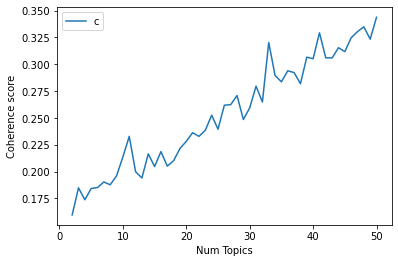

In [30]:
# Show graph
limit=51; start=2; step=1;
x = range(start, limit, step)
plt.plot(x, coherence_values)
plt.xlabel("Num Topics")
plt.ylabel("Coherence score")
plt.legend(("coherence_values"), loc='best')
plt.show()# Print the coherence scores

In [31]:
# Print the coherence scores
for m, cv in zip(x, coherence_values):
    print("Num Topics =", m, " has Coherence Value of", round(cv, 4))

Num Topics = 2  has Coherence Value of 0.1596
Num Topics = 3  has Coherence Value of 0.1848
Num Topics = 4  has Coherence Value of 0.1737
Num Topics = 5  has Coherence Value of 0.1842
Num Topics = 6  has Coherence Value of 0.1851
Num Topics = 7  has Coherence Value of 0.1903
Num Topics = 8  has Coherence Value of 0.1877
Num Topics = 9  has Coherence Value of 0.196
Num Topics = 10  has Coherence Value of 0.2137
Num Topics = 11  has Coherence Value of 0.2328
Num Topics = 12  has Coherence Value of 0.1999
Num Topics = 13  has Coherence Value of 0.1941
Num Topics = 14  has Coherence Value of 0.2165
Num Topics = 15  has Coherence Value of 0.2047
Num Topics = 16  has Coherence Value of 0.2186
Num Topics = 17  has Coherence Value of 0.2051
Num Topics = 18  has Coherence Value of 0.2102
Num Topics = 19  has Coherence Value of 0.2215
Num Topics = 20  has Coherence Value of 0.2282
Num Topics = 21  has Coherence Value of 0.2362
Num Topics = 22  has Coherence Value of 0.2328
Num Topics = 23  has C

In [32]:
type(model_list)
len(model_list)
print("Coherence score = ", coherence_values[48])
model_list[48]

Coherence score =  0.3438079129739558


In [ ]:
#######################################################################

In [33]:
# Set training parameters.
num_topics = 50
chunksize = 10000 # size of the doc looked at every pass
passes = 40 # number of passes through documents
iterations = 100
eval_every = 1  # Don't evaluate model perplexity, takes too much time.

# Make an index to word dictionary.
temp = docs_dict[0]  # This is only to "load" the dictionary.
id2word = docs_dict.id2token

%time model = LdaMulticore(corpus=corpus, id2word=id2word, chunksize=chunksize, \
                       iterations=iterations, num_topics=num_topics, \
                       passes=passes, workers=3)   

Wall time: 23min 53s


In [34]:
#Print all the topics
for i in range(0, model.num_topics):
    print ('Topic', i+1 , ' ', model.print_topic(i))
    print("-------------------------------------------------------------")

Topic 1   0.001*"feel like" + 0.001*"lot people" + 0.001*"partial agonist" + 0.001*"time going" + 0.001*"pain relief" + 0.001*"anxiety depression" + 0.001*"multiple time" + 0.001*"help pain" + 0.001*"cold turkey" + 0.001*"getting clean"
-------------------------------------------------------------
Topic 2   0.002*"cold turkey" + 0.002*"pain relief" + 0.001*"mood boost" + 0.001*"chronic pain" + 0.001*"treat addiction" + 0.001*"heroin methadone" + 0.001*"control life" + 0.001*"good luck" + 0.001*"coffee family" + 0.001*"doesnt matter"
-------------------------------------------------------------
Topic 3   0.001*"pain relief" + 0.001*"chronic pain" + 0.001*"time day" + 0.001*"good luck" + 0.001*"help pain" + 0.001*"anxiety depression" + 0.001*"depression anxiety" + 0.001*"feel bad" + 0.001*"lot people" + 0.001*"pain depression"
-------------------------------------------------------------
Topic 4   0.001*"people use" + 0.001*"pain management" + 0.001*"low dose" + 0.001*"plain leaf" + 0.00

Topic 31   0.001*"pain relief" + 0.001*"good luck" + 0.001*"feel like" + 0.001*"effective pain" + 0.001*"daily use" + 0.001*"high dose" + 0.001*"night sleep" + 0.001*"mental health" + 0.001*"miracle plant" + 0.001*"chronic pain"
-------------------------------------------------------------
Topic 32   0.001*"chronic pain" + 0.001*"feel like" + 0.001*"felt like" + 0.001*"black seed" + 0.001*"seed oil" + 0.001*"lot people" + 0.001*"pain relief" + 0.001*"long time" + 0.001*"know people" + 0.001*"negative effect"
-------------------------------------------------------------
Topic 33   0.002*"pain relief" + 0.001*"feel like" + 0.001*"lot people" + 0.001*"wont feel" + 0.001*"addiction pain" + 0.001*"chronic pain" + 0.001*"low dose" + 0.001*"miracle plant" + 0.001*"long time" + 0.001*"help pain"
-------------------------------------------------------------
Topic 34   0.001*"feel like" + 0.001*"yeah definitely" + 0.001*"long term" + 0.001*"pain relief" + 0.001*"desire drink" + 0.001*"felt like"

# Other Hyperparameters:

In [36]:
# supporting function
def compute_coherence_values(corpus, dictionary, k, a, b):
    lda_model = LdaModel(corpus=corpus, id2word=dictionary, num_topics=k, random_state=100, \
                         chunksize=100, passes=10, alpha=a, eta=b)
    
    coherence_model_lda = CoherenceModel(model=lda_model, texts=docs, dictionary=dictionary, coherence='c_v')
    
    return coherence_model_lda.get_coherence()

In [37]:
import tqdm

grid = {}
grid['Validation_Set'] = {}

# Topics range
min_topics = 2
max_topics = 9
step_size = 1
topics_range = range(min_topics, max_topics, step_size)

# Alpha parameter
alpha = list(np.arange(0.01, 1, 0.3))
alpha.append('symmetric')
alpha.append('asymmetric')

# Beta parameter
beta = list(np.arange(0.01, 1, 0.3))
beta.append('symmetric')

In [ ]:
# Validation sets
num_of_docs = len(corpus)
corpus_sets = [gensim.utils.ClippedCorpus(corpus, int(num_of_docs*0.75)), corpus]
corpus_title = ['75% Corpus', '100% Corpus']
model_results = {'Validation_Set': [], 'Topics': [], 'Alpha': [], 'Beta': [], 'Coherence': []}

# Can take a long time to run
if 1 == 1:
    pbar = tqdm.tqdm(total=540)
    
    # iterate through validation corpuses
    for i in range(len(corpus_sets)):
        # iterate through number of topics
        for k in topics_range:
            # iterate through alpha values
            for a in alpha:
                # iterare through beta values
                for b in beta:
                    # get the coherence score for the given parameters
                    cv = compute_coherence_values(corpus=corpus_sets[i], dictionary=docs_dict, 
                                                  k=k, a=a, b=b)
                    # Save the model results
                    model_results['Validation_Set'].append(corpus_title[i])
                    model_results['Topics'].append(k)
                    model_results['Alpha'].append(a)
                    model_results['Beta'].append(b)
                    model_results['Coherence'].append(cv)
                    
                    pbar.update(1)
    pd.DataFrame(model_results)
    pbar.close()

In [ ]:
pd.DataFrame(model_results).to_csv('lda_tuning_results.csv', index=False)

# Visualize 'optimal' LDA model

In [35]:
import pyLDAvis
pyLDAvis.gensim_models
import pyLDAvis.gensim_models
import warnings
pyLDAvis.enable_notebook()
warnings.filterwarnings("ignore", category=DeprecationWarning) 

In [36]:
#pcoa:Principal Coordinate Analysis (aka Classical Multidimensional Scaling)
p = pyLDAvis.gensim_models.prepare(model, corpus, docs_dict)
pyLDAvis.save_html(p, 'lda_pcoa_SideEffects.html')

In [37]:
# mmds:Metric Multidimensional Scaling
p = pyLDAvis.gensim_models.prepare(model, corpus, docs_dict, mds='mmds')
pyLDAvis.save_html(p, 'lda_mmds_SideEffects.html')

In [38]:
#tsne:t-distributed Stochastic Neighbor Embedding
p = pyLDAvis.gensim_models.prepare(model, corpus, docs_dict, mds='tsne')
pyLDAvis.save_html(p, 'lda_tsne_SideEffects.html')